In [1]:
import numpy as np
from numpy.fft import fft, fftfreq, ifft
from HHGtoolkit.utilities import Data, Dataset
import HHGtoolkit.utilities as util
import matplotlib.pyplot as plt
import NeuralNetwork.NeuralNetwork as NN
from importlib import reload
import tensorflow as tf
import os
import h5py
from scipy.signal.windows import *
import Scripts.tools as tools

2023-10-17 10:48:30.615848: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
def load_fields_from_h5(dir):
    arr = os.listdir(dir)
    file_paths = [dir + x for x in arr if x.endswith('.h5')]
    util.sort_nicely(file_paths)
    E_arr = list()
    gradV_arr = list()
    dset = list()
    for file in file_paths:
        data = h5py.File(file, "r")
        #E_arr.append(data["outputs/Efield"][:,0])
        #gradV_arr.append(data["outputs/grad_pot"][:,0])
        dset.append([data["outputs/Efield"][:,0], data["outputs/grad_pot"][:,0]])
        data.close()
    data = h5py.File(file, "r")
    t = data["outputs/tgrid"][:]
    data.close()
    #return np.array([np.array(E_arr), np.array(gradV_arr)]), t
    return np.array(dset), t

def load_fields(dir):
    arr = os.listdir(dir)
    file_paths = [dir + x for x in arr if x.endswith('.h5')]
    util.sort_nicely(file_paths)
    E_arr = list()
    gradV_arr = list()
    for file in file_paths:
        #d = util.load_data(file)
        d = Data(file)
        E_arr.append(d.E_z)
        gradV_arr.append(d.grad_pot)
    return np.array(E_arr), np.array(gradV_arr)

In [3]:
from math import erf
import cmath

def n_th_root(arr, n):
    arr = [np.sign(x)*np.abs(x)**n for x in arr]
    arr = [cmath.rect(np.abs(x), cmath.phase(x)).real for x in arr]
    return np.array(arr)

### Temporal filter
def filter(arr, t):
    t_max = t[-1]
    arr = arr* (1-np.array(list(map(erf, (t-t_max+t_max/4)/(t_max/20)))))/2
    return arr

def filter2(arr, t):
    t_max = t[-1]
    M = len(t)
    shift = t_max/6
    #shift = t_max/5.
    slope = t_max/30
    #slope = t_max/14
    arr[:M//2] = arr[:M//2] * (1+np.array(list(map(erf, (t[:M//2]-shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/6)/(t_max/15)))))/2
    arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/7)/(t_max/25)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/4)/(t_max/20)))))/2
    #arr = arr * (1-np.array(list(map(erf, (t-t_max+t_max/5)/(t_max/12)))))/2
    return arr

### Real and imaginary part separation
def fft_real_imag_separation(arr, t, n = 3):
    N = len(arr)
    dt = t[1]-t[0]
    T = t[-1]
    freqs = fftfreq(len(arr), dt)*2*np.pi
    FF = fft(arr)
    FF *= np.exp(1j*freqs*T/2)
    real_ = FF.real[0:N//2+1]
    imag_ = (FF.imag[0:N//2+1])
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

### Real and imaginary part reconstruction
def fft_real_imag_reconstruction(real, imag, t, n = 3):
    #real = 20*real
    #imag = 20*imag
    dt = t[1]-t[0]
    T = t[-1]
    N = 2*len(real)-1
    res = 1j*np.zeros((N))
    FF = real**n + 1j*(imag)**n
    FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    res[0:N//2+1] = FF
    res[N//2+1:N] = FF_conj
    freqs = fftfreq(len(res), dt)*2*np.pi
    res = res*np.exp(-1j*freqs*T/2)
    return ifft(res).real

In [4]:
import random

# Define a function that takes N as a parameter
def generate_random_integers(N, lambda_ = 5, max_index = 1000):
  # Initialize an empty list to store the random integers
  random_integers = []
  # Loop N times
  for i in range(N):
    # Generate a random number between 0 and 1 using the exponential cumulative distribution function
    # The parameter lambda is set to 0.001 for demonstration purposes
    # You can change it to any positive value you want
    random_number = random.expovariate(lambda_)
    # Multiply the random number by 1000 and round it to the nearest integer
    random_integer = round(random_number*max_index)
    while (random_integer > max_index-1):
      random_number = random.expovariate(lambda_)
      random_integer = round(random_number*1000)
    # Append the random integer to the list
    random_integers.append(random_integer)
  # Return the list of random integers
  return random_integers

# Data preprocessing

### Cutting the spectrum from certain harmonic

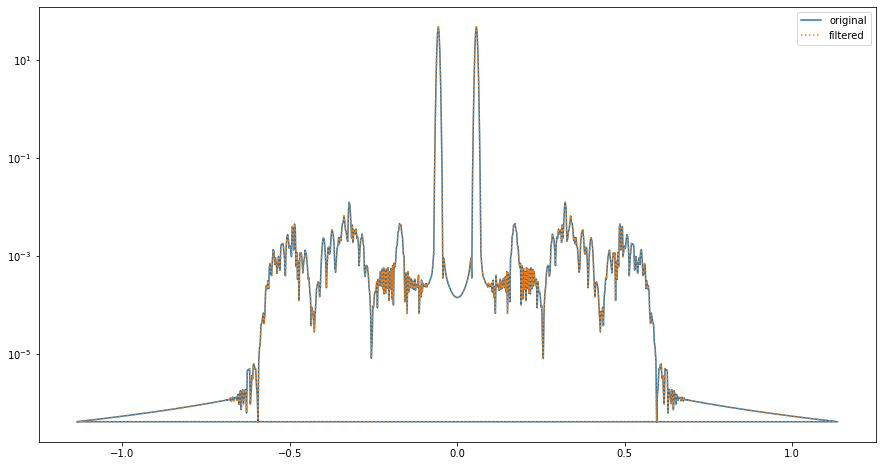

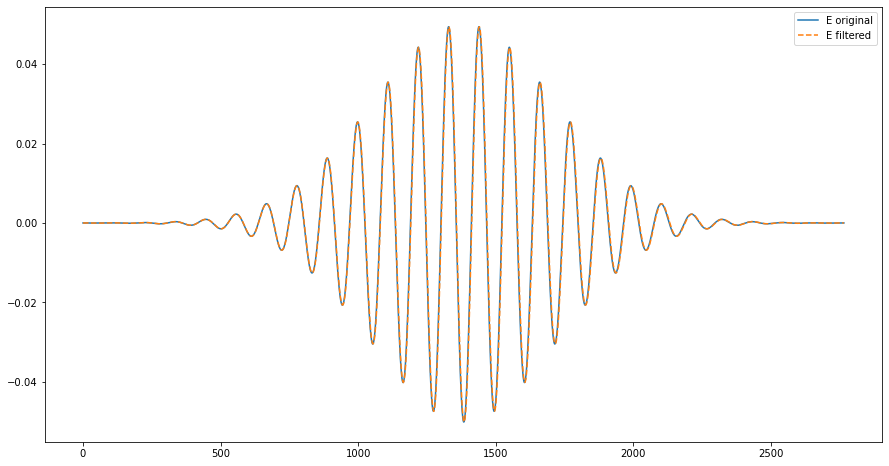

Number of points for filtered field:  1001


In [2]:
d = Data("tmp/test_high_intensity/data_k1_1.h5")

t = d.t
E = d.E_z
w_0 = d.omega_1
cutoff = 20
N = len(t)

### Plot fourier transforms of original and filtered spectra
fig = plt.figure()
tf = fftfreq(N, t[1]-t[0])*2*np.pi
Ef = fft(E)
range_ = (tf >= - cutoff*w_0) & (tf <= cutoff*w_0)
plt.semilogy(tf[range_], np.abs(Ef)[range_], label = "original")
#plt.show()

E_filtered = ifft(Ef[range_])
N_filtered = len(E_filtered)
t_filtered = np.linspace(t[0], t[-1], N_filtered)
tf = fftfreq(N_filtered, t_filtered[1]-t_filtered[0])*2*np.pi
Ef = fft(E_filtered)
range_ = (tf >= - cutoff*w_0) & (tf <= cutoff*w_0)
plt.semilogy(tf[range_], np.abs(Ef)[range_], label = "filtered", linestyle = ":")
plt.legend()
fig.set_figheight(8)
fig.set_figwidth(15)
plt.show()

### Plot real fields

### Normalize first!
E_filtered = E_filtered*N_filtered/N
fig = plt.figure()
plt.plot(t, E, label = "E original")
plt.plot(t_filtered, E_filtered.real, label = "E filtered", linestyle = "--")
plt.legend()
fig.set_figheight(8)
fig.set_figwidth(15)
plt.show()

print("Number of points for filtered field: ", N_filtered)

### Spectral filter for a fixed number of points $N_{cutoff}$

6401
513


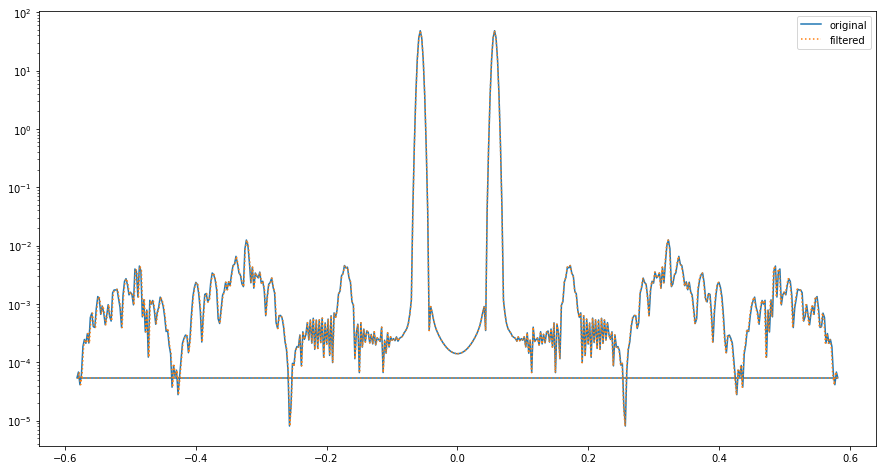

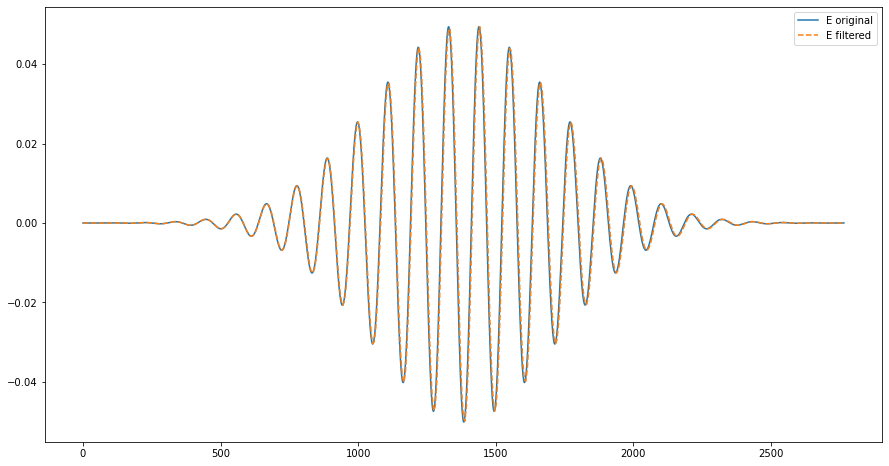

Number of points for filtered field:  513


In [3]:
d = Data("tmp/test_high_intensity/data_k1_1.h5")
t = d.t
E = d.E_z
w_0 = d.omega_1
N_cutoff = 513
N = len(t)

print(len(t))

### Plot fourier transforms of original and filtered spectra
fig = plt.figure()
tf = fftfreq(N, t[1]-t[0])*2*np.pi
Ef = fft(E)

range_ = np.r_[0:((N_cutoff)//2+1), -(N_cutoff)//2+1:0]
tf = tf[range_]
print(len(tf))
plt.semilogy(tf[range_], np.abs(Ef)[range_], label = "original")
#plt.show()

E_filtered = ifft(Ef[range_])
N_filtered = len(E_filtered)
t_filtered = np.linspace(t[0], t[-1], N_filtered)
tf = fftfreq(N_filtered, t_filtered[1]-t_filtered[0])*2*np.pi
Ef = fft(E_filtered)
#range_ = (tf >= - cutoff*w_0) & (tf <= cutoff*w_0)
plt.semilogy(tf, np.abs(Ef), label = "filtered", linestyle = ":")
#plt.semilogy(np.abs(Ef)[range_], label = "filtered", linestyle = ":")
plt.legend()
fig.set_figheight(8)
fig.set_figwidth(15)
plt.show()

### Plot real fields

### Normalize first!
E_filtered = E_filtered*N_filtered/N
fig = plt.figure()
plt.plot(t, E, label = "E original")
plt.plot(t_filtered, E_filtered.real, label = "E filtered", linestyle = "--")
plt.legend()
fig.set_figheight(8)
fig.set_figwidth(15)
plt.show()

print("Number of points for filtered field: ", N_filtered)

# NN in the temporal domain

Example of an inferior approach with an already outdated version of the NN.
This part is left mainly for the demonstration purposes.

See file ```NeuralNetwork.py``` first!

In [18]:
### If any change in the script `NeuralNetwork.py` has been made,
### this method simply reloads the updated module.
reload(NN)

<module 'NeuralNetwork.NeuralNetwork' from '/Users/tadeasnemec/Programming/Git/Schroedinger-Maxwell/NeuralNetwork/NeuralNetwork.py'>

### Initialization of the NN

Showing an example of a TDSE NN model construction. 

We define ```N``` number of points corresponding to the input size.
**The number of points is selected as an odd number to prevent enlarging the input 
array after the application of FFT and IFFT!**

We then apply the method ```build()``` on our model so it can show us the NN overall 
structure and number of trainable parameters by calling the method ```summary()```.

In [52]:
N = 1024 + 1
model = NN.TDSE_NN(N)
model.build(input_shape=(None, N))
model.summary()

Model: "tdse_nn_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            multiple                  262656    
                                                                 
 dense_16 (Dense)            multiple                  65792     
                                                                 
 dropout_5 (Dropout)         multiple                  0         
                                                                 
 dense_17 (Dense)            multiple                  263425    
                                                                 
Total params: 591,873
Trainable params: 591,873
Non-trainable params: 0
_________________________________________________________________


### Preparation of datasets

Here we demonstrate the reduction of the *features*, i.e. the input field or data, by application of the spectral filtering where we cut the frequencies which are not of interest.
Spectral filtering effectively reduces the number of connections, i.e. weights.

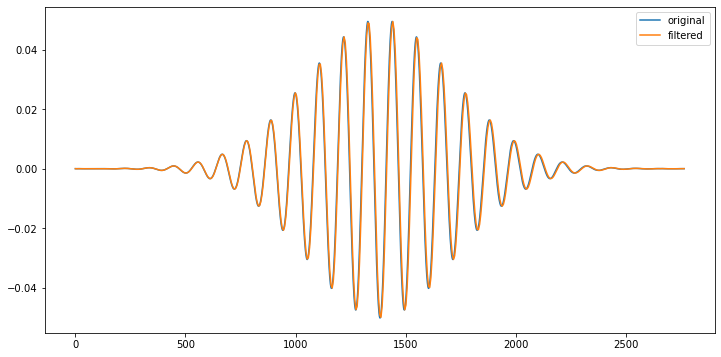

In [8]:
d = Data("tmp/test_high_intensity/data_k1_1.h5")

%matplotlib inline
N_filtered = 513
E = d.E_z
t = d.t
E2 = NN.spectral_filter(E, N_filtered)
t2 = np.linspace(t[0], t[-1], N_filtered)

fig = plt.figure()
plt.plot(t, E, label = "original")
plt.plot(t2, E2, label = "filtered")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(6)
plt.show()

### Train and test dataset creation

We load our test and training data computed with an outdated version of a propagation solver. The datasets contain around 322 different .h5 files for the train set and 82 different .h5 files for the test set. Both datasets correspond to a propagation distance of a 10 cycle gaussian pulse propagating through argon gas for a distance of 100000 a.u. = 5 um.

In [51]:
dset_train = util.load_dataset("tmp/test_low_intensity_0_25dz/")
dset_test = util.load_dataset("tmp/test_low_intensity/")



Here we define 4 distinct numpy arrays containing the inputs of the NN, i.e. **features** and expected outputs, i.e. **labels**. We have divided the datasets into training and testing arrays.

The spectral filter is then applied on every harmonic. The filter cuts the harmonic above ```N_filtered//2+1``` points in the spectrum. 

In [53]:
N_filtered = 1024+1
x_train = np.array([NN.spectral_filter(d.E_z, N_filtered) for d in dset_train])
y_train = np.array([NN.spectral_filter(d.grad_pot, N_filtered) for d in dset_train])

x_test = np.array([NN.spectral_filter(d.E_z, N_filtered) for d in dset_test])
y_test = np.array([NN.spectral_filter(d.grad_pot, N_filtered) for d in dset_test])

### Compile model

Here we call method ```compile()``` on our model to actually tell Tensorflow what to do to our NN while training, e.g. selection of the gradient computation (`optimizer`), loss function (`loss`) and the metrics to evaluate our model on (`metrics`).

In [54]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model

We call the method `fit()` on our model to really start the **learing process**.

We set the number of `epochs` in the beginning and the batch size is 32 by default. 
Hence the progress will be shown as: (All batches)/(Evaluated batches).
Note that 'All batches' = ```x_train.shape[0]/batch_size```

Batches are selected randomly from the train set and the data is shuffled in the batches too.

In [59]:
model.fit(x_train, y_train, epochs = 40, batch_size=32)

Epoch 1/40
11/11 [==============================] - 0s 11ms/step - loss: 7.1763e-10 - accuracy: 0.2368
Epoch 2/40
11/11 [==============================] - 0s 12ms/step - loss: 7.0669e-10 - accuracy: 0.2991
Epoch 3/40
11/11 [==============================] - 0s 12ms/step - loss: 9.4174e-10 - accuracy: 0.3551
Epoch 4/40
11/11 [==============================] - 0s 13ms/step - loss: 6.4301e-10 - accuracy: 0.4922
Epoch 5/40
11/11 [==============================] - 0s 12ms/step - loss: 7.6711e-10 - accuracy: 0.4393
Epoch 6/40
11/11 [==============================] - 0s 12ms/step - loss: 8.6938e-10 - accuracy: 0.3832
Epoch 7/40
11/11 [==============================] - 0s 12ms/step - loss: 6.6858e-10 - accuracy: 0.3988
Epoch 8/40
11/11 [==============================] - 0s 12ms/step - loss: 6.9007e-10 - accuracy: 0.4611
Epoch 9/40
11/11 [==============================] - 0s 11ms/step - loss: 6.6634e-10 - accuracy: 0.4050
Epoch 10/40
11/11 [==============================] - 0s 12ms/step - loss:

### Test model

Test the accuracy of prediction of our trained model on the test data.

In [60]:
model.evaluate(x_test, y_test)

3/3 [==============================] - 0s 4ms/step - loss: 6.1785e-10 - accuracy: 0.2963


[6.178517142352291e-10, 0.29629629850387573]

### Predict

Predict the outcome with the input field. In this example, we use one of the test features.

In [61]:
features = (np.expand_dims(x_test[1],0))
prediction = model.predict(features)

1/1 [==============================] - 0s 34ms/step


Plot the prediction and the original with their corresponding temporal and spectral profiles.

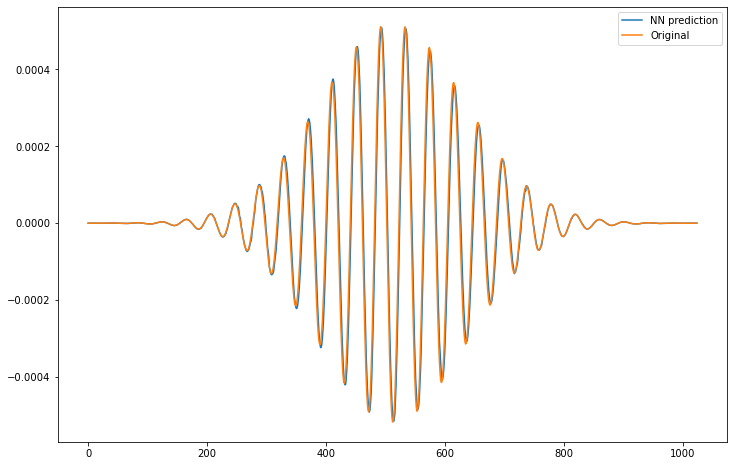

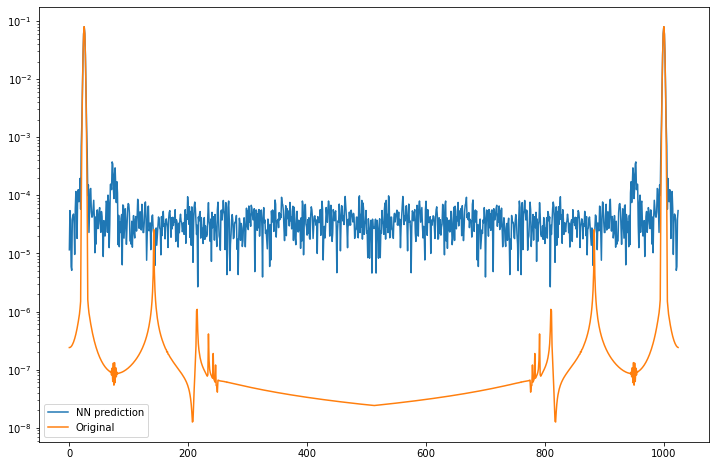

In [62]:
fig = plt.figure()
plt.plot(*prediction, label = "NN prediction")
plt.plot(y_test[1], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

fig = plt.figure()
plt.semilogy(np.abs(fft(*prediction)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_test[1])), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Different NN designs

In this section, other *hyperparameters*, i.e. number of layers, activations etc., of the NN have been adjusted and played with.

In [137]:
tf.keras.utils.get_custom_objects().clear()
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

### Prepare datasets
x_train = np.array([NN.spectral_filter(d.E_z, N) for d in dset_train])
y_train = np.array([NN.spectral_filter(d.grad_pot, N) for d in dset_train])

x_test = np.array([NN.spectral_filter(d.E_z, N) for d in dset_test])
y_test = np.array([NN.spectral_filter(d.grad_pot, N) for d in dset_test])

### Create custom NN model
model = NN.TDSE_NN(N)
model.build(input_shape=(None, N))
### Print summary of the model (basic info)
model.summary()

### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train, y_train, epochs = 20)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test, y_test)

Model: "tdse_nn_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_136 (Dense)           multiple                  65792     
                                                                 
 dropout_70 (Dropout)        multiple                  0         
                                                                 
 dense_137 (Dense)           multiple                  16512     
                                                                 
 dropout_71 (Dropout)        multiple                  0         
                                                                 
 dense_138 (Dense)           multiple                  0 (unused)
                                                                 
 dense_139 (Dense)           multiple                  66177     
                                                                 
Total params: 148,481
Trainable params: 148,481
Non-trai

[1.0709427789024062e-09, 0.5185185074806213]

Show results - temporal profiles and spectra.

1/1 [==============================] - 0s 73ms/step


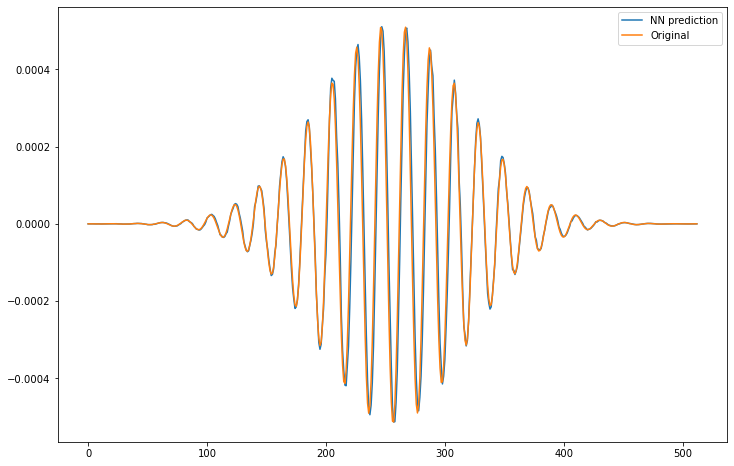

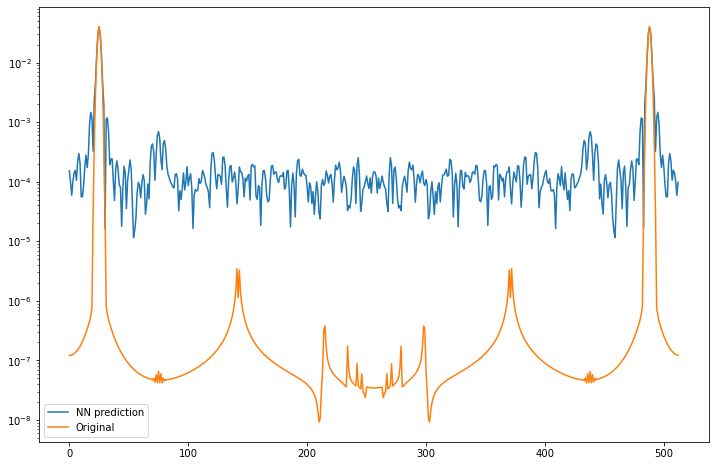

In [138]:
features = (np.expand_dims(x_test[-1],0))
prediction = model.predict(features)

fig = plt.figure()
plt.plot(*prediction, label = "NN prediction")
plt.plot(y_test[1], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

fig = plt.figure()
plt.semilogy(np.abs(fft(*prediction)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_test[-1])), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

Show phases

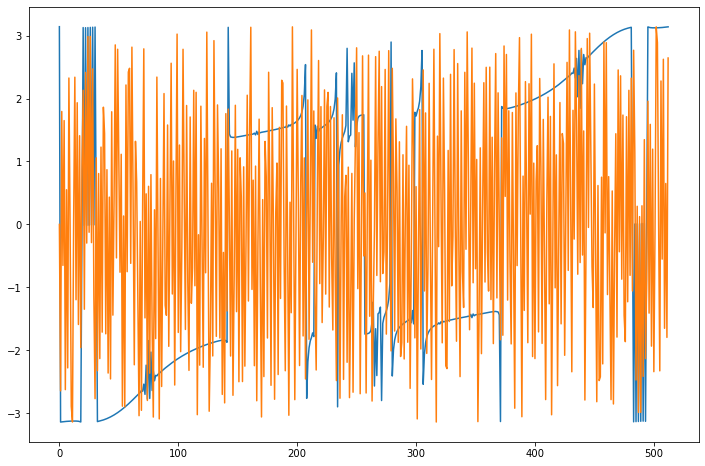

In [96]:
fig = plt.figure()
plt.plot(np.angle(fft(y_test[1])[:]))
plt.plot(np.angle(fft(*prediction)[:]))
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Separate amplitudes and phases and compute on these

The idea is to compute in the fourier space and train on phases and amplitudes instead. 

We employ the fact, that the spectral amplitudes can be logarithmically scaled to make the differences between the respective frequencies smaller.

From FFT we retrieve the fourier coefficients of the original data:

$$ f(t) = \sum_j \hat{f}_j e^{2\pi i j / N} \rightarrow \hat{f}_j $$

and compute:
$$ \text{amps}_j = \log(|\hat{f}_j|) \quad , \quad \text{phases}_j = \text{arg}(\hat{f}_j)$$

The original function $f(t)$ is then simply given by applying the IFFT:
$$ f(t) = \sum_j \exp(\text{amps}_j) e^{i \cdot \text{phases}_j} \rightarrow \hat{f}_j $$

Below is the demonstration how the method works:

In [411]:
N = 2049
y = NN.spectral_filter(dset_test[0].E_z, N)

N = len(y)
print(N)

Fy = fft(y)
amps = np.log(np.abs(Fy[0:N//2+1]))
phases = np.angle(Fy[0:N//2+1])
print(len(amps), len(phases))

### Reconstructed y from phase and amps
Fy_rec = np.zeros((N), dtype=complex)
Fy_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases)
Fy_rec[N//2+1:N] = np.flip(np.conj(Fy_rec[1:N//2+1]))

2049
1025 1025


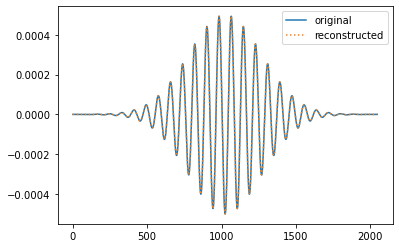

True


In [413]:
y_rec = ifft(Fy_rec).real
plt.plot(y[:], label = "original")
plt.plot(y_rec[:], label = "reconstructed", linestyle = ":")
plt.legend()
plt.show()

print(np.allclose(y, y_rec))

Writing the corresponding functions

In [126]:
def logamp_phase_separation(arr):
    ### Compute FFT of array
    F_arr = fft(arr)
    N = len(arr)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = np.log(np.abs(F_arr[0:N//2+1]))  #+15*np.ones((N//2+1))
    ### Compute phase of the first N//2+1 points
    phases = np.unwrap(np.angle(F_arr[0:N//2+1]))/np.pi
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    return np.array([amps, phases]).flatten()
    #return np.array([amps, phases])

def logamp_phase_reconstruction(arr):
    #N = 2*len(arr[1])-1
    N = len(arr)-1
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    amps = arr[0:N//2+1]            #-15*np.ones((N//2+1))
    phases = arr[N//2+1:len(arr)]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    #amps = arr[0]            #-15*np.ones((N//2+1))
    #phases = arr[1]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return arr_rec

Demonstration of the logarithmic-amplitude separation. **The resulting image is what is going to be fed to the NN as features!**

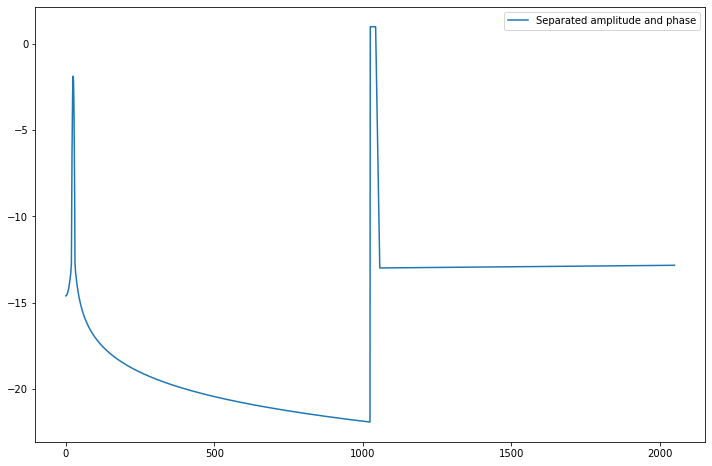

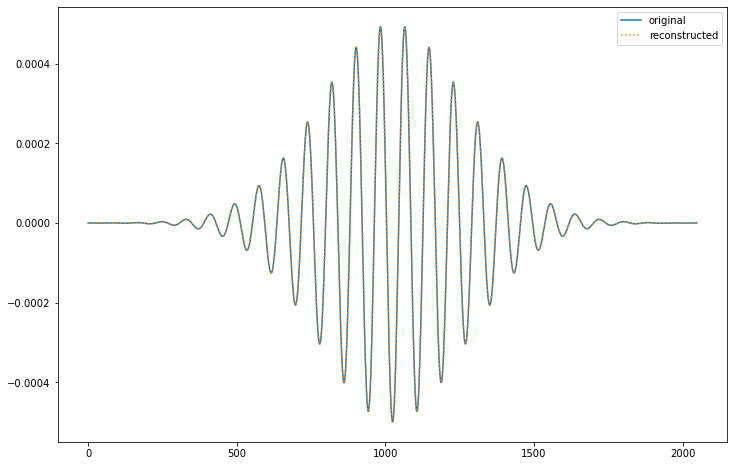

*********************************************
Are the arrays the same?
True


In [424]:
N = 2049
y = NN.spectral_filter(dset_test[0].E_z, N)
y_separated = logamp_phase_separation(y)

fig = plt.figure()
plt.plot(y_separated, label = "Separated amplitude and phase")
#plt.plot(y_separated[1], label = "Separated amplitude and phase")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

y_rec = logamp_phase_reconstruction(y_separated)


y_rec = ifft(y_rec).real

fig = plt.figure()
plt.plot(y[:], label = "original")
plt.plot(y_rec[:], label = "reconstructed", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("*********************************************")
print("Are the arrays the same?")
print(np.allclose(y, y_rec))

# Train NN on phase (with phase unwrapping) and amplitude

Defining a new model with similar NN architecture as in the above examples. We feed the NN with a 1D Numpy array and it outputs a predicted labels.

In [3]:
### Loading the datasets
dset_train = util.load_dataset("tmp/test_low_intensity_0_25dz/")
dset_test = util.load_dataset("tmp/test_low_intensity/")


This section prepares the datasets, builds the model, compiles it and then fits and evaluates given the datasets.

**You can play with this, it should work OKAY!**

In [9]:
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

### Prepare datasets
x_train = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N)) for d in dset_train])
y_train = np.array([logamp_phase_separation(NN.spectral_filter(d.grad_pot, N)) for d in dset_train])

x_test = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N)) for d in dset_test])
y_test = np.array([logamp_phase_separation(NN.spectral_filter(d.grad_pot, N)) for d in dset_test])

### Create custom NN model
model = NN.TDSE_NN(N+1)
model.build(input_shape=(None, N+1))
### Print summary of the model (basic info)
model.summary()

### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train, y_train, epochs = 200)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test, y_test)

Model: "tdse_nn_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             multiple                  263680    
                                                                 
 dropout_3 (Dropout)         multiple                  0         
                                                                 
 dense_5 (Dense)             multiple                  262656    
                                                                 
 dropout_4 (Dropout)         multiple                  0         
                                                                 
 dense_6 (Dense)             multiple                  262656    
                                                                 
 dropout_5 (Dropout)         multiple                  0         
                                                                 
 dense_7 (Dense)             multiple                  26

[1.1918351650238037, 0.9629629850387573]

Show results.

1/1 [==============================] - 0s 115ms/step
******************************************************************
Labels


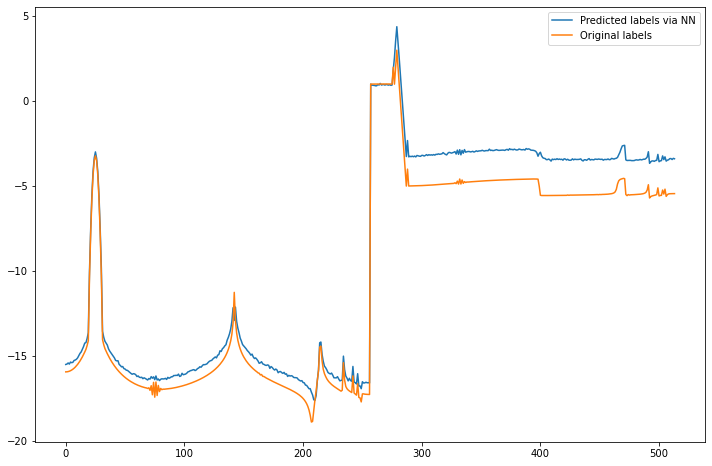

******************************************************************
Fields


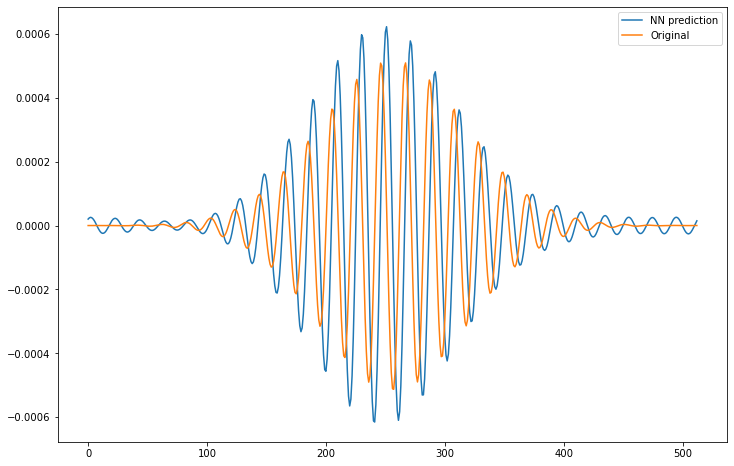

******************************************************************
Spectra


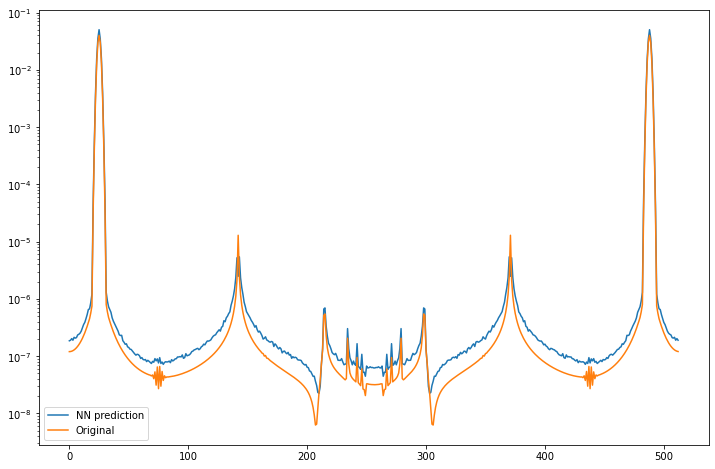

******************************************************************
Phases


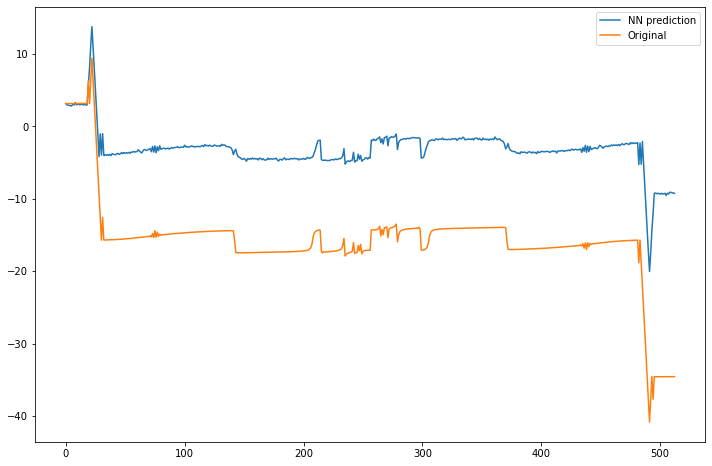

In [10]:
y_orig = ifft(logamp_phase_reconstruction(y_test[1])).real

features = (np.expand_dims(x_test[1],0))
prediction = model.predict(features)[0]

print("******************************************************************")
print("Labels")
fig = plt.figure()
plt.plot(prediction[:], label = "Predicted labels via NN")
plt.plot(y_test[1][:], label = "Original labels")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


y_NN = logamp_phase_reconstruction(prediction)
y_NN = ifft(y_NN).real

print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(y_NN, label = "NN prediction")
plt.plot(y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(np.abs(fft(y_NN)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_orig)), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(np.unwrap(np.angle(fft(y_NN))), label = "NN prediction")
plt.plot(np.unwrap(np.angle(fft(y_orig))), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Separating phase and amplitude

In this section, we completely separate phase and amplitude features to their respective independent arrays. The input and output tensors to NN are then in the shape `(2, N//2+1)` given the input field of size `N` - **must be an odd number because of FFT!!!**

**Note**: the phases and amplitudes are pointwise scaled up by addition of a positive number. The operation is then reversed during call of the reconstruction function. Phase is also normalised by $\pi$ and unwrapped using Numpy function `unwrap()`.

In [179]:
def logamp_phase_separation2(arr):
    ### Compute FFT of array
    F_arr = fft(arr)
    N = len(arr)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = (np.log(np.abs(F_arr[0:N//2+1]))  +20*np.ones((N//2+1)))
    ### Compute phase of the first N//2+1 points
    phases = (np.unwrap(np.angle(F_arr[0:N//2+1]))/np.pi +0*np.ones((N//2+1)))
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    #return np.array([amps, phases]).flatten()
    return np.array([amps, phases])

def logamp_phase_reconstruction2(arr):
    N = 2*len(arr[1])-1
    #N = len(arr)-1
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    #amps = arr[0:N//2+1]            #-15*np.ones((N//2+1))
    #phases = arr[N//2+1:len(arr)]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    amps = (arr[0]            -20*np.ones((N//2+1)))
    phases = (arr[1]          -0*np.ones((N//2+1)))
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return arr_rec

Showing the separated amplitudes and phases.

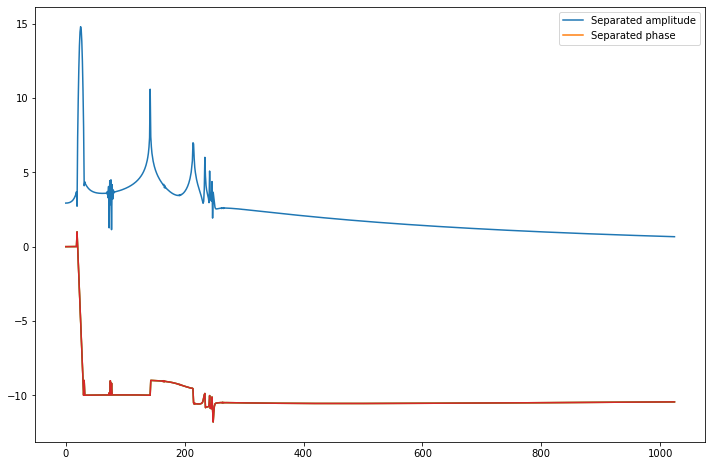

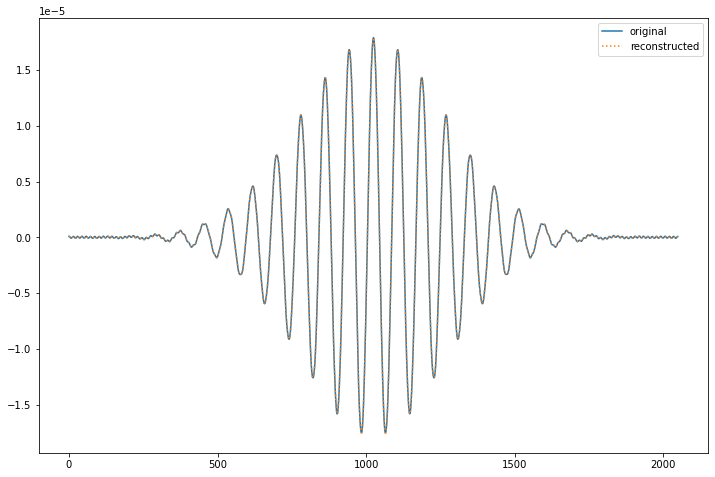

*********************************************
Are the arrays the same?
True


In [180]:
N = 2049
y = NN.spectral_filter(-dset_test[0].grad_pot+dset_test[0].E_z, N)
y_separated = logamp_phase_separation2(y)
y_rec = logamp_phase_reconstruction2(y_separated)
y_rec = ifft(y_rec).real

fig = plt.figure()
plt.plot(y_separated[0], label = "Separated amplitude")
plt.plot(y_separated[1], label = "Separated phase")
plt.plot(np.unwrap(np.angle(fft(y)))[0:N//2+1]/(np.pi)+0*np.ones((N//2+1)))
plt.plot(np.unwrap(np.angle(fft(y_rec)))[0:N//2+1]/(np.pi)+0*np.ones((N//2+1)))
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


fig = plt.figure()
plt.plot(y[:], label = "original")
plt.plot(y_rec[:], label = "reconstructed", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("*********************************************")
print("Are the arrays the same?")
print(np.allclose(y, y_rec))

Building and training the NN and dataset preparation.

In [182]:
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

### Prepare datasets
x_train = np.array([logamp_phase_separation2(NN.spectral_filter(d.E_z, N)) for d in dset_train])
y_train = np.array([logamp_phase_separation2(NN.spectral_filter(-d.grad_pot+d.E_z, N)) for d in dset_train])

x_test = np.array([logamp_phase_separation2(NN.spectral_filter(d.E_z, N)) for d in dset_test])
y_test = np.array([logamp_phase_separation2(NN.spectral_filter(-d.grad_pot+d.E_z, N)) for d in dset_test])

### Create custom NN model
model = NN.TDSE_NN_2((2, N//2+1,), N+1, N=2*(N+1), activation=tf.nn.tanh)
model.build(input_shape=(None, 2, N//2+1))
### Print summary of the model (basic info)
model.summary()



Model: "tdse_nn_2_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_54 (InputLayer)       [(None, 2, 257)]          0         
                                                                 
 dropout_265 (Dropout)       multiple                  0         
                                                                 
 dense_271 (Dense)           multiple                  264196    
                                                                 
 dropout_266 (Dropout)       multiple                  0         
                                                                 
 dense_272 (Dense)           multiple                  1057812   
                                                                 
 dropout_267 (Dropout)       multiple                  0         
                                                                 
 dense_273 (Dense)           multiple                 

In [183]:
### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train, y_train, epochs = 200)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test, y_test)

Epoch 1/200
11/11 [==============================] - 2s 36ms/step - loss: 11.8859 - accuracy: 0.0156
Epoch 2/200
11/11 [==============================] - 0s 37ms/step - loss: 3.1967 - accuracy: 0.1760
Epoch 3/200
11/11 [==============================] - 0s 36ms/step - loss: 2.4140 - accuracy: 0.3832
Epoch 4/200
11/11 [==============================] - 0s 34ms/step - loss: 2.3021 - accuracy: 0.2227
Epoch 5/200
11/11 [==============================] - 0s 34ms/step - loss: 2.2145 - accuracy: 0.3396
Epoch 6/200
11/11 [==============================] - 0s 34ms/step - loss: 2.1579 - accuracy: 0.3364
Epoch 7/200
11/11 [==============================] - 0s 34ms/step - loss: 2.1125 - accuracy: 0.3551
Epoch 8/200
11/11 [==============================] - 0s 33ms/step - loss: 2.0729 - accuracy: 0.3053
Epoch 9/200
11/11 [==============================] - 0s 34ms/step - loss: 2.0509 - accuracy: 0.2430
Epoch 10/200
11/11 [==============================] - 0s 36ms/step - loss: 2.0337 - accuracy: 0.350

[0.8002459406852722, 0.9444444179534912]

Show results

1/1 [==============================] - 0s 174ms/step
******************************************************************
Labels


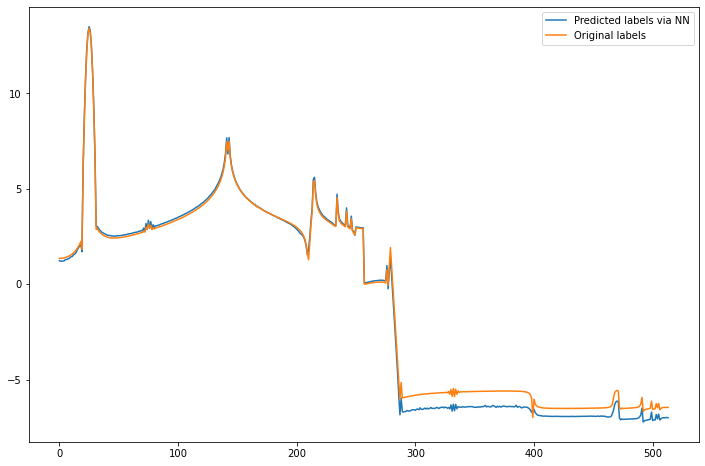

******************************************************************
Fields


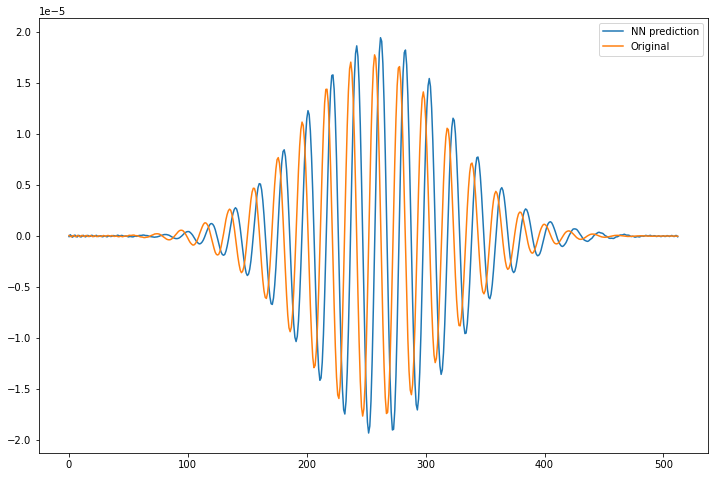

******************************************************************
Spectra


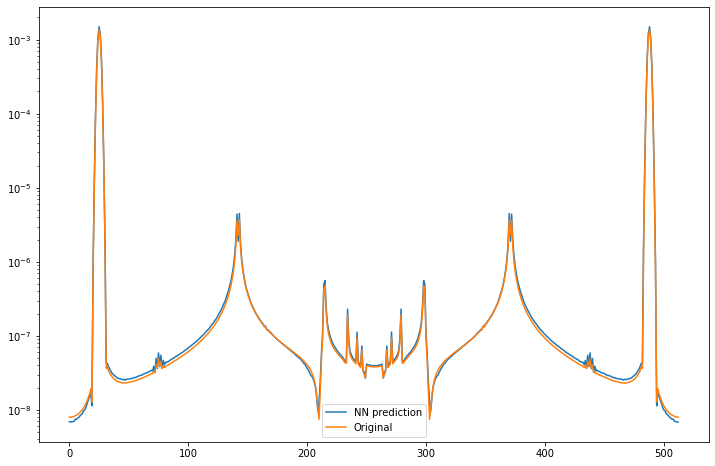

******************************************************************
Phases


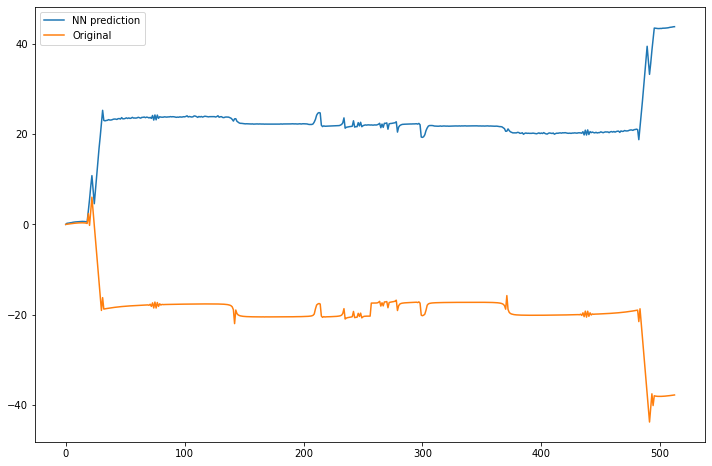

In [184]:
i = 10
y_orig = ifft(logamp_phase_reconstruction2(y_test[i])).real
#y_orig = ifft(logamp_phase_reconstruction(y_test[i])).real

features = (np.expand_dims(x_test[i],0))
prediction = model.predict(features)[0]


print("******************************************************************")
print("Labels")
fig = plt.figure()
plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(prediction[:], label = "Predicted labels via NN")
plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test[i][:], label = "Original labels")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


y_NN = logamp_phase_reconstruction2(prediction)
#y_NN = logamp_phase_reconstruction(prediction)
y_NN = ifft(y_NN).real

print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(y_NN, label = "NN prediction")
plt.plot(y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(np.abs(fft(y_NN)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_orig)), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(np.unwrap(np.angle(fft(y_NN))), label = "NN prediction")
plt.plot(np.unwrap(np.angle(fft(y_orig))), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Have fun playing!!!

In [7]:
def logamp_phase_separation(arr):
    ### Compute FFT of array
    F_arr = fft(arr)
    N = len(arr)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = np.log(np.abs(F_arr[0:N//2+1])) + 15*np.ones((N//2+1))
    ### Compute phase of the first N//2+1 points
    phases = np.unwrap(np.angle(F_arr[0:N//2+1]))#/np.pi
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    return np.array([amps, phases]).flatten()
    #return np.array([amps, phases])

def logamp_phase_reconstruction(arr):
    #N = 2*len(arr[1])-1
    N = len(arr)-1
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    amps = arr[0:N//2+1]            -15*np.ones((N//2+1))
    phases = arr[N//2+1:len(arr)]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    #amps = arr[0]            #-15*np.ones((N//2+1))
    #phases = arr[1]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases)#*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return arr_rec

In [270]:
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

### Prepare datasets
x_train = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N)) for d in dset_train])
y_train = np.array([logamp_phase_separation(NN.spectral_filter(-d.grad_pot+d.E_z, N)) for d in dset_train])

x_test = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N)) for d in dset_test])
y_test = np.array([logamp_phase_separation(NN.spectral_filter(-d.grad_pot+d.E_z, N)) for d in dset_test])

### Create custom NN model
model = NN.TDSE_NN_3((N+1,), N+1, N=514, activation=tf.nn.tanh)
model.build(input_shape=(None, N+1))
### Print summary of the model (basic info)
model.summary()


Model: "tdse_nn_3_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_79 (InputLayer)       [(None, 514)]             0         
                                                                 
 dropout_390 (Dropout)       multiple                  0         
                                                                 
 dense_396 (Dense)           multiple                  264196    
                                                                 
 dropout_391 (Dropout)       multiple                  0 (unused)
                                                                 
 dense_397 (Dense)           multiple                  0 (unused)
                                                                 
 dropout_392 (Dropout)       multiple                  0 (unused)
                                                                 
 dense_398 (Dense)           multiple                 

In [273]:
### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train, y_train, epochs = 100)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test, y_test)

Epoch 1/100
11/11 [==============================] - 1s 10ms/step - loss: 7.0272 - accuracy: 0.6293
Epoch 2/100
11/11 [==============================] - 0s 12ms/step - loss: 6.8602 - accuracy: 0.6604
Epoch 3/100
11/11 [==============================] - 0s 11ms/step - loss: 6.9105 - accuracy: 0.6573
Epoch 4/100
11/11 [==============================] - 0s 12ms/step - loss: 6.9430 - accuracy: 0.6386
Epoch 5/100
11/11 [==============================] - 0s 15ms/step - loss: 7.0566 - accuracy: 0.6822
Epoch 6/100
11/11 [==============================] - 0s 15ms/step - loss: 6.8246 - accuracy: 0.6573
Epoch 7/100
11/11 [==============================] - 0s 10ms/step - loss: 6.9967 - accuracy: 0.6947
Epoch 8/100
11/11 [==============================] - 0s 9ms/step - loss: 7.1132 - accuracy: 0.7508
Epoch 9/100
11/11 [==============================] - 0s 10ms/step - loss: 6.9932 - accuracy: 0.6760
Epoch 10/100
11/11 [==============================] - 0s 10ms/step - loss: 7.0865 - accuracy: 0.6729


[6.514791488647461, 1.0]

1/1 [==============================] - 0s 59ms/step
******************************************************************
Features


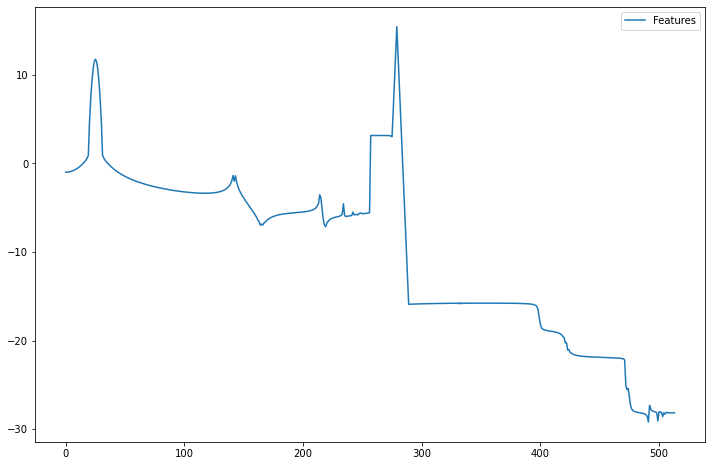

******************************************************************
Features z-normalized


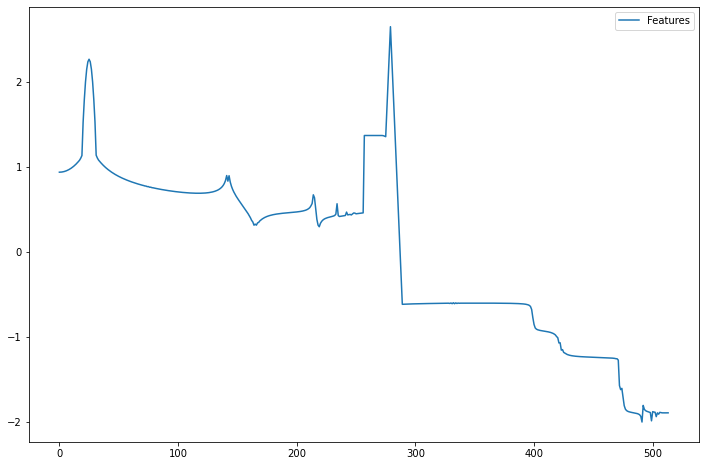

******************************************************************
Labels


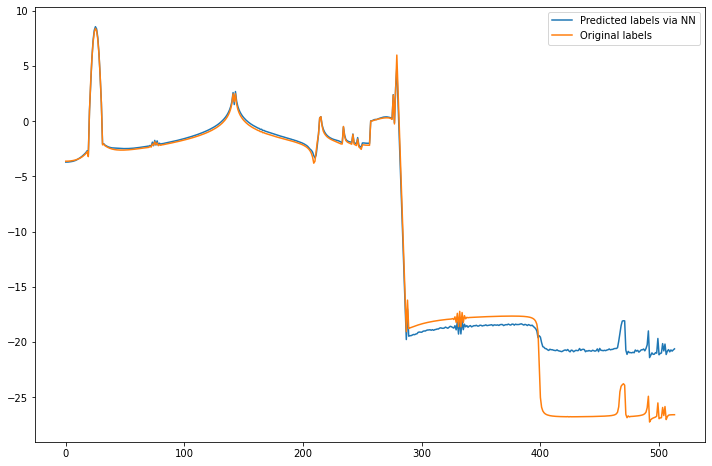

******************************************************************
Fields


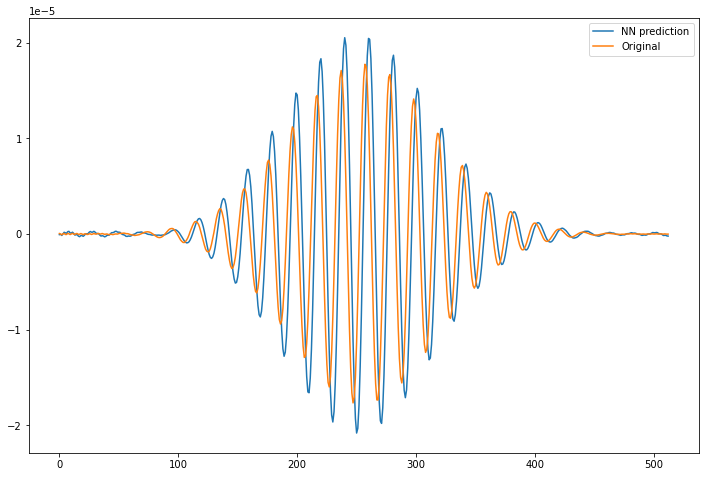

******************************************************************
Spectra


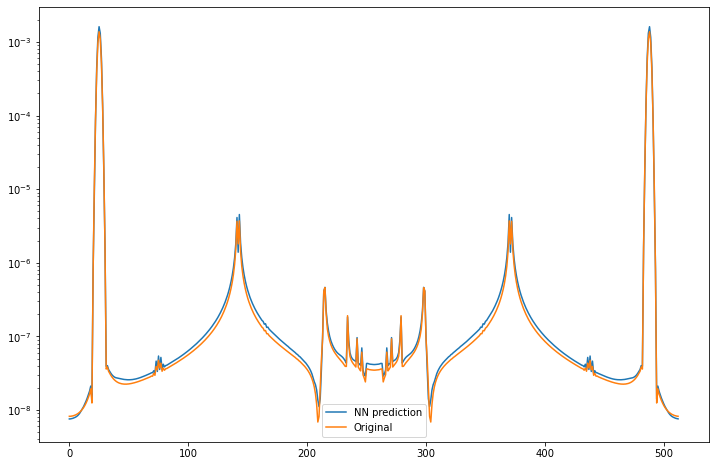

******************************************************************
Phases


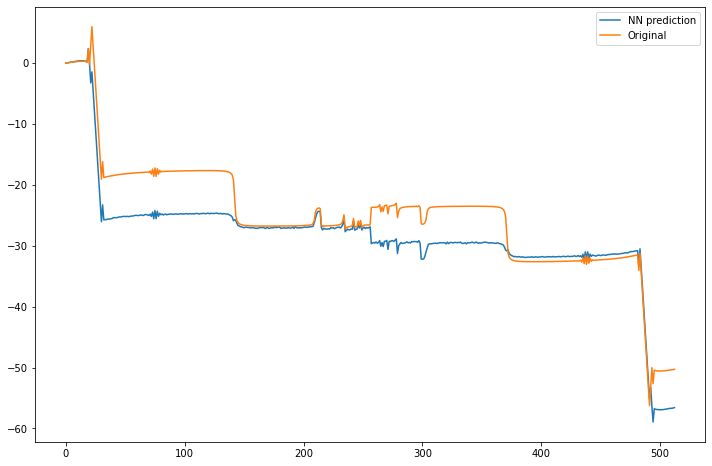

In [274]:
i = 11
y_orig = ifft(logamp_phase_reconstruction(y_test[i])).real
#y_orig = ifft(logamp_phase_reconstruction(y_test[i])).real

features = (np.expand_dims(x_test[i],0))
prediction = model.predict(features)[0]


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(x_test[i][:], label = "Features")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Apply z-score normalization on features
mean = np.mean(x_test[i][:]) # Calculate mean
std = np.std(x_test[i][:]) # Calculate standard deviation
z_score_normalized_data = (x_test[i][:] - mean) / std
print("******************************************************************")
print("Features z-normalized")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(z_score_normalized_data, label = "Features")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(prediction[:], label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test[i][:], label = "Original labels")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)
y_NN = logamp_phase_reconstruction(prediction)
y_NN = ifft(y_NN).real

print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(y_NN, label = "NN prediction")
plt.plot(y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(np.abs(fft(y_NN)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_orig)), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(np.unwrap(np.angle(fft(y_NN))), label = "NN prediction")
plt.plot(np.unwrap(np.angle(fft(y_orig))), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Larger dataset

In [3]:
x_train, y_train = load_fields("/Volumes/NEMEC_SSD/I=10e10_abinitio_x/")

In [4]:
x_test, y_test = load_fields("/Volumes/NEMEC_SSD/I=10e10_abinitio_x_dz=20000/")

In [5]:
def logamp_phase_separation(arr):
    ### Compute FFT of array
    F_arr = fft(arr)
    N = len(arr)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = np.log(np.abs(F_arr[0:N//2+1])) + 15*np.ones((N//2+1))
    ### Compute phase of the first N//2+1 points
    phases = np.angle(F_arr[0:N//2+1])/np.pi
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    return np.array([amps, phases]).flatten()
    #return np.array([amps, phases])

def logamp_phase_reconstruction(arr):
    #N = 2*len(arr[1])-1
    N = len(arr)-1
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    #amps = 20*arr[0:N//2+1]            -15*np.ones((N//2+1))
    amps = arr[0:N//2+1]           -15*np.ones((N//2+1))
    phases = arr[N//2+1:len(arr)]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    #amps = arr[0]            #-15*np.ones((N//2+1))
    #phases = arr[1]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return arr_rec

In [86]:
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

x_train_f = np.array([logamp_phase_separation(NN.spectral_filter(x, N)) for x in x_train])
y_train_f = np.array([logamp_phase_separation(NN.spectral_filter(x, N)) for x in y_train])

x_test_f = np.array([logamp_phase_separation(NN.spectral_filter(x, N)) for x in x_test])
y_test_f = np.array([logamp_phase_separation(NN.spectral_filter(x, N)) for x in y_test])


In [36]:
x_train_f.shape

(4001, 514)

In [87]:
reload(NN)

### Create custom NN model
model = NN.TDSE_NN_3((N+1,), N+1, N=514, activation=tf.nn.tanh, bias = False)
model.build(input_shape=(None, N+1))
### Print summary of the model (basic info)
model.summary()

Model: "tdse_nn_3_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_13 (InputLayer)       [(None, 514)]             0         
                                                                 
 dropout_60 (Dropout)        multiple                  0         
                                                                 
 dense_60 (Dense)            multiple                  264196    
                                                                 
 dropout_61 (Dropout)        multiple                  0 (unused)
                                                                 
 dense_61 (Dense)            multiple                  0 (unused)
                                                                 
 dropout_62 (Dropout)        multiple                  0 (unused)
                                                                 
 dense_62 (Dense)            multiple                 

In [88]:
### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train_f, y_train_f, epochs = 50)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test_f, y_test_f)

Epoch 1/50
126/126 [==============================] - 1s 6ms/step - loss: 1.1808 - accuracy: 0.3097
Epoch 2/50
126/126 [==============================] - 1s 5ms/step - loss: 0.4334 - accuracy: 0.3967
Epoch 3/50
126/126 [==============================] - 1s 5ms/step - loss: 0.2345 - accuracy: 0.4149
Epoch 4/50
126/126 [==============================] - 1s 6ms/step - loss: 0.1404 - accuracy: 0.4346
Epoch 5/50
126/126 [==============================] - 1s 6ms/step - loss: 0.1024 - accuracy: 0.4516
Epoch 6/50
126/126 [==============================] - 1s 6ms/step - loss: 0.0861 - accuracy: 0.5009
Epoch 7/50
126/126 [==============================] - 1s 6ms/step - loss: 0.0810 - accuracy: 0.5444
Epoch 8/50
126/126 [==============================] - 1s 6ms/step - loss: 0.0801 - accuracy: 0.6028
Epoch 9/50
126/126 [==============================] - 1s 6ms/step - loss: 0.0773 - accuracy: 0.6623
Epoch 10/50
126/126 [==============================] - 1s 6ms/step - loss: 0.0731 - accuracy: 0.7356

[0.045683059841394424, 1.0]

1/1 [==============================] - 0s 55ms/step
******************************************************************
Features


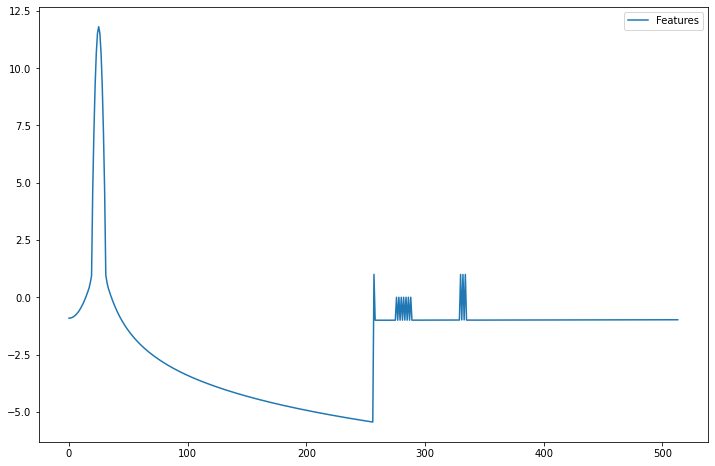

******************************************************************
Labels


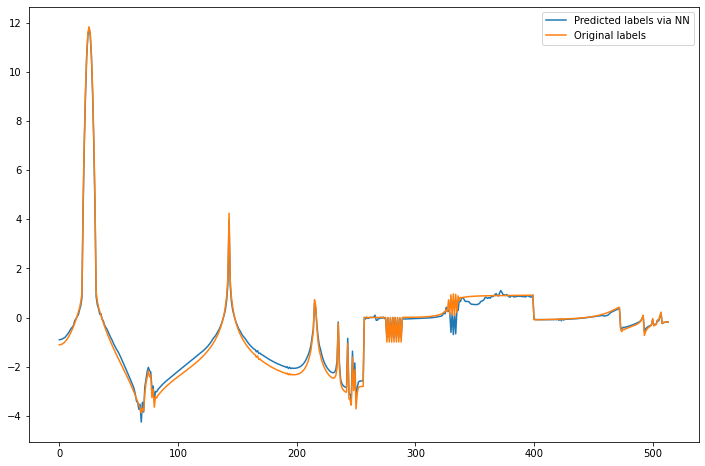

******************************************************************
Fields


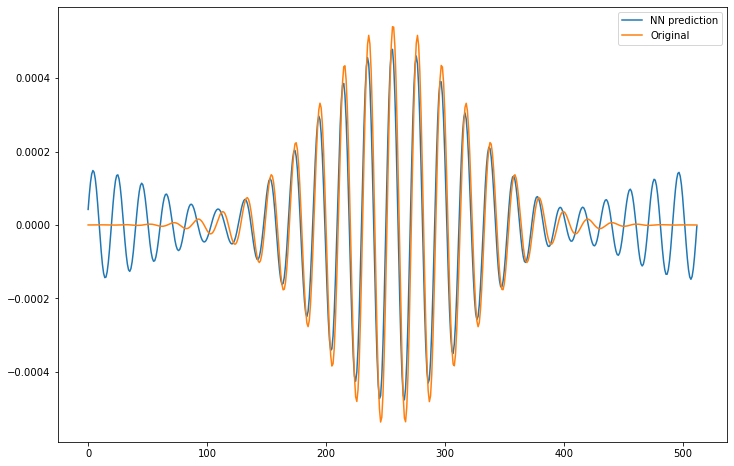

******************************************************************
Spectra


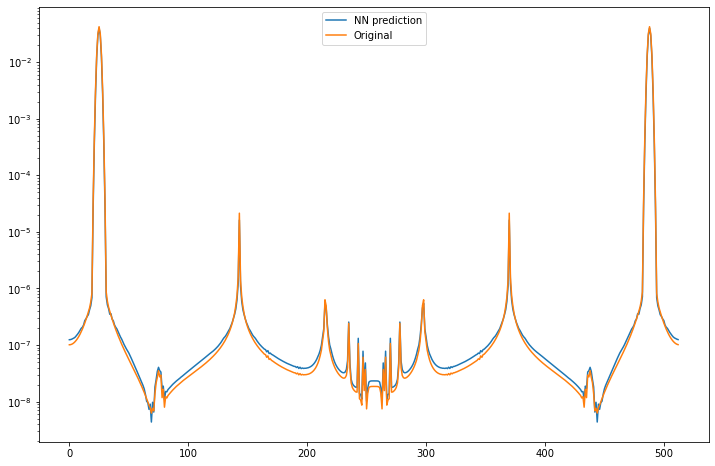

******************************************************************
Phases


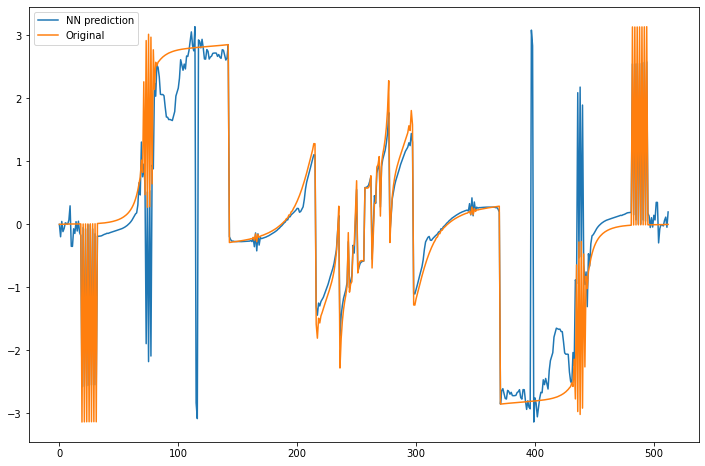

In [89]:
i = 1
y_orig = ifft(logamp_phase_reconstruction(y_test_f[i])).real
#y_orig = ifft(logamp_phase_reconstruction(y_test[i])).real

features = (np.expand_dims(x_test_f[i],0))
prediction = model.predict(features)[0]


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(x_test_f[i][:], label = "Features")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(prediction[:], label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test_f[i][:], label = "Original labels")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)
y_NN = logamp_phase_reconstruction(prediction)
y_NN = ifft(y_NN).real

print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(y_NN, label = "NN prediction")
plt.plot(y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(np.abs(fft(y_NN)), label = "NN prediction")
plt.semilogy(np.abs(fft(y_orig)), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot((np.angle(fft(y_NN))), label = "NN prediction")
plt.plot((np.angle(fft(y_orig))), label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

### NN with phase shift in data

In [147]:
from math import erf

def logamp_phase_separation(arr, T_max):
    ### Compute FFT of array
    N = len(arr)
    freqs = fftfreq(N, T_max/N)*2*np.pi
    F_arr = fft(arr)*np.exp(-1j*freqs*T_max/2)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = (np.log(np.abs(F_arr[0:N//2+1])) + 20*np.ones((N//2+1)))*30
    ### Compute phase of the first N//2+1 points
    phases = -np.unwrap(np.angle(F_arr[0:N//2+1])) + 0#/np.pi
    #phases = (np.angle(F_arr[0:N//2+1]))#/np.pi
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    return (np.array([amps, phases]).flatten() - 300)/100
    #return np.array([amps, phases])

def logamp_phase_reconstruction(arr, T_max):
    #N = 2*len(arr[1])-1
    arr*=100
    arr+=300
    N = len(arr)-1
    freqs = fftfreq(N, T_max/N)*2*np.pi
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    amps = arr[0:N//2+1]/30            -20*np.ones((N//2+1))
    phases = -(arr[N//2+1:len(arr)]-0)
    ### Size of the resulting array is (2*len(amplitudes)-1)
    #amps = arr[0]            #-15*np.ones((N//2+1))
    #phases = arr[1]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases)#*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return arr_rec*np.exp(1j*freqs*T_max/2)

def erf_filter(time):
    t_max = time[-1]
    return (1-np.array(list(map(erf, (d.t-t_max+t_max/6)/(t_max/30)))))/2

def erf_filter2(time):
    t_max = time[-1]
    return (1+np.array(list(map(erf, (d.t-t_max/6)/(t_max/30)))))/2

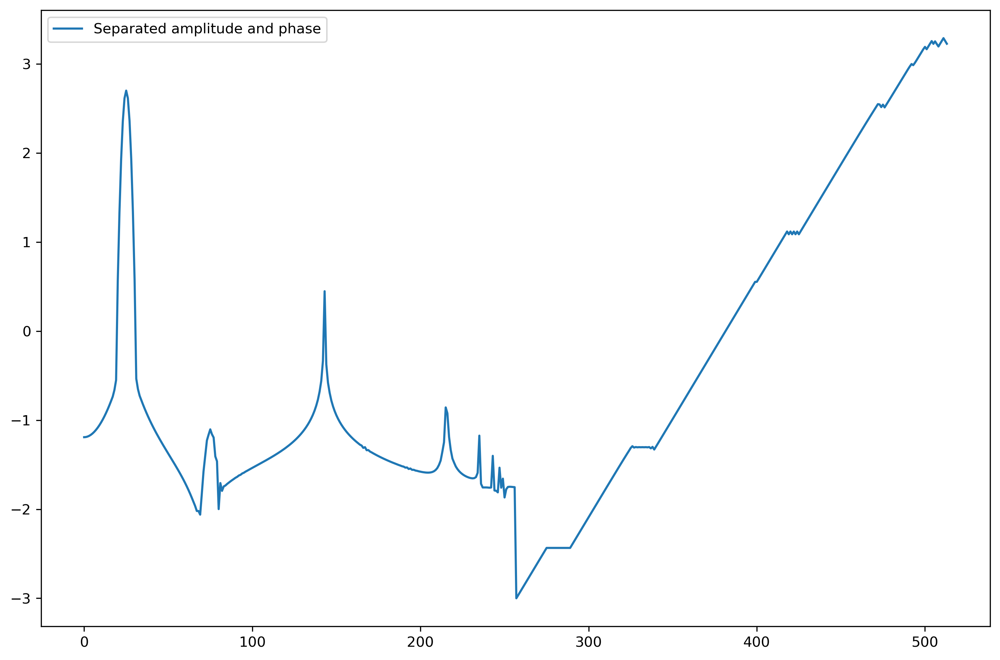

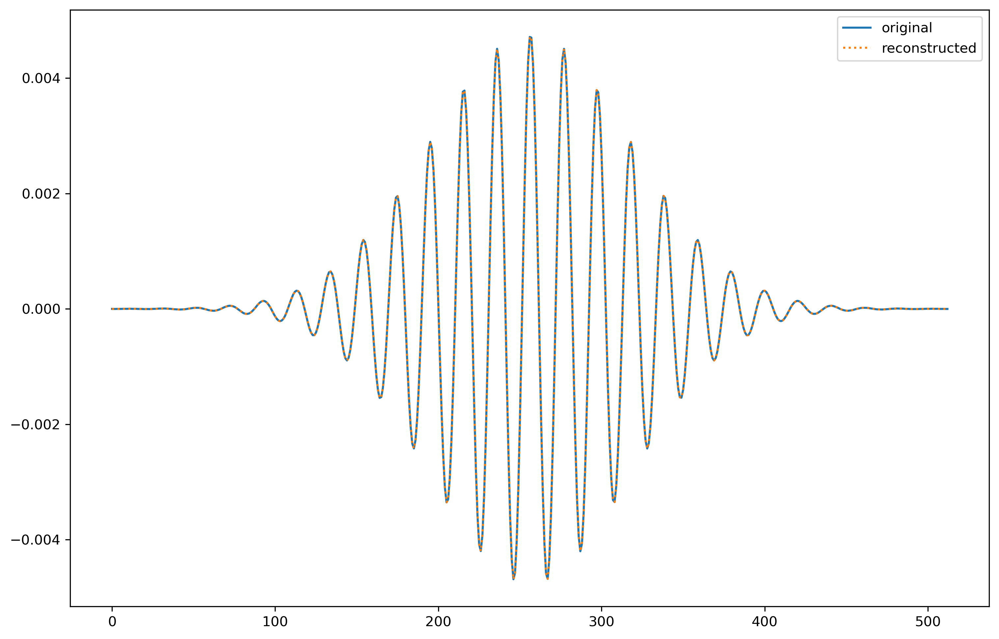

*********************************************
Are the arrays the same?
True


In [148]:
d = Data("/Volumes/NEMEC_SSD/I=10e10_abinitio_x_dz=20000/data_k1_1.h5")
#d = Data("tmp/data_k1_1.h5")
#d = Data("data_0.h5")
%matplotlib inline
#src = erf_filter2(d.t)*(-d.E_z-d.grad_pot)*erf_filter(d.t)
#src = -d.E_z-d.grad_pot
src = d.d_z
N = 513
y = NN.spectral_filter(src, N)
y_separated = logamp_phase_separation(y, d.t[-1])

fig = plt.figure()
plt.plot(y_separated, label = "Separated amplitude and phase")
#plt.plot(y_separated[1], label = "Separated amplitude and phase")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

y_rec = logamp_phase_reconstruction(y_separated, d.t[-1])


y_rec = ifft(y_rec).real

fig = plt.figure()
plt.plot(y[:], label = "original")
plt.plot(y_rec[:], label = "reconstructed", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("*********************************************")
print("Are the arrays the same?")
print(np.allclose(y, y_rec))

In [55]:
### Loading the datasets
dset_train = util.load_dataset("tmp/test_low_intensity_0_25dz/")
dset_test = util.load_dataset("tmp/test_low_intensity/")


In [149]:
reload(NN)

### Number of points for the input and output layers
N = 512 + 1

### Prepare datasets
x_train = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N), d.t[-1]) for d in dset_train])
y_train = np.array([logamp_phase_separation(NN.spectral_filter(d.d_z, N), d.t[-1]) for d in dset_train])

x_test = np.array([logamp_phase_separation(NN.spectral_filter(d.E_z, N), d.t[-1]) for d in dset_test])
y_test = np.array([logamp_phase_separation(NN.spectral_filter(d.d_z, N), d.t[-1]) for d in dset_test])

### Create custom NN model
model = NN.TDSE_NN_3((N+1,), N+1, N=1024, activation=tf.nn.tanh)
model.build(input_shape=(None, N+1))
### Print summary of the model (basic info)
model.summary()


Model: "tdse_nn_3_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None, 514)]             0         
                                                                 
 dropout_75 (Dropout)        multiple                  0         
                                                                 
 dense_75 (Dense)            multiple                  526336    
                                                                 
 dropout_76 (Dropout)        multiple                  0         
                                                                 
 dense_76 (Dense)            multiple                  1048576   
                                                                 
 dropout_77 (Dropout)        multiple                  0 (unused)
                                                                 
 dense_77 (Dense)            multiple                 

In [150]:
### Compile model
model.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model.fit(x_train, y_train, epochs = 400)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test, y_test)

Epoch 1/400
11/11 [==============================] - 1s 26ms/step - loss: 1.9314 - accuracy: 0.0903
Epoch 2/400
11/11 [==============================] - 0s 26ms/step - loss: 1.3698 - accuracy: 0.1277
Epoch 3/400
11/11 [==============================] - 0s 31ms/step - loss: 1.2242 - accuracy: 0.1838
Epoch 4/400
11/11 [==============================] - 0s 29ms/step - loss: 1.1585 - accuracy: 0.1620
Epoch 5/400
11/11 [==============================] - 0s 37ms/step - loss: 1.0819 - accuracy: 0.2305
Epoch 6/400
11/11 [==============================] - 0s 31ms/step - loss: 1.0336 - accuracy: 0.1963
Epoch 7/400
11/11 [==============================] - 0s 27ms/step - loss: 0.9917 - accuracy: 0.1807
Epoch 8/400
11/11 [==============================] - 0s 29ms/step - loss: 0.9408 - accuracy: 0.2679
Epoch 9/400
11/11 [==============================] - 0s 27ms/step - loss: 0.9080 - accuracy: 0.1651
Epoch 10/400
11/11 [==============================] - 0s 28ms/step - loss: 0.8553 - accuracy: 0.1745

[0.04810981824994087, 1.0]

1/1 [==============================] - 0s 71ms/step
******************************************************************
Features


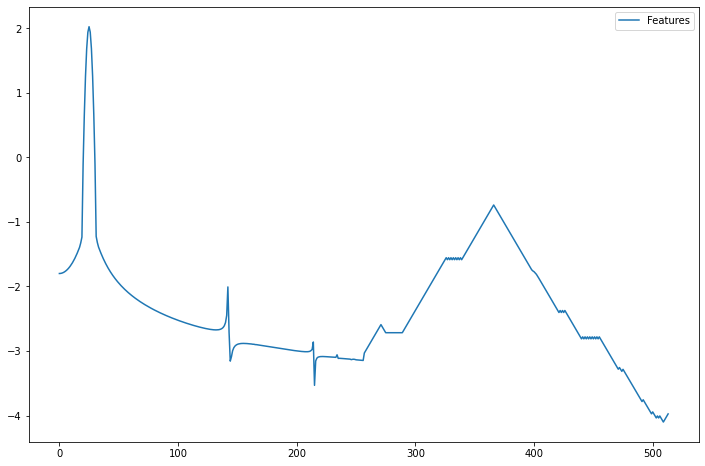

******************************************************************
Labels


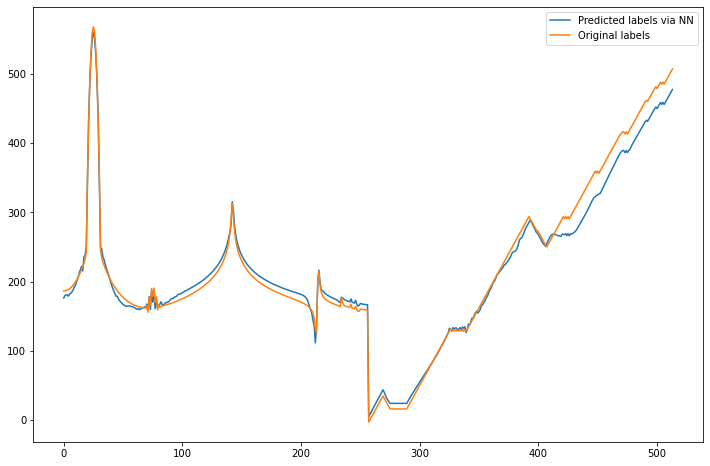

******************************************************************
Fields


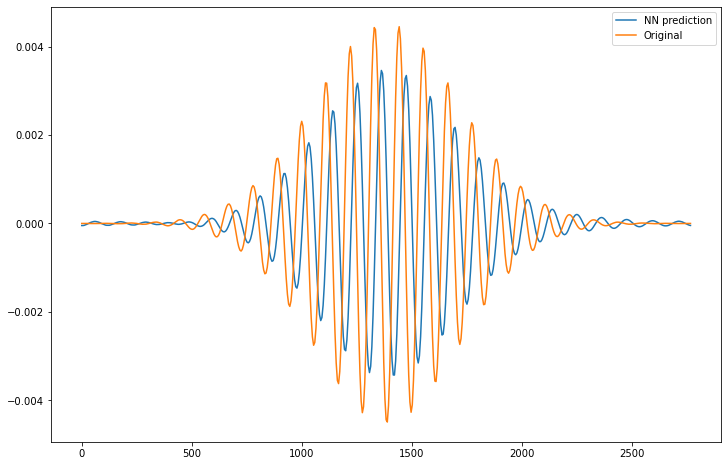

******************************************************************
Spectra


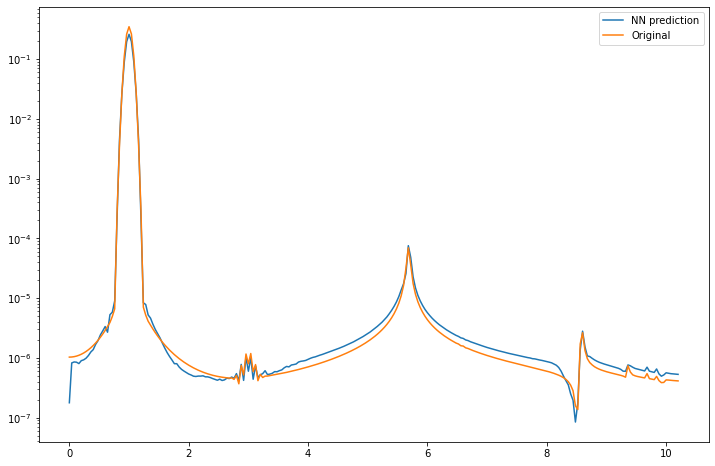

******************************************************************
Phases


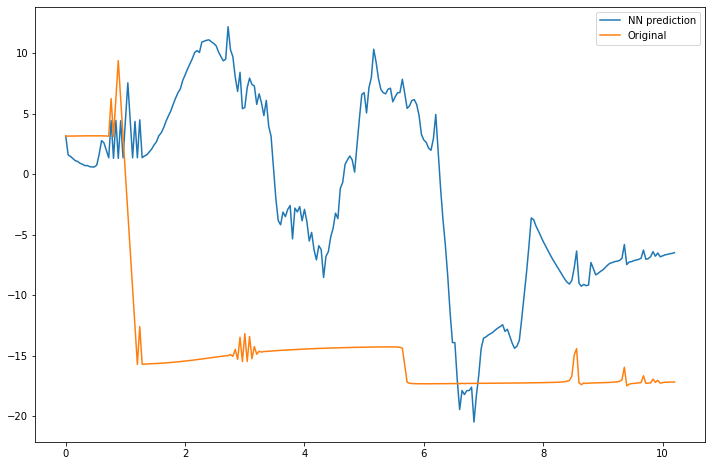

In [151]:
i = 2
y_orig = ifft(logamp_phase_reconstruction(y_test[i], dset_test[i].t[-1])).real
#y_orig = ifft(logamp_phase_reconstruction(y_test[i])).real

features = (np.expand_dims(x_test[i],0))
prediction = model.predict(features)[0]

y_NN = logamp_phase_reconstruction(prediction, dset_test[i].t[-1])
y_NN = ifft(y_NN).real

N = len(y_NN)
t = np.linspace(0, dset_test[i].t[-1], N)
freqs = fftfreq(N, dset_test[i].t[-1]/N)*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(x_test[i][:], label = "Features")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(prediction[:], label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test[i][:], label = "Original labels")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t, y_NN, label = "NN prediction")
plt.plot(t, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Separation of real and imaginary part of the source

In [3]:
from math import erf
import cmath

def n_th_root(arr, n):
    arr = [np.sign(x)*np.abs(x)**n for x in arr]
    arr = [cmath.rect(np.abs(x), cmath.phase(x)).real for x in arr]
    return np.array(arr)

### Temporal filter
def filter(arr, t):
    t_max = t[-1]
    arr = arr* (1-np.array(list(map(erf, (t-t_max+t_max/4)/(t_max/20)))))/2
    return arr

def filter2(arr, t):
    t_max = t[-1]
    M = len(t)
    shift = t_max/6
    #shift = t_max/5.
    slope = t_max/30
    #slope = t_max/14
    arr[:M//2] = arr[:M//2] * (1+np.array(list(map(erf, (t[:M//2]-shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/6)/(t_max/15)))))/2
    arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/7)/(t_max/25)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/4)/(t_max/20)))))/2
    #arr = arr * (1-np.array(list(map(erf, (t-t_max+t_max/5)/(t_max/12)))))/2
    return arr

### Real and imaginary part separation
def fft_real_imag_separation(arr, t, n = 3):
    N = len(arr)
    dt = t[1]-t[0]
    T = t[-1]
    freqs = fftfreq(len(arr), dt)*2*np.pi
    FF = fft(arr)
    FF *= np.exp(-1j*freqs*T/2)
    real_ = FF.real[0:N//2+1]
    imag_ = FF.imag[0:N//2+1]
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

### Real and imaginary part reconstruction
def fft_real_imag_reconstruction(real, imag, t, n = 3):
    #real = 20*real
    #imag = 20*imag
    dt = t[1]-t[0]
    T = t[-1]
    N = 2*len(real)-1
    res = 1j*np.zeros((N))
    FF = real**n + 1j*imag**n
    FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    res[0:N//2+1] = FF
    res[N//2+1:N] = FF_conj
    freqs = fftfreq(len(res), dt)*2*np.pi
    res = res*np.exp(1j*freqs*T/2)
    return ifft(res).real

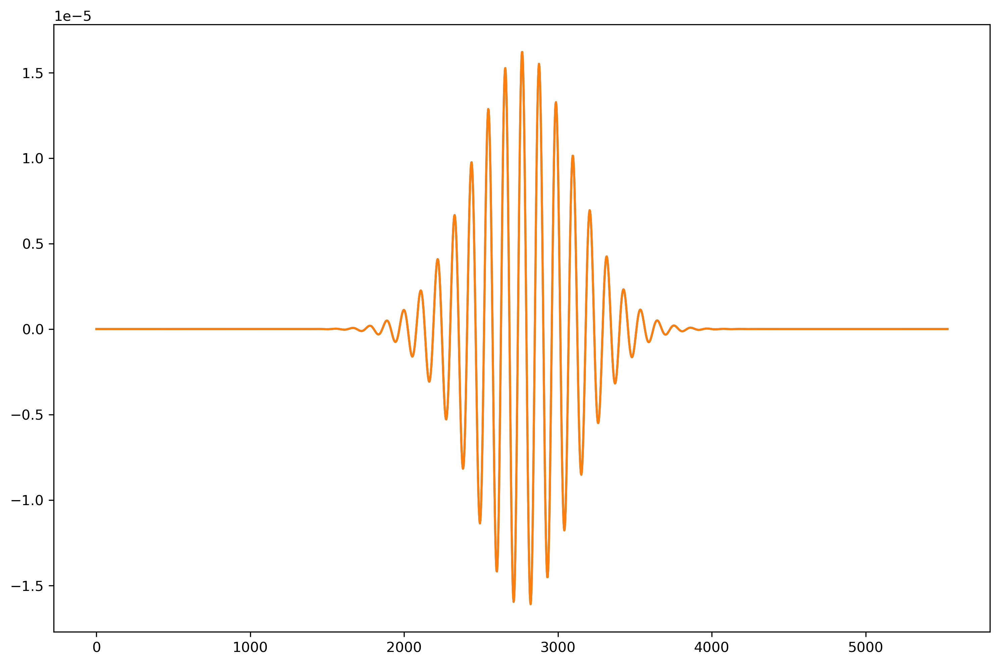

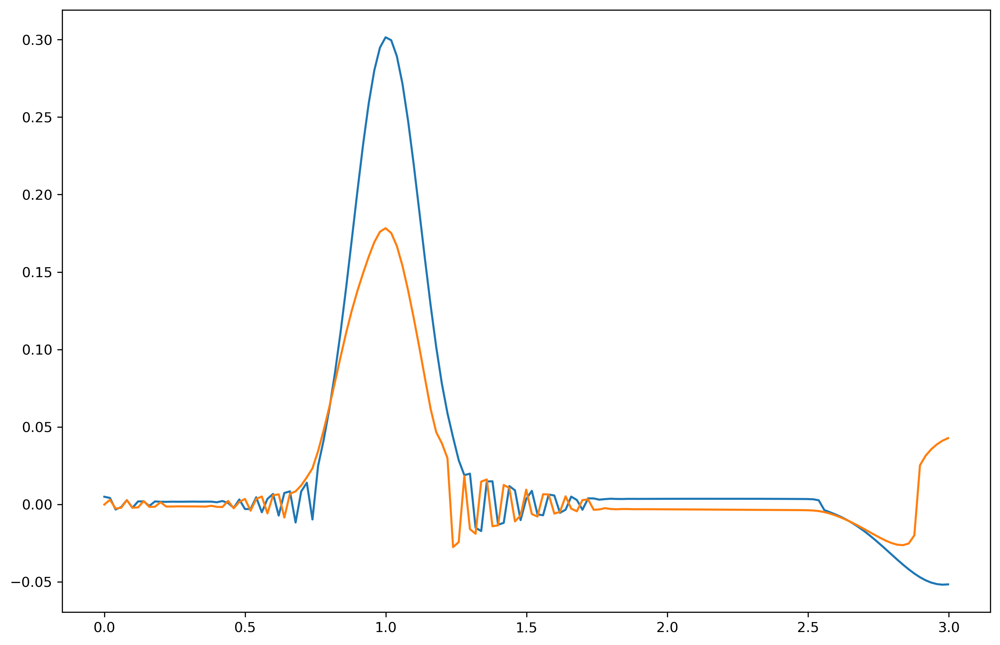

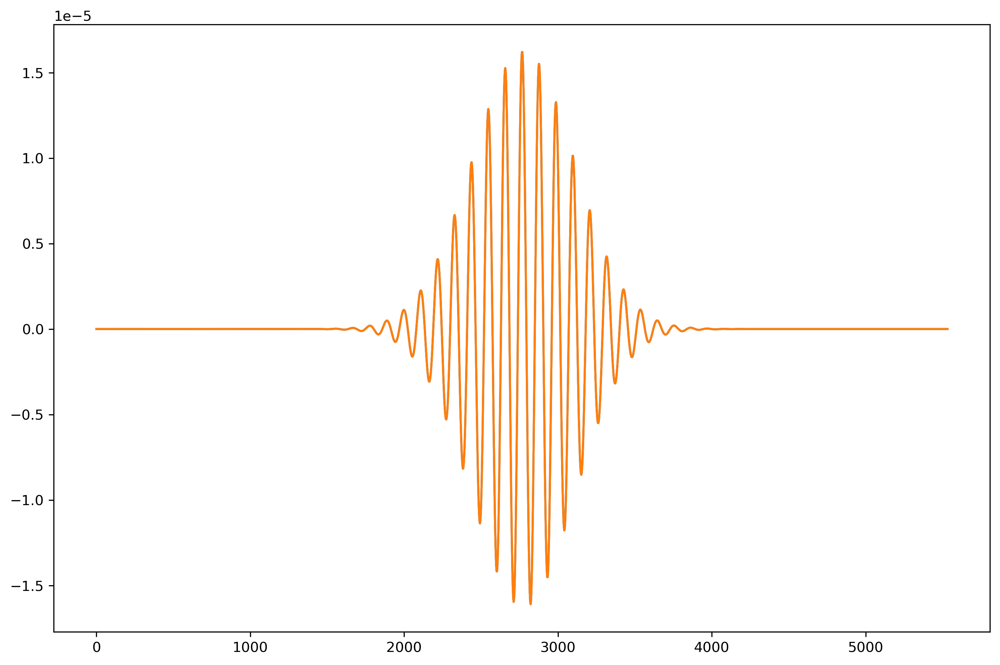

True


In [5]:
#d = Data("/Volumes/NEMEC_SSD/I=1e14_ai_dz=20000/data_0.h5")
d = Data("/Volumes/NEMEC_SSD/1e10_dz=50000_x/data_k1_1000.h5")
N = 2049
f = tools.filter(np.ones((len(d.t))), d.t)
src = NN.spectral_filter(-d.E_z - d.grad_pot.real, N)
src_filtered = NN.spectral_filter(-f*d.E_z - f*d.grad_pot.real, N)
#src_filtered = blackman(2049)*NN.spectral_filter(-d.E_z - filter(d.grad_pot.real, d.t), N)
#src_filtered = gaussian(N,N/5)*NN.spectral_filter(filter(-d.E_z - d.grad_pot.real, d.t), N)

t = np.linspace(d.t[0], d.t[-1], len(src))

fig = plt.figure()
plt.plot(t, src)
plt.plot(t, src_filtered)
fig.dpi = 300
fig.set_size_inches(12, 8)
plt.show()


real, imag = fft_real_imag_separation(src_filtered, t, n = 5)
freqs = fftfreq(len(real), 2*(t[1]-t[0]))*2*np.pi/0.0568
range_ = (freqs >= 0) & (freqs < 3.)
fig = plt.figure()
plt.plot(freqs[range_], real[range_])
plt.plot(freqs[range_], imag[range_])
fig.dpi = 300
fig.set_size_inches(12, 8)
plt.show()


src_reconstructed = fft_real_imag_reconstruction(real, imag, t, n = 5)
fig = plt.figure()
plt.plot(t, src_reconstructed)
plt.plot(t, src_filtered)
fig.dpi = 300
fig.set_size_inches(12, 8)
plt.show()

print(np.allclose(src_filtered, src_reconstructed))

In [251]:
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/I=1e10_ai_dz=50000/")
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")

In [252]:
dataset.shape

(801, 2, 25601)

In [253]:
np.random.shuffle(dataset)

In [254]:
x_train, x_test = dataset[:640], dataset[640:]

In [170]:
x_train.shape

(640, 2, 25601)

In [154]:
x_train[:,1,:].shape

(640, 25601)

In [275]:
### Number of points for the input and output layers
#N = 2049
#N = 4097
N = 1025
t_f = np.linspace(t[0], t[-1], N)
x_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(x, N), t_f, n = 5) for x in x_train[:,0]])
#y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(filter(x, t), N), t_f) for x in x_train[:,1,:]])
#y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(-x-filter(y, t), N), t_f, n = 5) for (x, y) in zip(x_train[:,0], x_train[:,1])])
#y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(filter(y[1],t), N), t_f, n = 5) for y in x_train[:i+1]])
#y_train_f = []
#for x in x_train[:i+1]:    
#    print(-x[0]-filter(x[1],t))
#    print(np.allclose(x[0], x[1]))
#    print(np.allclose(x[1], filter(x[1], t)))
#    print(-x[0]-x[1])
#    y_train_f.append(fft_real_imag_separation(np.array(-x[0] - filter(x[1], t)), t, n = 5))
#y_train_f = np.array(y_train_f)
#y_train_f = -x_train[:,0] - filter(x_train[:,1], t)
#y_train_f = np.array([NN.spectral_filter(x, N) for x in y_train_f])
#y_train_f = np.array([fft_real_imag_separation(x, t_f, n = 5) for x in y_train_f])
y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(-filter(y[1], t)-y[0], N), t_f, n = 5) for y in x_train])
#y_train_f = np.array([fft_real_imag_separation(-filter(y[1],t)-y[0], t, n = 5) for y in x_train[:i+1]])
#y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(y[1], N), t_f, n = 5) for y in x_train[:i+1]])
x_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(x, N), t_f, n = 5) for x in x_test[:,0]])
#y_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(filter(x, t), N), t_f) for x in x_test[:,1,:]])
#y_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(-x-filter(y, t), N), t_f, n = 5) for (x, y) in zip(x_test[:,0], x_test[:,1])])
y_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(-filter(y[1], t)-y[0], N), t_f, n = 5) for y in x_test])

(640, 2, 513)
(640, 513)
(513,)
(161, 2, 513)
(161, 2, 513)


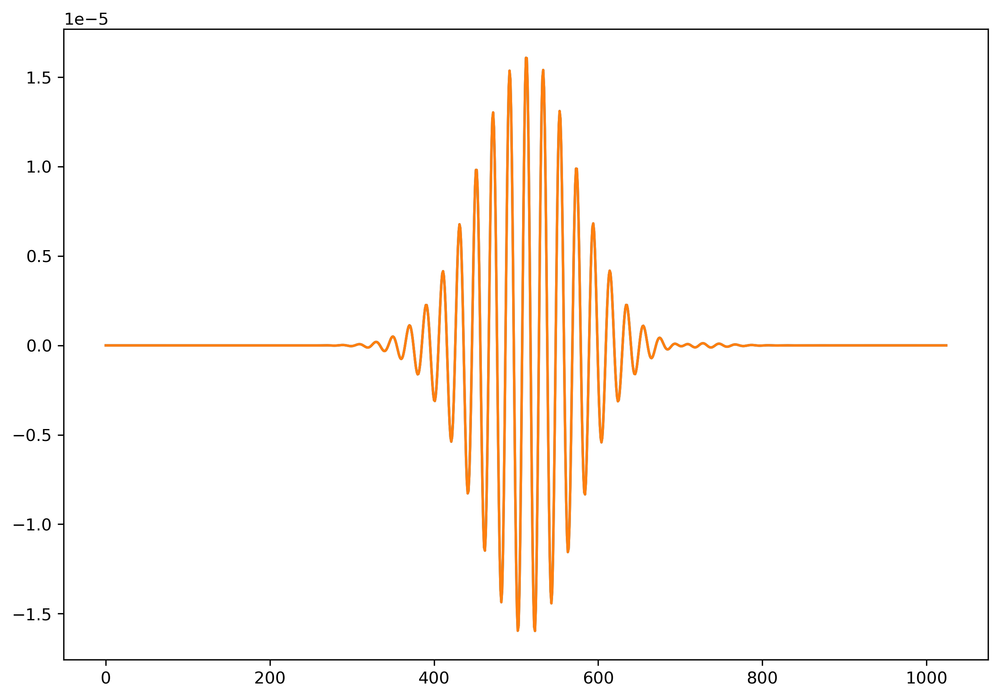

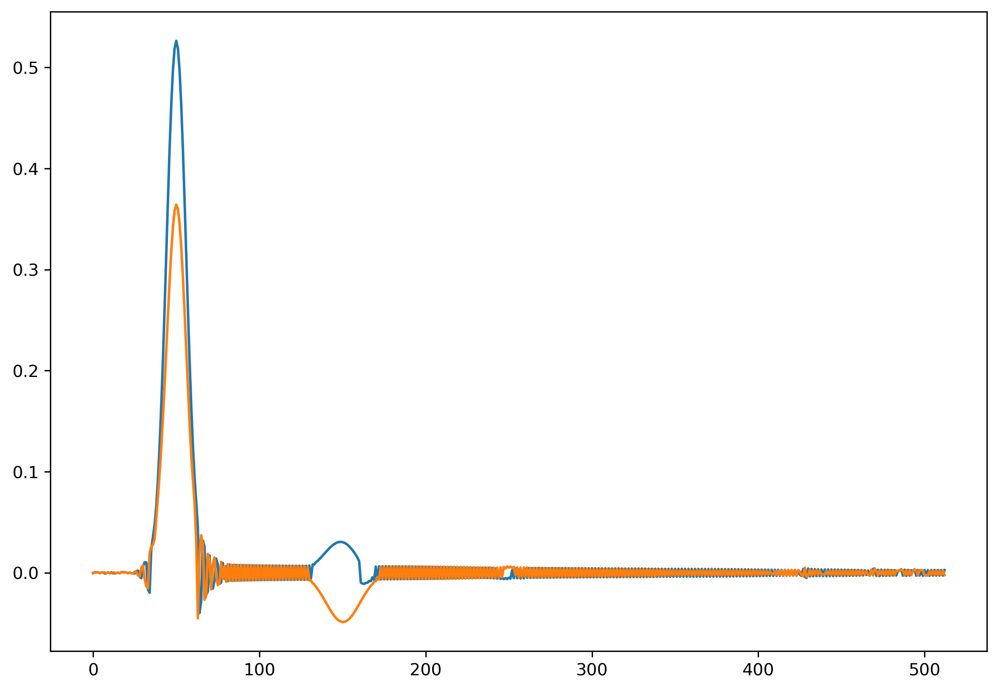

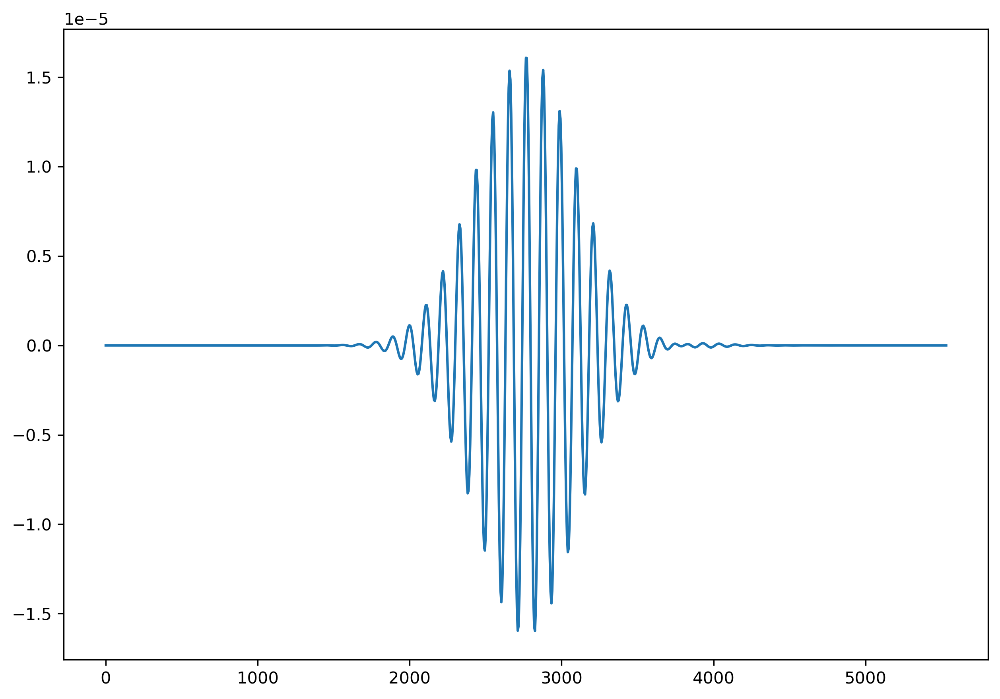

In [266]:
print(y_train_f.shape)
print(y_train_f[:,1,:].shape)
print(y_train_f[1,1].shape)
print(y_test_f.shape)
print(x_test_f.shape)

i = 2-1
fig = plt.figure()
src = NN.spectral_filter(-x_train[i,0]-filter(x_train[i,1], t), N)
plt.plot(src)
x = fft_real_imag_separation(src, t_f)
plt.plot(fft_real_imag_reconstruction(x[0], x[1], t_f))
fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()


fig = plt.figure()
plt.plot(x_train_f[i,0])
plt.plot(x_train_f[i,1])
fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()

fig = plt.figure()
rec = fft_real_imag_reconstruction(y_test_f[i,0], y_test_f[i,1], t_f, n = 5)
#rec = fft_real_imag_reconstruction(y_train_f[i,0], y_train_f[i,1], t)
plt.plot(t_f, rec)
x = fft_real_imag_separation(src, t_f)
#plt.plot(t_f, fft_real_imag_reconstruction(x[0], x[1], t_f))
#plt.plot(t, rec)
#plt.plot(t_f, filter(rec, t_f))
fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()

In [282]:
reload(NN)

### Create custom NN model
model_real = NN.TDSE_NN_4((N//2+1,), N=256, activation=tf.nn.tanh, bias = True)
model_real.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_real.summary()

model_imag = NN.TDSE_NN_4((N//2+1,), N=256, activation=tf.nn.tanh, bias = True)
model_imag.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_imag.summary()

Model: "tdse_nn_4_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 513)]             0         
                                                                 
 dropout_112 (Dropout)       multiple                  0         
                                                                 
 dense_112 (Dense)           multiple                  131584    
                                                                 
 dropout_113 (Dropout)       multiple                  0         
                                                                 
 dense_113 (Dense)           multiple                  65792     
                                                                 
 dropout_114 (Dropout)       multiple                  0         
                                                                 
 dense_114 (Dense)           multiple                 

In [283]:
epochs = 1000

### Compile model
model_real.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_real = model_real.fit(x_train_f[:,0], y_train_f[:,0], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=400)])

### Quantify the accuracy of the model on the test data
model_real.evaluate(x_test_f[:,0,:], y_test_f[:,0,:])


### Compile model
model_imag.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_imag = model_imag.fit(x_train_f[:,1], y_train_f[:,1], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=400)])

### Quantify the accuracy of the model on the test data
model_imag.evaluate(x_test_f[:,1], y_test_f[:,1])

Epoch 1/1000
20/20 [==============================] - 2s 7ms/step - loss: 0.2244 - accuracy: 0.0016
Epoch 2/1000
20/20 [==============================] - 0s 8ms/step - loss: 0.1265 - accuracy: 0.0031
Epoch 3/1000
20/20 [==============================] - 0s 9ms/step - loss: 0.0699 - accuracy: 0.0047
Epoch 4/1000
20/20 [==============================] - 0s 10ms/step - loss: 0.0415 - accuracy: 0.0109
Epoch 5/1000
20/20 [==============================] - 0s 9ms/step - loss: 0.0265 - accuracy: 0.0063
Epoch 6/1000
20/20 [==============================] - 0s 8ms/step - loss: 0.0189 - accuracy: 0.0297
Epoch 7/1000
20/20 [==============================] - 0s 7ms/step - loss: 0.0135 - accuracy: 0.0359
Epoch 8/1000
20/20 [==============================] - 0s 8ms/step - loss: 0.0103 - accuracy: 0.0375
Epoch 9/1000
20/20 [==============================] - 0s 9ms/step - loss: 0.0080 - accuracy: 0.0750
Epoch 10/1000
20/20 [==============================] - 0s 8ms/step - loss: 0.0066 - accuracy: 0.107

[7.78491266828496e-06, 1.0]

1/1 [==============================] - 0s 44ms/step
******************************************************************
Features


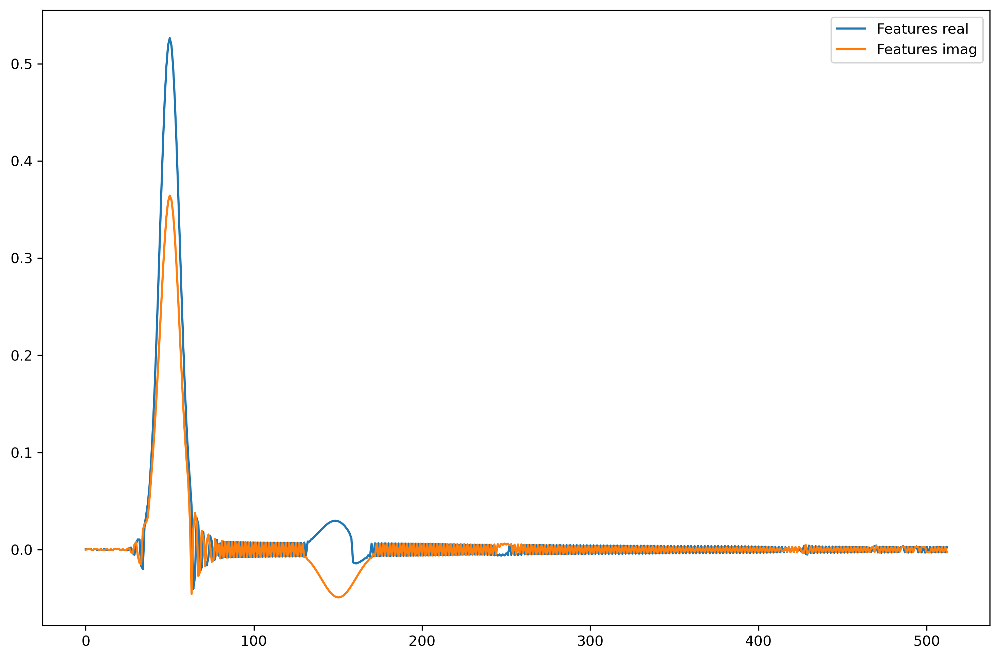

******************************************************************
Labels


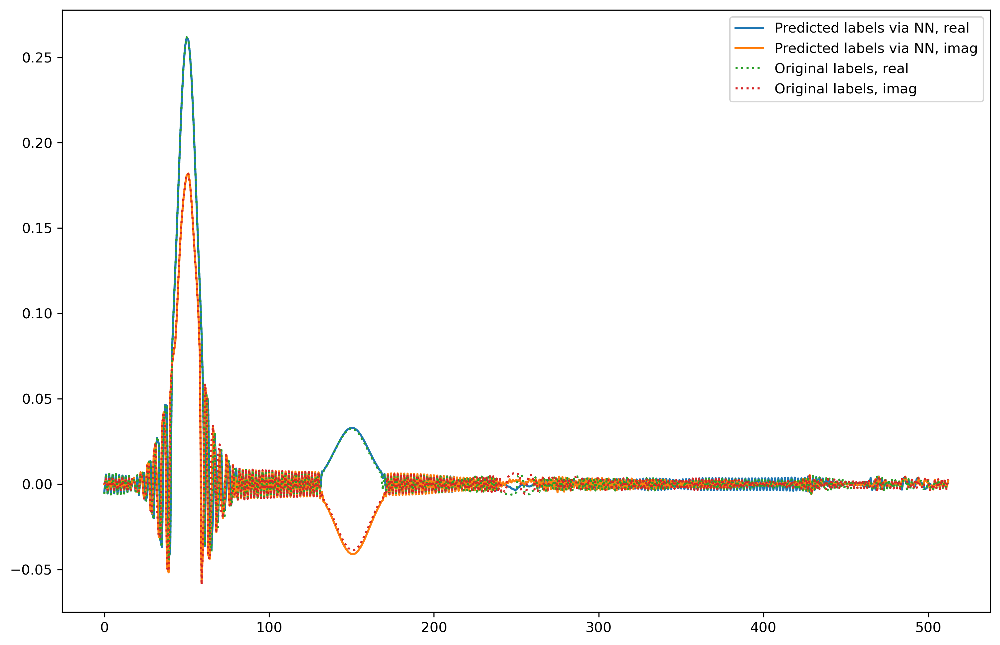

******************************************************************
Fields


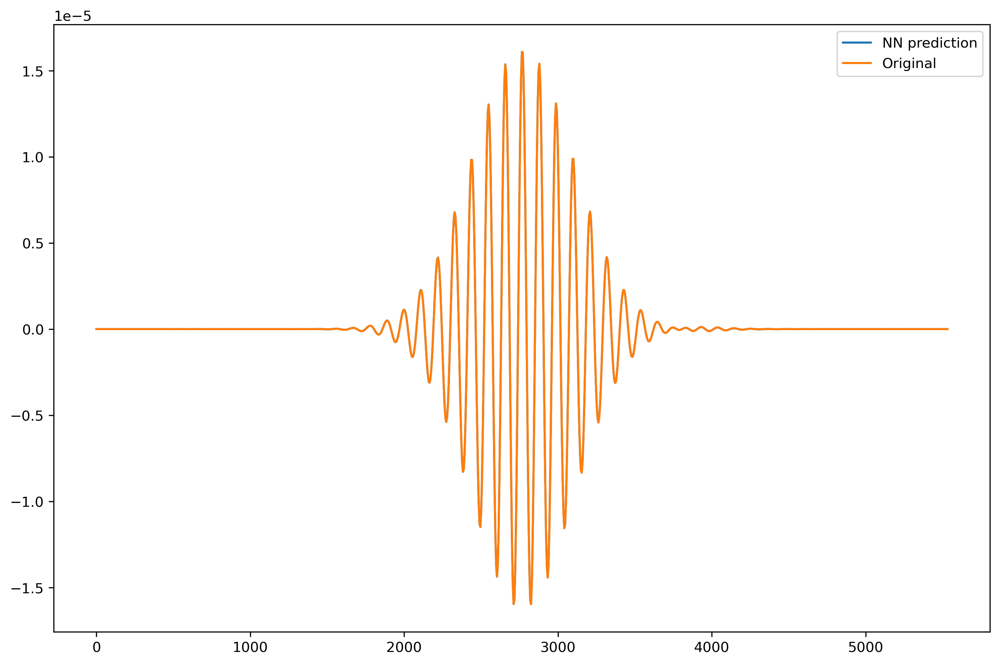

******************************************************************
Fields closeup


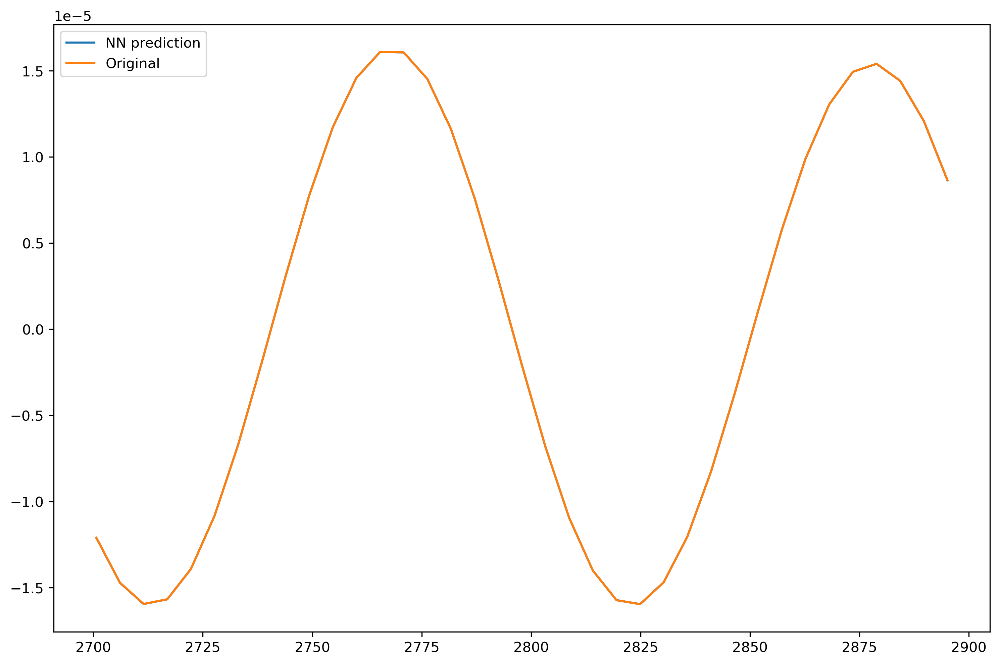

******************************************************************
Spectra


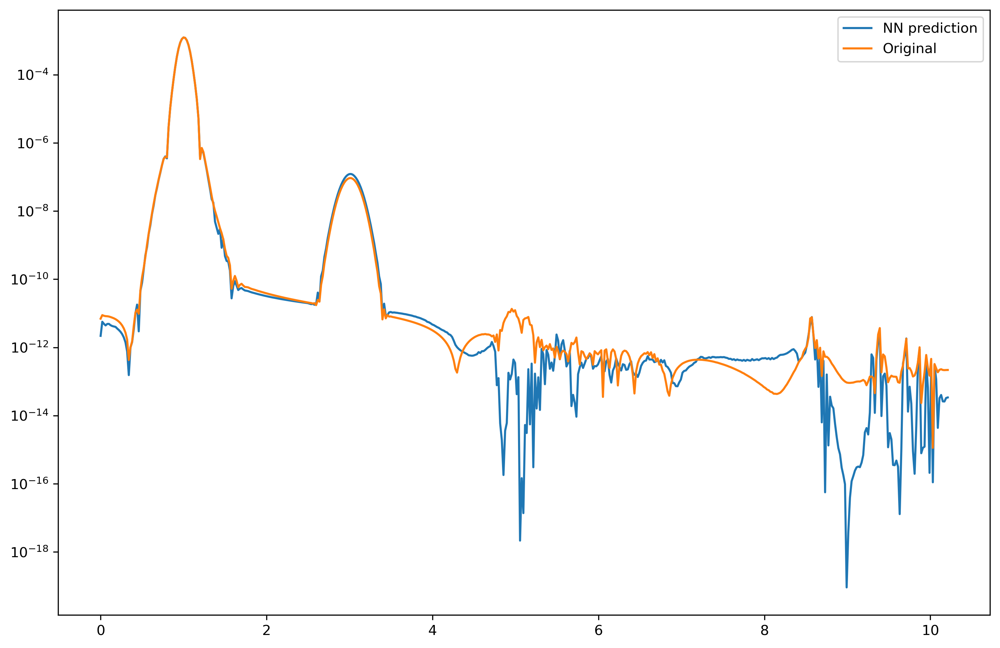

******************************************************************
Phases


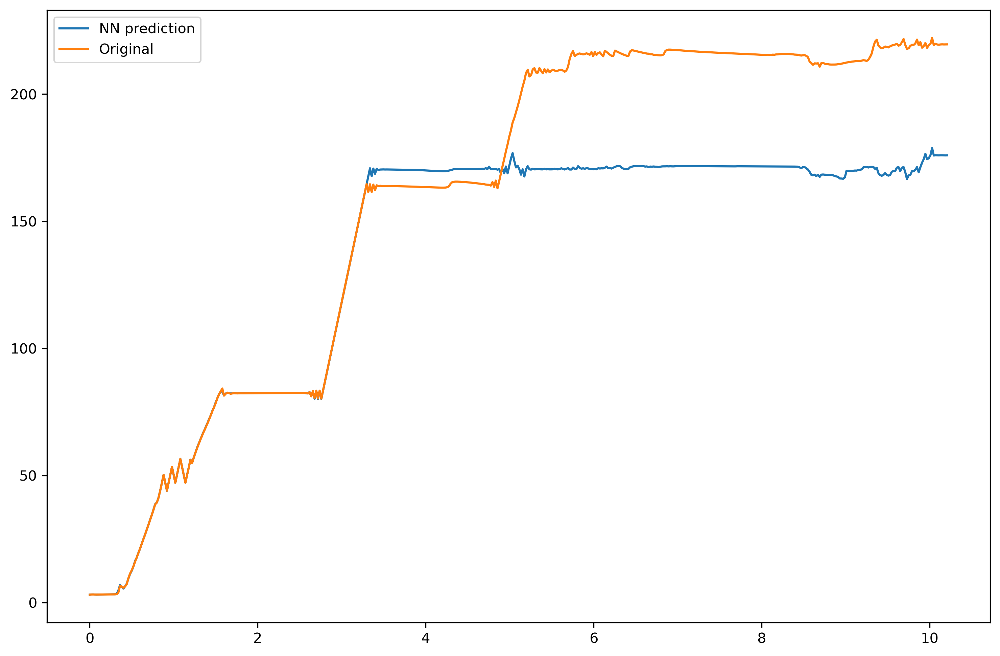

******************************************************************
Statistics


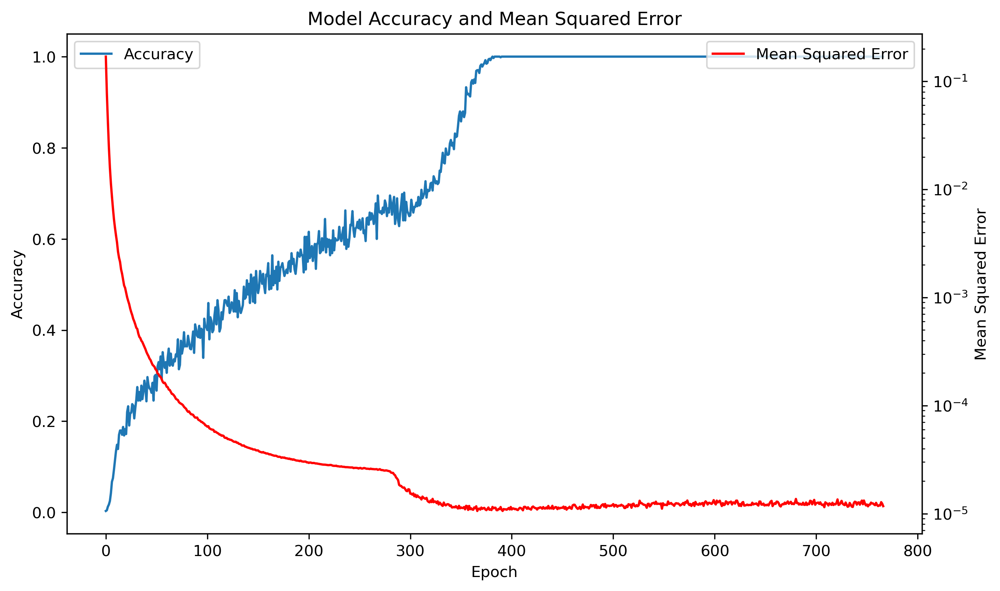

In [309]:
%matplotlib inline
i = 100
features_real = (np.expand_dims(x_test_f[i,0],0))
features_imag = (np.expand_dims(x_test_f[i,1],0))
real_ = model_real.predict(features_real)[0]
imag_ = model_imag.predict(features_imag)[0]

y_NN = fft_real_imag_reconstruction(real_, imag_, t_f, n = 5)
y_orig = fft_real_imag_reconstruction(y_test_f[i, 0], y_test_f[i, 1], t_f, n = 5)

N = len(y_NN)
freqs = fftfreq(N, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(features_real[-1], label = "Features real")
plt.plot(features_imag[-1], label = "Features imag")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(real_, label = "Predicted labels via NN, real")
plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test_f[i,0], label = "Original labels, real", linestyle = ":")
plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_NN, label = "NN prediction")
plt.plot(t_f, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history_imag.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history_imag.history['accuracy'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history_imag.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# Playing w/ NN

### Different data preparation

In [763]:
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=100000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000_x/")
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e14_dz=25000/")

In [764]:
dataset.shape

(401, 2, 25601)

In [765]:
np.random.shuffle(dataset)
#x_train, x_test = dataset[:640], dataset[640:]
x_train, x_test = dataset[:340], dataset[340:]
#x_train, x_test = dataset[:3500], dataset[500:]

In [766]:
### Number of points for the input and output layers
N = 2049
#N = 1025
n = 5
t_f = np.linspace(t[0], t[-1], N)
f = tools.filter(np.ones((len(t))), t)
x_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n) for x in x_train[:,0]])
y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1) for y in x_train])
x_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n) for x in x_test[:,0]])
y_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1) for y in x_test])

(1, 1025)
(1, 1025, 1)
(1, 256, 1)
******************************************************************
Features


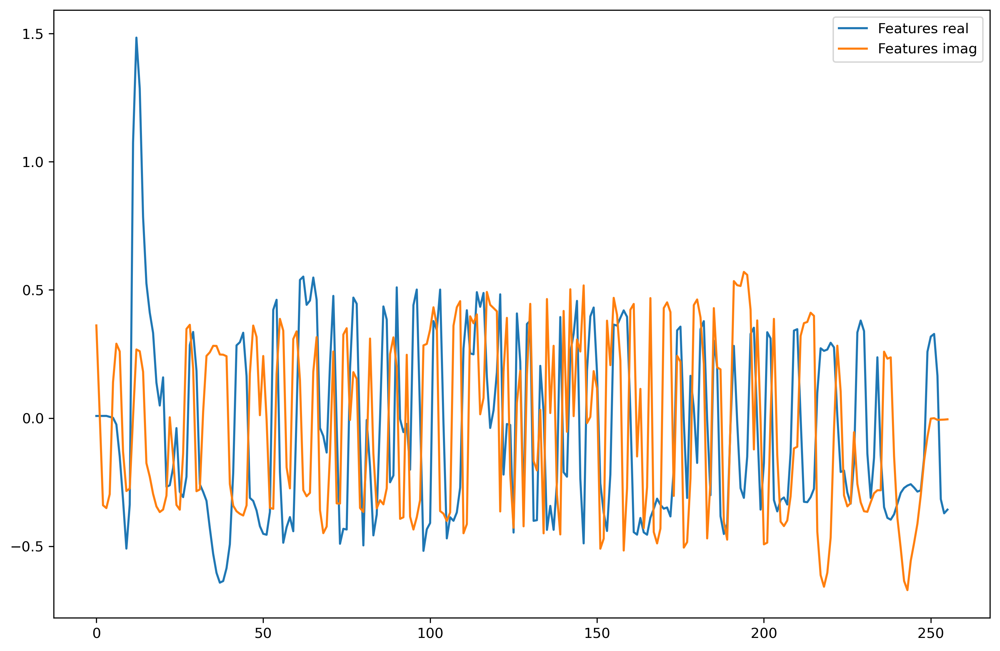

In [767]:
i = 10
features_real = np.expand_dims(x_test_f[i,0],0)
#features_real = np.expand_dims(y_test_f[i,0],0)
features_imag = np.expand_dims(x_test_f[i,1],0)
#features_imag = np.expand_dims(y_test_f[i,1],0)
print(features_imag.shape)
features_real = np.expand_dims(features_real, axis=2)
features_imag = np.expand_dims(features_imag, axis=2)
print(features_imag.shape)
M = len(features_imag[0,:])
m = 4

pool_layer = tf.keras.layers.MaxPool1D(m)
pool_layer = tf.keras.layers.AvgPool1D(m)
features_real = pool_layer(features_real)
features_imag = pool_layer(features_imag)
print(features_imag.shape)
#real_ = model_real2.predict(features_real)[0]
#imag_ = model_imag2.predict(features_imag)[0]

#y_NN = fft_real_imag_reconstruction(real_, imag_, t_f, n = n)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, 0], y_test_f[i, 1], t_f, n = n)

freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(features_real[0,:], label = "Features real")
plt.plot(features_imag[0,:], label = "Features imag")
#plt.plot(freqs[0:N//2+1][0:-1:m], features_real[0,:], label = "Features real")
#plt.plot(freqs[0:N//2+1][0:-1:m], features_imag[0,:], label = "Features imag")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

In [768]:
reload(NN)

### Create custom NN model
model_real2 = NN.TDSE_NN_4((N//2+1,), N//2+1, N=128, activation=tf.nn.tanh, bias = True, dropout=0.5, dropout_input=0.6)
model_real2.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_real2.summary()

model_imag2 = NN.TDSE_NN_4((N//2+1,), N//2+1, N=128, activation=tf.nn.tanh, bias = True, dropout=0.5, dropout_input=0.6)
model_imag2.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_imag2.summary()

Model: "tdse_nn_4_251"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_252 (InputLayer)      [(None, 1025)]            0         
                                                                 
 dropout_3610 (Dropout)      multiple                  0         
                                                                 
 dense_3793 (Dense)          multiple                  131328    
                                                                 
 dropout_3611 (Dropout)      multiple                  0         
                                                                 
 dense_3794 (Dense)          multiple                  16512     
                                                                 
 dropout_3612 (Dropout)      multiple                  0         
                                                                 
 dense_3795 (Dense)          multiple                

In [769]:
epochs = 1000
patience = 100
patience = 25

### Compile model
model_real2.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_real2 = model_real2.fit(x_train_f[:,0], y_train_f[:,0], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)])

### Quantify the accuracy of the model on the test data
model_real2.evaluate(x_test_f[:,0,:], y_test_f[:,0,:])


### Compile model
model_imag2.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_imag2 = model_imag2.fit(x_train_f[:,1], y_train_f[:,1], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)])

### Quantify the accuracy of the model on the test data
model_imag2.evaluate(x_test_f[:,1], y_test_f[:,1])

Epoch 1/1000
11/11 [==============================] - 2s 9ms/step - loss: 0.0995 - accuracy: 0.0000e+00
Epoch 2/1000
11/11 [==============================] - 0s 7ms/step - loss: 0.0747 - accuracy: 0.0088
Epoch 3/1000
11/11 [==============================] - 0s 7ms/step - loss: 0.0563 - accuracy: 0.0000e+00
Epoch 4/1000
11/11 [==============================] - 0s 8ms/step - loss: 0.0411 - accuracy: 0.0059
Epoch 5/1000
11/11 [==============================] - 0s 7ms/step - loss: 0.0305 - accuracy: 0.0088
Epoch 6/1000
11/11 [==============================] - 0s 8ms/step - loss: 0.0219 - accuracy: 0.0029
Epoch 7/1000
11/11 [==============================] - 0s 7ms/step - loss: 0.0162 - accuracy: 0.0147
Epoch 8/1000
11/11 [==============================] - 0s 6ms/step - loss: 0.0121 - accuracy: 0.0176
Epoch 9/1000
11/11 [==============================] - 0s 6ms/step - loss: 0.0092 - accuracy: 0.0147
Epoch 10/1000
11/11 [==============================] - 0s 7ms/step - loss: 0.0070 - accuracy

[0.00014558382099494338, 0.7704917788505554]

1/1 [==============================] - 0s 115ms/step
******************************************************************
Features


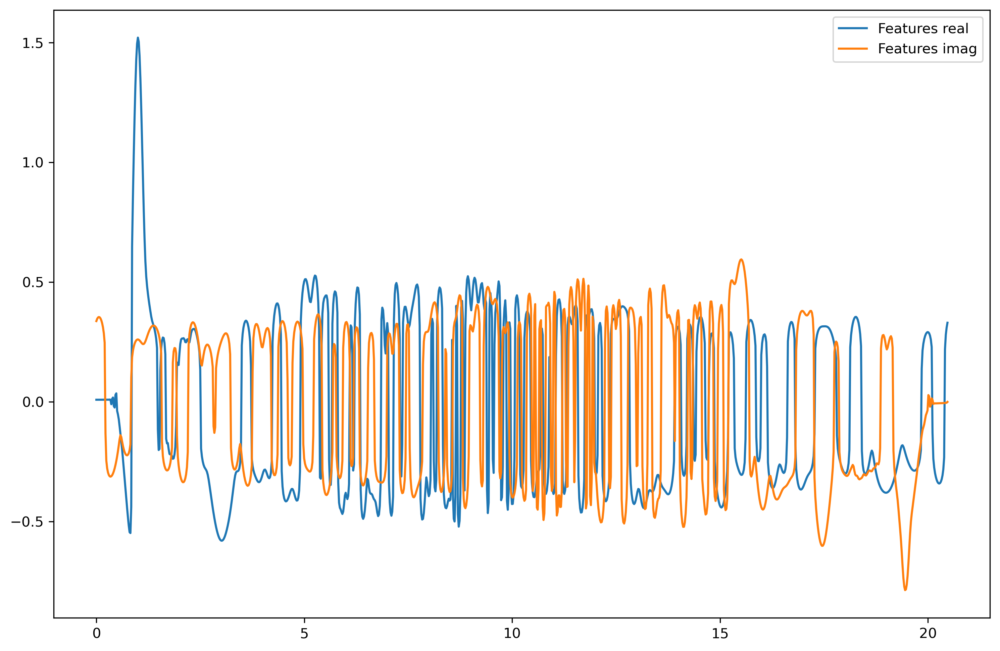

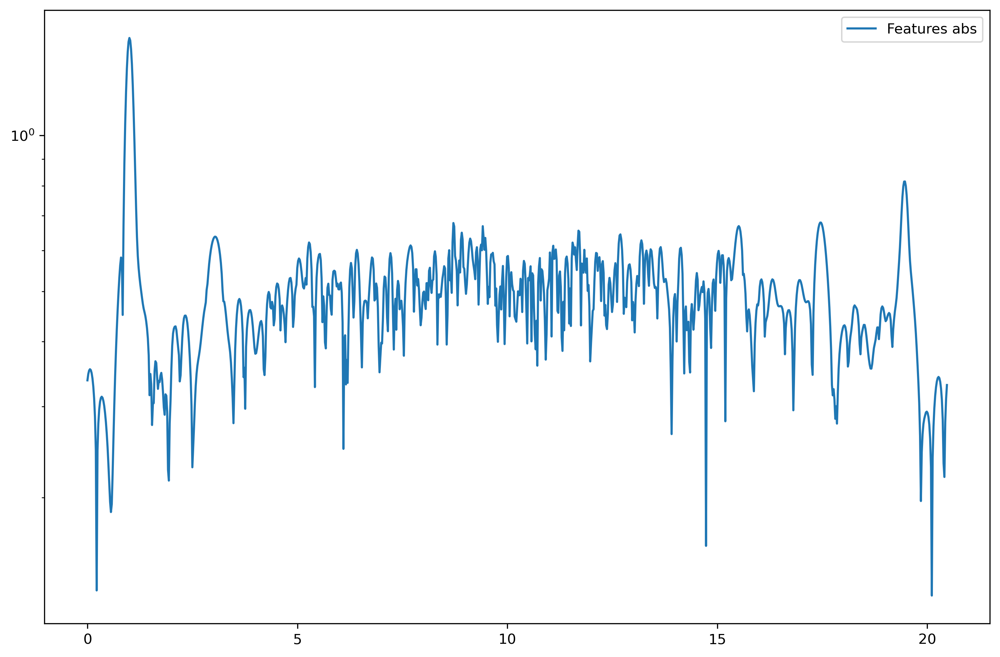

******************************************************************
Labels


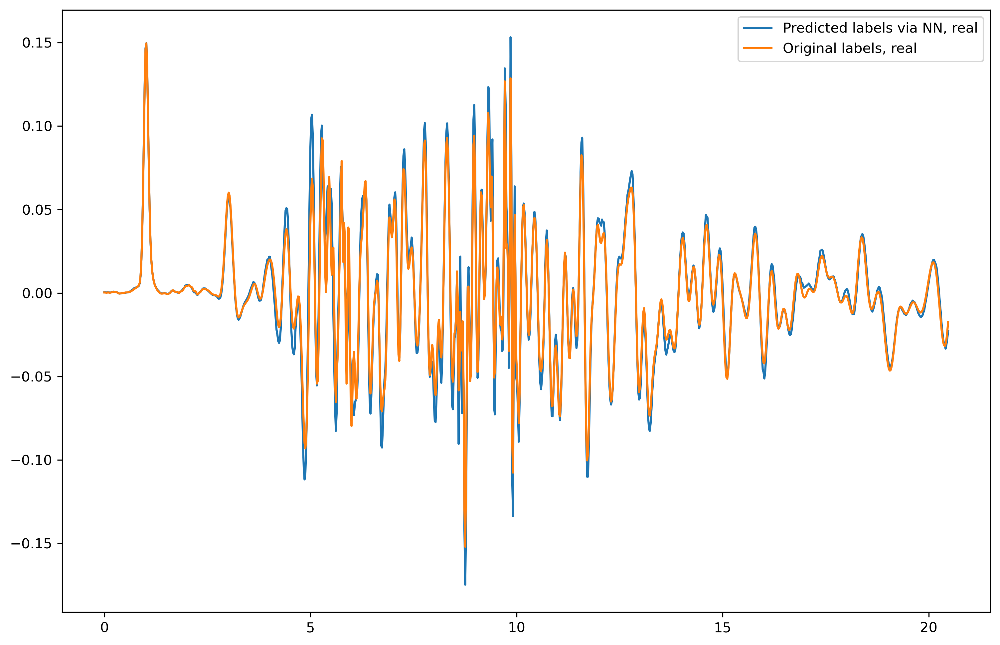

******************************************************************
Fields


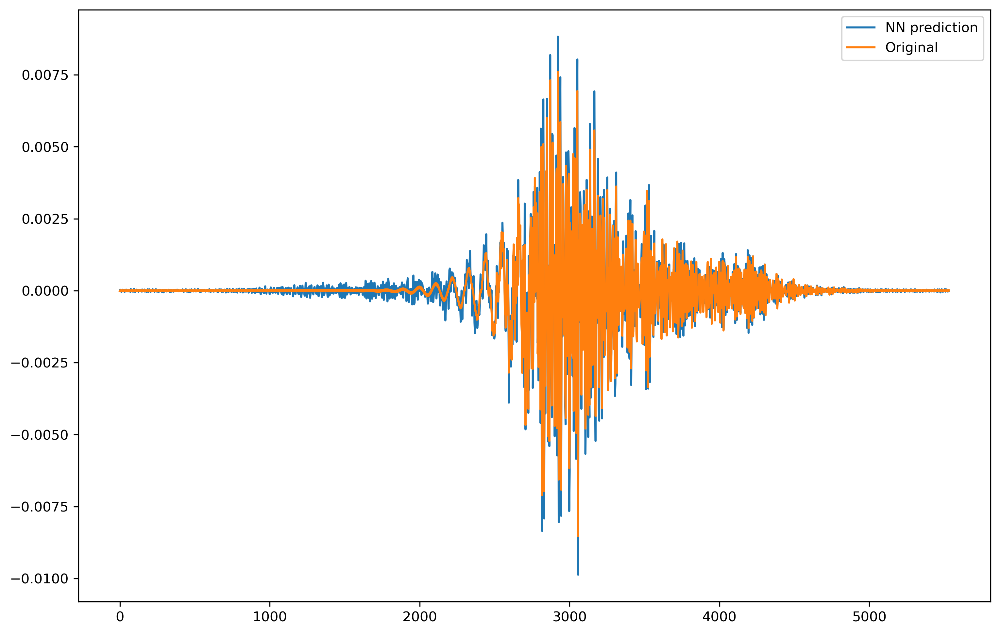

******************************************************************
Fields closeup


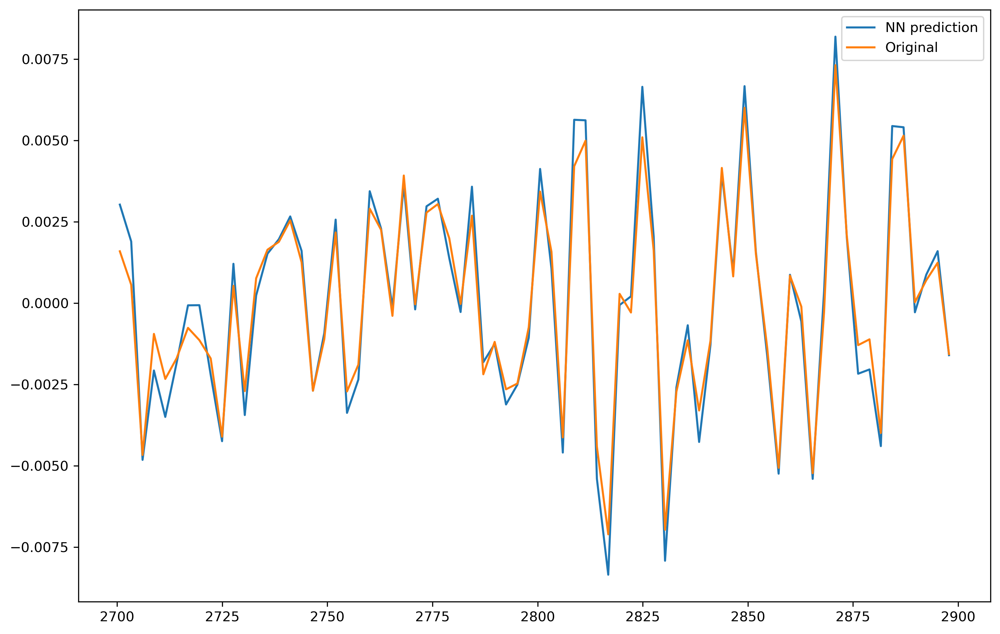

******************************************************************
Spectra


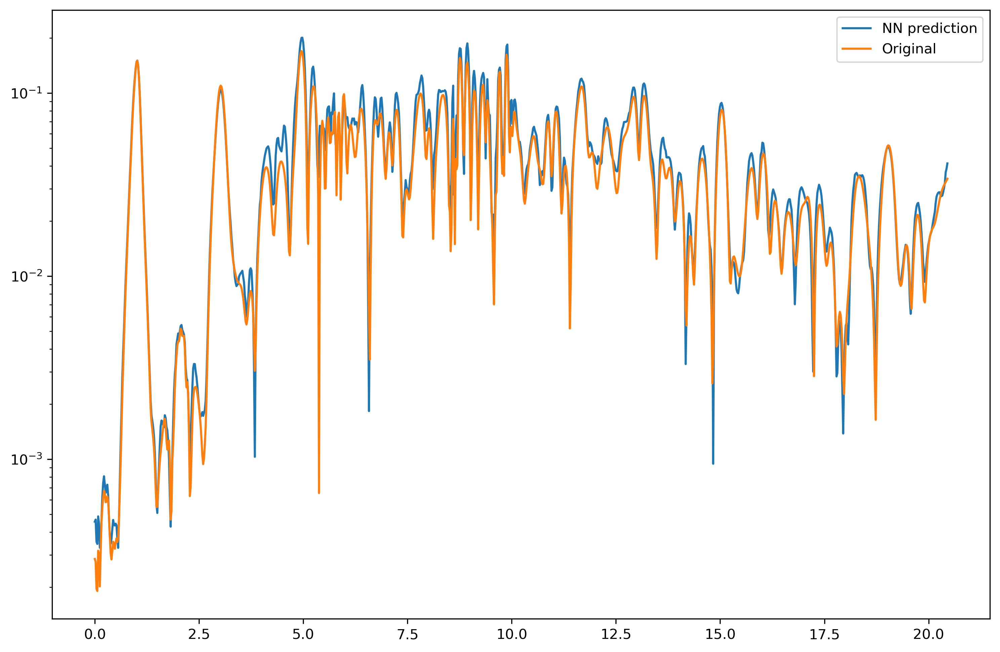

******************************************************************
Phases


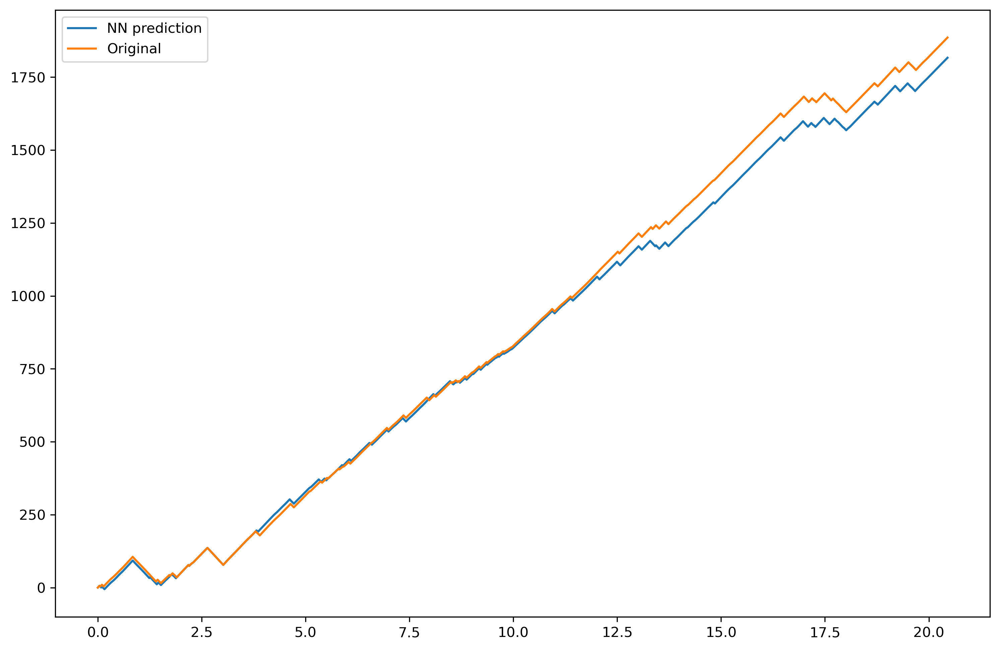

******************************************************************
Statistics


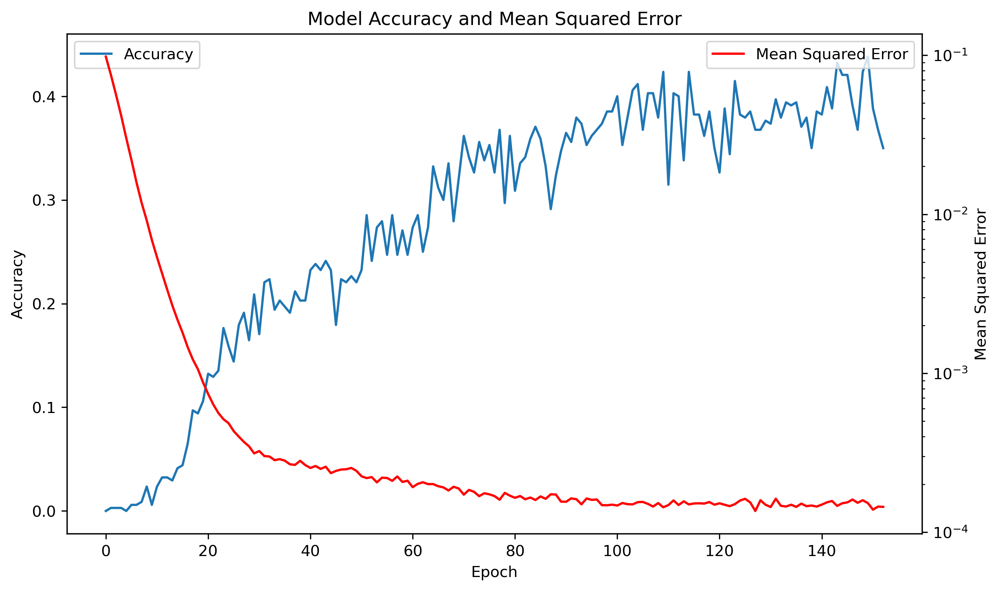

In [770]:
#%matplotlib qt
i = 14
features_real = (np.expand_dims(x_test_f[i,0],0))
features_imag = (np.expand_dims(x_test_f[i,1],0))
real_ = model_real2.predict(features_real)[0]
imag_ = model_imag2.predict(features_imag)[0]

y_NN = fft_real_imag_reconstruction(real_, imag_, t_f, n = n)
y_NN = fft_real_imag_reconstruction(real_, imag_, t_f, n = 1)
y_orig = fft_real_imag_reconstruction(y_test_f[i, 0], y_test_f[i, 1], t_f, n = n)
y_orig = fft_real_imag_reconstruction(y_test_f[i, 0], y_test_f[i, 1], t_f, n = 1)

N = len(y_NN)
freqs = fftfreq(N, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(freqs[0:N//2+1], features_real[-1], label = "Features real")
plt.plot(freqs[0:N//2+1], features_imag[-1], label = "Features imag")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.semilogy(freqs[0:N//2+1], np.abs(features_real[-1]+1j*features_imag[-1]), label = "Features abs")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()




print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(freqs[0:N//2+1], real_, label = "Predicted labels via NN, real")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(freqs[0:N//2+1], y_test_f[i,0], label = "Original labels, real", linestyle = "-")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_NN, label = "NN prediction")
plt.plot(t_f, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history_imag2.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history_imag2.history['accuracy'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history_imag2.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# NN with real and imaginary parts, output real and imag

In [800]:

### Real and imaginary part separation
def fft_real_imag_separation2(arr, t, z, n = 3):
    N = len(arr)
    dt = t[1]-t[0]
    T = t[-1]
    freqs = fftfreq(len(arr), dt)*2*np.pi
    FF = fft(arr)
    K = 8.372e-8
    FF *= np.exp(1j*freqs*T/2+1j*K*z*freqs)
    real_ = FF.real[0:N//2+1]
    imag_ = (FF.imag[0:N//2+1])
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

### Real and imaginary part reconstruction
def fft_real_imag_reconstruction2(real, imag, t, z, n = 3):
    #real = 20*real
    #imag = 20*imag
    dt = t[1]-t[0]
    T = t[-1]
    N = 2*len(real)-1
    res = 1j*np.zeros((N))
    FF = real**n + 1j*(imag)**n
    FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    res[0:N//2+1] = FF
    res[N//2+1:N] = FF_conj
    freqs = fftfreq(len(res), dt)*2*np.pi
    K = 8.372e-8
    res = res*np.exp(-1j*freqs*T/2-1j*K*z*freqs)
    return ifft(res).real

def preprocess(signal, size, t, n = 3, shift = 0.):
    N_original = len(signal)
    #dt = t[1]-t[0]
    T = t[-1]
    #freqs = fftfreq(N_original, dt)*2*np.pi
    ### FFT of the signal and phase shift the signal
    #FT = fft(signal)*np.exp(1j*freqs*T/2)
    FT = fft(signal)
    ### Find corresponding range given the input size
    range_ = np.r_[0:((size)//2+1), (-(size)//2+1):0]
    ### Select the signal according to range
    t_f = np.linspace(0, T, size)
    #T = 0
    dt = t_f[1]-t_f[0]
    freqs = fftfreq(size, dt)*2*np.pi
    FT = FT[range_]*np.exp(1j*freqs*T/2)*np.exp(1j*freqs*shift)
    ### Normalize the signal correspondingly
    FT = size/N_original*FT
    ### Separate to real and imaginary part
    real_ = FT.real[0:size//2+1]
    imag_ = FT.imag[0:size//2+1]
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

def reconstruct(real, imag, t, n = 3, shift = 0.):
    dt = t[1]-t[0]
    T = t[-1]
    #T = 0
    N = 2*len(real)-1
    res = 1j*np.zeros((N))
    FF = real**n + 1j*(imag)**n
    FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    res[0:N//2+1] = FF
    res[N//2+1:N] = FF_conj
    freqs = fftfreq(len(res), dt)*2*np.pi
    #K = 8.372e-8
    res = res*np.exp(-1j*freqs*T/2)*np.exp(-1j*freqs*shift)#-1j*K*z*freqs)
    return ifft(res).real

def preprocess3(signal, size, t, n = 3, shift = 0.):
    N_original = len(signal)
    #dt = t[1]-t[0]
    T = t[-1]
    #freqs = fftfreq(N_original, dt)*2*np.pi
    ### FFT of the signal and phase shift the signal
    #FT = fft(signal)*np.exp(1j*freqs*T/2)
    FT = fft(signal)
    ### Find corresponding range given the input size
    range_ = np.r_[0:((size)//2+1), (-(size)//2+1):0]
    ### Select the signal according to range
    t_f = np.linspace(0, T, size)
    #T = 0
    dt = t_f[1]-t_f[0]
    freqs = fftfreq(size, dt)*2*np.pi
    FT = FT[range_]*np.exp(1j*freqs*T/2)*np.exp(1j*freqs*shift)
    ### Normalize the signal correspondingly
    FT = size/N_original*FT
    ### Separate to real and imaginary part
    real_ = FT.real
    imag_ = FT.imag
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

def reconstruct3(real, imag, t, n = 3, shift = 0.):
    dt = t[1]-t[0]
    T = t[-1]
    #T = 0
    N = len(real)
    #res = 1j*np.zeros((N))
    FF = real**n + 1j*imag**n
    #FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    #res[0:N//2+1] = FF
    #res[N//2+1:N] = FF_conj
    freqs = fftfreq(N, dt)*2*np.pi
    #K = 8.372e-8
    FF*= np.exp(-1j*freqs*T/2)*np.exp(-1j*freqs*shift)#-1j*K*z*freqs)
    return ifft(FF).real

def preprocess2(signal, size, t, shift = 0.):
    FT = fft(signal)
    T = t[-1]
    N_original = len(signal)
    ### Find corresponding range given the input size
    range_ = np.r_[0:((size)//2+1), (-(size)//2+1):0]
    ### Select the signal according to range
    t_f = np.linspace(0, T, size)
    #T = 0
    dt = t_f[1]-t_f[0]
    freqs = fftfreq(size, dt)*2*np.pi
    FT = FT[range_]*np.exp(1j*freqs*T/2)*np.exp(1j*freqs*shift)
    ### Normalize the signal correspondingly
    FT = size/N_original*FT

    ### Compute FFT of array
    #F_arr = fft(FT)
    N = size
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    amps = (np.log(np.abs(FT[0:N//2+1]))  +20*np.ones((N//2+1)))/10
    ### Compute phase of the first N//2+1 points
    phases = np.unwrap(np.angle(FT[0:N//2+1]))/np.pi/100
    ### Return flattened array of size (2*(N//2 + 1)) -> [amplitudes, phases]
    return np.array([amps, phases])
    #return np.array([amps, phases])

def reconstruct2(amps, phases, t, shift = 0.):
    #N = 2*len(arr[1])-1
    N = 2*len(amps)-1
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    amps = amps*10-20*np.ones((N//2+1))
    phases = phases*100
    ### Size of the resulting array is (2*len(amplitudes)-1)
    #amps = arr[0]            #-15*np.ones((N//2+1))
    #phases = arr[1]
    ### Size of the resulting array is (2*len(amplitudes)-1)
    arr_rec = np.zeros((N), dtype=complex)
    t_f = np.linspace(0, t[-1], N)
    #T = 0
    dt = t_f[1]-t_f[0]
    freqs = fftfreq(N, dt)*2*np.pi
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps) * np.exp(1j*phases*np.pi)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    return ifft(arr_rec*np.exp(-1j*freqs*t[-1]/2)*np.exp(-1j*freqs*shift)).real

In [386]:
#dataset1, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
#dataset2, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e11_dz=50000/")
#dataset3, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e12_dz=50000/")
#dataset = np.concatenate([dataset1, dataset2, dataset3])
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e14_dz=50000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000_iter=1000/")
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
#dataset, t = load_fields_from_h5("tmp/d_n_test_dz=25000/")

In [372]:
print(dataset.shape)
#np.random.shuffle(dataset)
#x_train, x_test = dataset[:1500], dataset[1500:2000]
#x_train, x_test = dataset[:3500], dataset[3500:]
#x_train, x_test = dataset[:350], dataset[350:]
x_train, x_test = dataset[:700], dataset[700:]

(2001, 2, 25601)


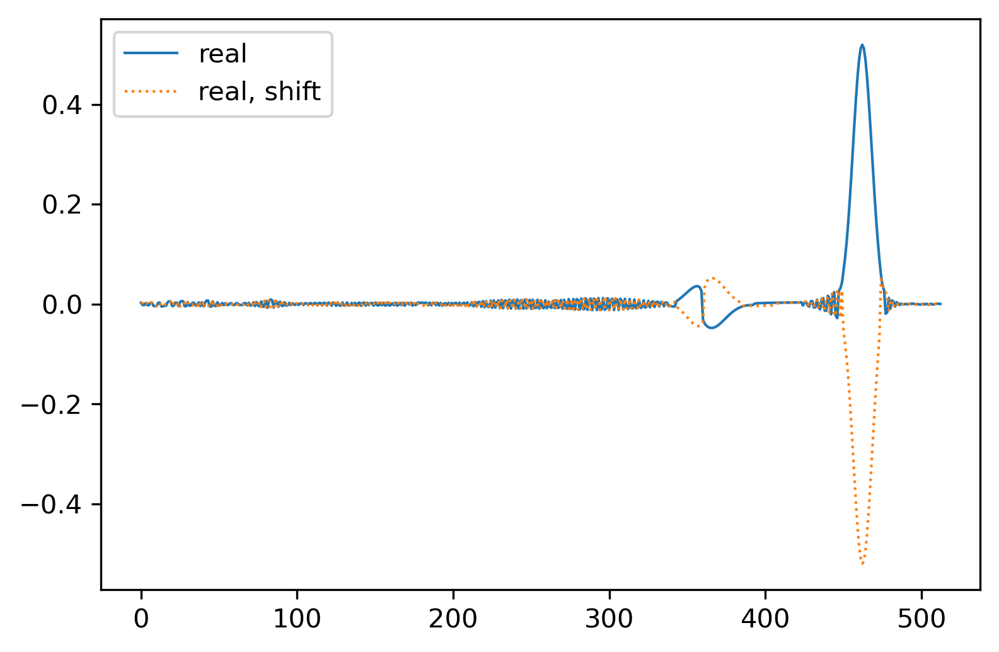

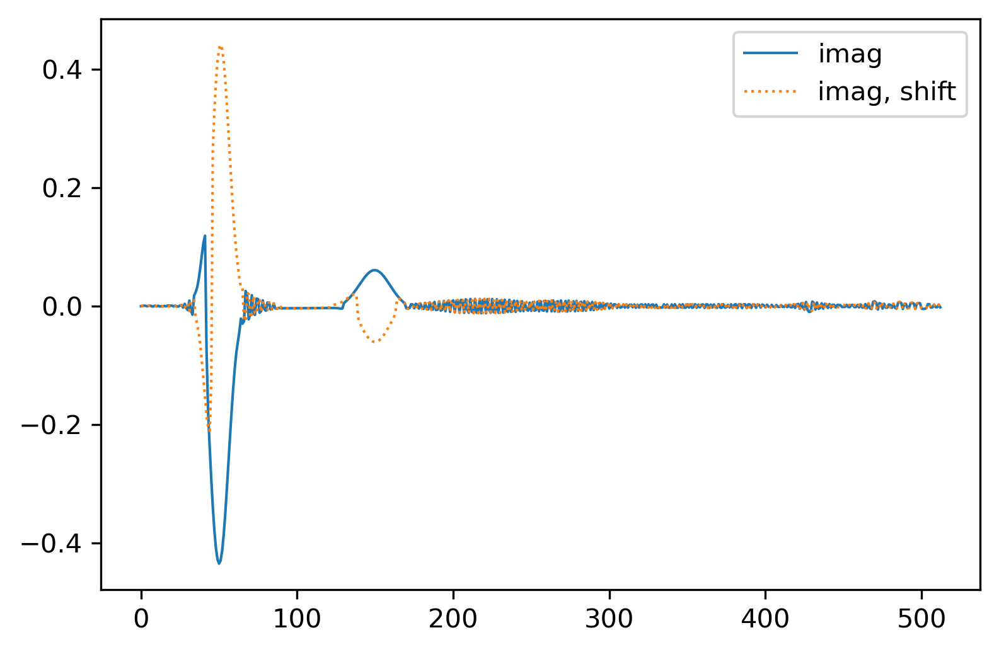

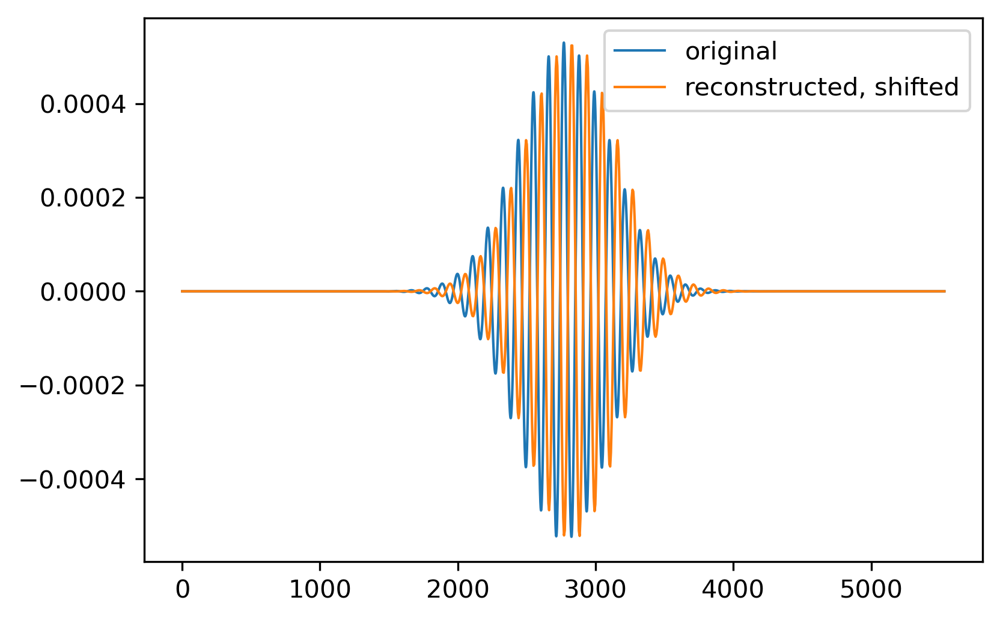

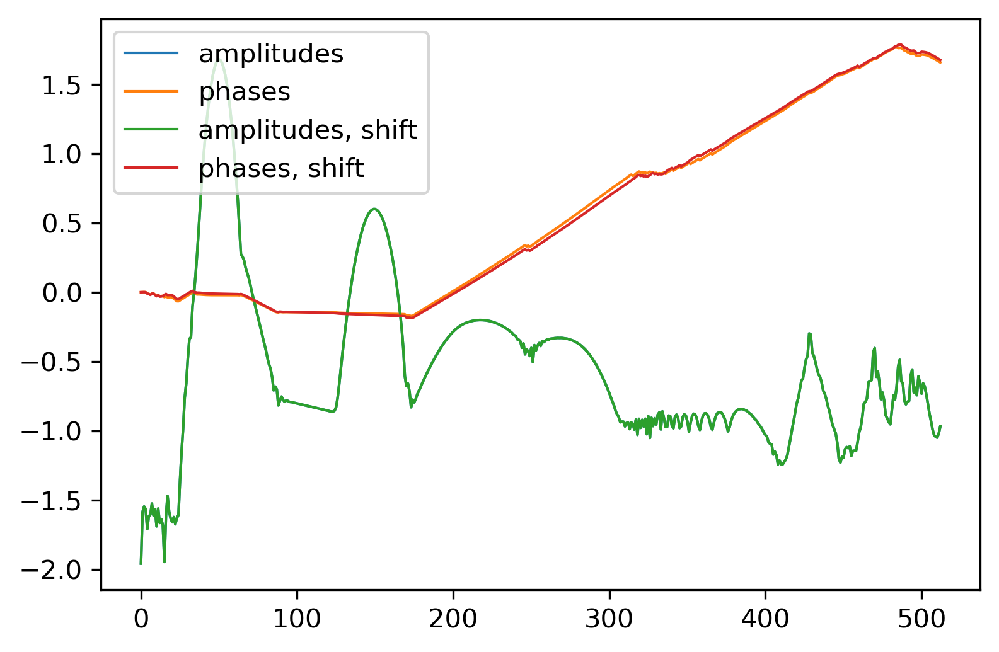

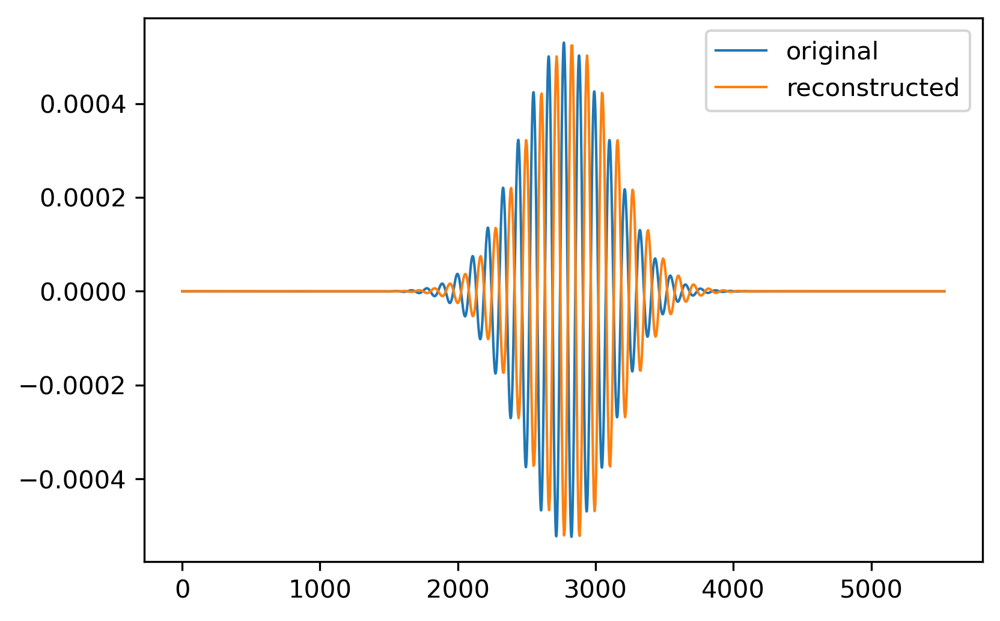

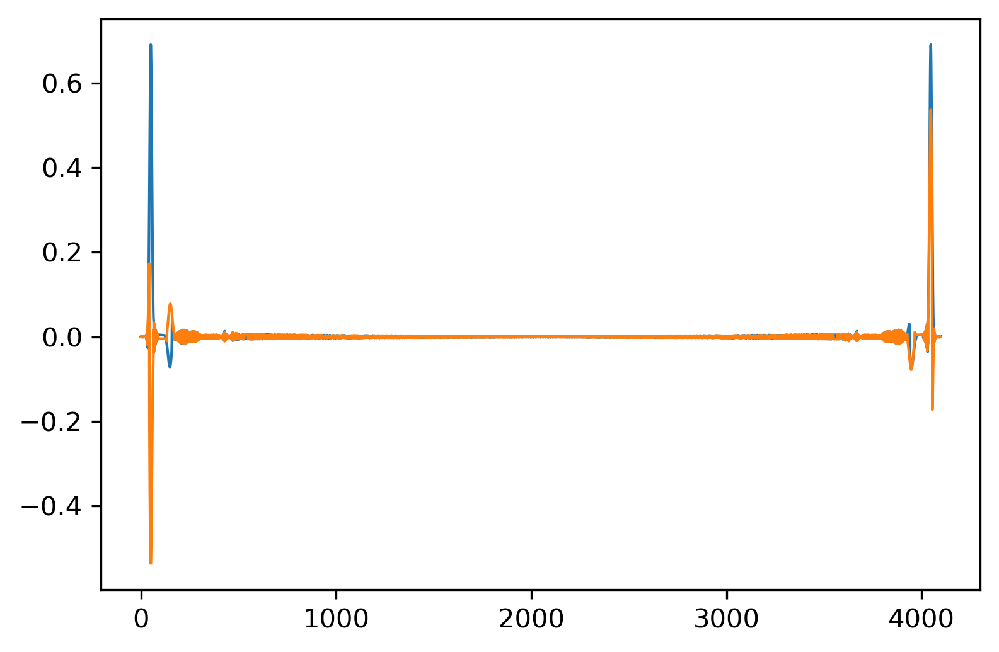

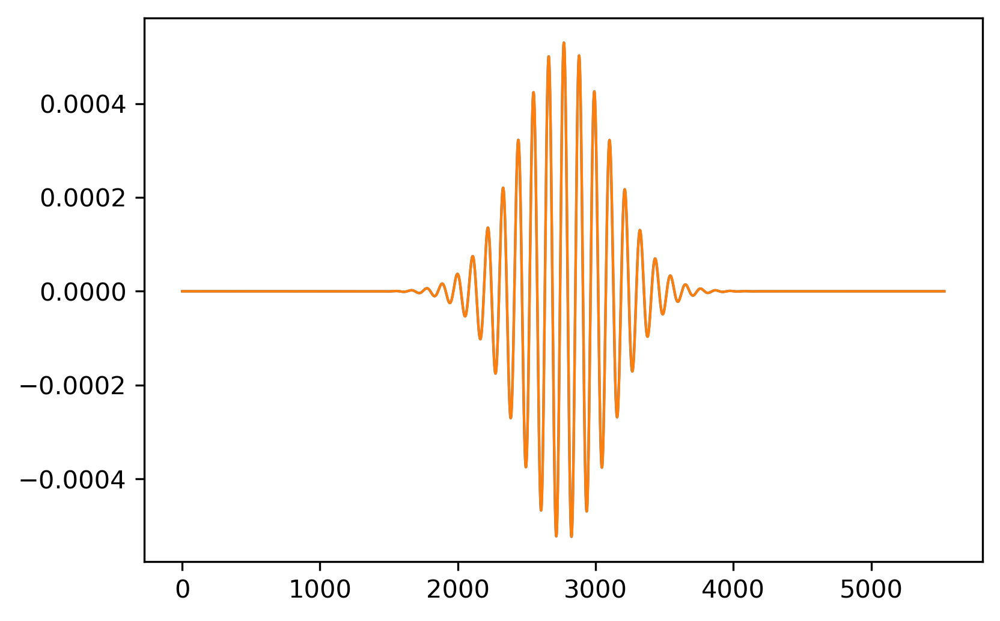

In [442]:
real, imag = preprocess(x_test[-1, 0], 1025, t, n = 5)
fig = plt.figure()
fig.dpi = 300
plt.plot(real, linewidth = 1, label = "real")
#plt.plot(imag, linewidth = 1, label = "imag")
#plt.show()


shift = -t[-1]/100
real_, imag_ = preprocess(x_test[-1, 0], 1025, t, n = 5, shift = shift)
#fig = plt.figure()
#fig.dpi = 300
plt.plot(real_, linewidth = 1, label = "real, shift", linestyle =":")
#plt.plot(imag, linewidth = 1, label = "imag, shift", linestyle =":")
plt.legend()
plt.show()

fig = plt.figure()
fig.dpi = 300
#plt.plot(real, linewidth = 1, label = "real")
plt.plot(imag, linewidth = 1, label = "imag")
plt.plot(imag_, linewidth = 1, label = "imag, shift", linestyle =":")
plt.legend()
plt.show()


fig = plt.figure()
fig.dpi = 300
plt.plot(t, x_test[-1,0], linewidth = 1, label = "original")
plt.plot(np.linspace(0, t[-1], 1025), reconstruct(real_, imag_, np.linspace(0, t[-1], 1025), n = 5), linewidth = 1, label = "reconstructed, shifted")
plt.legend()
plt.show()


amps, phases = preprocess2(x_test[-1, 0], 1025, t, shift=0)
fig = plt.figure()
fig.dpi = 300
plt.plot(amps, linewidth = 1, label = "amplitudes")
plt.plot(phases, linewidth = 1, label = "phases")
amps, phases = preprocess2(x_test[-1, 0], 1025, t, shift=shift)
plt.plot(amps, linewidth = 1, label = "amplitudes, shift")
plt.plot(phases, linewidth = 1, label = "phases, shift")
plt.legend()
plt.show()

fig = plt.figure()
fig.dpi = 300
plt.plot(t, x_test[-1,0], linewidth = 1, label = "original")
plt.plot(np.linspace(0, t[-1], 1025), reconstruct2(amps, phases, np.linspace(0, t[-1], 1025)), linewidth = 1, label = "reconstructed")
plt.legend()
plt.show()

real, imag = preprocess3(x_test[-1, 0], 4097, t, n = 5)
fig = plt.figure()
fig.dpi = 300
plt.plot(real, linewidth = 1, label = "real")
plt.plot(imag, linewidth = 1, label = "imag")
plt.show()

tgrid = np.linspace(0, t[-1], 4097)
fig = plt.figure()
fig.dpi = 300
plt.plot(t, x_test[-1,0], linewidth = 1, label = "real")
plt.plot(tgrid, reconstruct3(real, imag, tgrid, n = 5), linewidth = 1, label = "imag")
plt.show()



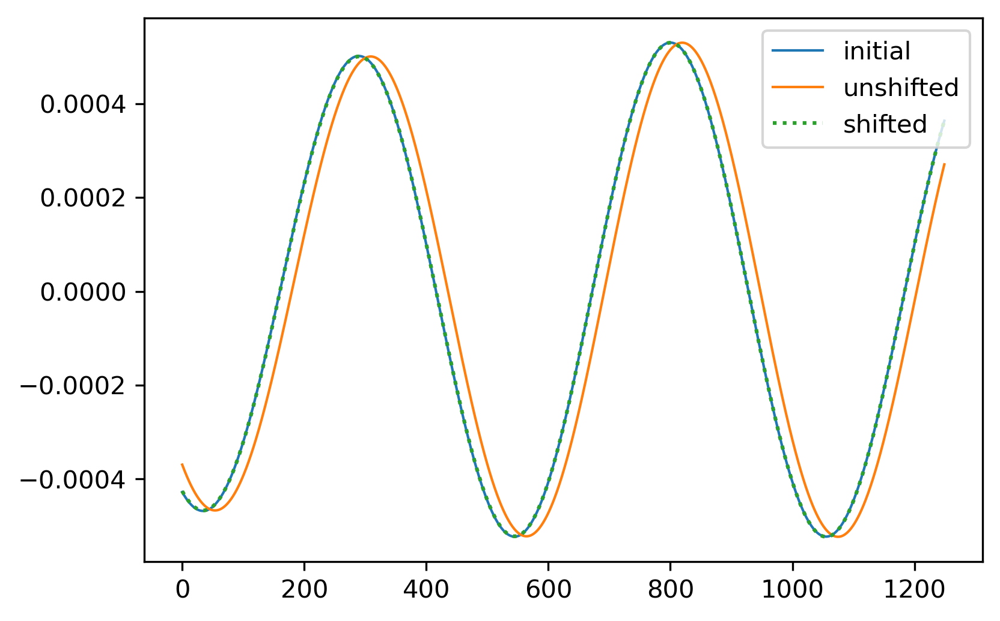

In [603]:
fig = plt.figure()
fig.dpi = 300
plt.plot(x_train[0,0][12000:13250], linewidth = 1., label = "initial")
plt.plot(x_test[-1,0][12000:13250], linewidth = 1., label = "unshifted")
K = -8.372e-8/2
K = 8.372e-8
z = 500*5e4
z = 1000*5e4
freqs = fftfreq(len(x_test[-1,0]), t[1])*2*np.pi
x_shifted = ifft(fft(x_test[-1,0])*np.exp(1j*K*z*freqs)).real
plt.plot(x_shifted[12000:13250], label = "shifted", linestyle = ":")
plt.legend()
plt.show()

In [387]:
import random
N = 201
N = 513
M = 4097
N = 4097
N = 1025
N = 2049
M = 2049
M = N
n = 1
m = 1
t_f = np.linspace(t[0], t[-1], M)
#freqs = fftfreq(len(x_test[-1,0]), t[1])*2*np.pi
f = tools.filter(np.ones((len(t))), t)
#K = 8.372e-8
#K = 0.
#x_train_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_train[:,0]])
#y_train_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1)), axis = None) for y in x_train])
#x_test_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_test[:,0]])
#y_test_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1)), axis = None) for y in x_test])
#x_train_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_train[:,0]])
#y_train_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = m)), axis = None) for y in x_train])
#x_test_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_test[:,0]])
#y_test_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = m)), axis = None) for y in x_test])

#x_f = np.array([np.transpose(fft_real_imag_separation2(NN.spectral_filter(f*x, N), t_f, 50000*i, n = n)) for i, x in enumerate(dataset[0:1000,0])])
#y_f = np.array([np.concatenate(np.array(fft_real_imag_separation2(NN.spectral_filter(f*(y[1]-1*y[0]), N), t_f, 50000*i, n = m)), axis = None) for i, y in enumerate(dataset[0:1000])])

#xf = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*x)*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = n)) for i, x in enumerate(dataset[0:1000,0])])
#yf = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*(-y[1]-1*y[0]))*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = m)), axis = None) for i, y in enumerate(dataset[0:1000])])

xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for i, x in enumerate(dataset[0:4000,0])])
yf = np.array([np.concatenate(preprocess(f*(-y[1]-0*y[0]), M, t, n = m), axis = None) for i, y in enumerate(dataset[0:4000])])

#xf = np.array([np.transpose(preprocess3(f*x, N, t, n = n)) for i, x in enumerate(dataset[0:12000,0])])
#yf = np.array([np.concatenate(preprocess3(f*(-y[1]-1*y[0]), M, t, n = m), axis = None) for i, y in enumerate(dataset[0:12000])])

#x_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*x)*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = n)) for i, x in enumerate(dataset[0:500,0])])
#y_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*(-y[1]-1*y[0]))*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = m)), axis = None) for i, y in enumerate(dataset[0:500])])

#shifts = [random.uniform(-t[-1]/100, t[-1]/100) for i in range(1000)]
#xf = np.concatenate(np.array([[np.transpose(preprocess(f*x, N, t, n = n, shift=shift)) for i, x in enumerate(dataset[0:1,0])] for shift in shifts]))
#yf = np.concatenate(np.array([[np.concatenate(preprocess(-f*(y[1]+1*y[0]), M, t, n = m, shift=shift)) for i, y in enumerate(dataset[0:1])] for shift in shifts]))
#xf = np.concatenate(np.array([[np.transpose(preprocess2(1*x, N, t, shift=shift)) for i, x in enumerate(dataset[0:1,0])] for shift in shifts]))
#yf = np.concatenate(np.array([[np.concatenate(preprocess2(-1*(y[1]+1*y[0]), N, t, shift=shift)) for i, y in enumerate(dataset[0:1])] for shift in shifts]))

In [374]:
print(xf.shape)
print(yf.shape)

(2001, 1025, 2)
(2001, 2050)


In [511]:
#from scipy.special import gamma

# Define the poisson distribution parameter
lam = 1/200 # mean or rate

# Generate L random numbers from 0 to 1000
L = 500
x = np.random.uniform(0, 1000, L)

# Evaluate the poisson distribution at each x
#y = np.exp(-lam) * np.power(lam,x)/gamma(x+1)
y = lam * np.exp(-lam * x)
print(y.shape)
print(x.shape)
#y = np.divide(y, np.math.gamma(x+1))

# Normalize the y values to sum to 1
y = y / y.sum()

# Sample from the distribution using inverse transform sampling
u = np.random.uniform(0, 1, L)
x_sorted = np.sort(x)
y_sorted = np.sort(y)
y_cumsum = np.cumsum(y_sorted)
indices = np.searchsorted(y_cumsum, u)
samples = x_sorted[indices]
#indices=indices
samples = [1000-int(s) for s in samples]
print(samples)
print(len(samples))


(500,)
(500,)
[36, 599, 88, 406, 234, 87, 50, 62, 88, 509, 13, 24, 28, 187, 230, 226, 213, 609, 44, 94, 2, 130, 50, 23, 75, 486, 75, 62, 83, 83, 206, 13, 62, 312, 220, 113, 135, 149, 7, 83, 96, 130, 97, 578, 256, 508, 65, 389, 84, 23, 44, 50, 50, 130, 129, 225, 226, 87, 144, 215, 760, 70, 50, 58, 196, 192, 96, 215, 163, 106, 213, 138, 870, 83, 200, 81, 113, 129, 73, 288, 351, 8, 177, 200, 74, 149, 260, 320, 977, 124, 83, 44, 368, 70, 631, 102, 329, 73, 231, 13, 9, 14, 426, 108, 24, 172, 268, 84, 203, 635, 88, 256, 79, 55, 64, 401, 50, 63, 65, 174, 83, 309, 320, 24, 7, 319, 68, 455, 305, 11, 149, 134, 115, 220, 88, 58, 243, 129, 79, 205, 67, 246, 83, 299, 194, 8, 8, 127, 204, 40, 40, 115, 44, 62, 509, 213, 2, 44, 102, 190, 324, 40, 104, 260, 268, 802, 40, 795, 165, 252, 275, 143, 81, 21, 50, 912, 92, 92, 324, 115, 163, 306, 200, 79, 28, 135, 28, 68, 54, 65, 8, 50, 115, 11, 68, 240, 88, 200, 23, 446, 83, 83, 21, 651, 68, 7, 129, 560, 97, 302, 84, 40, 68, 87, 68, 136, 161, 243, 50, 312, 4

In [215]:
import random

# Define a function that takes N as a parameter
def generate_random_integers(N, lambda_ = 5, max_index = 1000):
  # Initialize an empty list to store the random integers
  random_integers = []
  # Loop N times
  for i in range(N):
    # Generate a random number between 0 and 1 using the exponential cumulative distribution function
    # The parameter lambda is set to 0.001 for demonstration purposes
    # You can change it to any positive value you want
    random_number = random.expovariate(lambda_)
    # Multiply the random number by 1000 and round it to the nearest integer
    random_integer = round(random_number*max_index)
    while (random_integer > max_index-1):
      random_number = random.expovariate(lambda_)
      random_integer = round(random_number*1000)
    # Append the random integer to the list
    random_integers.append(random_integer)
  # Return the list of random integers
  return random_integers

[1103, 3327, 2825, 2720, 1133, 1686, 406, 534, 2762, 116, 3051, 1041, 1819, 2460, 3038, 1250, 10, 1979, 1445, 774, 2319, 279, 2316, 1861, 3332, 933, 1912, 1378, 3529, 1117, 533, 311, 3188, 161, 1331, 2289, 2880, 1598, 3210, 823, 1959, 2301, 683, 2280, 254, 2602, 1859, 2754, 466, 725, 2753, 2081, 3603, 417, 2208, 1170, 3137, 2942, 3063, 2140, 2350, 3704, 1631, 1514, 514, 2004, 1947, 1647, 3223, 406, 774, 3294, 2745, 731, 1723, 1174, 1685, 3502, 703, 2004, 557, 967, 2915, 1703, 2286, 2093, 1248, 1639, 468, 1428, 343, 2057, 1031, 2920, 659, 977, 1662, 739, 601, 1218, 3144, 2179, 1507, 412, 2381, 3964, 3734, 2952, 2080, 3128, 2233, 2672, 2585, 114, 3050, 1250, 1258, 254, 2340, 2289, 3927, 927, 2427, 1556, 3625, 776, 2557, 2447, 2548, 1886, 2703, 87, 3095, 1291, 3689, 733, 3817, 3995, 1789, 2416, 1674, 2097, 2425, 1180, 2852, 277, 1314, 2549, 3489, 3278, 2824, 627, 2800, 1984, 3113, 2355, 3890, 268, 2885, 2632, 3836, 2057, 441, 1758, 589, 3604, 782, 1017, 3132, 3190, 518, 3500, 1034, 3074, 

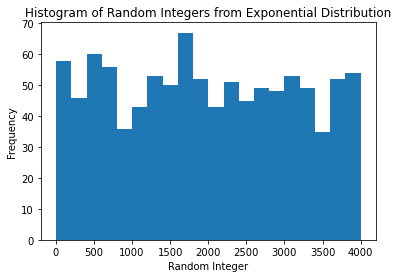

In [388]:
samples = generate_random_integers(1000, lambda_=0.01, max_index=4000)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [389]:
print(xf.shape)
print(yf.shape)

#p = np.random.permutation(len(x_f))
#x_f = x_f[p]
#y_f = y_f[p]
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(4000, 1025, 2)
(4000, 2050)
(1000, 1025, 2)
(1000, 2050)


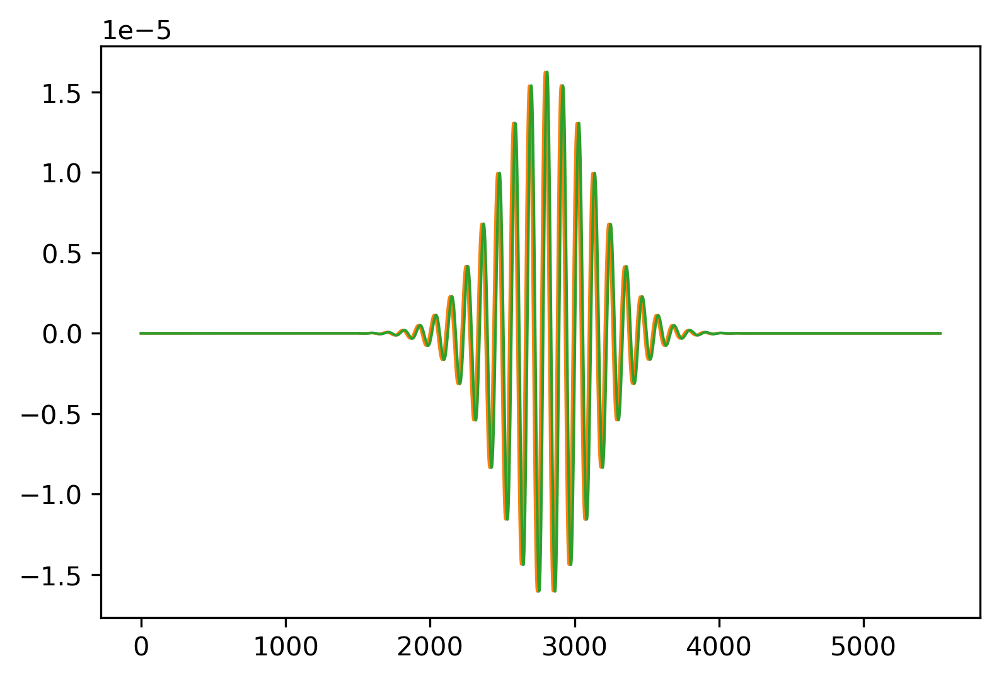

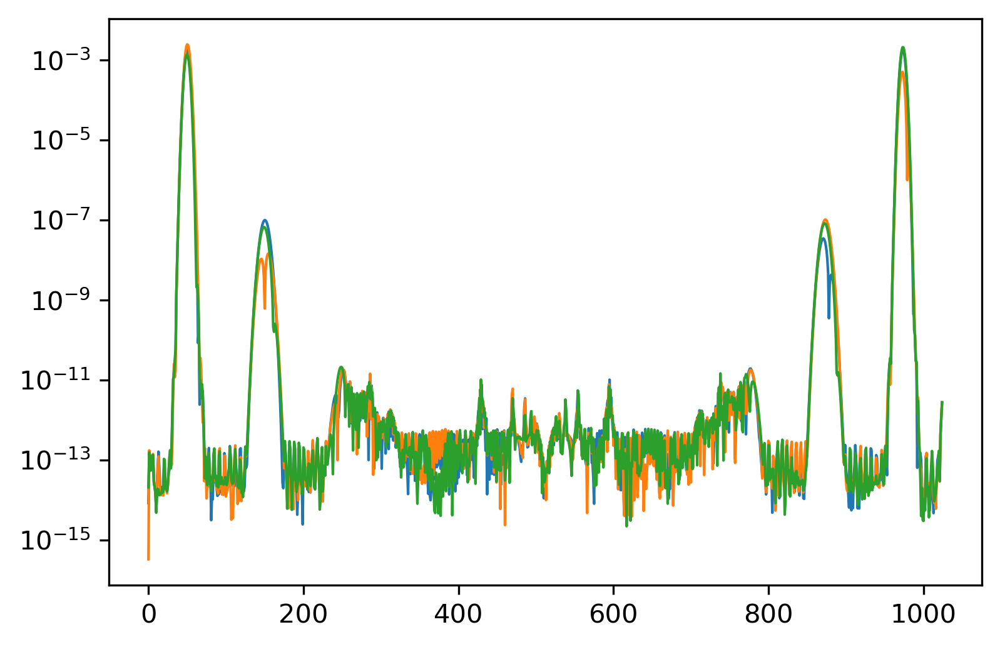

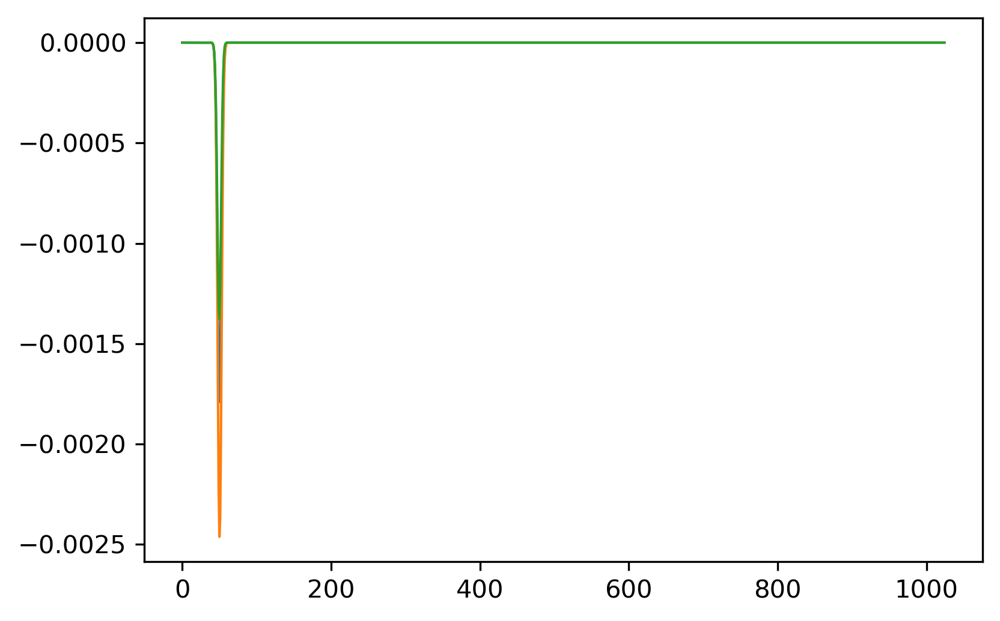

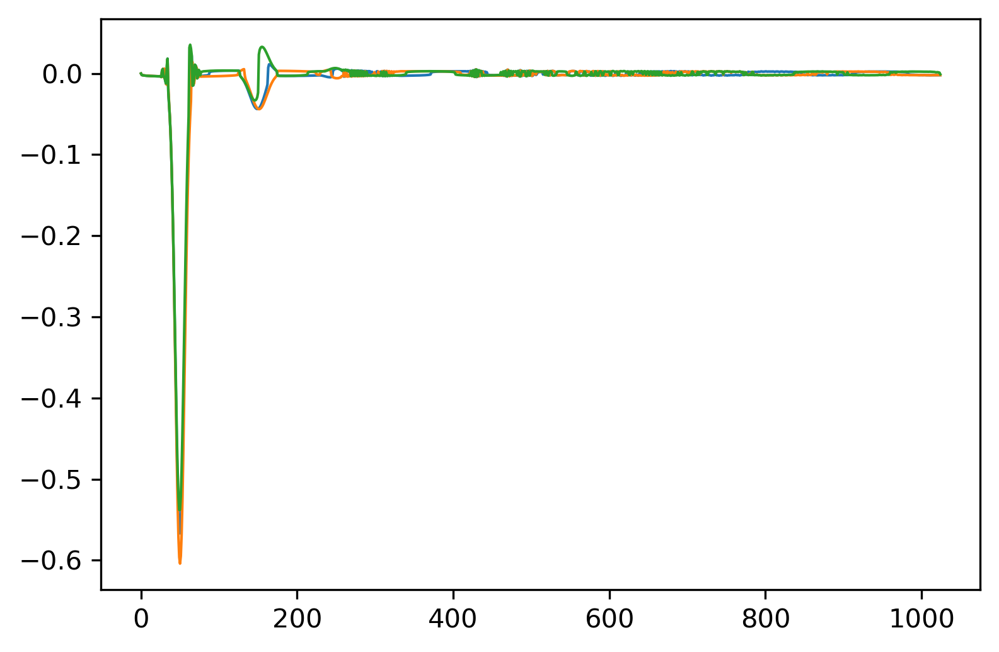

In [1046]:
fig = plt.figure()
fig.dpi = 300

#plt.plot(t, xf[0,0], linewidth = 1)
#plt.plot(t, xf[0,1], linewidth = 1)
real, imag = y_f[0, :N//2+1], y_f[0, N//2+1:]
plt.plot(np.linspace(0, t[-1], N), reconstruct(real, imag, np.linspace(0, t[-1], N), n = m), linewidth = 1)
real, imag = y_f[10, :N//2+1], y_f[10, N//2+1:]
plt.plot(np.linspace(0, t[-1], N), reconstruct(real, imag, np.linspace(0, t[-1], N), n = m), linewidth = 1)
real, imag = y_f[99, :N//2+1], y_f[99, N//2+1:]
plt.plot(np.linspace(0, t[-1], N), reconstruct(real, imag, np.linspace(0, t[-1], N), n = m), linewidth = 1)
plt.show()

fig = plt.figure()
fig.dpi = 300

#plt.plot(t, xf[0,0], linewidth = 1)
#plt.plot(t, xf[0,1], linewidth = 1)
real, imag = y_f[0, :N//2+1], y_f[0, N//2+1:]
plt.semilogy(np.abs(real+1j*imag), linewidth = 1)
real, imag = y_f[10, :N//2+1], y_f[10, N//2+1:]
plt.semilogy(np.abs(real+1j*imag), linewidth = 1)
real, imag = y_f[99, :N//2+1], y_f[99, N//2+1:]
plt.semilogy(np.abs(real+1j*imag), linewidth = 1)
plt.show()

fig = plt.figure()
fig.dpi = 300
real, imag = y_f[0, :N//2+1], y_f[0, N//2+1:]
plt.plot(imag, linewidth = 1)
real, imag = y_f[10, :N//2+1], y_f[10, N//2+1:]
plt.plot(imag, linewidth = 1)
real, imag = y_f[99, :N//2+1], y_f[99, N//2+1:]
plt.plot(imag, linewidth = 1)
plt.show()

fig = plt.figure()
fig.dpi = 300
real, imag = x_f[0, :, 0], x_f[0, :, 1]
plt.plot(imag, linewidth = 1)
real, imag = x_f[10, :, 0], x_f[10, :, 1]
plt.plot(imag, linewidth = 1)
real, imag = x_f[99, :, 0], x_f[99, :, 1]
plt.plot(imag, linewidth = 1)
plt.show()

In [390]:
x_train_f, x_test_f = x_f[:800], x_f[800:]
#x_train_f, x_test_f = x_f[:1600], x_f[1600:]
#x_train_f, x_test_f = x_f[:3000], x_f[3000:]
#x_train_f, x_test_f = x_f[:240], x_f[240:]
#x_train_f, x_test_f = x_f[:400], x_f[400:]
y_train_f, y_test_f = y_f[:800], y_f[800:]
#y_train_f, y_test_f = y_f[:1600], y_f[1600:]
#y_train_f, y_test_f = y_f[:3000], y_f[3000:]
#y_train_f, y_test_f = y_f[:400], y_f[400:]
#y_train_f, y_test_f = y_f[:240], y_f[240:]

In [391]:
# Assume x_train is a tensor of shape (batch_size_train, N, 2)
x_train_min = tf.reduce_min(x_train_f) # scalar
x_train_max = tf.reduce_max(x_train_f) # scalar
x_train_f = 2 * (x_train_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_train, N, 2)
#x_train_f = (x_train_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_train, N, 2)

# Assume x_val is a tensor of shape (batch_size_val, N, 2)
x_test_f = 2 * (x_test_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_val, N, 2)
#x_test_f = (x_test_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_val, N, 2)

In [392]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(800, 1025, 2)
(800, 2050)
(200, 1025, 2)
(200, 2050)


(1, 513, 2)


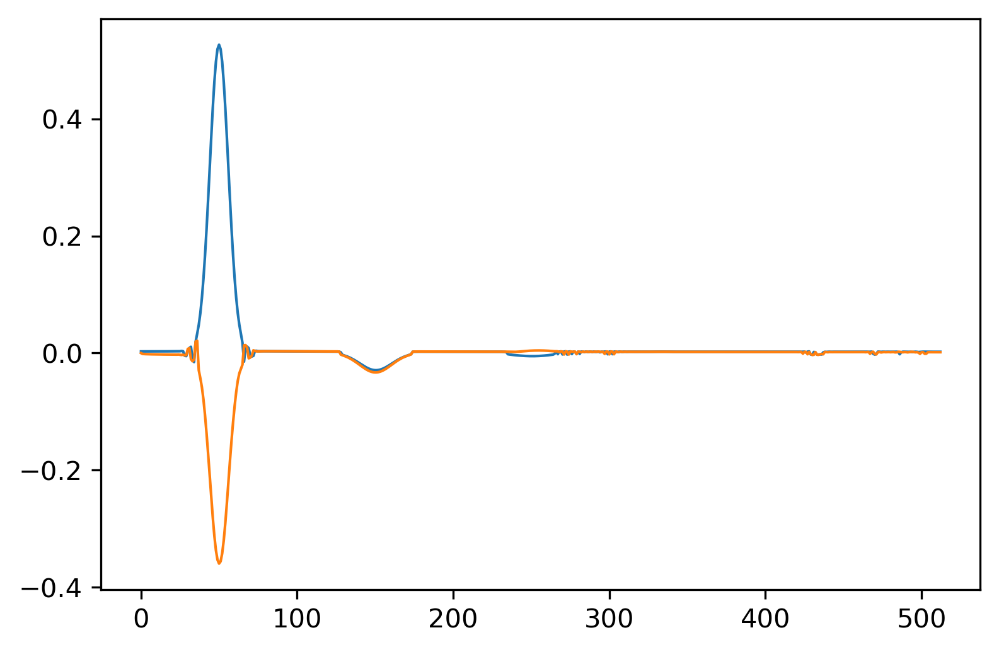

(1, 256, 2)


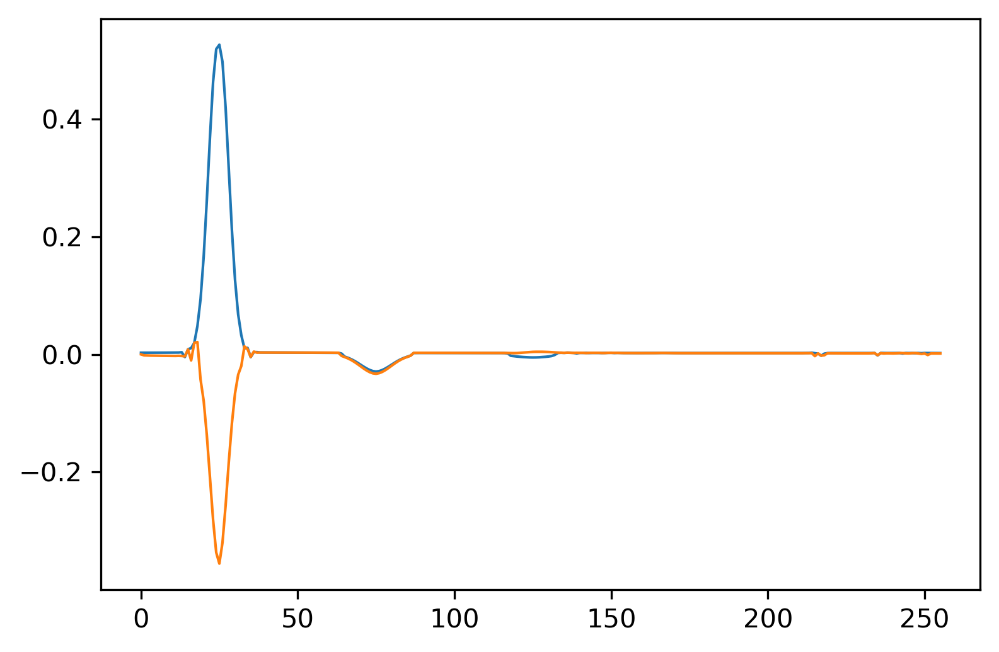

(1, 254, 8)


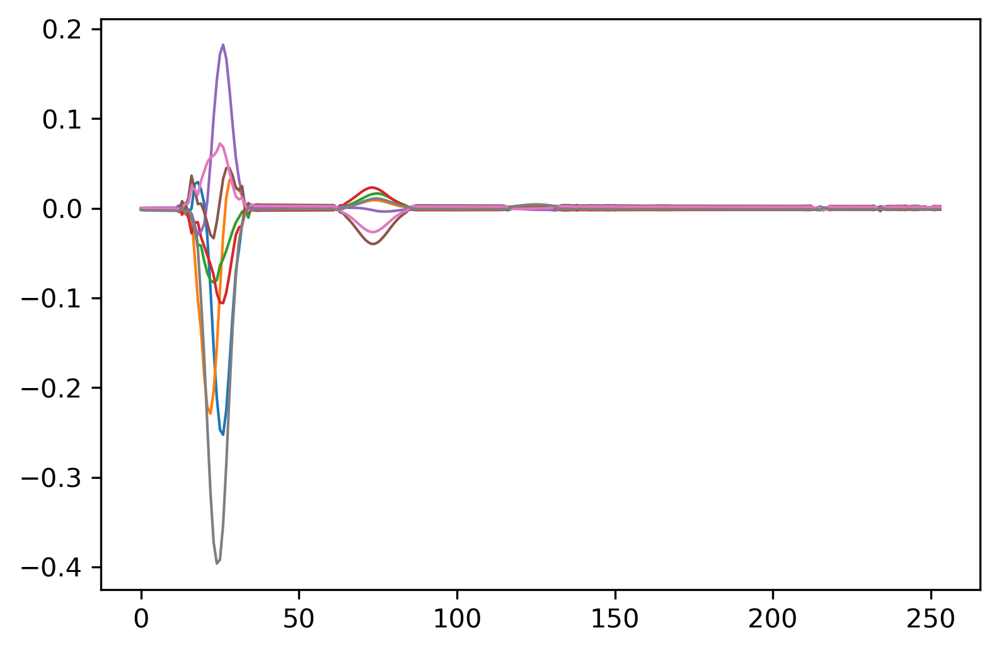

(1, 84, 8)


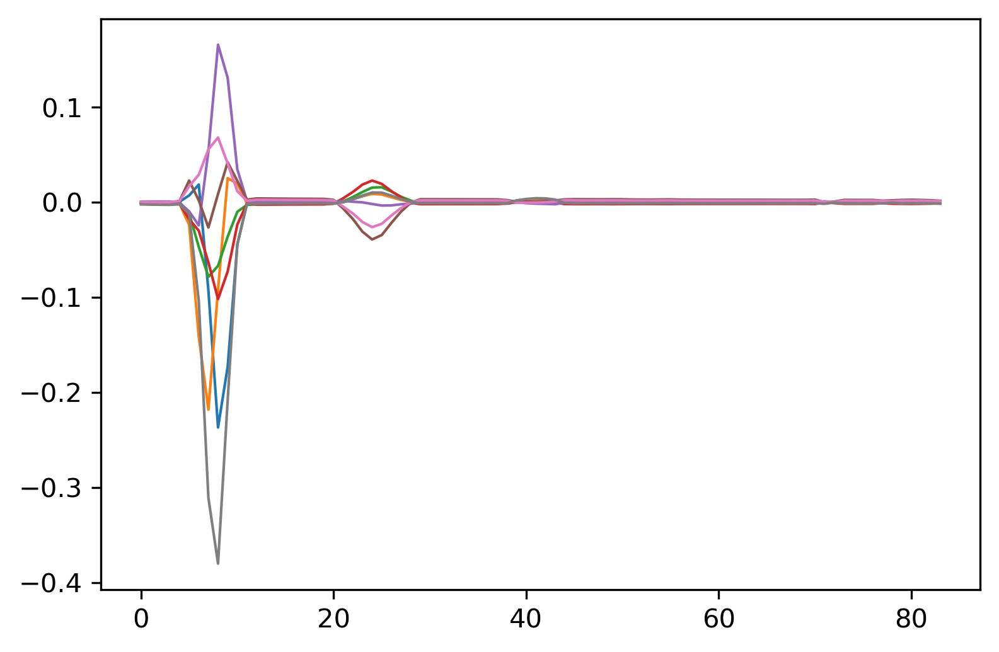

(1, 82, 16)


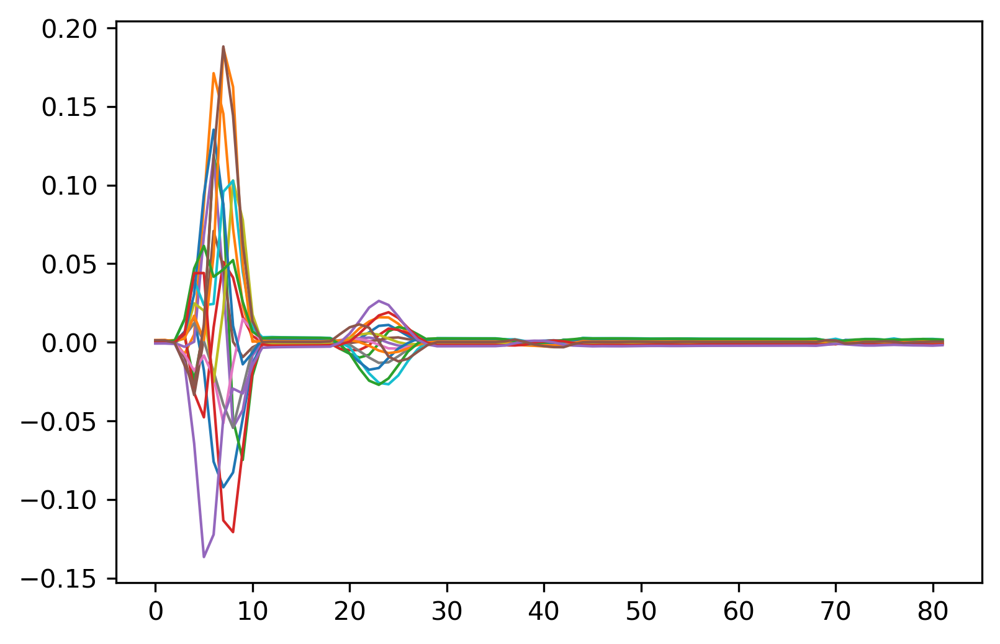

(1, 27, 16)


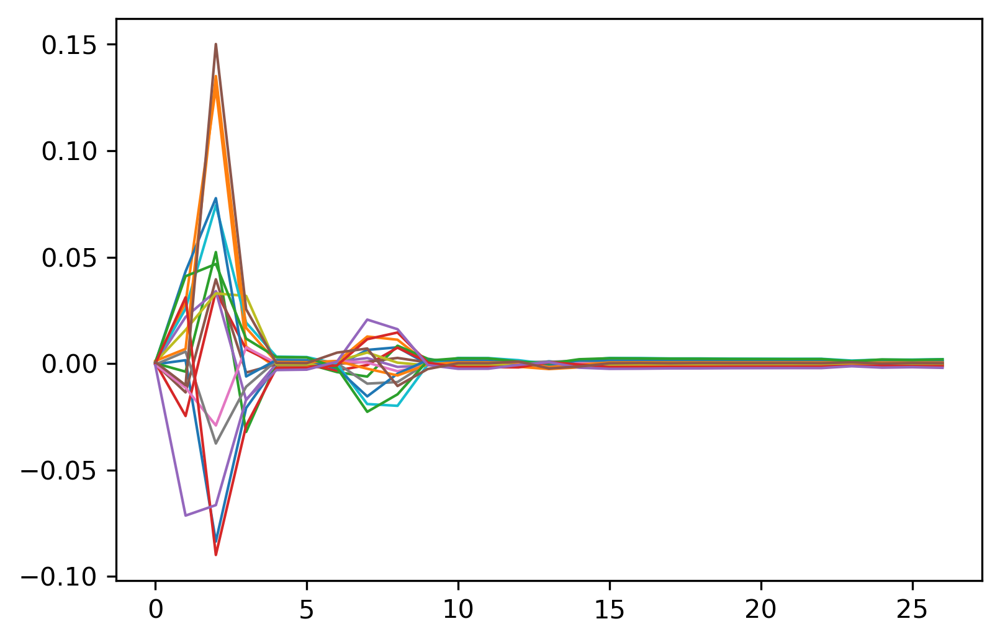

(1, 25, 32)


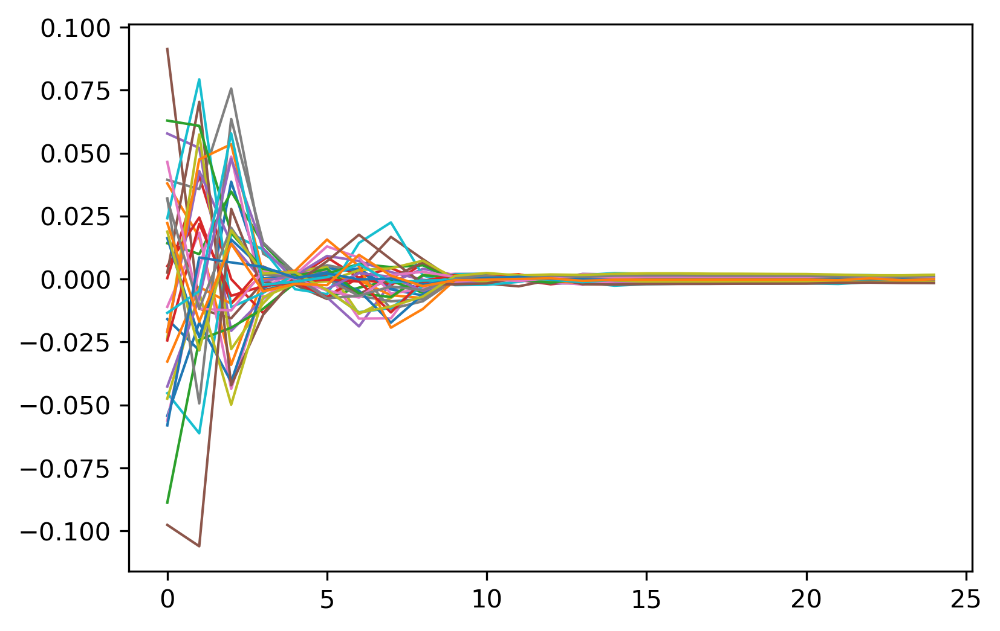

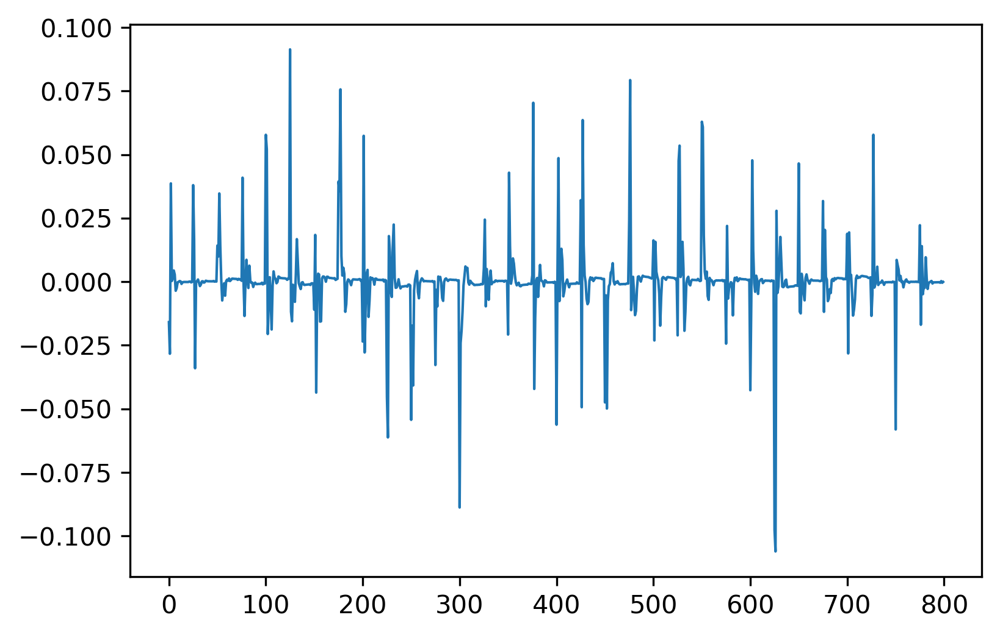

In [456]:
x = x_test_f[4]
#x = np.transpose(x)
#x = tf.expand_dims(x, axis=1)
x = tf.expand_dims(x, axis=0)
print(x.shape)

j = 10

fig = plt.figure()
fig.dpi = 300
#plt.plot(x[0,:,0])
plt.plot(x[0,:,0], linewidth = 1)
plt.plot(x[0,:,1], linewidth = 1)
plt.show()


# Define the input shape (batch_size, time_steps, features)
input_shape = x.shape[1:]
#print(input_shape)
pool_layer = tf.keras.layers.AvgPool1D(2)
pool_layer = tf.keras.layers.AvgPool1D(2,data_format = "channels_last")
pool_layer = tf.keras.layers.MaxPooling1D(2,data_format = "channels_last")
x = pool_layer(x)
print(x.shape)
fig = plt.figure()
fig.dpi = 300
plt.plot(x[0,:,0], linewidth = 1)
plt.plot(x[0,:,1], linewidth = 1)
plt.show()


# Create a convolution layer conv1D with 32 filters, kernel size of 3 and padding='same'
conv_layer = tf.keras.layers.Conv1D(filters=8, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer(x)
print(conv_output.shape)
#plt.plot(conv_output[0,:,j])
fig = plt.figure()
fig.dpi = 300
plt.plot(conv_output[0], linewidth = 1)
#plt.plot(conv_output[0])
plt.show()

#pool_layer = tf.keras.layers.AvgPool1D(3,data_format = "channels_last")
pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)

print(pool_output.shape)
#plt.plot(pool_output[0, :, j])
fig = plt.figure()
fig.dpi = 300
plt.plot(pool_output[0], linewidth = 1)
plt.show()

conv_layer2 = tf.keras.layers.Conv1D(filters=16, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer2(pool_output)
print(conv_output.shape)
fig = plt.figure()
fig.dpi = 300
plt.plot(conv_output[0], linewidth = 1)
plt.show()

pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)
print(pool_output.shape)
fig = plt.figure()
fig.dpi = 300
plt.plot(pool_output[0], linewidth = 1)
plt.show()

conv_layer3 = tf.keras.layers.Conv1D(filters=32, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer3(pool_output)
print(conv_output.shape)
#plt.plot(n_th_root(conv_output[0,:,1], 1))
fig = plt.figure()
fig.dpi = 300
plt.plot(conv_output[0,:,:], linewidth = 1)
plt.show()

flattened_output = tf.keras.layers.Flatten(data_format = "channels_first")(conv_output)
fig = plt.figure()
fig.dpi = 300
plt.plot(flattened_output[0], linewidth = 1)
plt.show()

In [402]:
reload(NN)

### Create custom NN model
#model = NN.TDSE_NN_4((N//2+1, 2,), 2*(M//2+1), N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input=0.8)
model = NN.TDSE_NN_Conv((N//2+1, 2,), 2*(M//2+1), bias = True, dropout=0.4, dropout_input=0.5)
#model = NN.TDSE_NN_4((N, 2,), 2*(M), N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input=0.9)
model.build(input_shape=(None, N//2+1, 2))
#model.build(input_shape=(None, N, 2))
### Print summary of the model (basic info)
model.summary()

Model: "tdse_nn__conv_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_77 (InputLayer)       [(None, 1025, 2)]         0         
                                                                 
 dropout_659 (Dropout)       multiple                  0         
                                                                 
 dense_666 (Dense)           multiple                  1392768   
                                                                 
 dropout_660 (Dropout)       multiple                  0         
                                                                 
 dense_667 (Dense)           multiple                  16512     
                                                                 
 dropout_661 (Dropout)       multiple                  0         
                                                                 
 dense_668 (Dense)           multiple             

In [322]:
def time_spectrum_MSE(y_true, y_pred):
    #N = len(y_pred) - 1
    N = tf.shape(y_true)[-1]-1
    #N = N.numpy()
    y_true = tf.cast(y_true, tf.complex64)
    
    FF = y_true[:,:N//2+1] + 1j*y_true[:,N//2+1:]
    FF_conj = tf.reverse(tf.math.conj(FF)[:,1:N//2+1], axis=[-1])
    res = tf.concat([FF, FF_conj], axis=-1)
    y_true_t = tf.math.real(tf.signal.ifft(res))
    y_true_t = tf.cast(y_true_t, tf.complex64)
    
    y_pred = tf.cast(y_pred, tf.complex64)
    FF = y_pred[:,:N//2+1] + 1j*y_pred[:,N//2+1:]
    FF_conj = tf.reverse(tf.math.conj(FF)[:,1:N//2+1], axis=[-1])
    res = tf.concat([FF, FF_conj], axis=-1)
    y_pred_t = tf.math.real(tf.signal.ifft(res))
    y_pred_t = tf.cast(y_pred_t, tf.complex64)
    
    return tf.reduce_mean(tf.square(tf.cast((y_true - y_pred),tf.float32)), axis = -1) + tf.reduce_mean(tf.square(tf.math.real(y_true_t) - tf.math.real(y_pred_t)), axis = -1)
    #return tf.reduce_mean(tf.square(tf.math.real(y_true_t) - tf.math.real(y_pred_t)), axis = -1)

time_spectrum_mse = tf.keras.metrics.Mean(name='time_spectrum_MSE')

class TimeSpectrumMSE(tf.keras.losses.Loss):
    def __init__(self, name='time_spectrum_MSE', **kwargs):
        super(TimeSpectrumMSE, self).__init__(name=name, **kwargs)

    def call(self, y_true, y_pred):
        return time_spectrum_MSE(y_true, y_pred)


(128, 2050)
N =  2049
(128, 2050)
FF shape =  (128, 1025)
FF_conj shape =  (128, 1024)
tf.Tensor(
[[ 2.7393641e-12-7.5928241e-21j  1.1497946e-12+1.9221171e-13j
  -4.3951824e-13-1.3523236e-13j ... -2.3942071e-14+5.5276333e-14j
  -4.3951824e-13+1.3523236e-13j  1.1497946e-12-1.9221171e-13j]
 [ 2.7393641e-12-7.5928241e-21j  1.1401610e-12+2.4291140e-13j
  -4.2583778e-13-1.7356917e-13j ... -1.6411048e-14+5.7960100e-14j
  -4.2583778e-13+1.7356917e-13j  1.1401610e-12-2.4291140e-13j]
 [ 2.7393641e-12-7.5928241e-21j  1.1403875e-12+2.4184582e-13j
  -4.2616144e-13-1.7277298e-13j ... -1.6573475e-14+5.7913865e-14j
  -4.2616144e-13+1.7277298e-13j  1.1403875e-12-2.4184582e-13j]
 ...
 [ 2.7393641e-12-7.5928241e-21j  1.1450612e-12+2.1865046e-13j
  -4.3282215e-13-1.5533527e-13j ... -2.0067117e-14+5.6797943e-14j
  -4.3282215e-13+1.5533527e-13j  1.1450612e-12-2.1865046e-13j]
 [ 2.7393641e-12-7.5928241e-21j  1.1520999e-12+1.7787299e-13j
  -4.4275092e-13-1.2424045e-13j ... -2.5990774e-14+5.4343127e-14j
  -4.

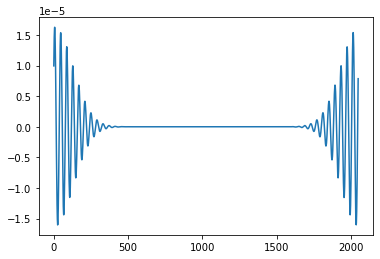

In [929]:
y_true = y_train_f[0:128,:]
print(y_true.shape)
N = tf.shape(y_true)[-1]-1
print("N = ", N.numpy())
N = N.numpy()
y_true = tf.cast(y_true, tf.complex64)
print(y_true.shape)

FF = y_true[:,:N//2+1] + 1j*y_true[:,N//2+1:]
print("FF shape = ", FF.shape)

FF_conj = tf.reverse(tf.math.conj(FF)[:,1:N//2+1], axis=[-1])
print("FF_conj shape = ", FF_conj.shape)
res = tf.concat([FF, FF_conj], axis=-1)
print(res)
print(res.shape)
y_true_t = tf.math.real(tf.signal.ifft(res))
y_true_t = tf.cast(y_true_t, tf.complex64)

print(tf.shape(y_true_t))

plt.plot(tf.math.real(y_true_t[0]))
plt.show()

In [403]:
epochs = 2000
patience = 200
patience = 100
batch_size = 128

### Compile model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = 0.001),
              loss=tf.keras.losses.MeanSquaredError(),
              #loss=TimeSpectrumMSE(),
              metrics=['mean_absolute_percentage_error'])
              #metrics=[time_spectrum_MSE])

### Fit model
history = model.fit(x_train_f, y_train_f, epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=batch_size)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test_f, y_test_f)

Epoch 1/2000
7/7 [==============================] - 4s 113ms/step - loss: 0.1608 - mean_absolute_percentage_error: 273251872.0000
Epoch 2/2000
7/7 [==============================] - 1s 115ms/step - loss: 0.1022 - mean_absolute_percentage_error: 222758464.0000
Epoch 3/2000
7/7 [==============================] - 1s 115ms/step - loss: 0.0686 - mean_absolute_percentage_error: 182551328.0000
Epoch 4/2000
7/7 [==============================] - 1s 120ms/step - loss: 0.0506 - mean_absolute_percentage_error: 159117568.0000
Epoch 5/2000
7/7 [==============================] - 1s 123ms/step - loss: 0.0393 - mean_absolute_percentage_error: 141511136.0000
Epoch 6/2000
7/7 [==============================] - 1s 127ms/step - loss: 0.0316 - mean_absolute_percentage_error: 127763136.0000
Epoch 7/2000
7/7 [==============================] - 1s 142ms/step - loss: 0.0258 - mean_absolute_percentage_error: 115781088.0000
Epoch 8/2000
7/7 [==============================] - 1s 134ms/step - loss: 0.0214 - mean_ab

[8.165732090503752e-09, 1.735487937927246]

1/1 [==============================] - 0s 241ms/step
******************************************************************
Features


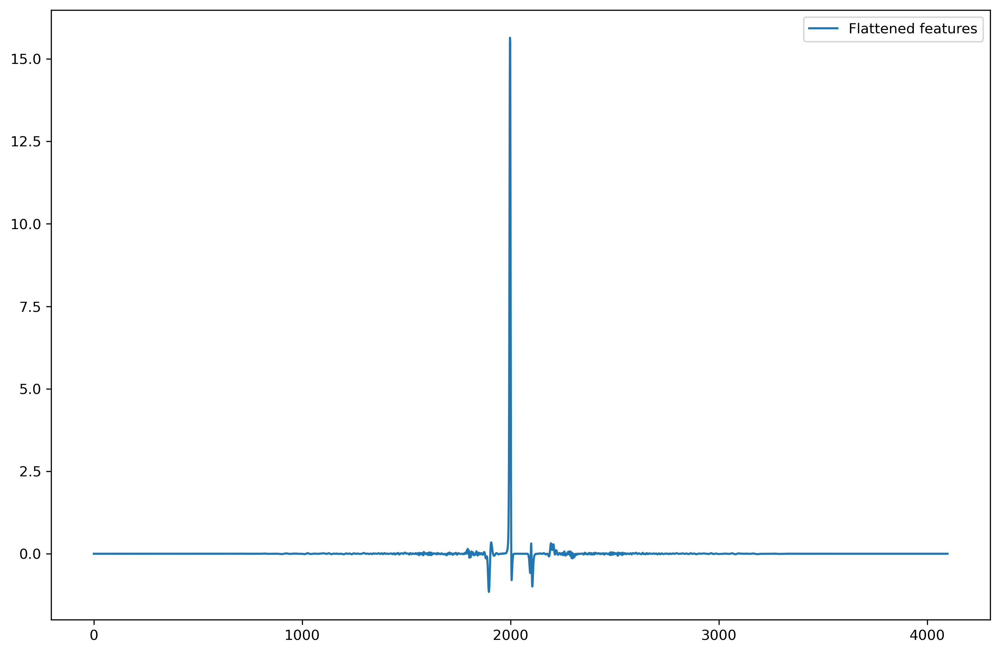

******************************************************************
Labels


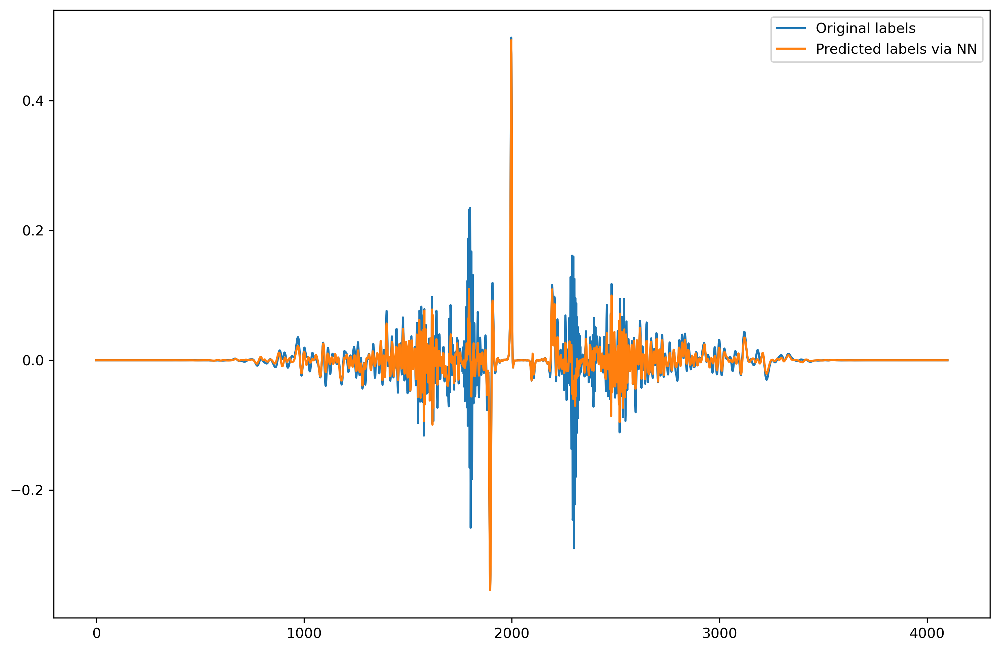

******************************************************************
Fields


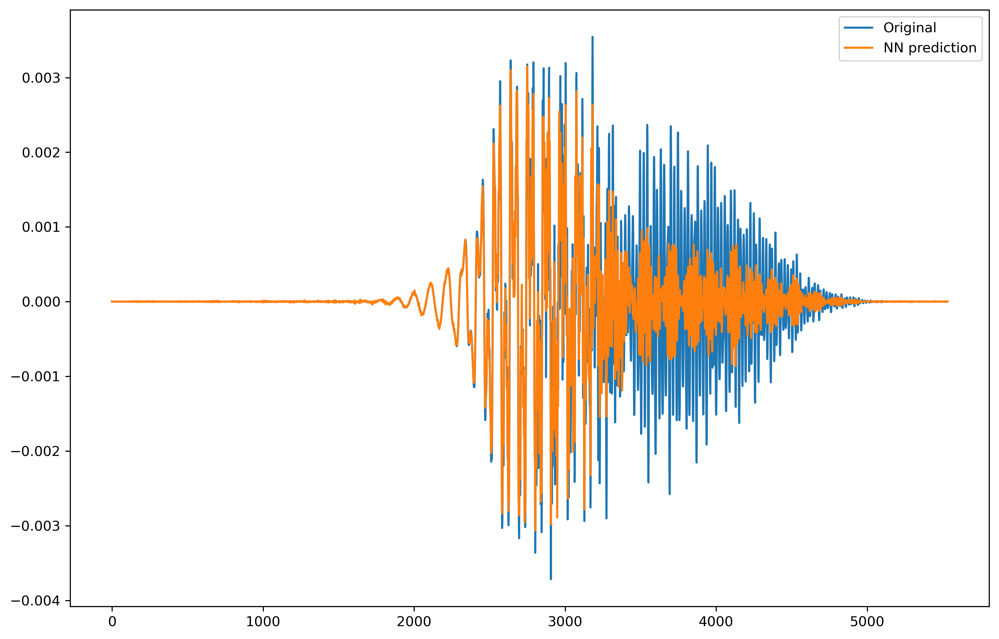

******************************************************************
Fields closeup


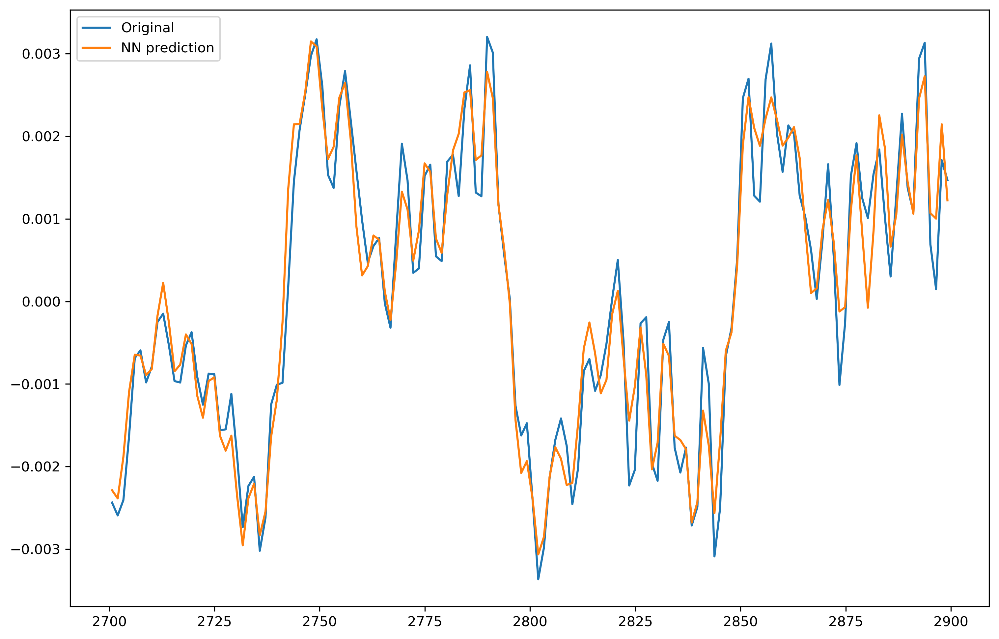

******************************************************************
Spectra


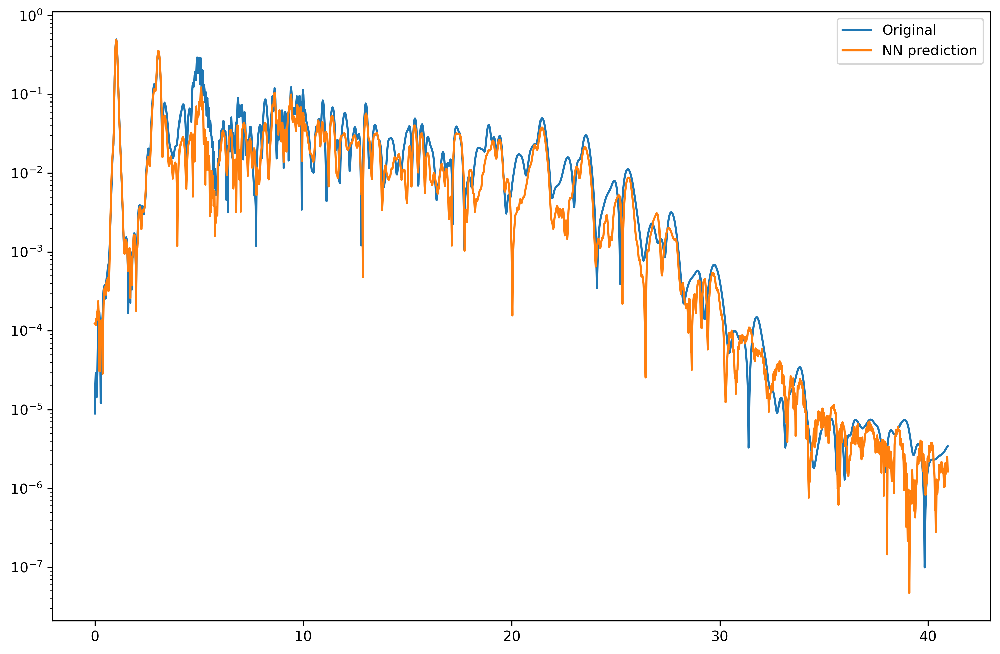

******************************************************************
Phases


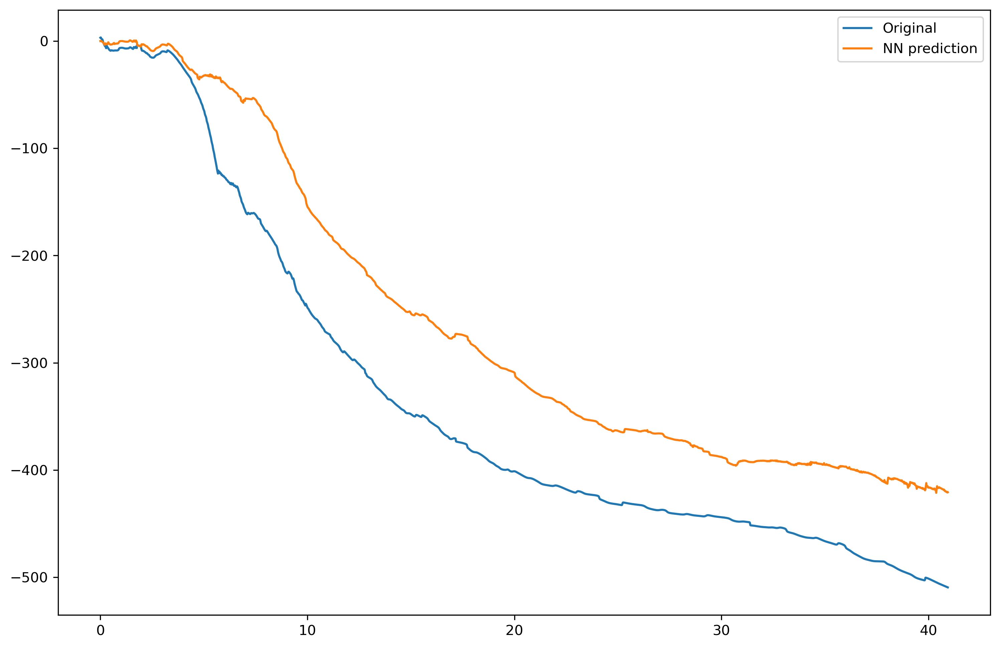

******************************************************************
Statistics


KeyError: 'accuracy'

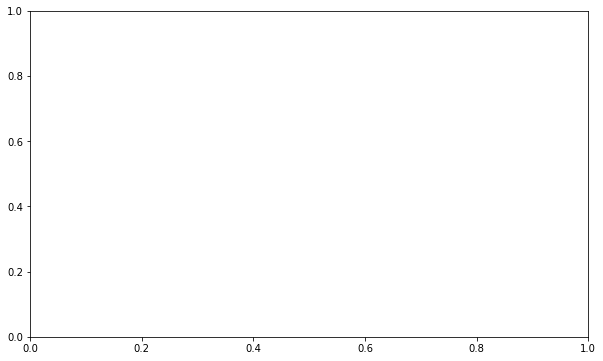

In [88]:
i = 5
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features = (np.expand_dims(x_test_f[i],0))
labels = model.predict(features)[0]

real_ = labels[:M//2+1]
imag_ = labels[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN = reconstruct(labels[:M//2+1], labels[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(labels, label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig, label = "Original")
plt.plot(t_f, y_NN, label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig))[0:M//2]), label = "Original")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN))[0:M//2]), label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[i, :M] + 1j*y_test_f[i, M:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

1/1 [==============================] - 0s 43ms/step
******************************************************************
Features


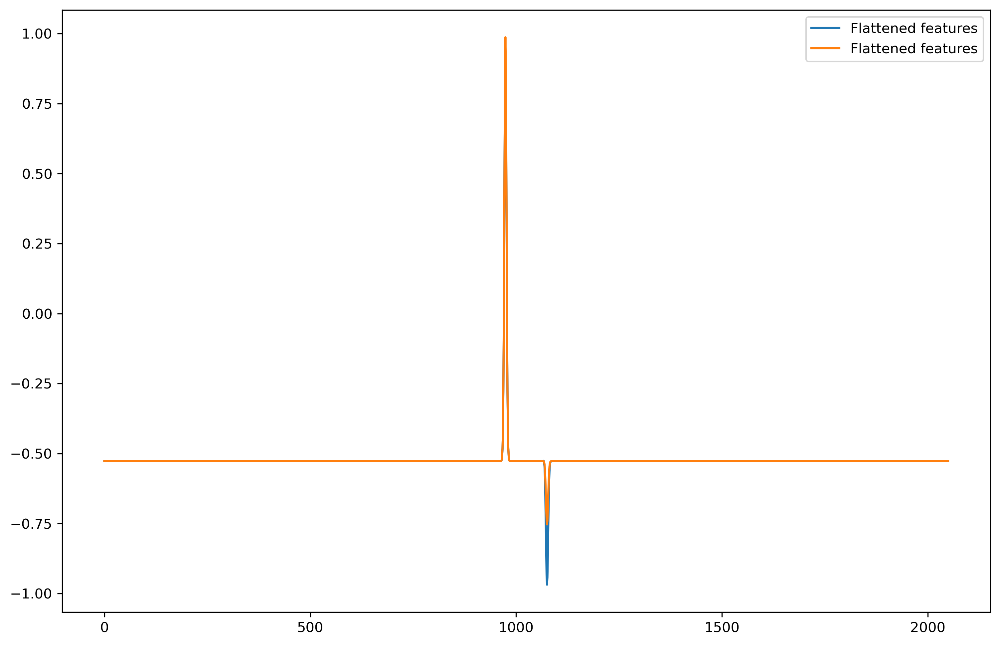

******************************************************************
Labels


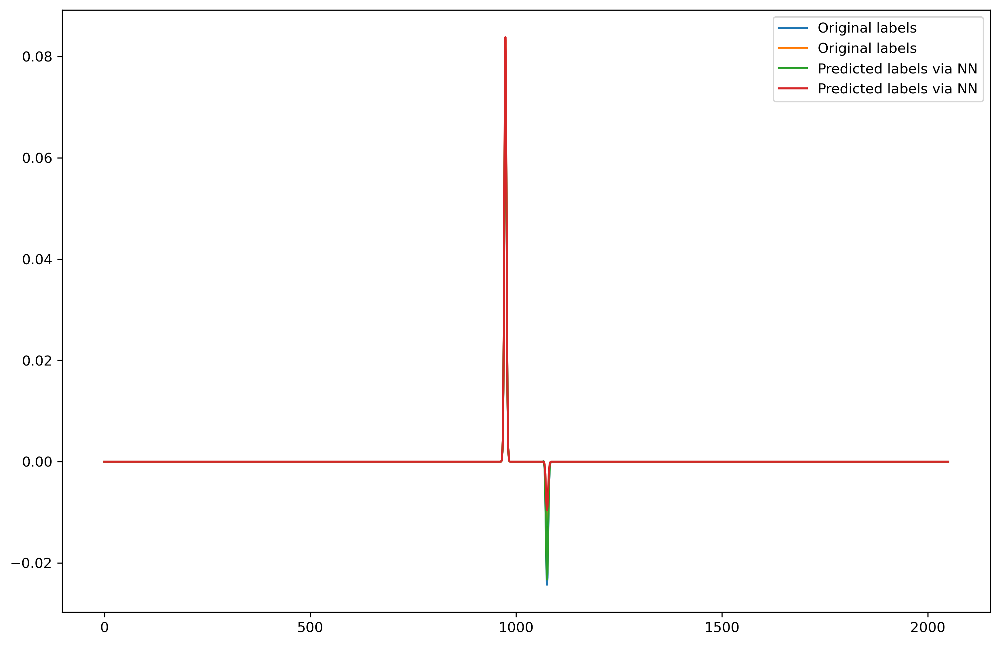

******************************************************************
Fields


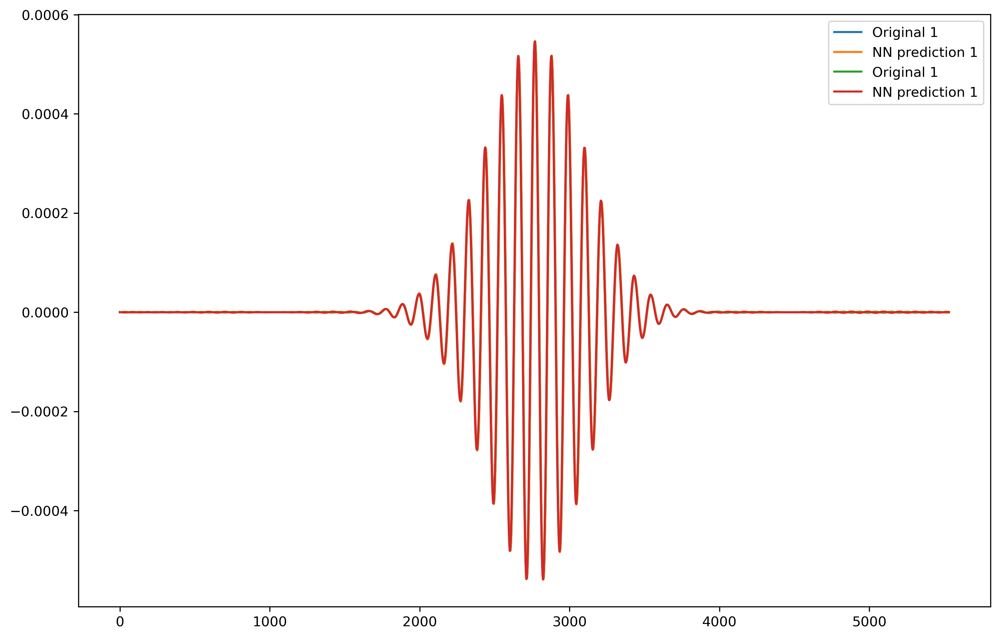

******************************************************************
Fields closeup


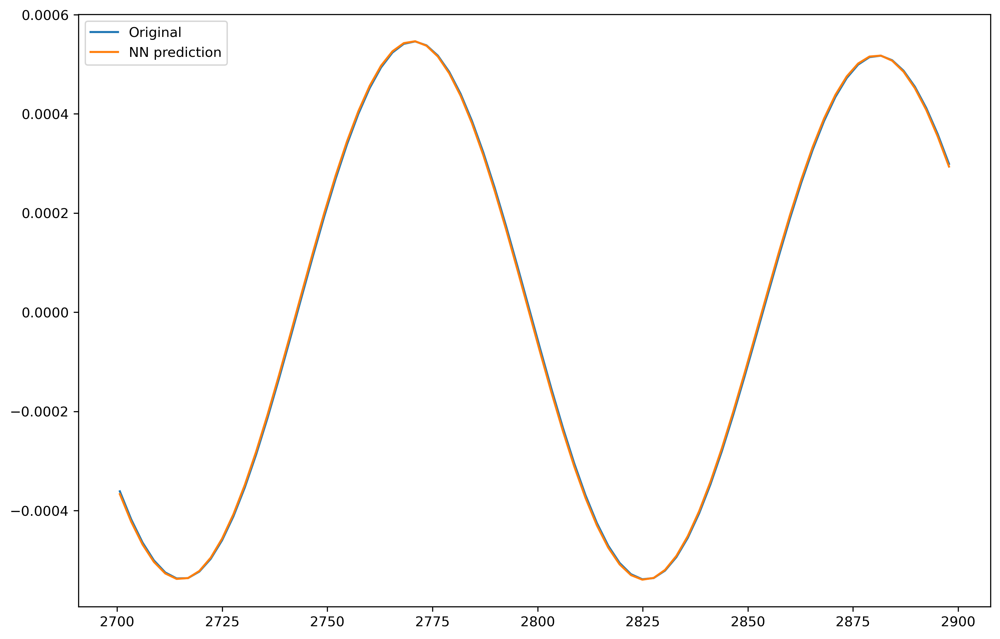

******************************************************************
Spectra


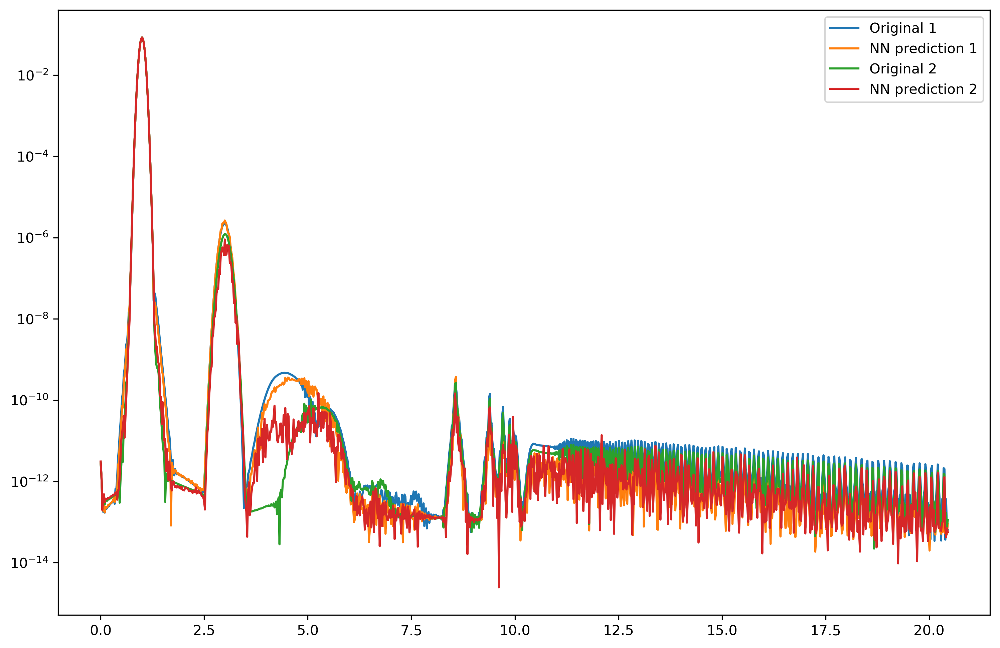

******************************************************************
Phases


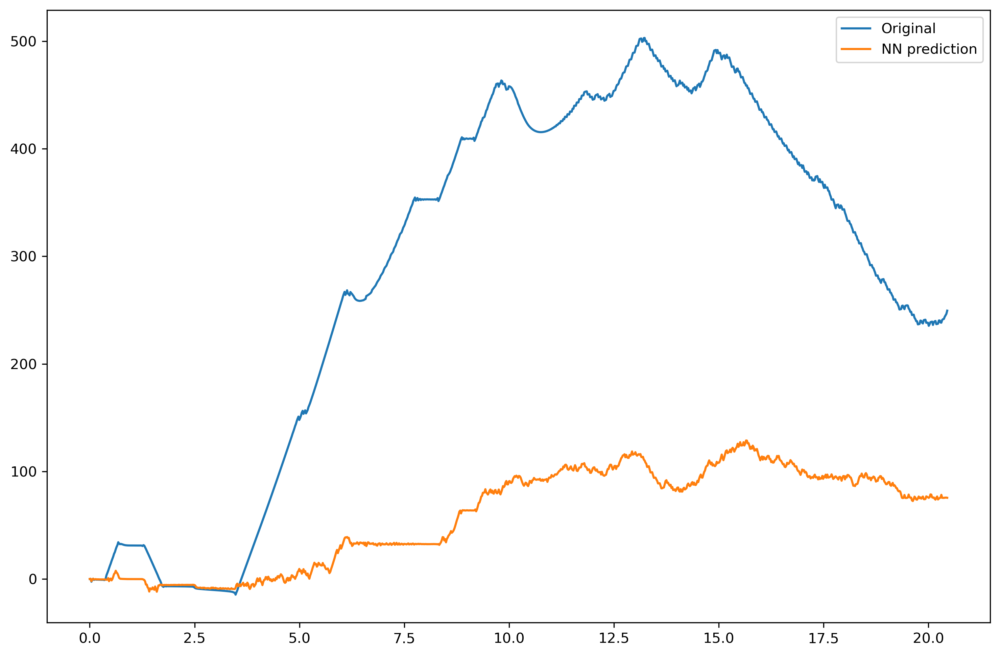

******************************************************************
Statistics


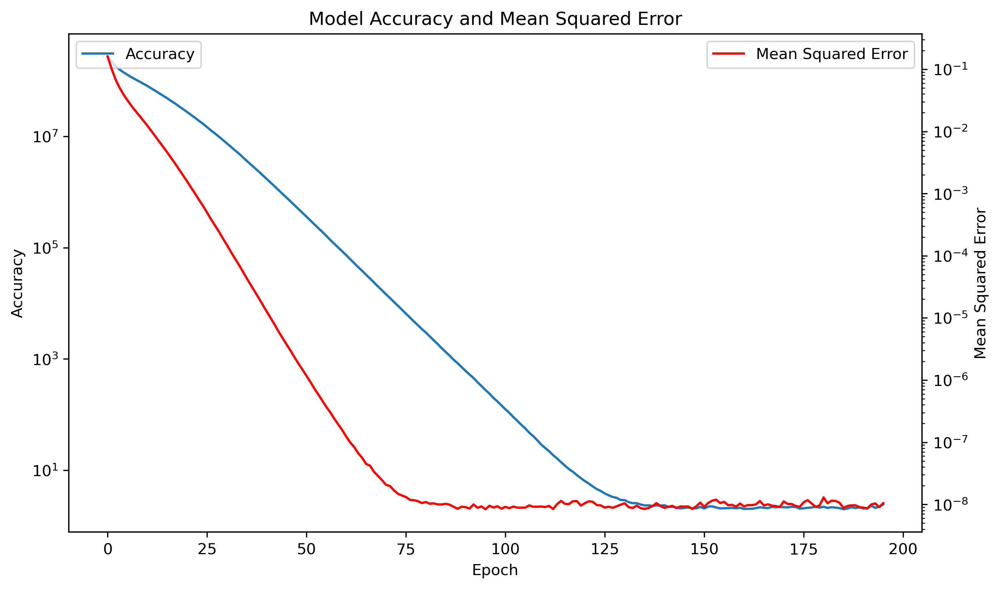

In [404]:
i = 1
j = 15
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features1 = (np.expand_dims(x_test_f[i],0))
labels1 = model.predict(features1)[0]

real_ = labels1[:M//2+1]
imag_ = labels1[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN1 = reconstruct(labels1[:M//2+1], labels1[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig1 = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
features2 = (np.expand_dims(x_test_f[j],0))
labels2 = model.predict(features2)[0]

real_ = labels2[:M//2+1]
imag_ = labels2[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN2 = reconstruct(labels2[:M//2+1], labels2[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig2 = reconstruct(y_test_f[j, :M//2+1], y_test_f[j, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features1[0]).flatten(), label = "Flattened features")
plt.plot(np.transpose(features2[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(y_test_f[j], label = "Original labels", linestyle = "-")
plt.plot(labels1, label = "Predicted labels via NN")
plt.plot(labels2, label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig1, label = "Original 1")
plt.plot(t_f, y_NN1, label = "NN prediction 1")
plt.plot(t_f, y_orig2, label = "Original 1")
plt.plot(t_f, y_NN2, label = "NN prediction 1")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig1[range_], label = "Original")
plt.plot(t_f[range_], y_NN1[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig1))[0:M//2]), label = "Original 1")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN1))[0:M//2]), label = "NN prediction 1")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig2))[0:M//2]), label = "Original 2")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN2))[0:M//2]), label = "NN prediction 2")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[i, :M] + 1j*y_test_f[i, M:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.semilogy(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# Effects of convolution layer

(1, 513, 1)


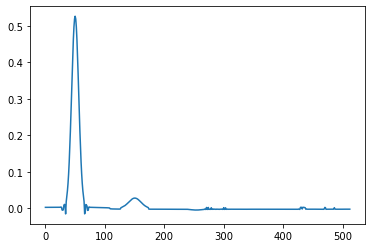

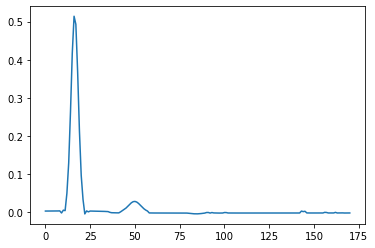

(1, 171, 128)


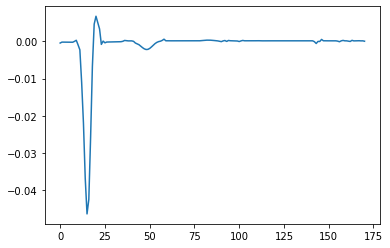

(1, 57, 128)


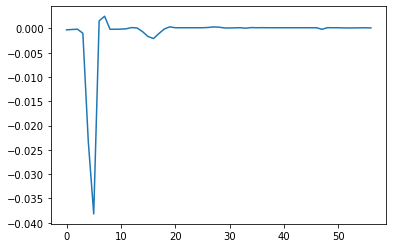

(1, 57, 64)


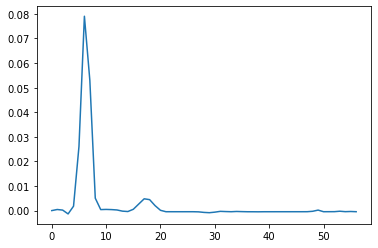

(1, 19, 32)


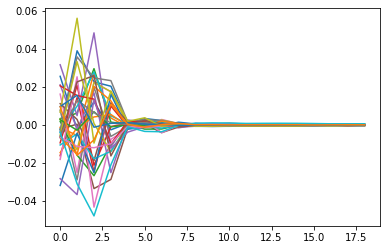

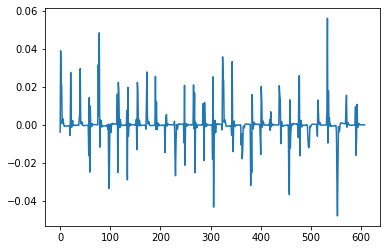

In [424]:
x = x_test_f[30,0]
x = tf.expand_dims(x, axis=1)
x = tf.expand_dims(x, axis=0)
print(x.shape)

j = 10
plt.plot(x[0,:,0])
plt.show()


# Define the input shape (batch_size, time_steps, features)
input_shape = x.shape

pool_layer = tf.keras.layers.AvgPool1D(3)
x = pool_layer(x)
plt.plot(x[0,:,0])
plt.show()

# Create a convolution layer conv1D with 32 filters, kernel size of 3 and padding='same'
conv_layer = tf.keras.layers.Conv1D(filters=128, kernel_size=3, padding='same', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer(x)
print(conv_output.shape)
plt.plot(conv_output[0,:,j])
plt.show()

pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)

print(pool_output.shape)
plt.plot(pool_output[0, :, j])
plt.show()

conv_layer2 = tf.keras.layers.Conv1D(filters=64, kernel_size=3, padding='same', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer2(pool_output)
print(conv_output.shape)
plt.plot(conv_output[0,:,j])
plt.show()

pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)

conv_layer3 = tf.keras.layers.Conv1D(filters=32, kernel_size=3, padding='same', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer3(pool_output)
print(conv_output.shape)
#plt.plot(n_th_root(conv_output[0,:,1], 1))
plt.plot(conv_output[0,:,:])
plt.show()

flattened_output = tf.keras.layers.Flatten(data_format = "channels_first")(conv_output)
plt.plot(flattened_output[0])
plt.show()

# Separate NNs, log-amp phase

In [59]:
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
np.random.shuffle(dataset)
x_train, x_test = dataset[:640], dataset[640:]

In [926]:

def logamp_phase_separation(arr, t):
    dt = t[1]-t[0]
    T = t[-1]
    N = len(arr)
    freqs = fftfreq(N, dt)*2*np.pi
    ### Compute FFT of array
    F_arr = fft(arr)
    ### Multiply by phase
    F_arr *= np.exp(-1j*freqs*T/2)
    ### Compute log(abs(amplitudes)) of the first N//2+1 points
    #try:
    amps = (np.log(np.abs(F_arr[0:N//2+1])+1e-20)+15)/30#*10#+15
    #except RuntimeWarning:
    #    amps = np.abs(F_arr[0:N//2+1])
    #    np.savetxt("data.txt", amps)
        
    ### Compute phase of the first N//2+1 points
    phases = (np.unwrap(np.angle(F_arr[0:N//2+1])))/500
    #phases = np.angle(F_arr[0:N//2+1])/np.pi
    ### Return array of size (2,(N//2 + 1)) -> [amplitudes, phases]
    return np.array([amps, phases])

def logamp_phase_reconstruction(arr, t):
    ### Size of the resulting array is (2*len(amplitudes)-1)
    N = 2*len(arr[1])-1
    arr_rec = np.zeros((N), dtype=complex)
    
    ### Extract amplitudes and phases from the input array -> [amplitudes, phases]
    amps = (arr[0])*30 - 15
    phases = (arr[1]) *500
    ### Reconstruct the Fourier transform -> second part of the result array is
    ### just a complex conjugate (implicit redundancy in FFT)
    arr_rec[0:N//2+1] = np.exp(amps)* np.exp(1j*phases)
    arr_rec[N//2+1:N] = np.flip(np.conj(arr_rec)[1:N//2+1])
    ### Multiply by phase
    dt = t[1]-t[0]
    T = t[-1]
    freqs = fftfreq(N, dt)*2*np.pi
    return ifft(arr_rec*np.exp(1j*freqs*T/2)).real
    #return ifft(arr_rec).real

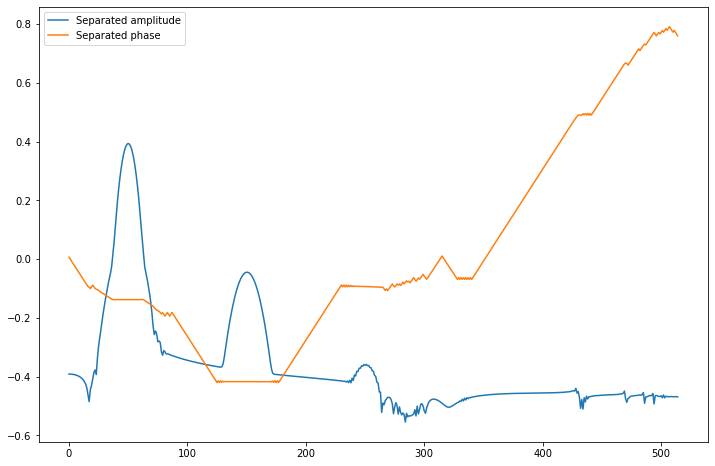

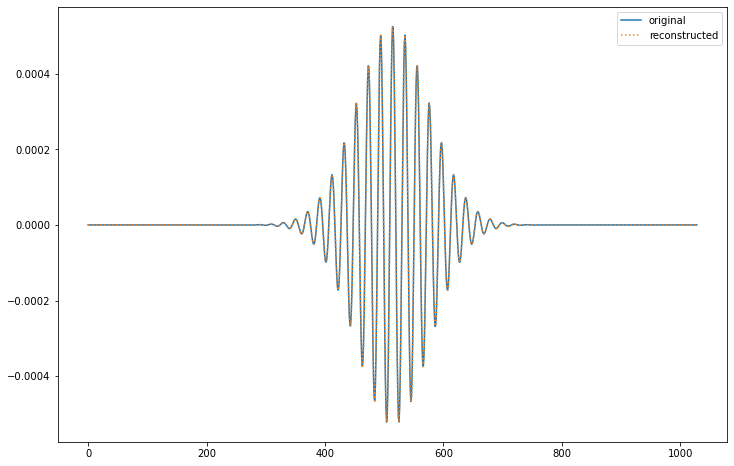

*********************************************
Are the arrays the same?
True


In [927]:
i = 100

y = NN.spectral_filter(filter(x_train[i,0], t), N)
y_separated = logamp_phase_separation(y, t_f)
t_f = np.linspace(t[0], t[-1], N)
y_rec = logamp_phase_reconstruction(y_separated, t_f)
#y_rec = ifft(y_rec).real

fig = plt.figure()
plt.plot(y_separated[0], label = "Separated amplitude")
plt.plot(y_separated[1], label = "Separated phase")
#plt.plot(np.unwrap(np.angle(fft(y)))[0:N//2+1])
#plt.plot(np.unwrap(np.angle(fft(y_rec)))[0:N//2+1])
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


fig = plt.figure()
plt.plot(y[:], label = "original")
plt.plot(y_rec[:], label = "reconstructed", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("*********************************************")
print("Are the arrays the same?")
print(np.allclose(y, y_rec))

In [928]:
### Number of points for the input and output layers
N = 1029
#N = 4097
t_f = np.linspace(t[0], t[-1], N)
x_train_f = np.array([logamp_phase_separation(NN.spectral_filter(f*x, N), t_f) for x in x_train[:,0,:]])
#y_train_f = np.array([logamp_phase_separation(NN.spectral_filter(filter(x, t), N), t_f) for x in x_train[:,1,:]])
y_train_f = np.array([logamp_phase_separation(NN.spectral_filter(f*(-x-y), N), t_f) for x, y in zip(x_train[:,0,:], x_train[:,1,:])])
x_test_f = np.array([logamp_phase_separation(NN.spectral_filter(f*x, N), t_f) for x in x_test[:,0,:]])
#y_test_f = np.array([logamp_phase_separation(NN.spectral_filter(filter(x, t), N), t_f) for x in x_test[:,1,:]])
y_test_f = np.array([logamp_phase_separation(NN.spectral_filter(f*(-x-y), N), t_f) for x, y in zip(x_test[:,0,:], x_test[:,1,:])])

(161, 2, 515)
(640, 515)
(515,)


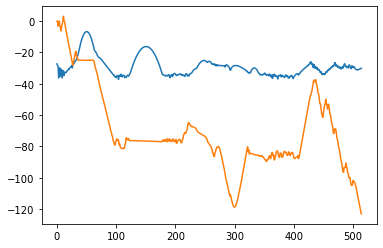

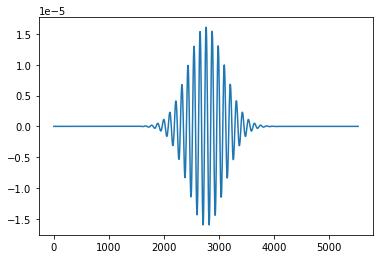

In [882]:
print(x_test_f.shape)
print(x_train_f[:,0,:].shape)
print(x_train_f[1,1,:].shape)

plt.plot(y_train_f[0,0])
plt.plot(y_train_f[0,1])
plt.show()

rec = logamp_phase_reconstruction(y_train_f[0,:], t_f)
plt.plot(t_f, rec)
plt.show()

In [929]:
reload(NN)

### Create custom NN model
model_abs = NN.TDSE_NN_4((N//2+1,), N//2+1, N=64, dropout_input = 0.99, dropout = 0.95, activation=tf.nn.tanh, bias = True)
model_abs.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_abs.summary()

model_phase = NN.TDSE_NN_4((N//2+1,), N//2+1, N=64, dropout_input = 0.99, dropout = 0.95, activation=tf.nn.tanh, bias = True)
model_phase.build(input_shape=(None, N//2+1))
### Print summary of the model (basic info)
model_phase.summary()

Model: "tdse_nn_4_179"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_180 (InputLayer)      [(None, 515)]             0         
                                                                 
 dropout_1693 (Dropout)      multiple                  0         
                                                                 
 dense_1692 (Dense)          multiple                  33024     
                                                                 
 dropout_1694 (Dropout)      multiple                  0         
                                                                 
 dense_1693 (Dense)          multiple                  4160      
                                                                 
 dropout_1695 (Dropout)      multiple                  0         
                                                                 
 dense_1694 (Dense)          multiple                

In [930]:
epochs = 600
patience = 100

### Compile model
model_abs.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model_abs.fit(x_train_f[:,0,:], y_train_f[:,0,:], epochs = epochs, 
              callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)])

### Quantify the accuracy of the model on the test data
model_abs.evaluate(x_test_f[:,0,:], y_test_f[:,0,:])


### Compile model
model_phase.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
model_phase.fit(x_train_f[:,1,:], y_train_f[:,1,:], epochs = epochs, 
                callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)])

### Quantify the accuracy of the model on the test data
model_phase.evaluate(x_test_f[:,1,:], y_test_f[:,1,:])

Epoch 1/600
20/20 [==============================] - 4s 5ms/step - loss: 2.6925 - accuracy: 0.0031
Epoch 2/600
20/20 [==============================] - 0s 5ms/step - loss: 2.0543 - accuracy: 0.0000e+00
Epoch 3/600
20/20 [==============================] - 0s 5ms/step - loss: 1.5037 - accuracy: 0.0109
Epoch 4/600
20/20 [==============================] - 0s 5ms/step - loss: 1.1084 - accuracy: 0.0078
Epoch 5/600
20/20 [==============================] - 0s 5ms/step - loss: 0.7974 - accuracy: 0.0047
Epoch 6/600
20/20 [==============================] - 0s 5ms/step - loss: 0.5924 - accuracy: 0.0156
Epoch 7/600
20/20 [==============================] - 0s 6ms/step - loss: 0.4222 - accuracy: 0.0234
Epoch 8/600
20/20 [==============================] - 0s 5ms/step - loss: 0.3156 - accuracy: 0.0219
Epoch 9/600
20/20 [==============================] - 0s 4ms/step - loss: 0.2422 - accuracy: 0.0328
Epoch 10/600
20/20 [==============================] - 0s 4ms/step - loss: 0.1962 - accuracy: 0.0328
Epoch

[0.004551763646304607, 0.02484472095966339]

1/1 [==============================] - 0s 194ms/step
******************************************************************
Features


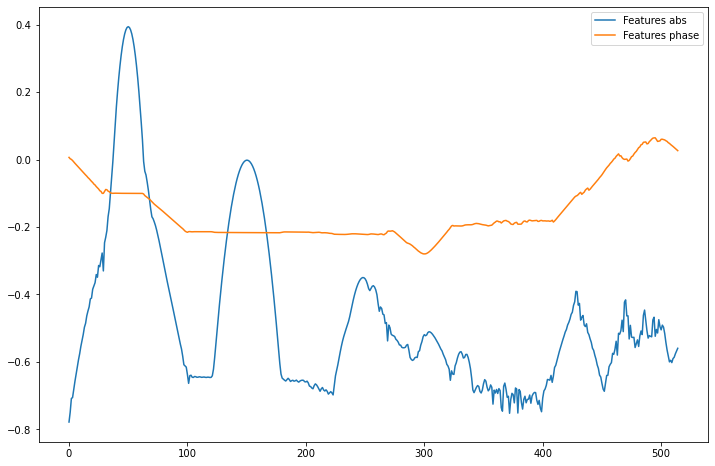

******************************************************************
Labels


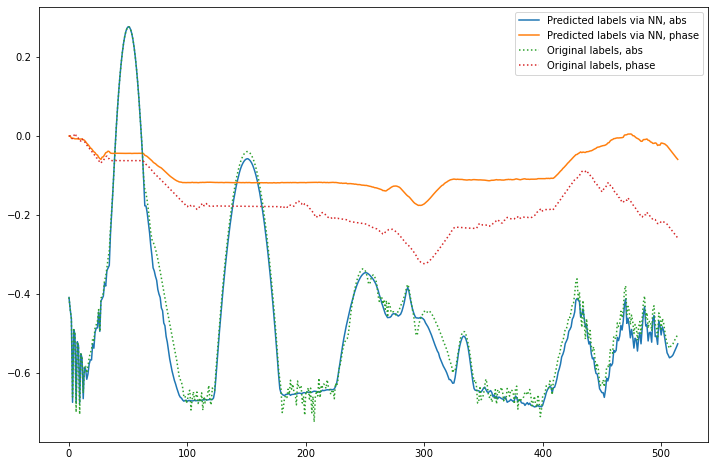

******************************************************************
Fields


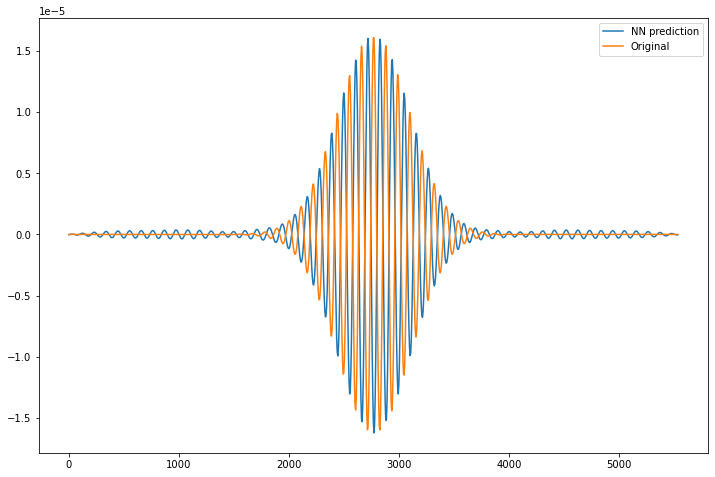

******************************************************************
Spectra


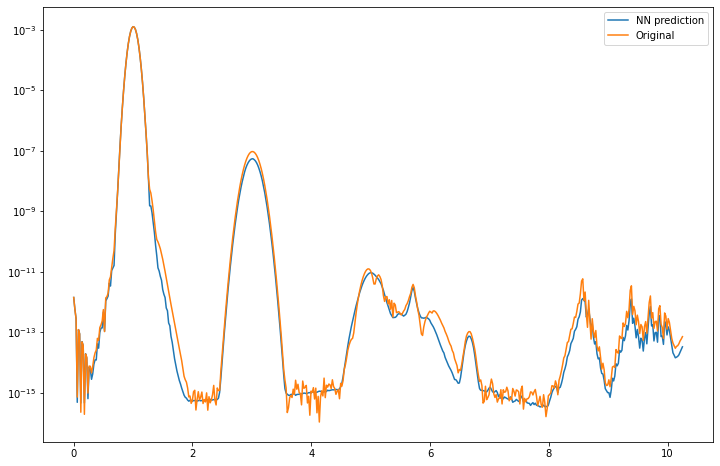

******************************************************************
Phases


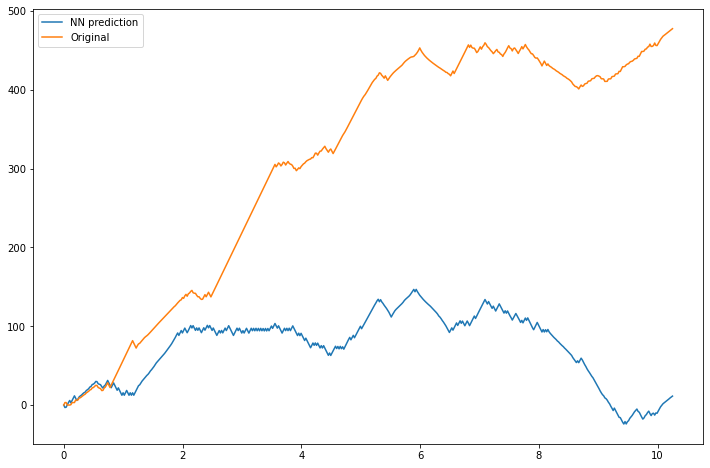

In [931]:
%matplotlib inline
i = 100
features_abs = (np.expand_dims(x_test_f[i,0],0))
features_phase = (np.expand_dims(x_test_f[i,1],0))
abs = model_abs.predict(features_abs)[0]
phase = model_phase.predict(features_phase)[0]

y_NN = logamp_phase_reconstruction(np.array([abs, phase]), t_f)
y_orig = logamp_phase_reconstruction(np.array([y_test_f[i, 0], y_test_f[i, 1]]), t_f)

N = len(y_NN)
freqs = fftfreq(N, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(features_abs[-1], label = "Features abs")
plt.plot(features_phase[-1], label = "Features phase")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(abs, label = "Predicted labels via NN, abs")
plt.plot(phase, label = "Predicted labels via NN, phase")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test_f[i,0], label = "Original labels, abs", linestyle = ":")
plt.plot(y_test_f[i,1], label = "Original labels, phase", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_NN, label = "NN prediction")
plt.plot(t_f, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
plt.show()

# Data preparation test

In [101]:
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
np.random.shuffle(dataset)
x_train, x_test = dataset[:640], dataset[640:]

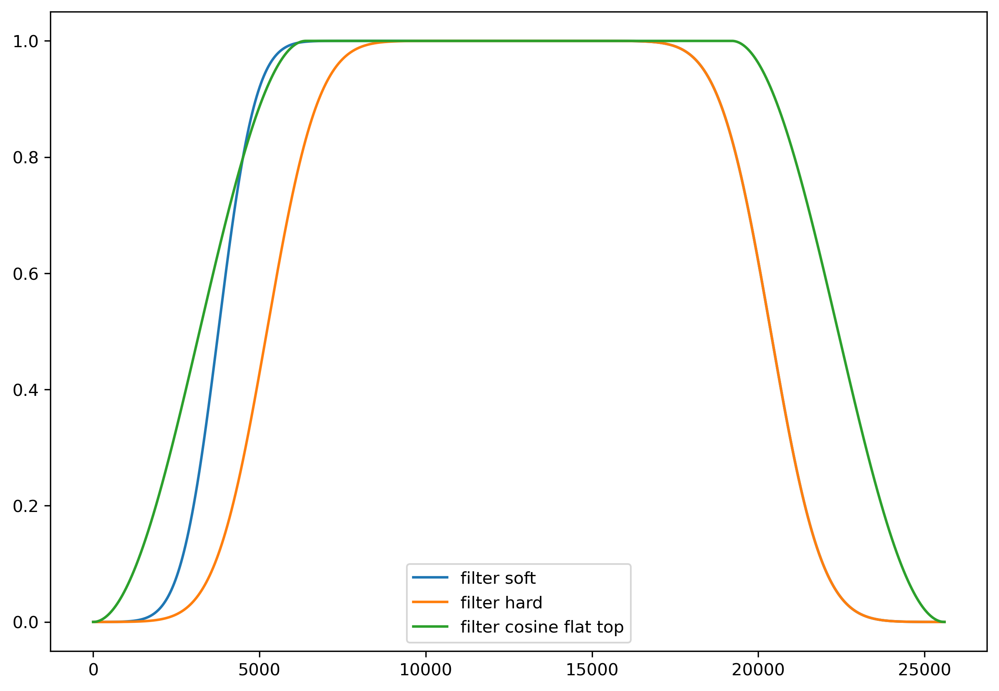

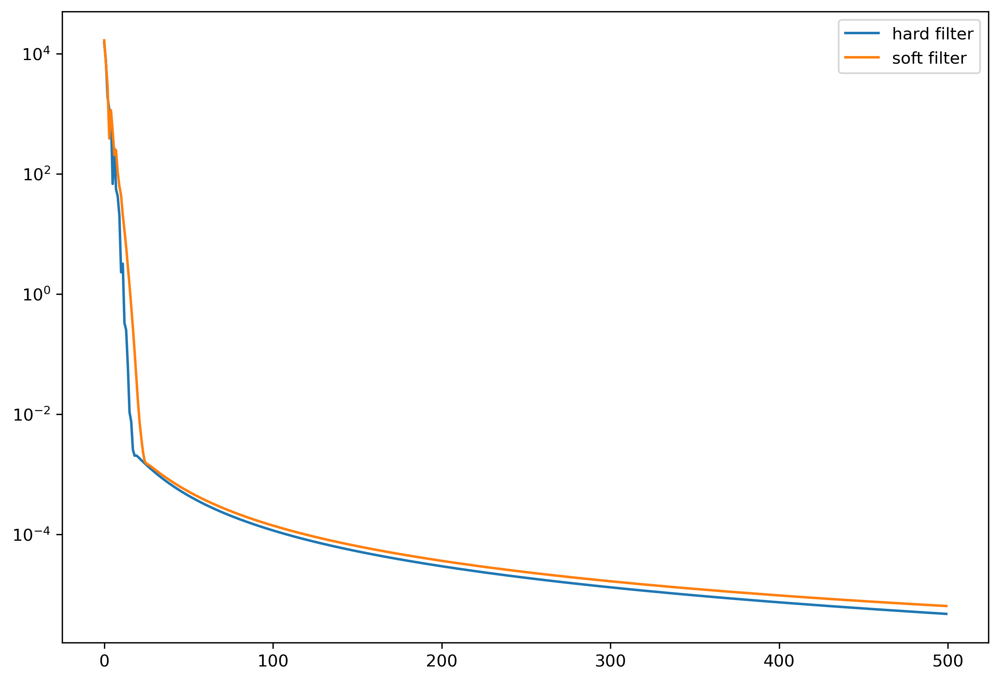

[1.00652712e-05 1.03891035e-05 1.07228401e-05 ... 1.01628651e-05
 9.93296924e-06 9.70803109e-06]


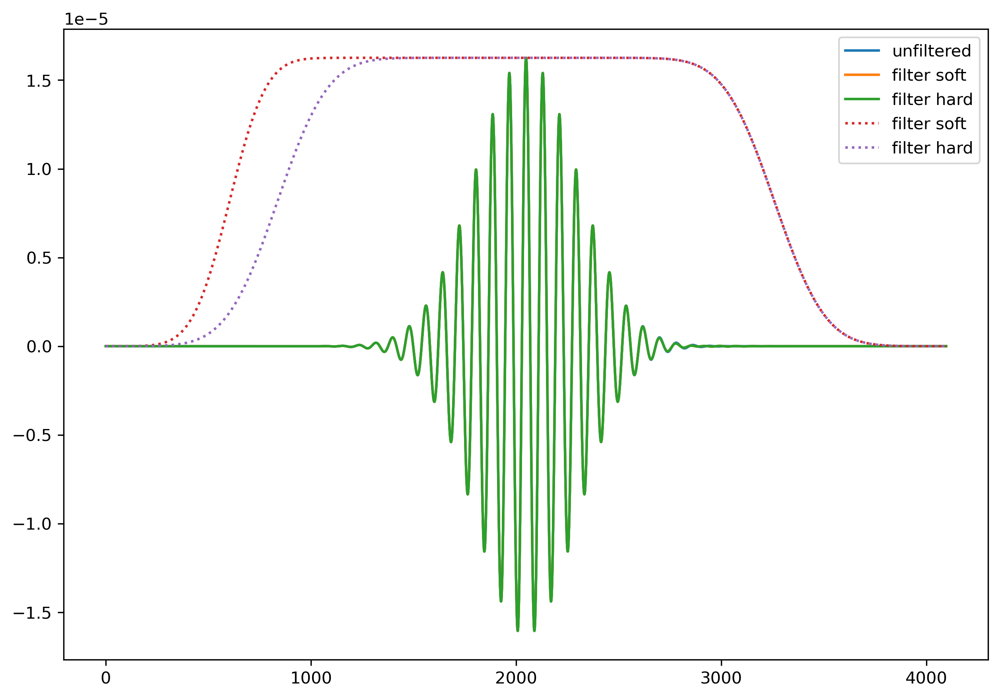

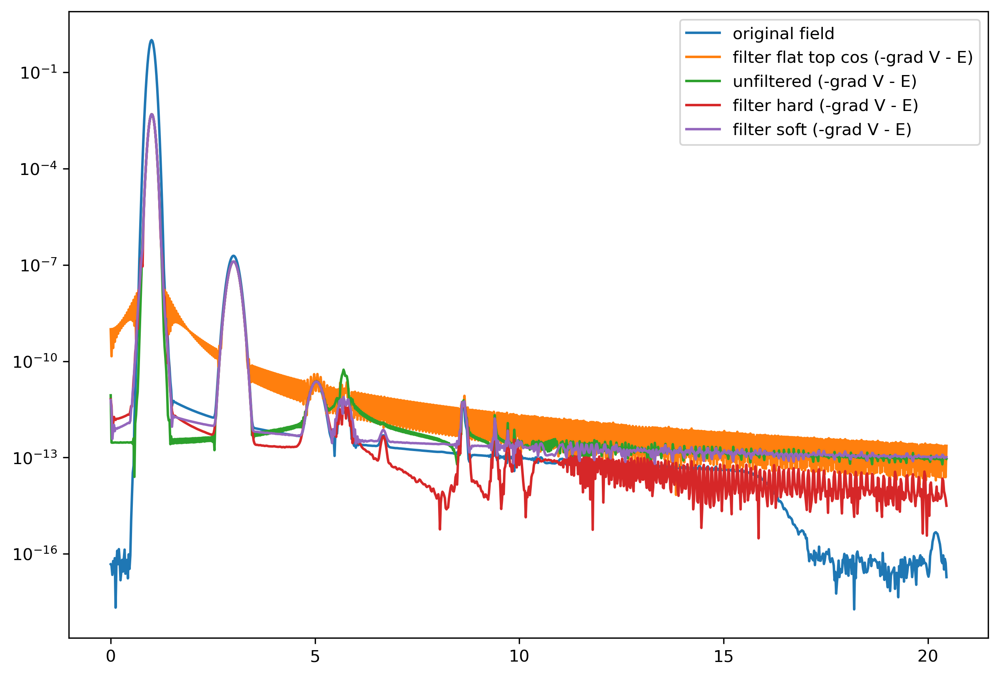

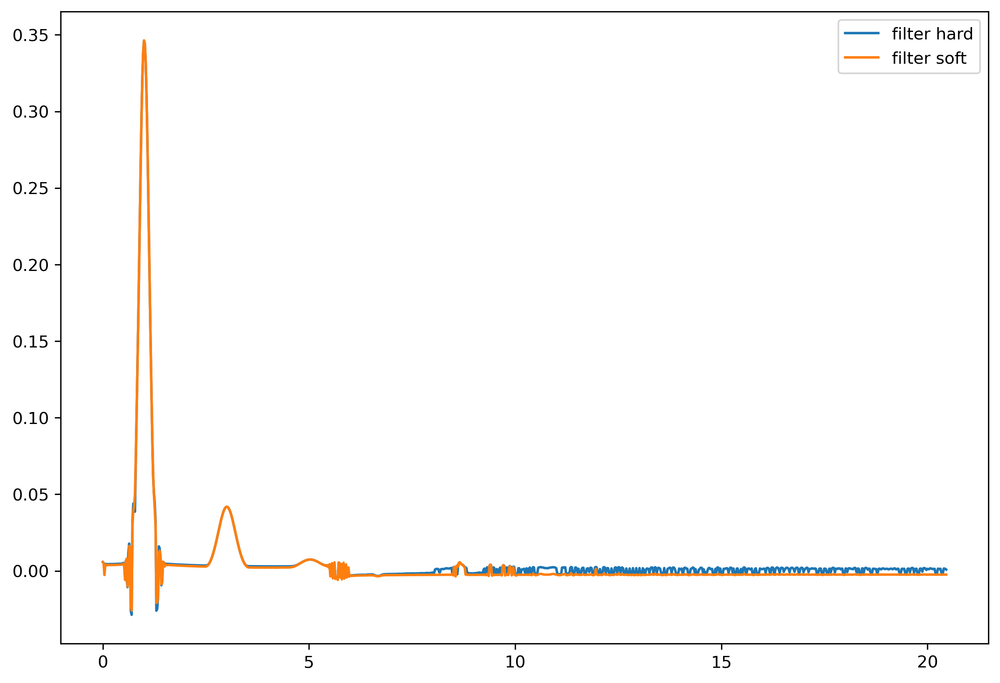

In [150]:
%matplotlib inline

#d = Data("/Volumes/NEMEC_SSD/1e10_dz=50000/data_0.h5")
d = Data("tmp/erf_filtering_final/data_k1_5.h5")
#from scipy.signal import savgol_filter

#kernel = np.array([0.25, 0.5, 0.25])
#kernel1 = np.array([0.1667,0.3333,0.1667])
#kernel1 = np.array([0.0022,0.0168,0.0777,0.2271,0.4169,0.2271,0.0777,0.0168,0.0022])
#sigma = 100

# Define the length of the kernel
#length = 101

# Create an array of indices centered at zero
#x = np.arange(length) - (length - 1) / 2

# Calculate the Gaussian function at each index
#gauss_array = np.exp(-x**2 / (2 * sigma**2))

# Normalize the array to sum to one
#gauss_array /= gauss_array.sum()

#kernel1 = gauss_array

#kernel2 = np.array([-0.3333,-0.6667,-0.3333])
#kernel2 = np.array([-0.0044,-0.0336,-0.1555,-0.4542,-1.2506,-0.4542,-0.1555,-0.0336,-0.0044])

#M = 21
#kernel3 = np.ones((M))/M

i=232

### Temporal filter
def filter2(arr, t):
    t_max = t[-1]
    M = len(t)
    shift = t_max/5
    shift = t_max/4.9
    shift_2 = t_max/6.8
    slope = t_max/14.8
    slope_2 = t_max/20.5
    arr[:M//2] = arr[:M//2] * (1+np.array(list(map(erf, (t[:M//2]-shift_2)/(slope_2)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/6)/(t_max/15)))))/2
    arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/7)/(t_max/25)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/4)/(t_max/20)))))/2
    #arr = arr * (1-np.array(list(map(erf, (t-t_max+t_max/5)/(t_max/12)))))/2
    return arr

def filter3(arr, t):
    t_max = t[-1]
    M = len(t)
    shift = t_max/6.
    shift = t_max/4.9
    slope = t_max/30.
    slope = t_max/14.8
    arr[:M//2] = arr[:M//2] * (1+np.array(list(map(erf, (t[:M//2]-shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/6)/(t_max/15)))))/2
    arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+shift)/(slope)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/7)/(t_max/25)))))/2
    #arr[M//2:] = arr[M//2:] * (1-np.array(list(map(erf, (t[M//2:]-t_max+t_max/4)/(t_max/20)))))/2
    #arr = arr * (1-np.array(list(map(erf, (t-t_max+t_max/5)/(t_max/12)))))/2
    return arr

def filter4(arr, t):
    t_max = t[-1]
    dt = t[1]-t[0]
    
    #x = np.linspace(0, t_max, 101)
    t_frac = t_max/4
    t_index = int(t_frac/dt)
    arr[:t_index] = arr[:t_index] * np.cos(0.5*(t[:t_index]/t_frac - 1)*np.pi)**2
    arr[-t_index:] = arr[-t_index:] * np.cos(0.5*(t[-t_index:]/t_frac - 1)*np.pi)**2
    return arr
    

f = filter2(np.ones((len(t))), t)
f_h = filter3(np.ones((len(t))), t)
f_c = filter4(np.ones((len(t))), t)
#f = blackman(len(t))
#f = gaussian(len(t), len(t)/7)
fig = plt.figure()
plt.plot(f, label = "filter soft")
plt.plot(f_h, label = "filter hard")
plt.plot(f_c, label = "filter cosine flat top")
plt.legend()
fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()

fig = plt.figure()
plt.semilogy(np.abs(fft(f_h)[0:500]), label = "hard filter")
plt.semilogy(np.abs(fft(f)[0:500]), label = "soft filter")
#plt.semilogy(np.abs(fft(f_c)[0:500]), label = "filter cosine flat top")
#plt.semilogy(np.abs(fft(blackman(len(t)))[0:500]), label = "blackman")
fig.dpi = 300
fig.set_size_inches(10,7)
plt.legend()
plt.show()

M = 4097

fig = plt.figure()
#src = NN.spectral_filter(filter2(-x_train[i,0]-(x_train[i,1]), t), 1025)
src = NN.spectral_filter(f*(-x_train[i,0]-x_train[i,1]), M)
src = NN.spectral_filter((-1*d.E_z-f*d.grad_pot.real), M)
src_h = NN.spectral_filter(f_h*(-x_train[i,0]-x_train[i,1]), M)
src_h = NN.spectral_filter((-1*d.E_z-f_h*d.grad_pot.real), M)
src_c = NN.spectral_filter(-1*d.E_z-f_c*d.grad_pot.real, M)

t_f = np.linspace(t[0], t[-1], M)
freqs = 2*np.pi*fftfreq(M, t_f[1]-t_f[0])/0.0568
#src = savgol_filter(src, 101, 3)
#src_blurred = np.convolve(src, kernel1, 'same')
#src_dum = src - src_blurred
#scale = 100.
#src = src + scale*src_dum
#src = src_blurred
#src = np.convolve(src, kernel2, 'same')
#src = np.convolve(src, kernel3, 'same')
#src = NN.spectral_filter((-d.E_z-f*d.grad_pot), 1025)
src_unfiltered = NN.spectral_filter(-x_train[i,0]-x_train[i,1], M)
src_unfiltered = NN.spectral_filter(-1*d.E_z-d.grad_pot.real, M)
f = filter2(np.ones((M)), t_f)
f_h = filter3(np.ones((M)), t_f)
f_c = filter4(np.ones((M)), t_f)
#f = blackman(len(t_f))
print(f)
plt.plot(src_unfiltered, label = "unfiltered")
plt.plot(src, label = "filter soft")
plt.plot(src, label = "filter hard")
plt.plot(f*np.abs(src).max(), label = "filter soft", linestyle = ":")
plt.plot(f_h*np.abs(src).max(), label = "filter hard", linestyle = ":")
plt.legend()
m = 5
x = fft_real_imag_separation(src, t_f, n = m)
x3 = fft_real_imag_separation(src_h, t_f, n = m)
x4 = fft_real_imag_separation(src_c, t_f, n = m)
x2 = fft_real_imag_separation(src_unfiltered, t_f, n = 5)
#plt.plot(fft_real_imag_reconstruction(x[0], x[1], t_f, n = 11))

fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()

fig = plt.figure()
plt.semilogy(freqs[:M//4],np.abs(fft(d.E_z)[:M//4]), label = "original field")
plt.semilogy(freqs[:M//4],np.abs(fft(src_c)[:M//4]), label = "filter flat top cos (-grad V - E)")
plt.semilogy(freqs[:M//4],np.abs(fft(src_unfiltered)[:M//4]), label = "unfiltered (-grad V - E)")
plt.semilogy(freqs[:M//4],np.abs(fft(src_h)[:M//4]), label = "filter hard (-grad V - E)")
plt.semilogy(freqs[:M//4],np.abs(fft(src)[:M//4]), label = "filter soft (-grad V - E)")
fig.dpi = 300
fig.set_size_inches(10,7)
plt.legend()
plt.show()

fig = plt.figure()
#plt.plot(x[1])
#plt.plot(x2[0], label = "unfiltered")
#plt.plot(x4[0], label = "filter flat top cosine")
plt.plot(freqs[:M//4], x3[0][:M//4], label = "filter hard")
plt.plot(freqs[:M//4], x[0][:M//4], label = "filter soft")
#plt.plot(x2[1])
#plt.plot(f)
plt.legend()
fig.dpi = 300
fig.set_size_inches(10,7)
plt.show()


#fig = plt.figure()
#plt.plot(np.abs(fft(x[0]))[0:len(x[0])//2], label = "real filtered")
#plt.legend()
#fig.dpi = 300
#fig.set_size_inches(10,7)
#plt.show()


#fig = plt.figure()
#xf_re = fft(x[0])
#xf_im = fft(x[1])
#xf_re[100:-101] = 0.*xf_re[100:-101]
#xf_im[100:-101] = 0.*xf_im[100:-101]
#plt.plot(ifft(xf_re).real, label = "real filtered")

#x_re = ifft(xf_re).real
#x_im = ifft(xf_im).imag
#plt.legend()
#fig.dpi = 300
#fig.set_size_inches(10,7)
#plt.show()


#fig = plt.figure()
#plt.semilogy(np.abs(fft(src)[:512]), label = "unfiltered")
#plt.semilogy(np.abs(fft(fft_real_imag_reconstruction(x_re, x_im, t_f, n = 5)))[:512], label = "filtered")
#fig.dpi = 300
#fig.set_size_inches(10,7)
#plt.legend()
#plt.show()



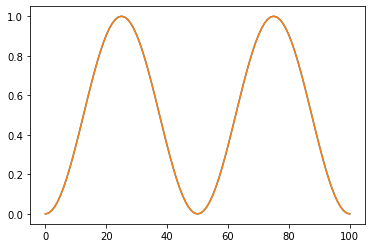

In [86]:
t_max = 1000
x = np.linspace(0, t_max, 101)
x_frac = t_max/4
plt.plot((np.cos((x/x_frac - 1)*np.pi)+1)/2)
plt.plot(np.cos(1/2*x/x_frac*np.pi - np.pi/2)**2)
plt.show()

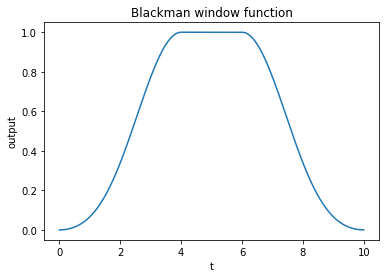

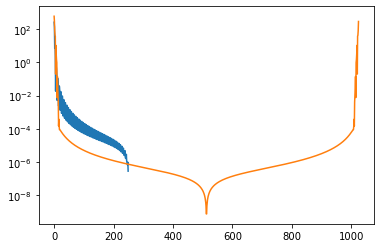

In [98]:
def blackman_window(t, t_0, t_max):
    # create an empty array for the output
    output = np.zeros_like(t)
    # get the number of points in the input array
    M = len(t)
    # get the index of t_0 in the input array
    i_0 = np.argmin(np.abs(t - t_0))
    # get the index of t_max - t_0 in the input array
    i_1 = np.argmin(np.abs(t - (t_max - t_0)))
    # create a blackman window of length 2 * i_0 using numpy
    window = np.blackman(2 * i_0+1)
    # assign the first half of the window to the output array
    output[:i_0] = window[:i_0]
    # assign 1 to the output array between t_0 and t_max - t_0
    output[i_0:i_1] = 1
    # assign the second half of the window to the output array
    output[i_1:] = window[i_0:]
    # return the output array
    return output

# create a sample array of time values from 0 to 10 with 101 points
t = np.linspace(0, 10, 501)
# set t_0 to 2
t_0 = 4
# set t_max to 10
t_max = 10
# call the function blackman_window with the sample values
output = blackman_window(t, t_0, t_max)
# plot the output array against the input array
plt.plot(t, output)
# add labels and title
plt.xlabel("t")
plt.ylabel("output")
plt.title("Blackman window function")
# show the plot
plt.show()

plt.semilogy(np.abs(fft(output))[:250])
plt.semilogy(np.abs(fft(f)))
plt.show()

# Learning on real and imaginary part, two separate NNs

In [97]:
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
dataset, t = load_fields_from_h5("tmp/d_n_test_dz=25000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e14_dz=25000/")
#np.random.shuffle(dataset)
#x_train, x_test = dataset[:640], dataset[640:]
#x_train, x_test = dataset[:340], dataset[340:]

In [98]:
import random
N = 4097
N = 1025
N = 2049
n = 5
m = 1
t_f = np.linspace(t[0], t[-1], N)
freqs = fftfreq(len(x_test[-1,0]), t[1])*2*np.pi
f = tools.filter(np.ones((len(t))), t)
K = 8.372e-8
K = 0.
#x_train_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_train[:,0]])
#y_train_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1)), axis = None) for y in x_train])
#x_test_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_test[:,0]])
#y_test_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1)), axis = None) for y in x_test])
#x_train_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_train[:,0]])
#y_train_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = m)), axis = None) for y in x_train])
#x_test_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n)) for x in x_test[:,0]])
#y_test_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = m)), axis = None) for y in x_test])

#x_f = np.array([np.transpose(fft_real_imag_separation2(NN.spectral_filter(f*x, N), t_f, 50000*i, n = n)) for i, x in enumerate(dataset[0:1000,0])])
#y_f = np.array([np.concatenate(np.array(fft_real_imag_separation2(NN.spectral_filter(f*(y[1]-1*y[0]), N), t_f, 50000*i, n = m)), axis = None) for i, y in enumerate(dataset[0:1000])])

#xf = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*x)*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = n)) for i, x in enumerate(dataset[0:1000,0])])
#yf = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*(-y[1]-1*y[0]))*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = m)), axis = None) for i, y in enumerate(dataset[0:1000])])

xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for i, x in enumerate(dataset[0:1000,0])])
yf = np.array([preprocess(f*(-y[1]-1*y[0]), N, t, n = m) for i, y in enumerate(dataset[0:1000])])

#x_f = np.array([np.transpose(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*x)*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = n)) for i, x in enumerate(dataset[0:500,0])])
#y_f = np.array([np.concatenate(np.array(fft_real_imag_separation(NN.spectral_filter(ifft(fft(f*(-y[1]-1*y[0]))*np.exp(1j*K*50000*i*freqs)).real, N), t_f, n = m)), axis = None) for i, y in enumerate(dataset[0:500])])

#shifts = [random.uniform(-t[-1]/100, t[-1]/100) for i in range(1000)]
#xf = np.concatenate(np.array([[np.transpose(preprocess(f*x, N, t, n = n, shift=shift)) for i, x in enumerate(dataset[0:1,0])] for shift in shifts]))
#yf = np.concatenate(np.array([[np.concatenate(preprocess(-f*(y[1]+1*y[0]), N, t, n = m, shift=shift)) for i, y in enumerate(dataset[0:1])] for shift in shifts]))
#xf = np.concatenate(np.array([[np.transpose(preprocess2(1*x, N, t, shift=shift)) for i, x in enumerate(dataset[0:1,0])] for shift in shifts]))
#yf = np.concatenate(np.array([[np.concatenate(preprocess2(-1*(y[1]+1*y[0]), N, t, shift=shift)) for i, y in enumerate(dataset[0:1])] for shift in shifts]))

[335, 73, 721, 227, 236, 489, 735, 528, 430, 436, 666, 200, 412, 90, 26, 273, 315, 1, 61, 326, 335, 565, 388, 526, 682, 209, 508, 192, 368, 35, 622, 433, 655, 651, 645, 665, 186, 97, 238, 798, 131, 582, 564, 520, 652, 573, 779, 203, 521, 524, 122, 383, 503, 349, 233, 455, 178, 101, 458, 193, 168, 618, 173, 323, 691, 7, 269, 765, 82, 170, 642, 402, 235, 740, 201, 523, 325, 495, 436, 327, 210, 207, 509, 584, 778, 384, 764, 479, 609, 147, 517, 586, 365, 660, 386, 8, 408, 683, 79, 702, 192, 165, 121, 467, 249, 228, 687, 50, 196, 460, 146, 521, 744, 305, 52, 483, 338, 736, 787, 675, 709, 103, 50, 495, 754, 554, 201, 31, 493, 433, 446, 470, 788, 755, 394, 539, 301, 182, 489, 52, 268, 10, 254, 23, 187, 427, 125, 182, 400, 717, 305, 264, 224, 105, 538, 57, 783, 297, 377, 55, 754, 668, 146, 526, 231, 139, 744, 29, 477, 381, 716, 374, 138, 664, 445, 709, 126, 161, 449, 400, 572, 382, 707, 306, 557, 466, 392, 400, 439, 471, 495, 138, 164, 395, 665, 219, 380, 590, 216, 535, 617, 783, 604, 270, 459

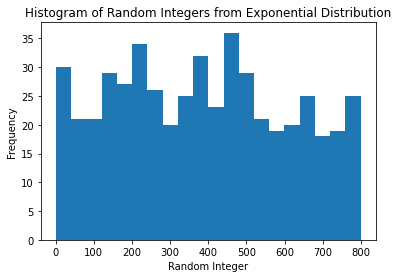

In [101]:
samples = generate_random_integers(500, lambda_=0.1, max_index=800)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [102]:
print(xf.shape)
print(yf.shape)

#p = np.random.permutation(len(x_f))
#x_f = x_f[p]
#y_f = y_f[p]
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(801, 1025, 2)
(801, 2, 1025)
(500, 1025, 2)
(500, 2, 1025)


In [103]:
#x_train_f, x_test_f = x_f[:800], x_f[800:]
#x_train_f, x_test_f = x_f[:1600], x_f[1600:]
#x_train_f, x_test_f = x_f[:3000], x_f[3000:]
#x_train_f, x_test_f = x_f[:240], x_f[240:]
x_train_f, x_test_f = x_f[:400], x_f[400:]
#y_train_f, y_test_f = y_f[:800], y_f[800:]
#y_train_f, y_test_f = y_f[:1600], y_f[1600:]
#y_train_f, y_test_f = y_f[:3000], y_f[3000:]
y_train_f, y_test_f = y_f[:400], y_f[400:]
#y_train_f, y_test_f = y_f[:240], y_f[240:]

In [104]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(400, 1025, 2)
(400, 2, 1025)
(100, 1025, 2)
(100, 2, 1025)


In [739]:
### Number of points for the input and output layers
N = 1025
#N = 4097
n = 5
t_f = np.linspace(t[0], t[-1], N)
f = filter2(np.ones((len(t))), t)
x_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n) for x in x_train[:,0]])
y_train_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1) for y in x_train])
x_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*x, N), t_f, n = n) for x in x_test[:,0]])
y_test_f = np.array([fft_real_imag_separation(NN.spectral_filter(f*(-y[1]-1*y[0]), N), t_f, n = 1) for y in x_test])

In [105]:
reload(NN)

### Create custom NN model
model_real2 = NN.TDSE_NN_4((2, N//2+1,), N//2+1, N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input = 0.8)
model_real2.build(input_shape=(None, 2, N//2+1))
### Print summary of the model (basic info)
model_real2.summary()

model_imag2 = NN.TDSE_NN_4((2, N//2+1,), N//2+1, N=64, activation=tf.nn.tanh, bias = True, dropout = 0.6, dropout_input = 0.8)
model_imag2.build(input_shape=(None, 2, N//2+1))
### Print summary of the model (basic info)
model_imag2.summary()

Model: "tdse_nn_4_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 2, 1025)]         0         
                                                                 
 dropout_88 (Dropout)        multiple                  0         
                                                                 
 dense_88 (Dense)            multiple                  131264    
                                                                 
 dropout_89 (Dropout)        multiple                  0         
                                                                 
 dense_89 (Dense)            multiple                  4160      
                                                                 
 dropout_90 (Dropout)        multiple                  0         
                                                                 
 dense_90 (Dense)            multiple                  

In [106]:
epochs = 600
patience = 70

### Compile model
model_real2.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_real2 = model_real2.fit(x_train_f, y_train_f[:,0], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=128)

### Quantify the accuracy of the model on the test data
model_real2.evaluate(x_test_f, y_test_f[:,0])


### Compile model
model_imag2.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_imag2 = model_imag2.fit(x_train_f, y_train_f[:,1], epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=128)

### Quantify the accuracy of the model on the test data
model_imag2.evaluate(x_test_f, y_test_f[:,1])

Epoch 1/600
4/4 [==============================] - 3s 10ms/step - loss: 0.0999 - accuracy: 0.0000e+00
Epoch 2/600
4/4 [==============================] - 0s 16ms/step - loss: 0.0837 - accuracy: 0.0000e+00
Epoch 3/600
4/4 [==============================] - 0s 19ms/step - loss: 0.0724 - accuracy: 0.0000e+00
Epoch 4/600
4/4 [==============================] - 0s 17ms/step - loss: 0.0618 - accuracy: 0.0000e+00
Epoch 5/600
4/4 [==============================] - 0s 15ms/step - loss: 0.0528 - accuracy: 0.0025
Epoch 6/600
4/4 [==============================] - 0s 12ms/step - loss: 0.0446 - accuracy: 0.0050
Epoch 7/600
4/4 [==============================] - 0s 10ms/step - loss: 0.0380 - accuracy: 0.0000e+00
Epoch 8/600
4/4 [==============================] - 0s 10ms/step - loss: 0.0315 - accuracy: 0.0025
Epoch 9/600
4/4 [==============================] - 0s 11ms/step - loss: 0.0278 - accuracy: 0.0025
Epoch 10/600
4/4 [==============================] - 0s 12ms/step - loss: 0.0232 - accuracy: 0.0025

[1.736125891486917e-13, 0.6299999952316284]

1/1 [==============================] - 0s 184ms/step
******************************************************************
Features


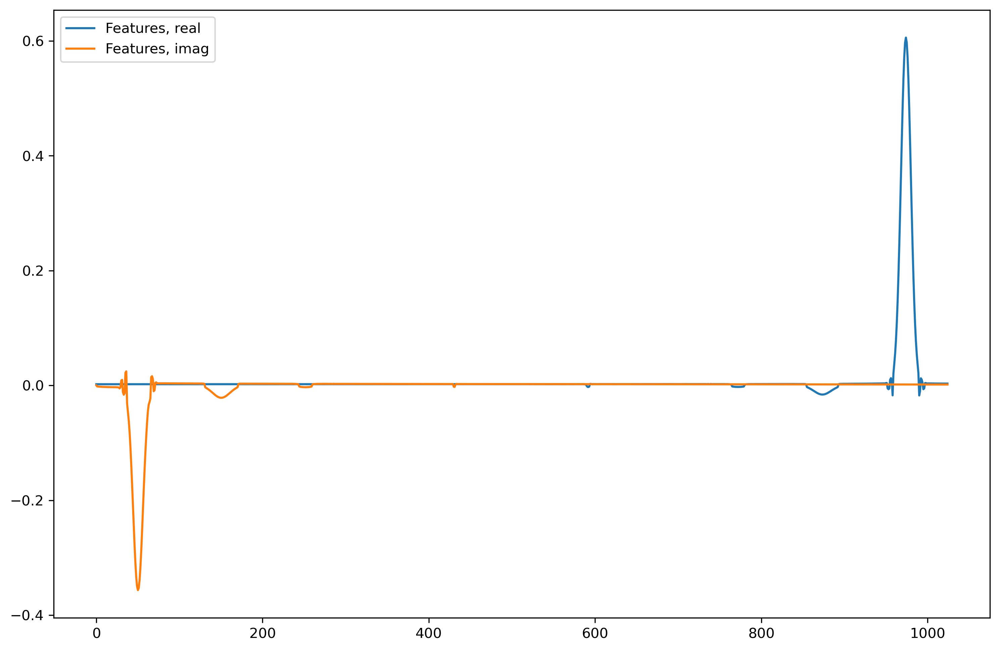

******************************************************************
Labels


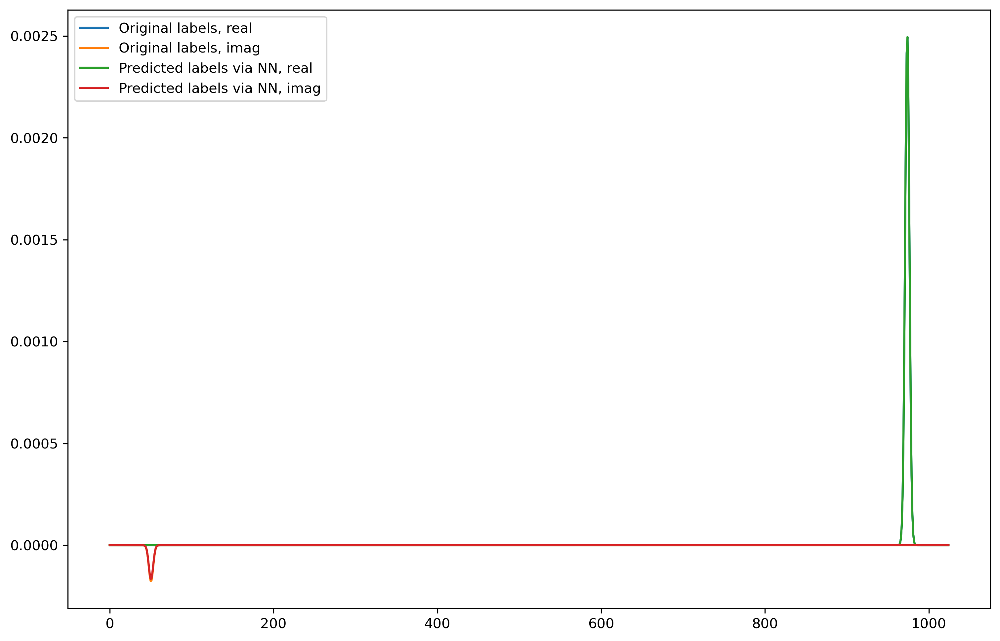

******************************************************************
Fields


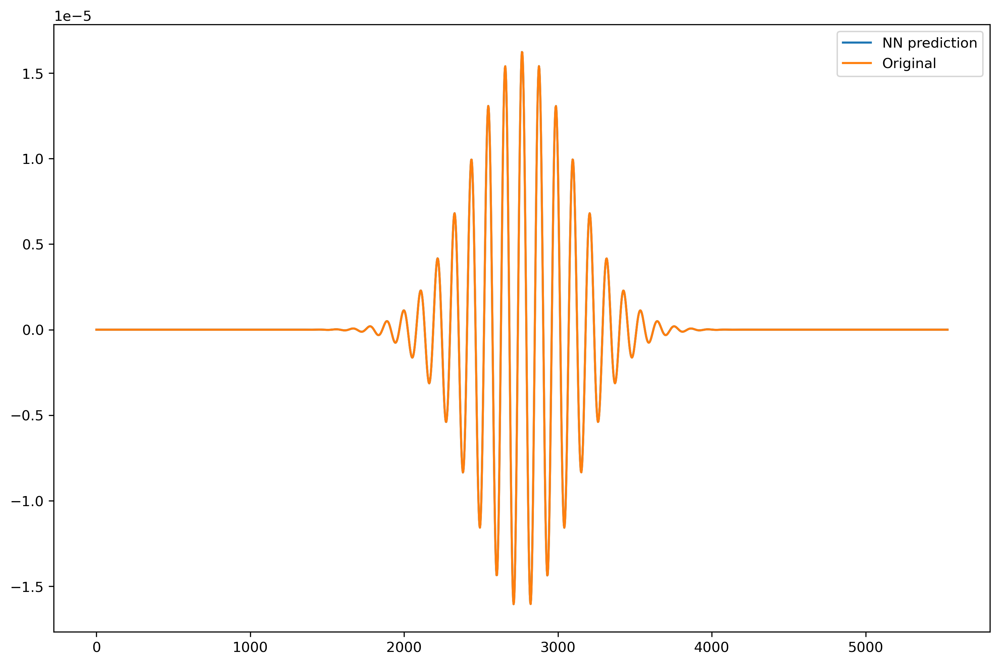

******************************************************************
Fields closeup


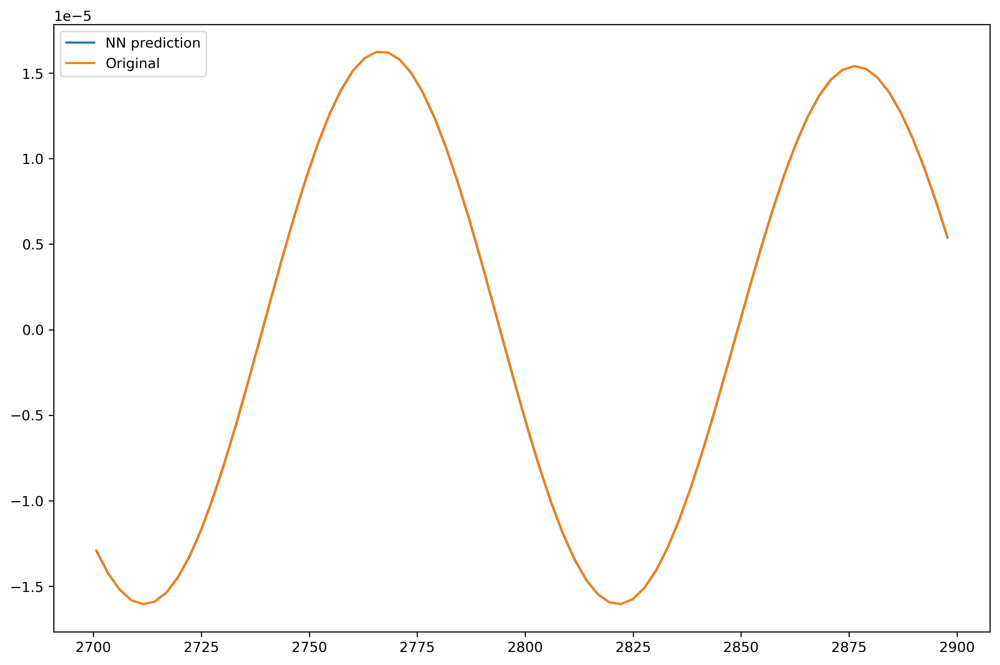

******************************************************************
Spectra


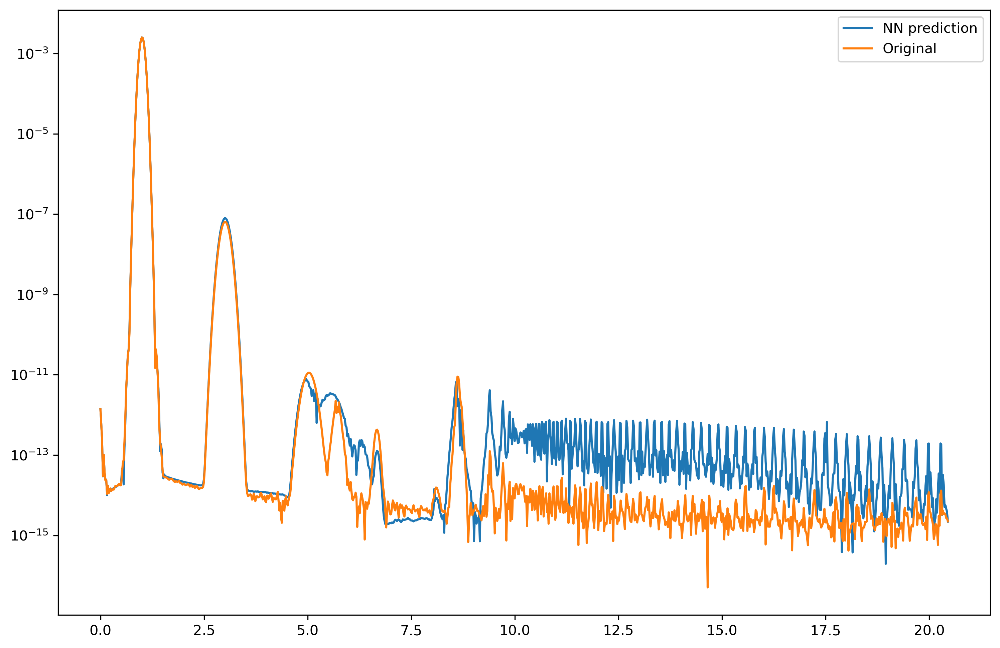

******************************************************************
Phases


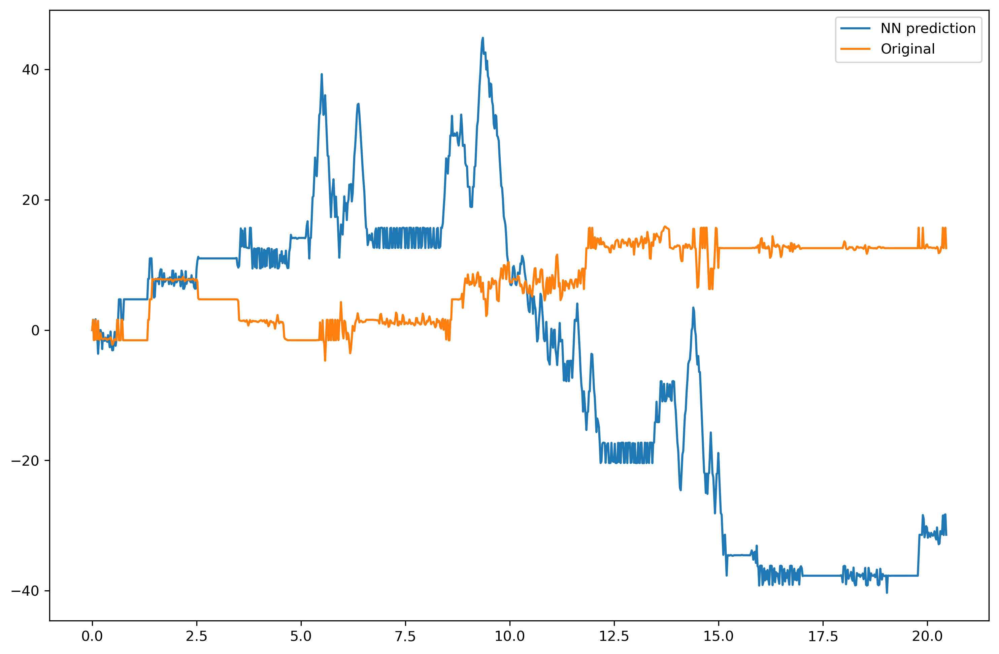

******************************************************************
Statistics


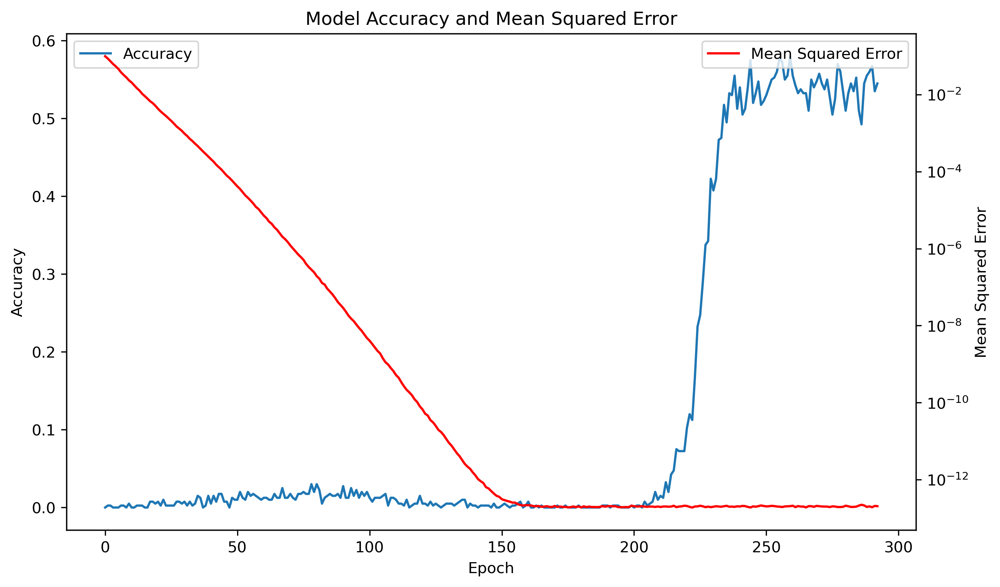

In [107]:
%matplotlib inline
i = 1
#features_real = (np.expand_dims(x_test_f[i],0))
features = (np.expand_dims(x_test_f[i],0))
#features_imag = (np.expand_dims(x_test_f[i],0))
#real_ = model_real2.predict(features_real)[0]
#imag_ = model_imag2.predict(features_imag)[0]
real_ = model_real2.predict(features)[0]
imag_ = model_imag2.predict(features)[0]

#y_NN = fft_real_imag_reconstruction(real_, imag_, t_f, n = 1)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, 0], y_test_f[i, 1], t_f, n = 1)

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN = reconstruct(real_, imag_, t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig = reconstruct(y_test_f[i, 0], y_test_f[i, 1], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)


N = len(y_NN)
freqs = fftfreq(N, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(features[0][:,0], label = "Features, real")
plt.plot(features[0][:,1], label = "Features, imag")
#plt.plot(features_imag[1], label = "Features imag")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test_f[i,0], label = "Original labels, real", linestyle = "-")
plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = "-")
plt.plot(real_, label = "Predicted labels via NN, real")
plt.plot(imag_, label = "Predicted labels via NN, imag", linestyle = "-")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_NN, label = "NN prediction")
plt.plot(t_f, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(y_test_f[i, 0] + 1j*y_test_f[i, 1]))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history_imag2.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history_imag2.history['accuracy'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history_imag2.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# NN, temporal domain

In [982]:
### Number of points for the input and output layers
N = 4097

t_f = np.linspace(t[0], t[-1], N)
f = filter2(np.ones((len(t))), t)
x_train_f = np.array([NN.spectral_filter(f*x, N) for x in x_train[:,0]])
y_train_f = np.array([NN.spectral_filter(f*(-y[1]-y[0]), N) for y in x_train])
x_test_f = np.array([NN.spectral_filter(f*x, N) for x in x_test[:,0]])
y_test_f = np.array([NN.spectral_filter(f*(-y[1]-y[0]), N) for y in x_test])

In [983]:
reload(NN)

### Create custom NN model
model_TD = NN.TDSE_NN_4((N,), N, N=64, activation=tf.nn.tanh, bias = True, dropout=0.95, dropout_input = 0.99)
model_TD.build(input_shape=(None, N))
### Print summary of the model (basic info)
model_TD.summary()



Model: "tdse_nn_4_205"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_206 (InputLayer)      [(None, 4097)]            0         
                                                                 
 dropout_2083 (Dropout)      multiple                  0         
                                                                 
 dense_2082 (Dense)          multiple                  262272    
                                                                 
 dropout_2084 (Dropout)      multiple                  0         
                                                                 
 dense_2083 (Dense)          multiple                  4160      
                                                                 
 dropout_2085 (Dropout)      multiple                  0         
                                                                 
 dense_2084 (Dense)          multiple                

In [984]:
epochs = 200
patience = 80

### Compile model
model_TD.compile(optimizer='adam',
              loss=tf.keras.losses.MeanSquaredError(),
              metrics=['accuracy'])

### Fit model
history_real2 = model_TD.fit(x_train_f, y_train_f, epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)])

### Quantify the accuracy of the model on the test data
model_TD.evaluate(x_test_f, y_test_f)



Epoch 1/200
11/11 [==============================] - 4s 10ms/step - loss: 0.3102 - accuracy: 0.0000e+00
Epoch 2/200
11/11 [==============================] - 0s 10ms/step - loss: 0.2125 - accuracy: 0.0000e+00
Epoch 3/200
11/11 [==============================] - 0s 10ms/step - loss: 0.1193 - accuracy: 0.0000e+00
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0577 - accuracy: 0.0000e+00
Epoch 5/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0251 - accuracy: 0.0000e+00
Epoch 6/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0103 - accuracy: 0.0000e+00
Epoch 7/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0046 - accuracy: 0.0000e+00
Epoch 8/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0016 - accuracy: 0.0000e+00
Epoch 9/200
11/11 [==============================] - 0s 10ms/step - loss: 6.5333e-04 - accuracy: 0.0000e+00
Epoch 10/200
11/11 [==============================] - 0s 11ms/s

[6.844084055046551e-07, 0.21311475336551666]

In [859]:
y_test_f.shape

(161, 1025)

1/1 [==============================] - 0s 204ms/step
******************************************************************
Features


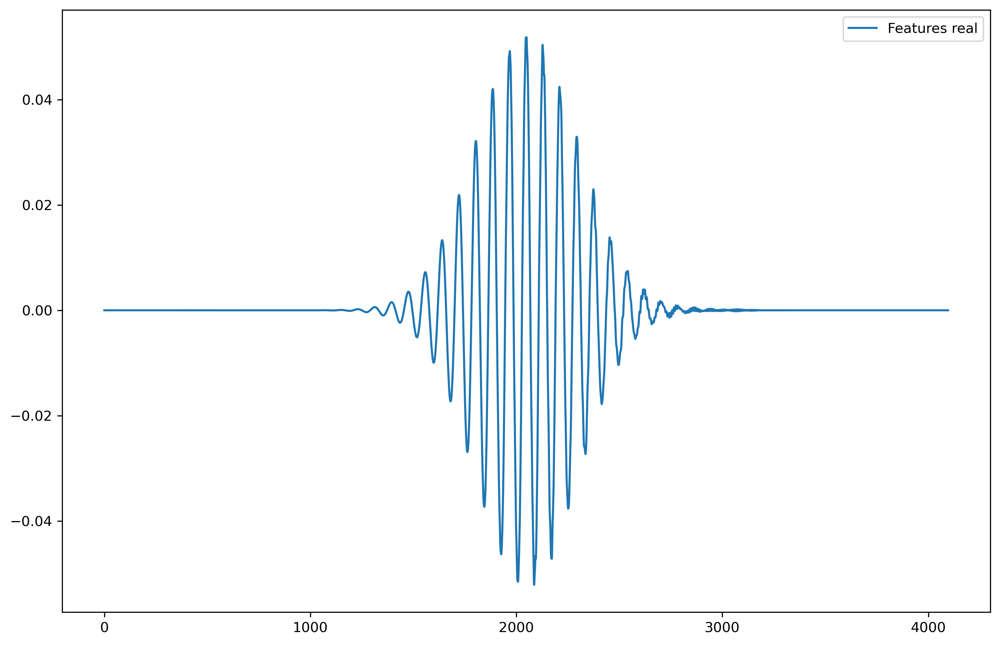

******************************************************************
Labels


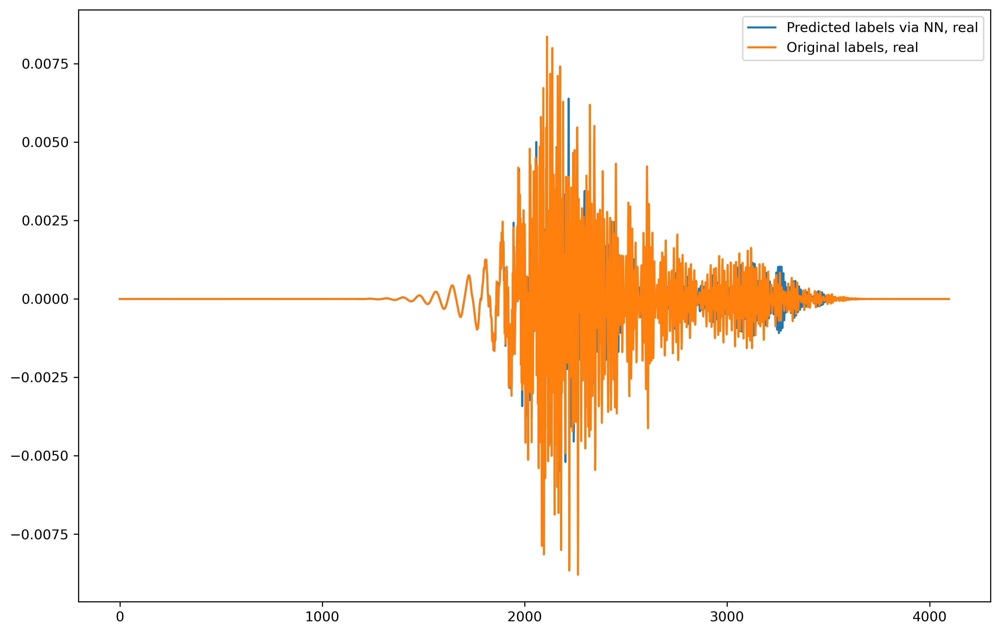

******************************************************************
Fields


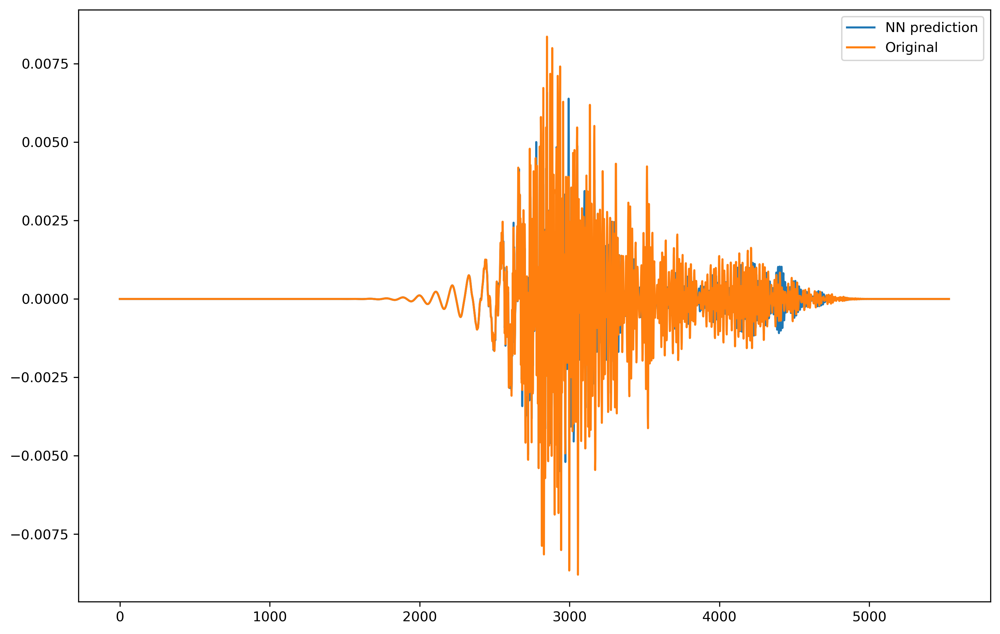

******************************************************************
Fields closeup


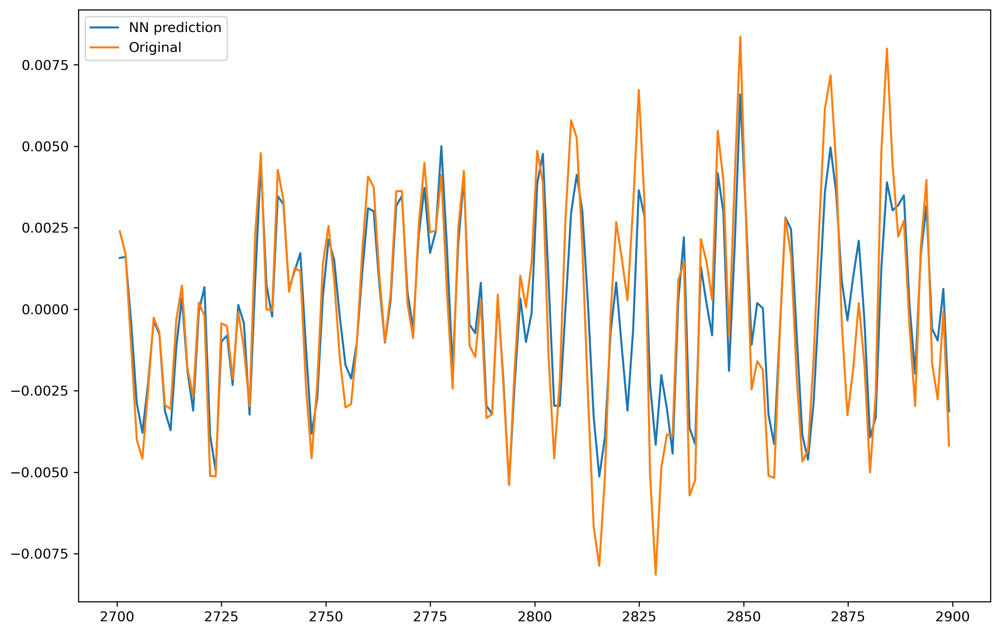

******************************************************************
Spectra


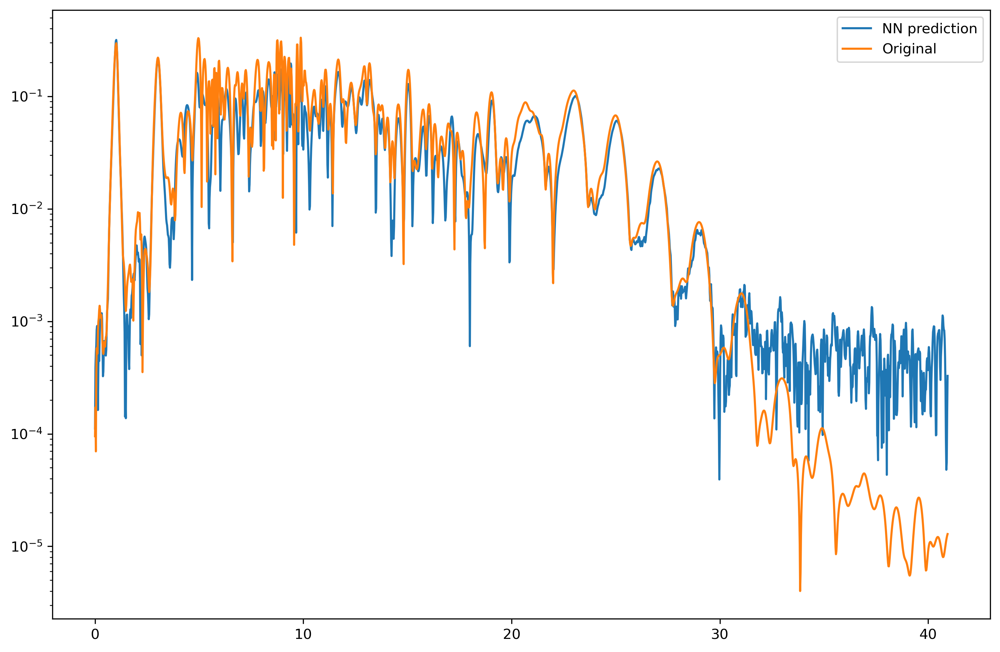

******************************************************************
Phases


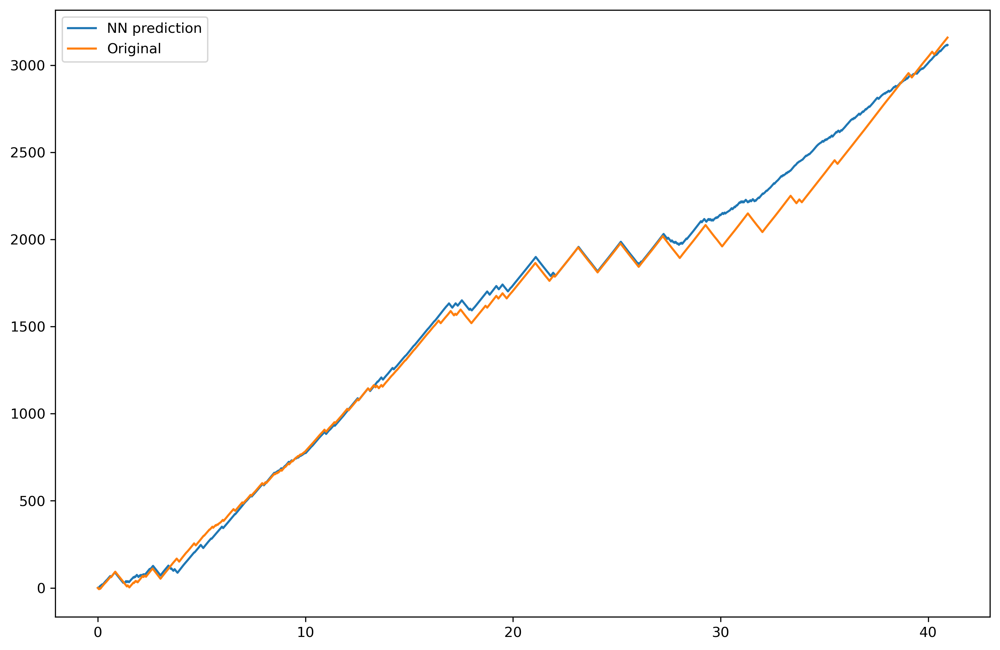

******************************************************************
Statistics


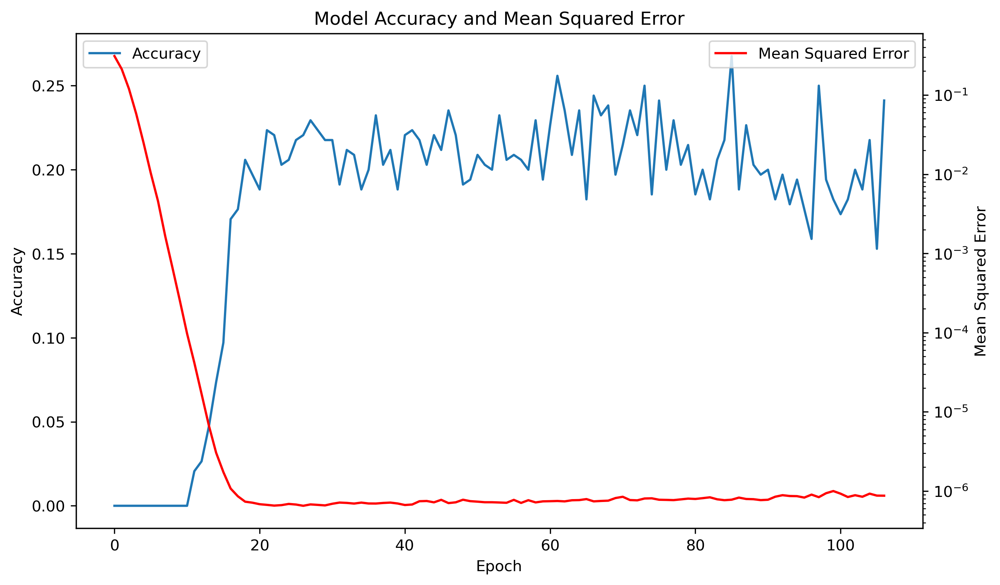

In [985]:
%matplotlib inline
i = 1
features_real = (np.expand_dims(x_test_f[i],0))
real_ = model_TD.predict(features_real)[0]


y_NN = real_[:]
y_orig = y_test_f[i]


N = len(y_NN)
freqs = fftfreq(N, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(x_test_f[i], label = "Features real")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_NN, label = "Predicted labels via NN, real")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(y_test_f[i], label = "Original labels, real", linestyle = "-")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_NN, label = "NN prediction")
plt.plot(t_f, y_orig, label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
plt.semilogy(freqs[0:N//2], np.abs(fft(y_NN))[0:N//2], label = "NN prediction")
plt.semilogy(freqs[0:N//2], np.abs(fft(y_orig))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history_real2.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history_real2.history['accuracy'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history_real2.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

In [1080]:
%matplotlib qt

fig, ax = plt.subplots()
x = np.linspace(-3, 3, 100)
ax.plot(x, tf.keras.activations.tanh(x))
plt.grid(True, color='gray', linewidth=0.5, axis='y', linestyle='--')
plt.grid(True, color='gray', linewidth=0.5, axis='x', linestyle='--')
ax.set_xticks([0], minor=False)
ax.set_yticks([-1, 0, 1], minor=False)
plt.show()

2023-04-14 13:09:09.411 python[31963:273422] WARNING: <NSSavePanel: 0x7fbf3e58fdc0> found it necessary to prepare implicitly; please prepare panels using NSSavePanel rather than NSApplication or NSWindow.
2023-04-14 13:09:10.412 python[31963:273422] WARNING: <NSSavePanel: 0x7fbf3e58fdc0> found it necessary to start implicitly; please start panels using NSSavePanel rather than NSApplication or NSWindow.
2023-04-14 13:09:10.412 python[31963:273422] WARNING: <NSSavePanel: 0x7fbf3e58fdc0> running implicitly; please run panels using NSSavePanel rather than NSApplication.


In [38]:
fig, axes = plt.subplots(2, 2)

t_grid = np.linspace(t[0], t[-1], 1024)

# Loop through the images and axes and plot them
axes.flat[0].set_title("1) Original field")
axes.flat[0].set_xlabel("Bins")
#axes.flat[0].set_yticks([0])
#axes.flat[1].set_yticks([0])
#axes.flat[2].set_yticks([0])
#axes.flat[3].set_yticks([0])
axes.flat[0].set_yticks([])
axes.flat[1].set_yticks([])
axes.flat[2].set_yticks([])
axes.flat[3].set_yticks([])
#axes.flat[0].set_ylabel("Field [arb.u.]")
axes.flat[0].plot(x_train[0, 0])
axes.flat[1].set_title("2) Temporal filter")
axes.flat[1].set_xlabel("Bins")
#axes.flat[1].set_ylabel("Field [arb.u.]")
axes.flat[1].plot(x_train[0, 0])
axes.flat[1].plot(f*x_train[0, 0].max())
axes.flat[2].set_title("3) Spectral filter – downsample")
axes.flat[2].set_xlabel("Bins")
#axes.flat[2].set_ylabel("Field [arb.u.]")
axes.flat[2].plot(NN.spectral_filter(f*x_train[0, 0], 1024))
axes.flat[3].set_title("4) Real & imaginary spectrum")
axes.flat[3].set_xlabel("Bins")
#axes.flat[3].set_ylabel("Field [arb.u.]")
axes.flat[3].plot(fft_real_imag_separation(NN.spectral_filter(f*x_train[0, 0], 1024), t_grid)[0], label = "Real")
axes.flat[3].plot(fft_real_imag_separation(NN.spectral_filter(f*x_train[0, 0], 1024), t_grid)[1], label = "Imaginary")
axes.flat[3].legend()

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

# Simple examples for NN training – amplitude, frequency and time shift variations

In [815]:
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/tshift_scan/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000_x/")

In [849]:

N = 201
M = 1025
n = 5
m = 5
f = tools.filter(np.ones((len(t))), t)

xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for x in dataset[:,0]])
yf = np.array([np.concatenate(preprocess(f*(-y[1]-1*y[0]), M, t, n = m), axis = None) for y in dataset])


In [850]:
print(xf.shape)
print(yf.shape)

(501, 101, 2)
(501, 1026)


[288, 251, 133, 237, 98, 72, 203, 494, 298, 78, 107, 314, 102, 270, 440, 172, 392, 412, 6, 99, 211, 479, 138, 18, 488, 214, 388, 101, 290, 338, 407, 208, 240, 141, 447, 246, 372, 36, 188, 77, 15, 17, 347, 426, 100, 457, 273, 84, 449, 165, 116, 436, 75, 98, 493, 471, 429, 403, 297, 389, 85, 169, 413, 370, 261, 6, 429, 479, 413, 305, 176, 492, 57, 64, 99, 206, 10, 299, 250, 324, 373, 214, 114, 150, 369, 382, 497, 109, 86, 93, 61, 218, 458, 40, 449, 485, 304, 312, 471, 38, 190, 331, 199, 213, 456, 37, 270, 64, 241, 437, 245, 283, 439, 33, 239, 64, 196, 44, 489, 239, 291, 431, 302, 243, 42, 223, 238, 359, 20, 398, 214, 448, 266, 184, 245, 391, 354, 350, 152, 90, 331, 124, 282, 53, 92, 106, 396, 375, 315, 255, 69, 465, 9, 149, 38, 273, 257, 438, 377, 423, 194, 251, 234, 299, 214, 224, 250, 8, 271, 87, 247, 413, 93, 269, 285, 49, 423, 370, 273, 22, 457, 18, 190, 77, 442, 496, 147, 134, 307, 122, 326, 329, 281, 299, 303, 411, 270, 398, 356, 377, 242, 15, 410, 76, 3, 427, 162, 180, 486, 18, 49

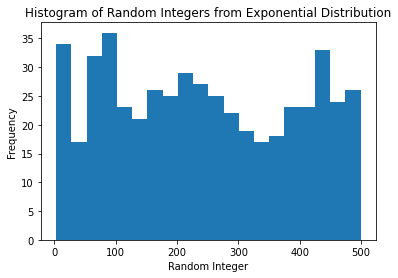

In [851]:
samples = generate_random_integers(500, lambda_=0.01, max_index=500)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [852]:
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(500, 101, 2)
(500, 1026)


In [853]:
x_train_f, x_test_f = x_f[:400], x_f[400:]
y_train_f, y_test_f = y_f[:400], y_f[400:]

In [854]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(400, 101, 2)
(400, 1026)
(100, 101, 2)
(100, 1026)


In [855]:
reload(NN)

### Create custom NN model
model = NN.TDSE_NN_4((N//2+1, 2,), 2*(M//2+1), N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input=0.8)
#model = NN.TDSE_NN_5((N//2+1, 2,), 2*(M//2+1), N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input=0.8)
#model = NN.TDSE_NN_4((N, 2,), 2*(M), N=64, activation=tf.nn.tanh, bias = True, dropout=0.6, dropout_input=0.9)
model.build(input_shape=(None, N//2+1, 2))
#model.build(input_shape=(None, N, 2))
### Print summary of the model (basic info)
model.summary()

Model: "tdse_nn_4_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_149 (InputLayer)      [(None, 101, 2)]          0         
                                                                 
 dropout_1164 (Dropout)      multiple                  0         
                                                                 
 dense_1222 (Dense)          multiple                  12992     
                                                                 
 dropout_1165 (Dropout)      multiple                  0         
                                                                 
 dense_1223 (Dense)          multiple                  4160      
                                                                 
 dropout_1166 (Dropout)      multiple                  0         
                                                                 
 dense_1224 (Dense)          multiple                

In [856]:
epochs = 2000
#patience = 600
patience = 200
batch_size = 128

### Compile model
model.compile(#optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              optimizer=tf.keras.optimizers.Adam(),
              loss=tf.keras.losses.MeanSquaredError(),
              #loss=TimeSpectrumMSE(),
              metrics=['mean_absolute_percentage_error'])
              #metrics=[time_spectrum_MSE])

### Fit model
history = model.fit(x_train_f, y_train_f, epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=batch_size)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test_f, y_test_f)

Epoch 1/2000
4/4 [==============================] - 3s 7ms/step - loss: 0.0813 - mean_absolute_percentage_error: 16690.9043
Epoch 2/2000
4/4 [==============================] - 0s 11ms/step - loss: 0.0732 - mean_absolute_percentage_error: 15778.0859
Epoch 3/2000
4/4 [==============================] - 0s 12ms/step - loss: 0.0620 - mean_absolute_percentage_error: 14411.9785
Epoch 4/2000
4/4 [==============================] - 0s 12ms/step - loss: 0.0556 - mean_absolute_percentage_error: 13608.9678
Epoch 5/2000
4/4 [==============================] - 0s 12ms/step - loss: 0.0477 - mean_absolute_percentage_error: 12546.4180
Epoch 6/2000
4/4 [==============================] - 0s 10ms/step - loss: 0.0400 - mean_absolute_percentage_error: 11420.3975
Epoch 7/2000
4/4 [==============================] - 0s 10ms/step - loss: 0.0347 - mean_absolute_percentage_error: 10570.9199
Epoch 8/2000
4/4 [==============================] - 0s 10ms/step - loss: 0.0319 - mean_absolute_percentage_error: 10141.9971
E

[9.571383998263627e-05, 175.8077392578125]

1/1 [==============================] - 0s 28ms/step
******************************************************************
Features


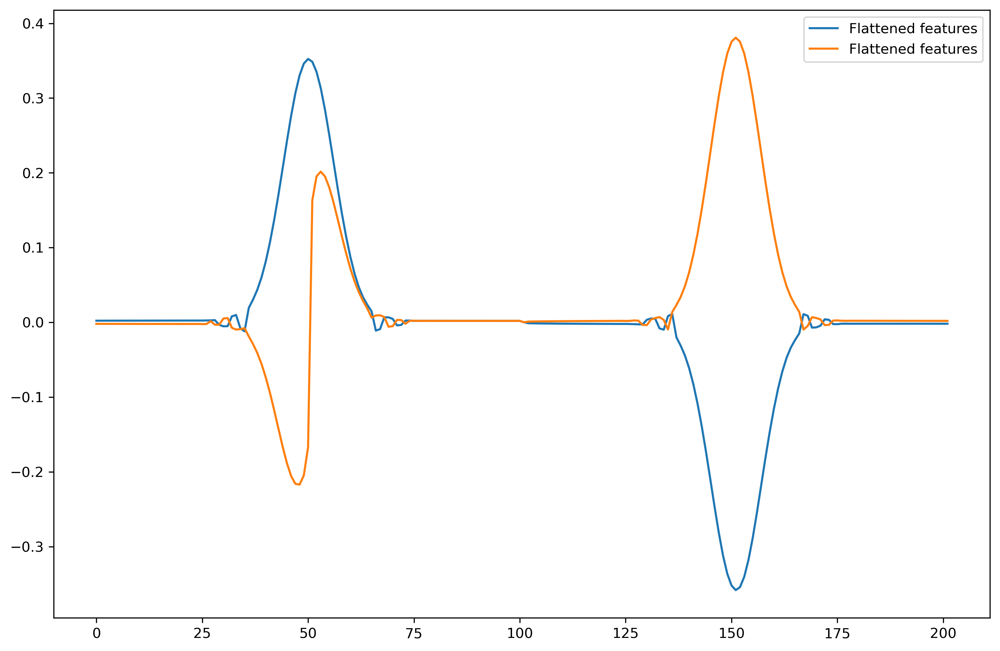

******************************************************************
Labels


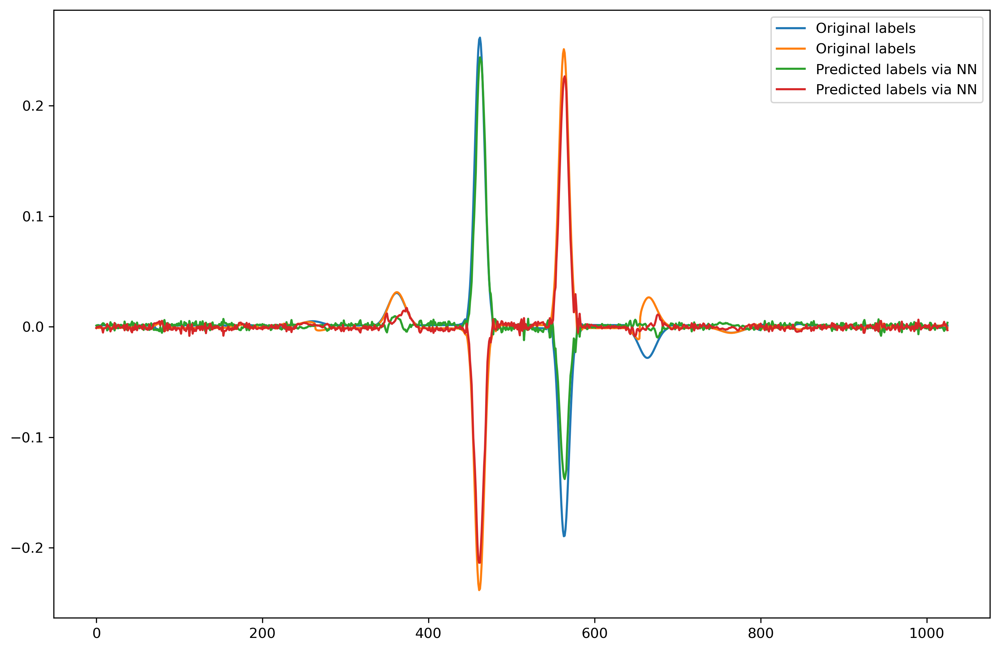

******************************************************************
Fields


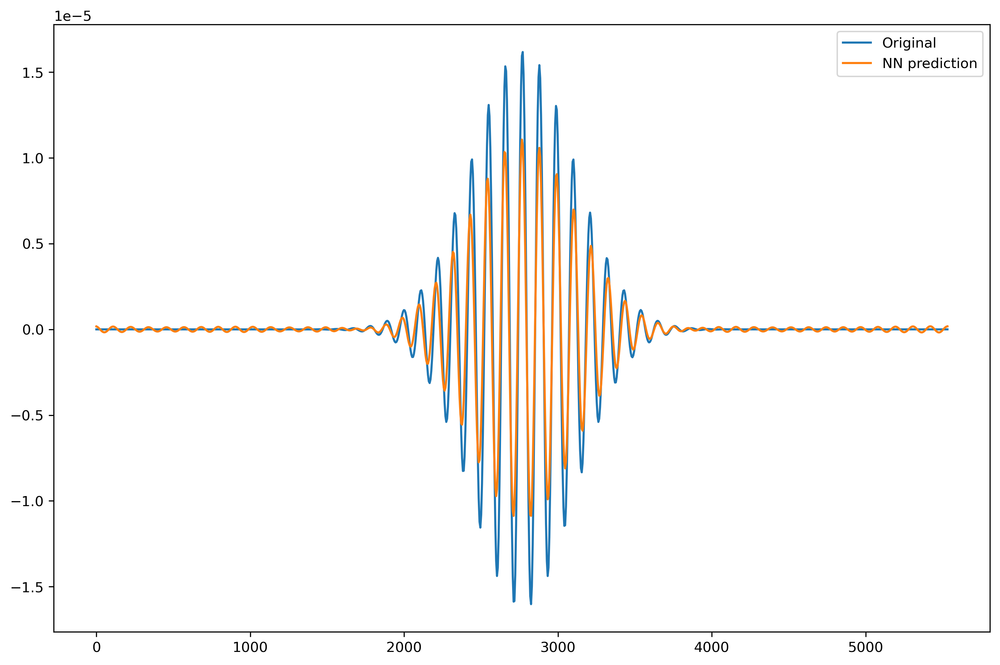

******************************************************************
Fields closeup


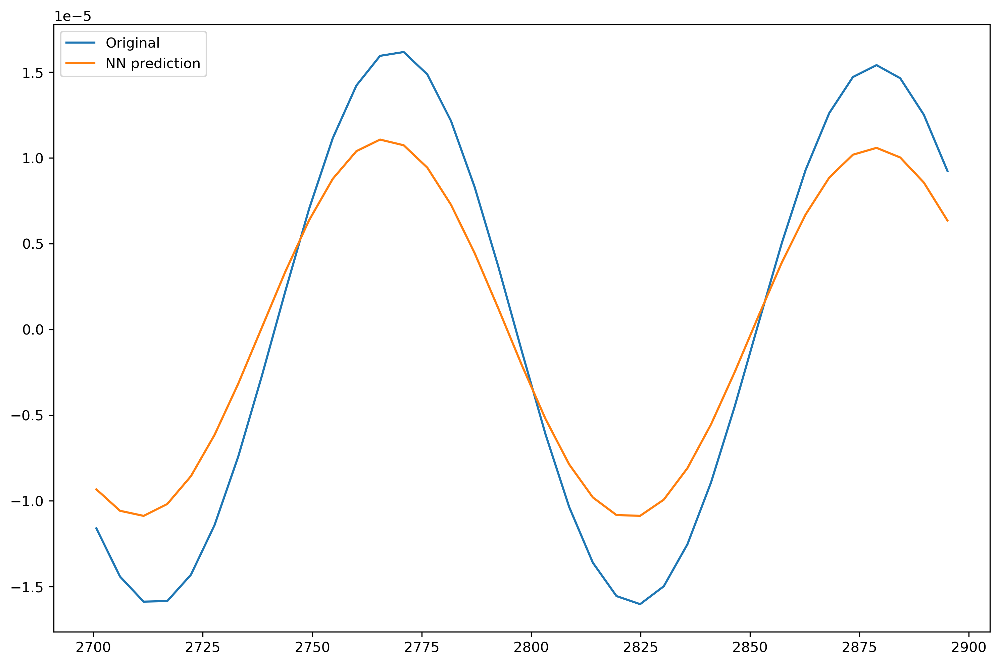

******************************************************************
Spectra


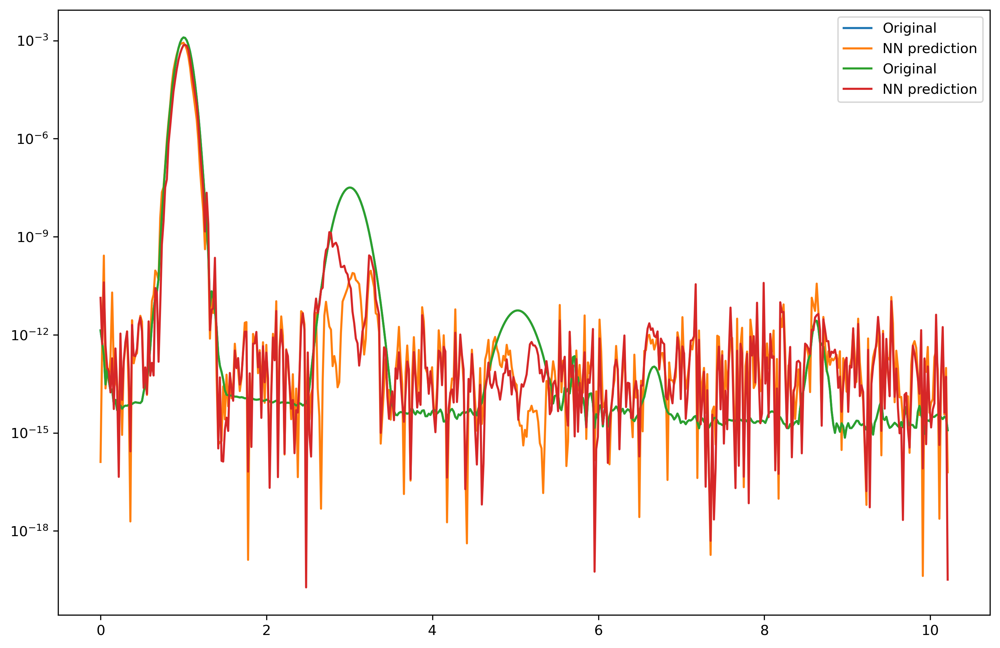

******************************************************************
Phases


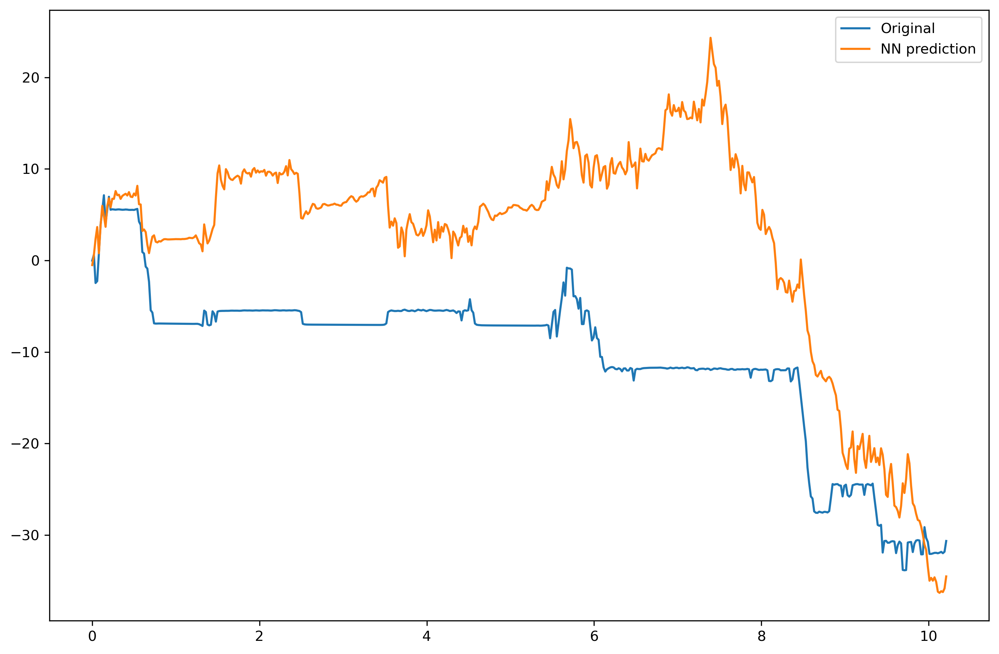

******************************************************************
Statistics


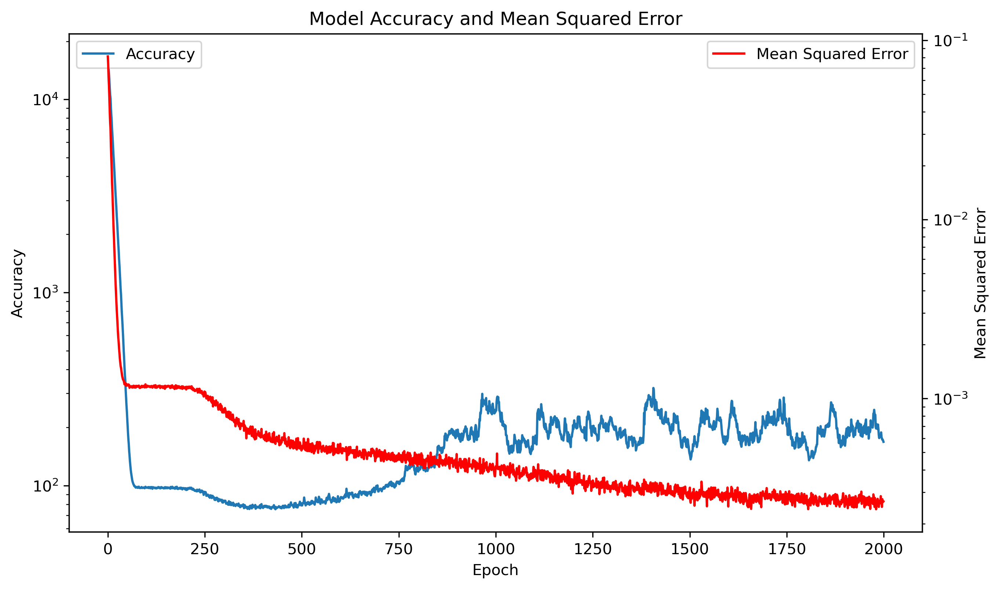

In [857]:
i = 1
j = 15
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features1 = (np.expand_dims(x_test_f[i],0))
labels1 = model.predict(features1)[0]

real_ = labels1[:M//2+1]
imag_ = labels1[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN1 = reconstruct(labels1[:M//2+1], labels1[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig1 = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
features2 = (np.expand_dims(x_test_f[j],0))
labels2 = model.predict(features2)[0]

real_ = labels2[:M//2+1]
imag_ = labels2[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN2 = reconstruct(labels2[:M//2+1], labels2[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig2 = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features1[0]).flatten(), label = "Flattened features")
plt.plot(np.transpose(features2[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(y_test_f[j], label = "Original labels", linestyle = "-")
plt.plot(labels1, label = "Predicted labels via NN")
plt.plot(labels2, label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig1, label = "Original")
plt.plot(t_f, y_NN1, label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig1[range_], label = "Original")
plt.plot(t_f[range_], y_NN1[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig1))[0:M//2]), label = "Original")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN1))[0:M//2]), label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig2))[0:M//2]), label = "Original")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN2))[0:M//2]), label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[i, :M] + 1j*y_test_f[i, M:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.semilogy(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# Adversarial NN – generator-discriminator

In [706]:
x_test_f.shape
y_test_f.shape

(100, 1026)

In [ ]:
# Import libraries
from tensorflow import keras
#from tf.keras import layers

# Define the input shape
input_shape = (N//2+1,2)

# Define the generator network
generator = keras.Sequential(
    [
        tf.keras.layers.Flatten(data_format = "channels_first", input_shape=input_shape),
        tf.keras.layers.Dense(256, activation="relu"),
        tf.keras.layers.Dense(512, activation="relu"),
        tf.keras.layers.Dense(1000, activation="tanh"),
    ],
    name="generator",
)

# Define the discriminator network
discriminator = keras.Sequential(
    [
        tf.keras.layers.Dense(512, activation="relu", input_shape=(M,)),
        tf.keras.layers.Dense(256, activation="relu"),
        tf.keras.layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)

# Define the GAN model
gan = keras.Sequential([generator, discriminator])

# Compile the discriminator
discriminator.compile(optimizer="adam", loss="binary_crossentropy")

# Freeze the discriminator when training the GAN
discriminator.trainable = False

# Compile the GAN
gan.compile(optimizer="adam", loss=tf.keras.losses.MeanSquaredError())

# Train the GAN on some dummy data
x_train = x_train_f
epochs = 100
batch_size = 32
for epoch in range(epochs):
    # Sample random inputs for the generator
    noise = np.random.rand(batch_size, N, 2)
    # Generate fake outputs from the generator
    fake_x = generator.predict(noise)
    # Sample real outputs from the data
    real_x = x_train[np.random.randint(0, x_train.shape[0], x_train.shape[1], size=batch_size)]
    # Concatenate fake and real outputs
    x = np.concatenate([fake_x, real_x])
    # Create labels for fake and real outputs
    y = np.concatenate([np.zeros((batch_size, 1)), np.ones((batch_size, 1))])
    # Train the discriminator on fake and real outputs
    discriminator_loss = discriminator.train_on_batch(x, y)
    # Sample random inputs for the generator
    noise = np.random.rand(batch_size, 500)
    # Create labels for fake outputs (pretending they are real)
    y = np.ones((batch_size, 1))
    # Train the GAN on fake outputs (trying to fool the discriminator)
    gan_loss = gan.train_on_batch(noise, y)
    # Print the losses
    print(f"Epoch {epoch}, Discriminator Loss: {discriminator_loss}, GAN Loss: {gan_loss}")

# Generate some outputs from the GAN
noise = np.random.rand(10, 500) # Generate 10 random arrays of length 500
y_pred = generator.predict(noise) # Predict the corresponding arrays of length 1000


# Transformer model

In [776]:
N = 201
M = 1025
n = 5
m = 1
f = tools.filter(np.ones((len(t))), t)

xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for x in dataset[:,0]])
yf = np.array([np.concatenate(preprocess(f*(-y[1]-1*y[0]), M, t, n = m), axis = None) for y in dataset])


[233, 188, 248, 494, 183, 145, 362, 299, 345, 473, 467, 112, 255, 178, 419, 335, 196, 476, 443, 78, 210, 127, 469, 188, 264, 323, 414, 265, 61, 66, 387, 435, 32, 209, 409, 317, 2, 336, 466, 55, 75, 35, 375, 86, 482, 258, 495, 439, 178, 455, 286, 227, 120, 384, 436, 108, 454, 340, 333, 197, 21, 135, 91, 6, 169, 98, 481, 336, 283, 464, 386, 452, 343, 379, 48, 65, 34, 466, 348, 188, 110, 486, 269, 158, 452, 434, 427, 178, 4, 50, 393, 248, 309, 162, 393, 232, 73, 302, 228, 498, 264, 388, 494, 184, 316, 155, 137, 286, 26, 459, 479, 4, 87, 189, 433, 80, 450, 351, 276, 439, 402, 56, 491, 268, 124, 122, 405, 203, 456, 145, 12, 237, 459, 261, 365, 186, 413, 42, 101, 430, 400, 464, 256, 158, 183, 453, 287, 345, 229, 165, 455, 25, 294, 363, 455, 396, 68, 29, 85, 443, 278, 194, 472, 472, 198, 136, 264, 249, 327, 102, 169, 82, 41, 302, 139, 291, 368, 266, 448, 187, 353, 451, 242, 53, 114, 466, 206, 168, 235, 300, 29, 80, 205, 216, 177, 363, 74, 128, 111, 197, 307, 338, 193, 356, 264, 33, 480, 108, 

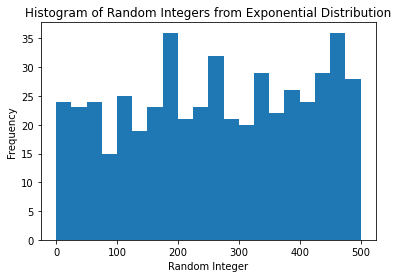

In [777]:
samples = generate_random_integers(500, lambda_=0.01, max_index=500)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [778]:
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(500, 101, 2)
(500, 1026)


In [779]:
x_train_f, x_test_f = x_f[:400], x_f[400:]
y_train_f, y_test_f = y_f[:400], y_f[400:]

In [780]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(400, 101, 2)
(400, 1026)
(100, 101, 2)
(100, 1026)


### Effect of Encoder decoder

(1, 101, 2)


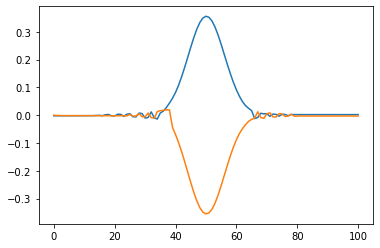

(1, 202)


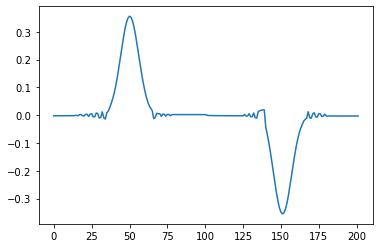

(1, 202, 64)


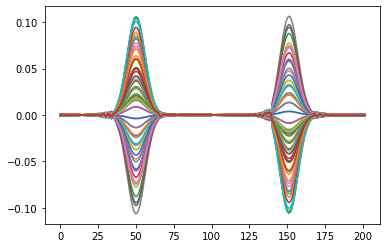

(1, 67, 64)


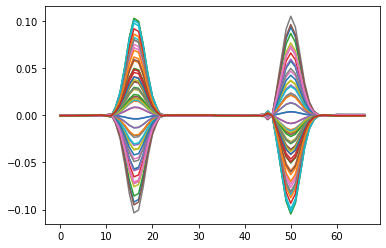

(1, 67, 64)
(1, 67, 64)


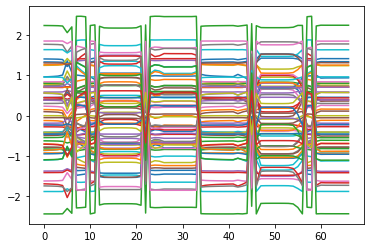

(1, 67, 64)


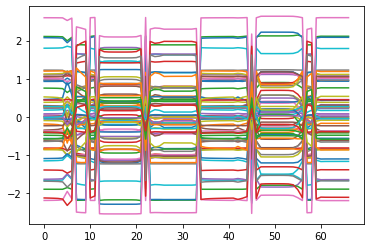

(1, 67, 64)


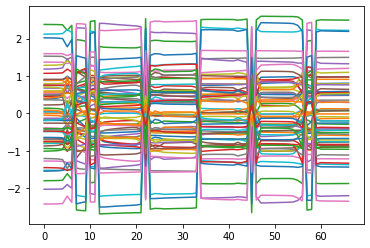

(1, 4288)


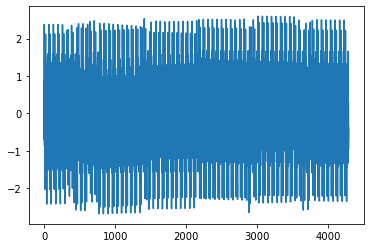

(1, 1026)


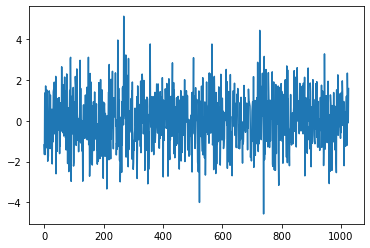

In [68]:
import tensorflow as tf
from tensorflow import keras
from keras_nlp import layers

# Define the hyperparameters
#N = 201 # Input array size
#M = 1025 # Output array size
d_model = 64 # Embedding dimension
nhead = 16 # Number of attention heads
num_encoder_layers = 4 # Number of encoder layers
num_decoder_layers = 4 # Number of decoder layers
dim_feedforward = 16 # Feedforward dimension
dropout = .3

x = x_train_f[0]
x = np.expand_dims(x, axis = 0)
print(x.shape)
plt.plot(x[0])
plt.show()
#x = np.expand_dims(x, axis = 0)
x = tf.keras.layers.Flatten(data_format = "channels_first")(x)
# Input dense layer with linear activation
print(x.shape)
plt.plot(x[0])
plt.show()
#x = np.expand_dims(x, axis = -1)
x = tf.keras.layers.Reshape((2*(N//2+1),1))(x)
x = tf.keras.layers.Dense(d_model, activation="linear")(x)
print(x.shape)
plt.plot(x[0])
plt.show()

x = tf.keras.layers.AvgPool1D(3)(x)
print(x.shape)

plt.plot(x[0])
plt.show()

#x = tf.keras.layers.Reshape((1,d_model))(x)
print(x.shape)

# Transformer encoder layer
#layers.PositionEmbedding(d_model),
x = layers.TransformerEncoder(
    dim_feedforward,
    num_heads=nhead,
    dropout=dropout, 
    activation="tanh"
)(x)
print(x.shape)

plt.plot(x[0])
plt.show()


# Repeat the encoder layer num_encoder_layers times
x = layers.TransformerEncoder(
    dim_feedforward,
    num_heads=nhead,
    dropout=dropout,
    activation="tanh"
)(x)
print(x.shape)
plt.plot(x[0])
plt.show()
# Transformer decoder layer
x = layers.TransformerDecoder(
    dim_feedforward,
    num_heads=nhead,
    dropout=dropout,
    activation="tanh"
)(x)

print(x.shape)
plt.plot(x[0])
plt.show()

x = tf.keras.layers.Flatten(data_format = "channels_last")(x)
print(x.shape)
plt.plot(x[0])
plt.show()


x = tf.keras.layers.Dense(1026, activation="linear")(x)
print(x.shape)
plt.plot(x[0])
plt.show()




In [70]:
import tensorflow as tf
from tensorflow import keras
from keras_nlp import layers

# Define the hyperparameters
N = 201 # Input array size
M = 1025 # Output array size
d_model = 64 # Embedding dimension
nhead = 16 # Number of attention heads
num_encoder_layers = 4 # Number of encoder layers
num_decoder_layers = 4 # Number of decoder layers
dim_feedforward = 64 # Feedforward dimension
dropout = 0.3 # Dropout rate
batch_size = 32 # Batch size
#learning_rate = 0.001 # Learning rate

# Create a random labelled dataset of input-output pairs
#X = tf.random.uniform((batch_size, N)) # Input arrays
#Y = tf.random.uniform((batch_size, M)) # Output arrays
X = x_train_f
Y = y_train_f

# Define the transformer network
transformer = keras.models.Sequential([
    # Input layer
    tf.keras.layers.Input(shape=(N//2+1,2,)),
    tf.keras.layers.Flatten(data_format = "channels_first"),
    # Input dense layer with linear activation
    tf.keras.layers.Reshape((2*(N//2+1),1)), 
    tf.keras.layers.Dense(d_model, activation="tanh"),
    #tf.keras.layers.Reshape((1,d_model)), 
    tf.keras.layers.AvgPool1D(3),
    # Transformer encoder layer
    #layers.PositionEmbedding(d_model),
    layers.TransformerEncoder(
        dim_feedforward,
        num_heads=nhead,
        dropout=dropout, 
        activation="tanh"
    ),
    # Repeat the encoder layer num_encoder_layers times
    layers.TransformerEncoder(
        dim_feedforward,
        num_heads=nhead,
        dropout=dropout,
        activation="tanh"
    ),
    # Transformer decoder layer
    layers.TransformerDecoder(
        dim_feedforward,
        num_heads=nhead,
        dropout=dropout,
        activation="tanh"
    ),
    # Repeat the decoder layer num_decoder_layers times
    layers.TransformerDecoder(
        dim_feedforward,
        num_heads=nhead,
        dropout=dropout,
        activation="tanh"
    ),
    tf.keras.layers.Flatten(data_format="channels_last"),
    # Output dense layer with linear activation
    tf.keras.layers.Dense(M+1, activation="linear")
])


transformer.build(input_shape=(None, N//2+1, 2))

transformer.summary()

# Compile the transformer network with the MSE loss function and the optimizer
transformer.compile(
    loss=keras.losses.MeanSquaredError(),
    optimizer=keras.optimizers.Adam(),
    metrics=['mean_absolute_percentage_error']
)



Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_46 (Flatten)        (None, 202)               0         
                                                                 
 reshape_20 (Reshape)        (None, 202, 1)            0         
                                                                 
 dense_176 (Dense)           (None, 202, 64)           128       
                                                                 
 average_pooling1d_25 (Avera  (None, 67, 64)           0         
 gePooling1D)                                                    
                                                                 
 transformer_encoder_69 (Tra  (None, 67, 64)           25216     
 nsformerEncoder)                                                
                                                                 
 transformer_encoder_70 (Tra  (None, 67, 64)          

In [71]:
num_epochs = 500 # Number of epochs

# Train the transformer network on the labelled dataset
history = transformer.fit(X, Y, epochs=num_epochs)

Epoch 1/500
13/13 [==============================] - 17s 360ms/step - loss: 0.9507 - mean_absolute_percentage_error: 738800576.0000
Epoch 2/500
13/13 [==============================] - 5s 352ms/step - loss: 0.3490 - mean_absolute_percentage_error: 452942720.0000
Epoch 3/500
13/13 [==============================] - 5s 356ms/step - loss: 0.2236 - mean_absolute_percentage_error: 362251392.0000
Epoch 4/500
13/13 [==============================] - 5s 356ms/step - loss: 0.1662 - mean_absolute_percentage_error: 312147200.0000
Epoch 5/500
13/13 [==============================] - 5s 365ms/step - loss: 0.1331 - mean_absolute_percentage_error: 279094208.0000
Epoch 6/500
13/13 [==============================] - 5s 354ms/step - loss: 0.1108 - mean_absolute_percentage_error: 254826080.0000
Epoch 7/500
13/13 [==============================] - 5s 349ms/step - loss: 0.0931 - mean_absolute_percentage_error: 233539632.0000
Epoch 8/500
13/13 [==============================] - 5s 353ms/step - loss: 0.0779 

KeyboardInterrupt: 

1/1 [==============================] - 0s 79ms/step
******************************************************************
Features


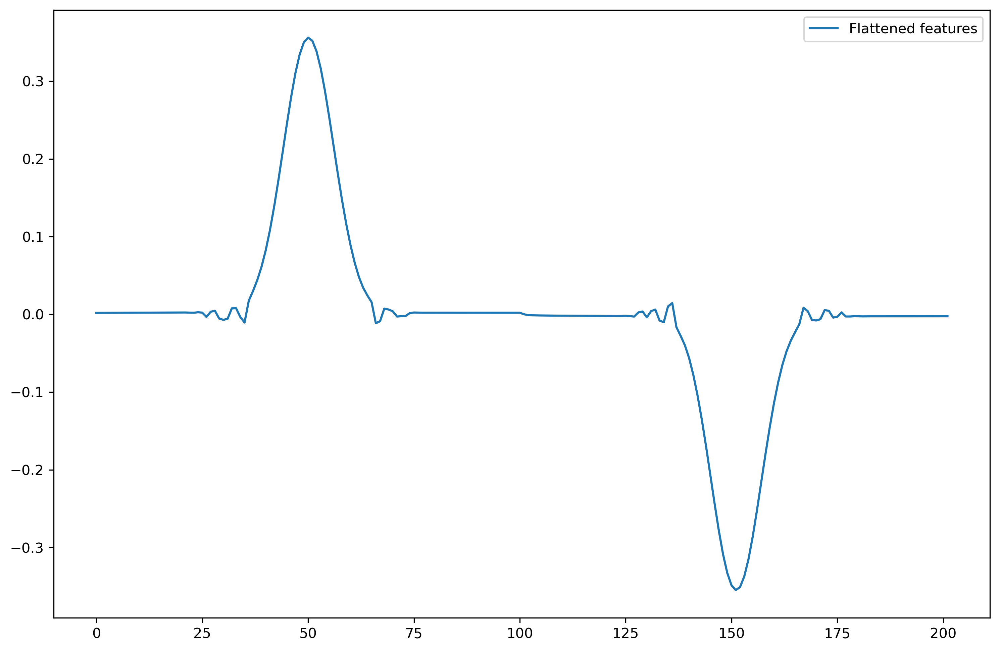

******************************************************************
Labels


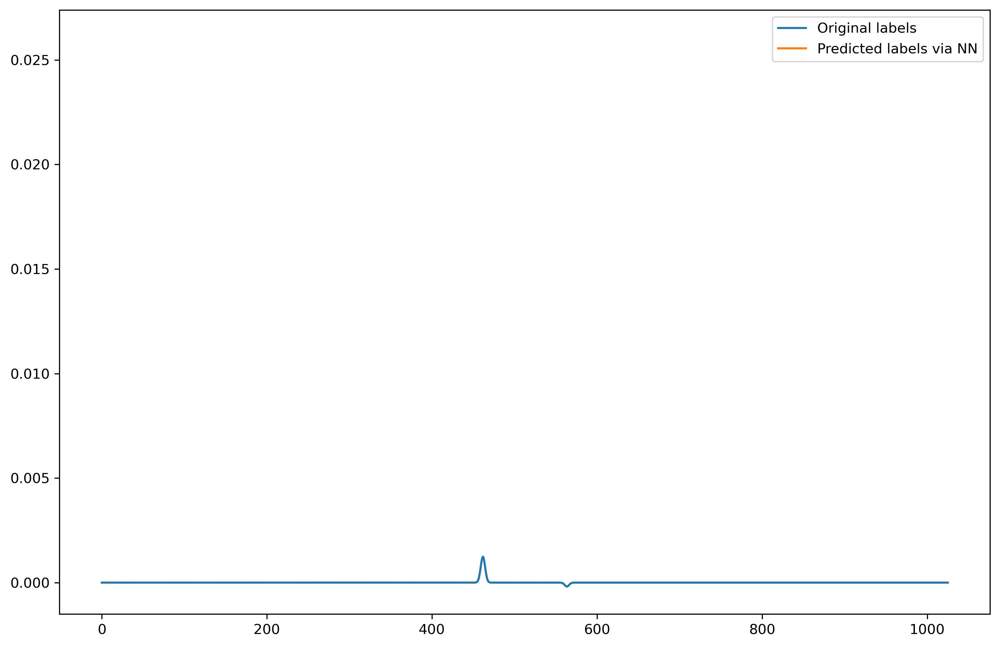

******************************************************************
Fields


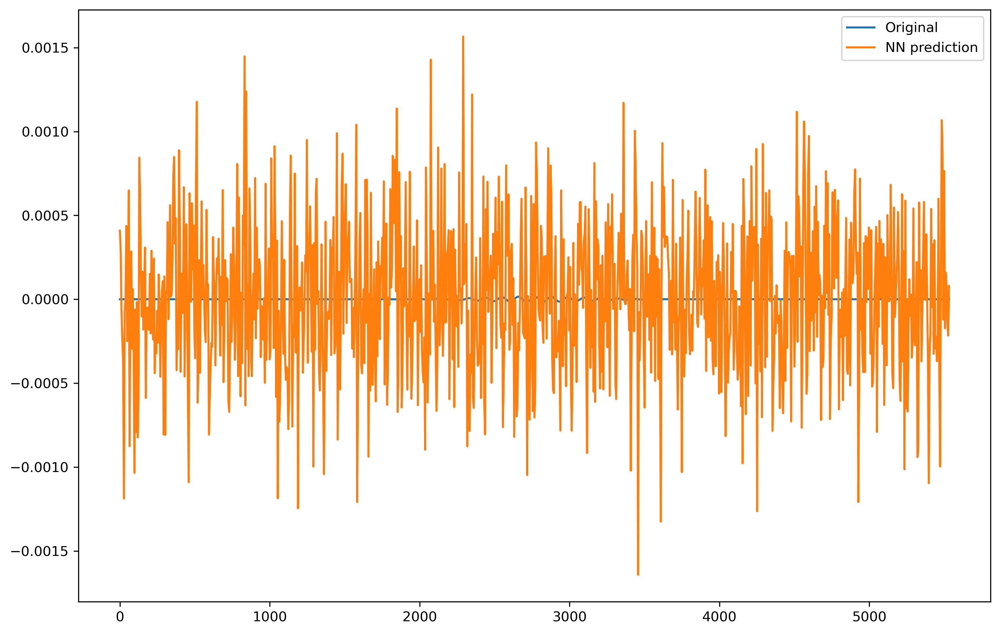

******************************************************************
Fields closeup


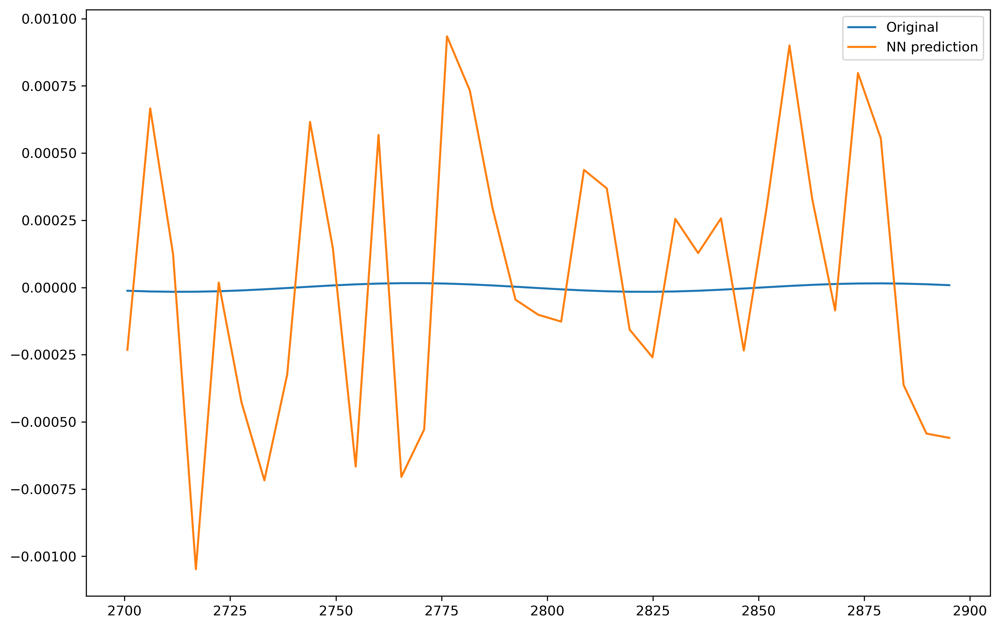

******************************************************************
Spectra


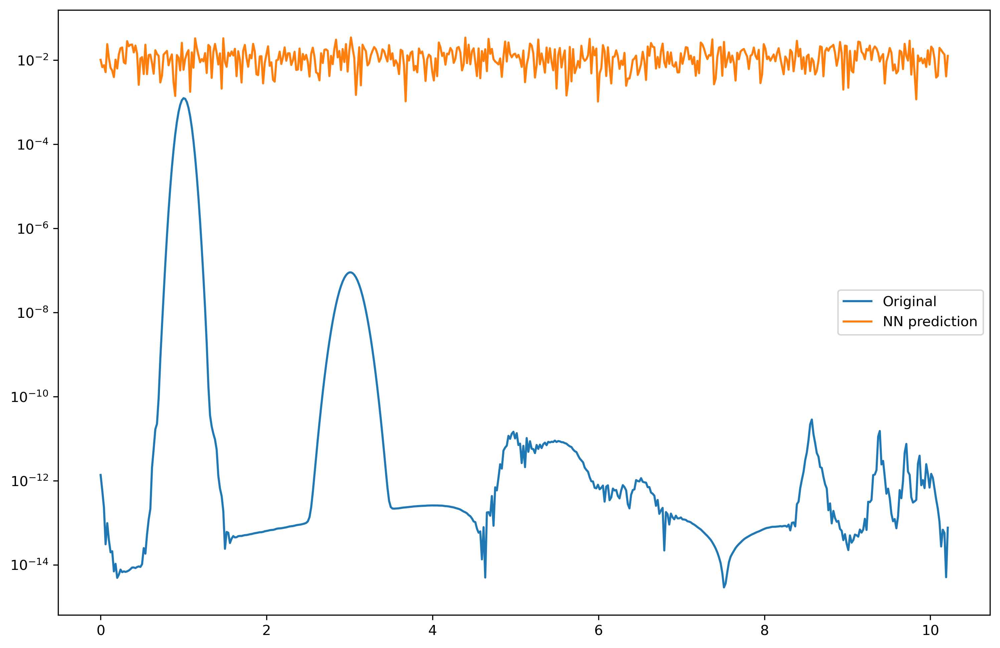

******************************************************************
Phases


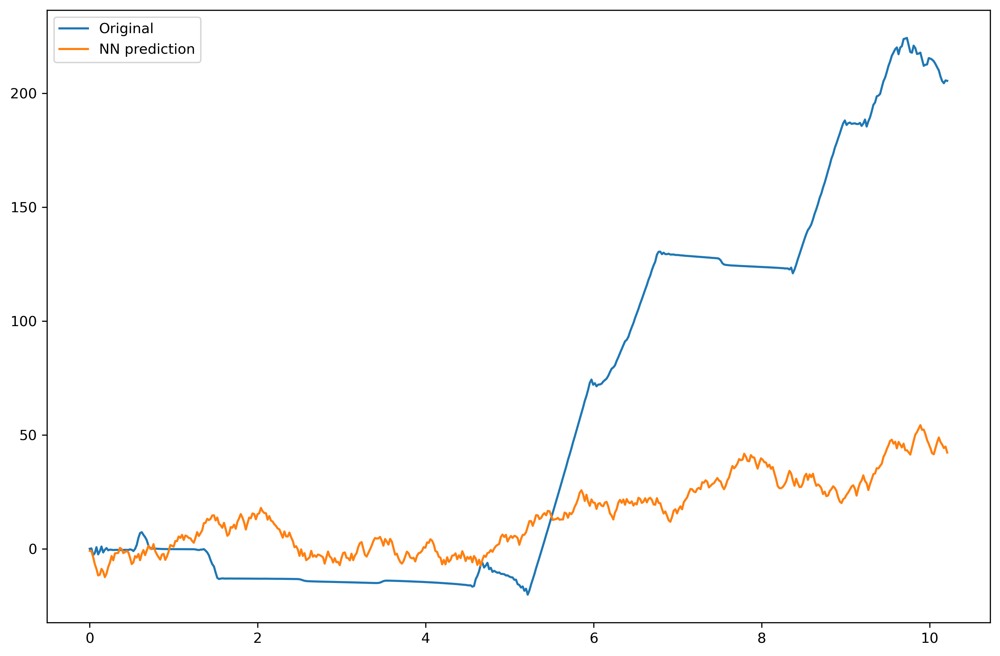

******************************************************************
Statistics


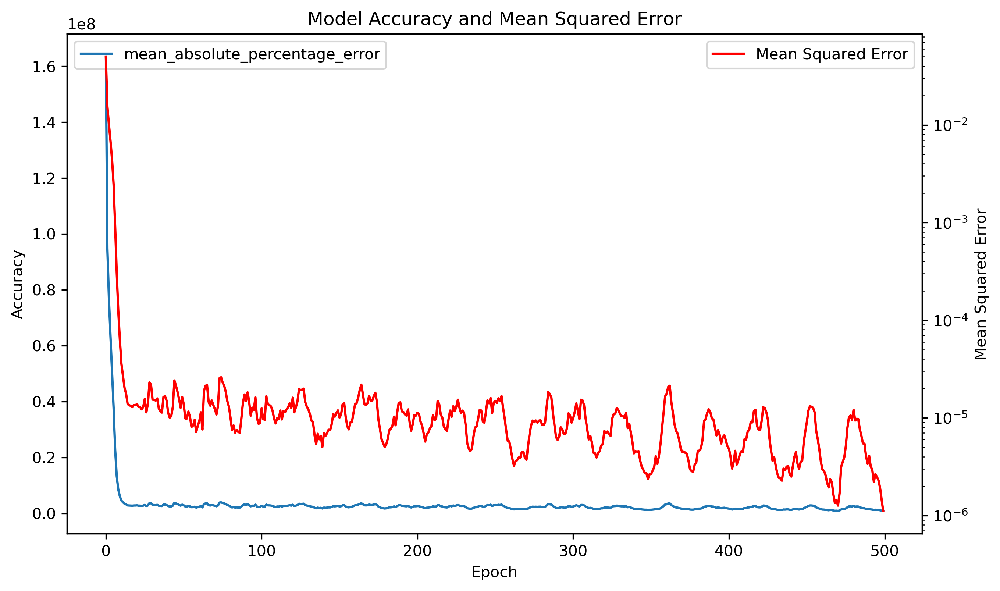

In [73]:
i = 10
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features = (np.expand_dims(x_test_f[i],0))
labels = transformer.predict(features)[0]

real_ = labels[:M//2+1]
imag_ = labels[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN = reconstruct(labels[:M//2+1], labels[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(labels[0], label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig, label = "Original")
plt.plot(t_f, y_NN, label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig[range_], label = "Original")
plt.plot(t_f[range_], y_NN[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig))[0:M//2]), label = "Original")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN))[0:M//2]), label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[i, :M] + 1j*y_test_f[i, M:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.plot(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['mean_absolute_percentage_error'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# LSTM architecture

(100, 500, 1)
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_7 (LSTM)               (None, 64)                16896     
                                                                 
 dense_1109 (Dense)          (None, 500)               32500     
                                                                 
Total params: 49,396
Trainable params: 49,396
Non-trainable params: 0
_________________________________________________________________
Epoch 1/10
3/3 [==============================] - 5s 541ms/step - loss: 0.3308 - val_loss: 0.3330
Epoch 2/10
3/3 [==============================] - 1s 241ms/step - loss: 0.3303 - val_loss: 0.3330
Epoch 3/10
3/3 [==============================] - 1s 193ms/step - loss: 0.3299 - val_loss: 0.3330
Epoch 4/10
3/3 [==============================] - 1s 225ms/step - loss: 0.3294 - val_loss: 0.3331
Epoch 5/10
3/3 [=======================

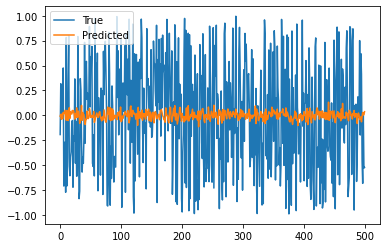

In [757]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Define the input and output sizes
N = 500 # Input array size
M = 1000 # Output array size

# Load and prepare the data
#data = pd.read_csv("data.csv") # load your data from a csv file
#X = data["input"].values # get the input column as a numpy array
#Y = data["output"].values # get the output column as a numpy array
X = np.random.uniform(-1,1,(100, N))
Y = np.random.uniform(-1,1,(100, N))
X = X.reshape(-1, N, 1) # reshape the input array to (batch_size, N, 1)
Y = Y.reshape(-1, N, 1) # reshape the output array to (batch_size, M, 1)
print(X.shape)

# Split the data into train and test sets
train_size = int(len(X) * 0.8) # use 80% of the data for training
X_train, X_test = X[:train_size], X[train_size:] # split the input array
Y_train, Y_test = Y[:train_size], Y[train_size:] # split the output array

# Define the LSTM model
model = keras.models.Sequential([
    # Input layer
    layers.Input(shape=(N, 1)),
    # LSTM layer with 64 hidden units
    layers.LSTM(64),
    # Repeat the output N/M times along the time axis
    #layers.RepeatVector(N/M),
    # Output layer with linear activation
    layers.Dense(N, activation="linear")
])

model.build(input_shape=(None, N, 1))

model.summary()

# Compile the model with MSE loss and Adam optimizer
model.compile(
    loss=keras.losses.MeanSquaredError(),
    optimizer=keras.optimizers.Adam(),
)

# Train the model for 10 epochs with batch size of 32
model.fit(
    X_train,
    Y_train,
    epochs=10,
    batch_size=32,
    validation_data=(X_test, Y_test),
)

# Evaluate the model on the test set using RMSE metric
#Y_pred = model.predict(X_test) # predict the output sequences for the test set
#print(Y_pred.shape)
#print(f"RMSE: {rmse}")
##rmse = np.sqrt(np.mean((Y_pred - Y_test)**2)) # compute the root mean squared error

# Plot the predicted and true sequences for the first test example
import matplotlib.pyplot as plt
plt.plot(Y_test[0], label="True")
plt.plot(Y_pred[0], label="Predicted")
plt.legend()
plt.show()


# CNN

In [5]:
def preprocess(signal, size, t, n = 3, shift = 0.):
    N_original = len(signal)
    #dt = t[1]-t[0]
    T = t[-1]
    #freqs = fftfreq(N_original, dt)*2*np.pi
    ### FFT of the signal and phase shift the signal
    #FT = fft(signal)*np.exp(1j*freqs*T/2)
    FT = fft(signal)
    ### Find corresponding range given the input size
    range_ = np.r_[0:((size)//2+1), (-(size)//2+1):0]
    ### Select the signal according to range
    t_f = np.linspace(0, T, size)
    #T = 0
    dt = t_f[1]-t_f[0]
    freqs = fftfreq(size, dt)*2*np.pi
    FT = FT[range_]*np.exp(1j*freqs*T/2*1)*np.exp(1j*freqs*shift)
    ### Normalize the signal correspondingly
    FT = size/N_original*FT
    ### Separate to real and imaginary part
    real_ = FT.real[0:size//2+1]
    imag_ = FT.imag[0:size//2+1]
    if n == 1:
        return real_, imag_
    real_ = n_th_root(real_, 1/n)
    imag_ = n_th_root(imag_, 1/n)
    return real_, imag_

def reconstruct(real, imag, t, n = 3, shift = 0.):
    dt = t[1]-t[0]
    T = t[-1]
    #T = 0
    N = 2*len(real)-1
    res = 1j*np.zeros((N))
    FF = real**n + 1j*(imag)**n
    #imag = tf.cast(imag, dtype=tf.complex64)
    #real = tf.cast(real, dtype=tf.complex64)
    FF = real + 1j*imag
    FF_conj = np.flip(np.conj(FF)[1:N//2+1])
    res[0:N//2+1] = FF
    res[N//2+1:N] = FF_conj
    freqs = fftfreq(len(res), dt)*2*np.pi
    #K = 8.372e-8
    res = res*np.exp(-1j*freqs*T/2*1)*np.exp(-1j*freqs*shift*1)#-1j*K*z*freqs)
    return ifft(res).real

In [363]:
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/tshift_scan/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/amp_scan/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e13_dz=50000/")
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e14_dz=50000/")

In [364]:
N = 201
M = 4097
M = 1025
M = 2049
N = M
n = 1
m = 1
f = tools.filter(np.ones((len(t))), t)

xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for x in dataset[:,0]])
yf = np.array([np.concatenate(preprocess(f*(-y[1]-0*y[0]), M, t, n = m), axis = None) for y in dataset])


In [365]:
print(xf.shape)
print(yf.shape)

(2001, 1025, 2)
(2001, 2050)


[1324, 1317, 1741, 223, 1435, 1295, 15, 831, 617, 158, 878, 1012, 1993, 303, 549, 15, 380, 1451, 1181, 882, 806, 718, 972, 1358, 771, 734, 682, 939, 1818, 202, 1427, 182, 1802, 1661, 154, 617, 535, 513, 1057, 381, 696, 227, 950, 1420, 376, 973, 482, 54, 1959, 389, 1124, 1910, 192, 621, 1448, 678, 1480, 992, 1005, 250, 1204, 870, 1080, 1318, 1645, 1469, 1486, 277, 1472, 1705, 89, 1113, 1346, 455, 1542, 431, 140, 562, 1873, 1880, 1275, 1920, 1102, 459, 1296, 1557, 1664, 1825, 1757, 567, 255, 1826, 458, 357, 951, 1171, 535, 1531, 100, 446, 1222, 1083, 399, 963, 1751, 1256, 498, 1197, 1325, 921, 1268, 1441, 994, 109, 1306, 911, 938, 519, 1440, 1686, 1377, 820, 644, 639, 1358, 280, 4, 867, 747, 1511, 75, 487, 1042, 1001, 1211, 1750, 1296, 1259, 1708, 777, 554, 1795, 526, 530, 647, 1882, 1068, 636, 1780, 1119, 1521, 965, 98, 430, 882, 457, 987, 1972, 965, 860, 1276, 984, 728, 1431, 877, 314, 945, 1104, 1673, 1984, 1661, 873, 1619, 1107, 661, 996, 464, 1223, 697, 1315, 1204, 640, 1800, 503, 3

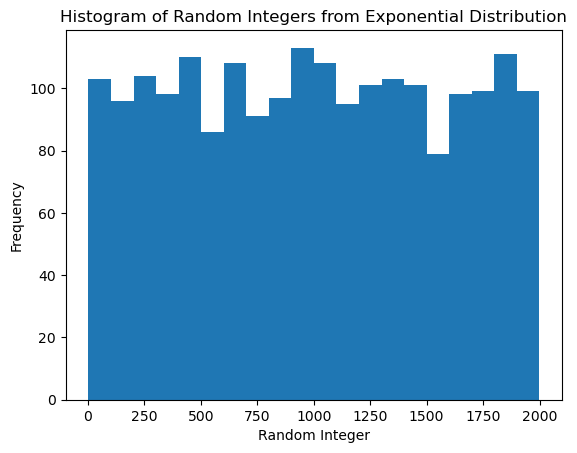

In [366]:
samples = generate_random_integers(4000, lambda_=0.01, max_index=4000)
samples = generate_random_integers(500, lambda_=0.01, max_index=500)
samples = generate_random_integers(2000, lambda_=0.01, max_index=2000)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [367]:
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(2000, 1025, 2)
(2000, 2050)


In [368]:
#x_train_f, x_test_f = x_f[:400], x_f[400:]
#y_train_f, y_test_f = y_f[:400], y_f[400:]
#x_train_f, x_test_f = x_f[:3000], x_f[3000:]
#y_train_f, y_test_f = y_f[:3000], y_f[3000:]
x_train_f, x_test_f = x_f[:1500], x_f[1500:]
y_train_f, y_test_f = y_f[:1500], y_f[1500:]

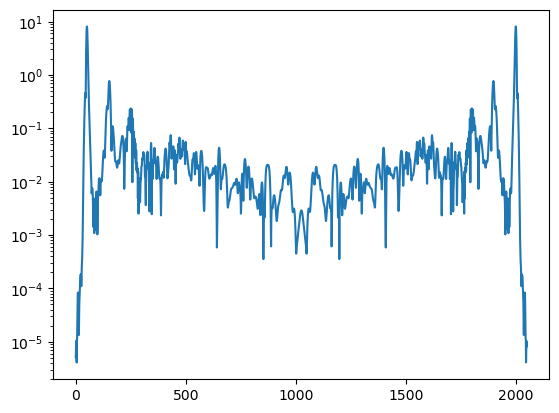

In [369]:
real_, imag_ = x_test_f[20][:,0], x_test_f[20][:,1]
real_, imag_ = y_test_f[20][:M//2+1], y_test_f[20][M//2+1:]
signal =reconstruct(real_, imag_, t)

plt.semilogy(np.abs(fft(signal)))
plt.show()

Min-max normalization

In [370]:
# Assume x_train is a tensor of shape (batch_size_train, N, 2)
x_train_min = tf.reduce_min(x_train_f) # scalar
x_train_max = tf.reduce_max(x_train_f) # scalar
x_train_f = 2 * (x_train_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_train, N, 2)
#x_train_f = (x_train_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_train, N, 2)

# Assume x_val is a tensor of shape (batch_size_val, N, 2)
x_test_f = 2 * (x_test_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_val, N, 2)
#x_test_f = (x_test_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_val, N, 2)

# Assume x_train is a tensor of shape (batch_size_train, N, 2)
#y_train_min = tf.reduce_min(y_train_f) # scalar
#y_train_max = tf.reduce_max(y_train_f) # scalar
#y_train_f = 2 * (y_train_f - y_train_min) / (y_train_max - y_train_min) - 1 # shape (batch_size_train, N, 2)
#x_train_f = (x_train_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_train, N, 2)

# Assume x_val is a tensor of shape (batch_size_val, N, 2)
#y_test_f = 2 * (y_test_f - y_train_min) / (y_train_max - y_train_min) - 1 # shape (batch_size_val, N, 2)
#x_test_f = (x_test_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_val, N, 2)

Z-score normalization

In [1718]:
x_train_mean = tf.reduce_mean(x_train_f) # scalar 
x_train_std = tf.math.reduce_std(x_train_f) # scalar 
x_train_f = (x_train_f - x_train_mean) / x_train_std # shape (batch_size_train, N, 2)

x_test_f = (x_test_f - x_train_mean) / x_train_std


#y_train_mean = tf.reduce_mean(y_train_f) # scalar 
#y_train_std = tf.math.reduce_std(y_train_f) # scalar 
#y_train_f = (y_train_f - y_train_mean) / y_train_std # shape (batch_size_train, N, 2)

#y_test_f = (y_test_f - y_train_mean) / y_train_std

Log-normalization

In [1722]:
def log_normalize(x, k = 1e15):
    return np.sign(x)*np.log(1+np.abs(x)*k)

x_train_f = log_normalize(x_train_f)
x_test_f = log_normalize(x_test_f)

#y_train_f = log_normalize(y_train_f)

In [1650]:
print(x_train_f[0][:,1])

tf.Tensor(
[-2.83557288e-03 -2.83557287e-03 -2.83557287e-03 -2.83557287e-03
 -2.83557287e-03 -2.83557287e-03 -2.83557287e-03 -2.83557287e-03
 -2.83557287e-03 -2.83557287e-03 -2.83557287e-03 -2.83557287e-03
 -2.83557287e-03 -2.83557287e-03 -2.83557286e-03 -2.83557286e-03
 -2.83557286e-03 -2.83557286e-03 -2.83557286e-03 -2.83557286e-03
 -2.83557285e-03 -2.83557285e-03 -2.83557285e-03 -2.83557284e-03
 -2.83557285e-03 -2.83557286e-03 -2.83557275e-03 -2.83557276e-03
 -2.83557375e-03 -2.83557443e-03 -2.83556778e-03 -2.83555196e-03
 -2.83556228e-03 -2.83568149e-03 -2.83580036e-03 -2.83450149e-03
 -2.82515349e-03 -2.77373462e-03 -2.48593921e-03 -9.98487284e-04
  5.60326705e-03  3.05439187e-02  1.11178057e-01  3.34581434e-01
  8.63175560e-01  1.92435400e+00  3.71436821e+00  6.21076463e+00
  8.99898575e+00  1.13010735e+01  1.23019306e+01  1.16081078e+01
  9.49420711e+00  6.73020412e+00  4.13467923e+00  2.20123718e+00
  1.01517587e+00  4.04867296e-01  1.38683014e-01  3.96952523e-02
  8.22544403e-

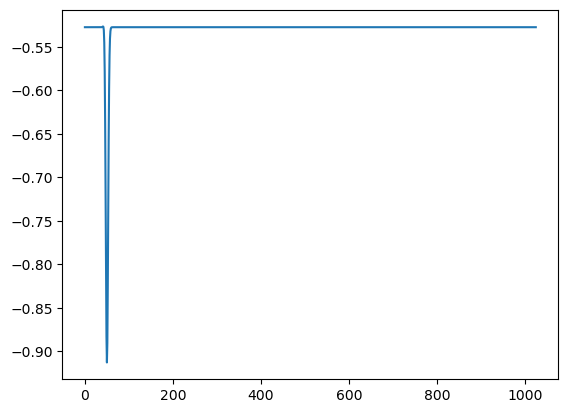

In [15]:
%matplotlib inline
#real_, imag_ = y_test_f[20][:M//2+1], y_test_f[20][M//2+1:]
real_, imag_ = x_test_f[20][:,0], x_test_f[20][:,1]
#signal =reconstruct(real_, imag_, t)

plt.plot(imag_)
#plt.plot(log_normalize(y_train_f[0][:]))
#plt.plot(y_train_f[0][:])
plt.show()

In [250]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(1500, 1025, 2)
(1500, 2050)
(500, 1025, 2)
(500, 2050)


(1, 1025, 2)


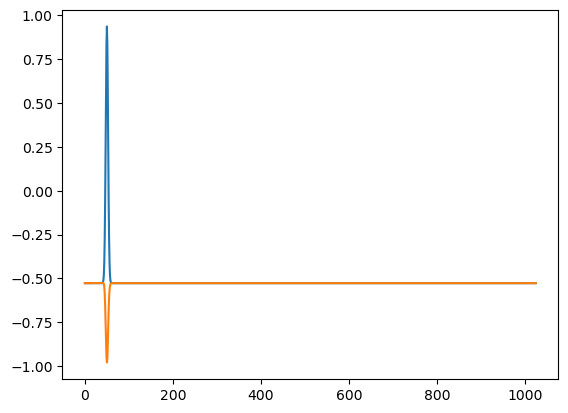

(1, 341, 2)


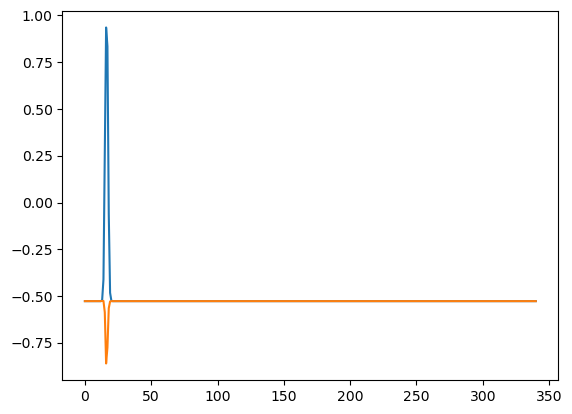

(1, 339, 8)


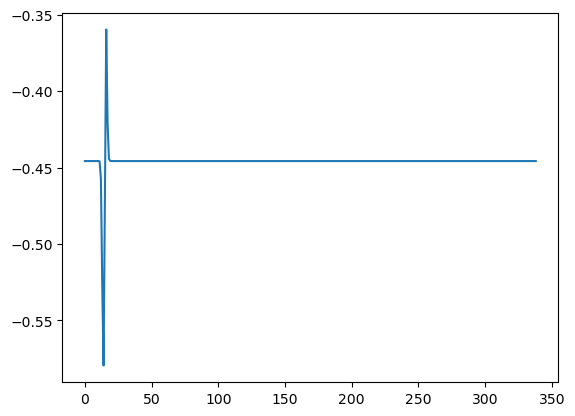

(1, 113, 8)


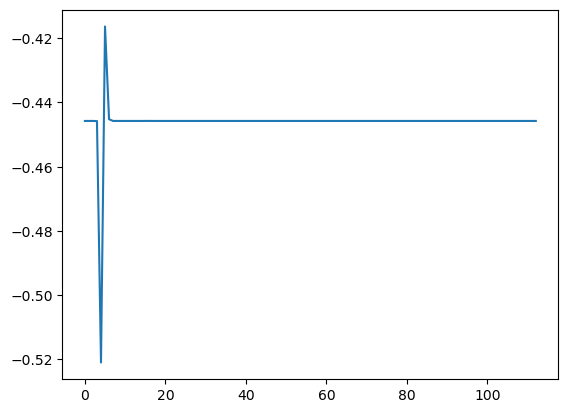

(1, 111, 16)


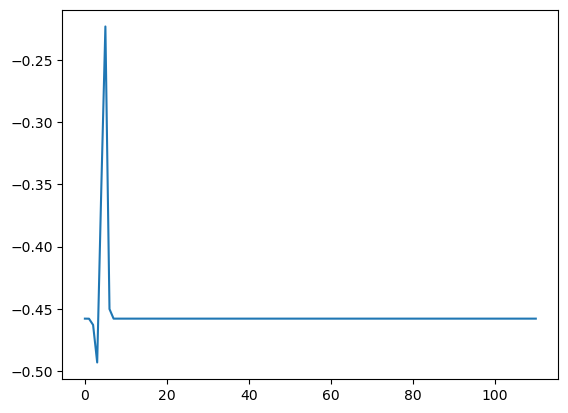

(1, 35, 32)


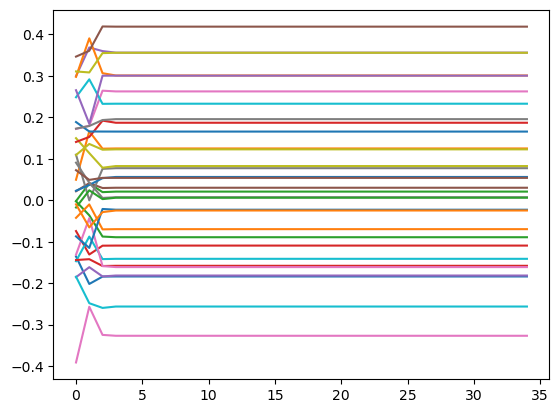

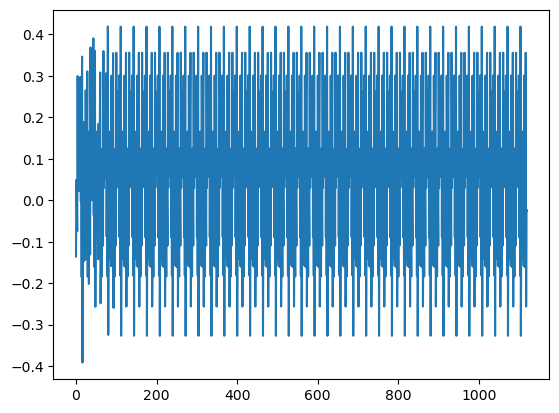

In [17]:
x = x_test_f[30]
#x = tf.expand_dims(x, axis=1)
x = tf.expand_dims(x, axis=0)
print(x.shape)

j = 1
plt.plot(x[0])
plt.show()


# Define the input shape (batch_size, time_steps, features)
input_shape = x.shape

pool_layer = tf.keras.layers.MaxPool1D(3)
x = pool_layer(x)
print(x.shape)
plt.plot(x[0])
plt.show()

# Create a convolution layer conv1D with 32 filters, kernel size of 3 and padding='same'
conv_layer = tf.keras.layers.Conv1D(filters=8, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer(x)
print(conv_output.shape)
plt.plot(conv_output[0,:,j])
plt.show()

pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)

print(pool_output.shape)
plt.plot(pool_output[0, :, j])
plt.show()

conv_layer2 = tf.keras.layers.Conv1D(filters=16, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer2(pool_output)
print(conv_output.shape)
plt.plot(conv_output[0,:,j])
plt.show()

pool_layer = tf.keras.layers.AvgPool1D(3)
pool_output = pool_layer(conv_output)

conv_layer3 = tf.keras.layers.Conv1D(filters=32, kernel_size=3, padding='valid', input_shape=input_shape, activation=tf.keras.activations.tanh)
conv_output = conv_layer3(pool_output)
print(conv_output.shape)
#plt.plot(n_th_root(conv_output[0,:,1], 1))
plt.plot(conv_output[0,:,:])
plt.show()

#flattened_output = tf.keras.layers.Flatten(data_format = "channels_first")(conv_output)
flattened_output = tf.keras.layers.Flatten(data_format = "channels_last")(conv_output)
plt.plot(flattened_output[0])
plt.show()

In [371]:
reload(NN)

### Create custom NN model
model = NN.TDSE_NN_Conv((N//2+1, 2,), 2*(M//2+1), bias = True, dropout=0.4, dropout_input=0., activation="tanh", conv_activation="tanh")

model.build(input_shape=(None, N//2+1, 2))

### Print summary of the model (basic info)
model.summary()

Model: "tdse_nn__conv_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


 input_96 (InputLayer)       [(None, 1025, 2)]         0         
                                                                 
 dropout_950 (Dropout)       multiple                  0 (unused)
                                                                 
 dense_1234 (Dense)          multiple                  151680    
                                                                 
 dropout_951 (Dropout)       multiple                  0         
                                                                 
 dense_1235 (Dense)          multiple                  8256      
                                                                 
 dropout_952 (Dropout)       multiple                  0         
                                                                 
 dense_1236 (Dense)          multiple                  2080      
                                                                 
 dropout_953 (Dropout)       multiple                  0 (unused)
          

In [372]:
epochs = 700
#patience = 600
patience = 20
batch_size = 64

### Compile model
model.compile(#optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              optimizer=tf.keras.optimizers.Adam(),
              loss=tf.keras.losses.MeanSquaredError(),
              #loss=TimeSpectrumMSE(),
              metrics=['mean_absolute_percentage_error'])
              #metrics=[time_spectrum_MSE])

### Fit model
history = model.fit(x_train_f, y_train_f, epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=batch_size)
        #callbacks = [tf.keras.callbacks.EarlyStopping(monitor='mean_absolute_percentage_error', patience=patience)], batch_size=batch_size)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test_f, y_test_f)

Epoch 1/700


24/24 [==============================] - 5s 32ms/step - loss: 0.1634 - mean_absolute_percentage_error: 99622.9688
Epoch 2/700
24/24 [==============================] - 1s 33ms/step - loss: 0.0719 - mean_absolute_percentage_error: 93881.9766
Epoch 3/700
24/24 [==============================] - 1s 34ms/step - loss: 0.0134 - mean_absolute_percentage_error: 65926.3203
Epoch 4/700
24/24 [==============================] - 1s 31ms/step - loss: 0.0050 - mean_absolute_percentage_error: 33628.4609
Epoch 5/700
24/24 [==============================] - 1s 30ms/step - loss: 0.0033 - mean_absolute_percentage_error: 15166.4482
Epoch 6/700
24/24 [==============================] - 1s 33ms/step - loss: 0.0027 - mean_absolute_percentage_error: 7112.8945
Epoch 7/700
24/24 [==============================] - 1s 30ms/step - loss: 0.0025 - mean_absolute_percentage_error: 3347.6682
Epoch 8/700
24/24 [==============================] - 1s 27ms/step - loss: 0.0023 - mean_absolute_percentage_error: 1975.9863
Epoch 9

[0.0020832091104239225, 2167.730224609375]

1/1 [==============================] - 0s 30ms/step
******************************************************************
Features


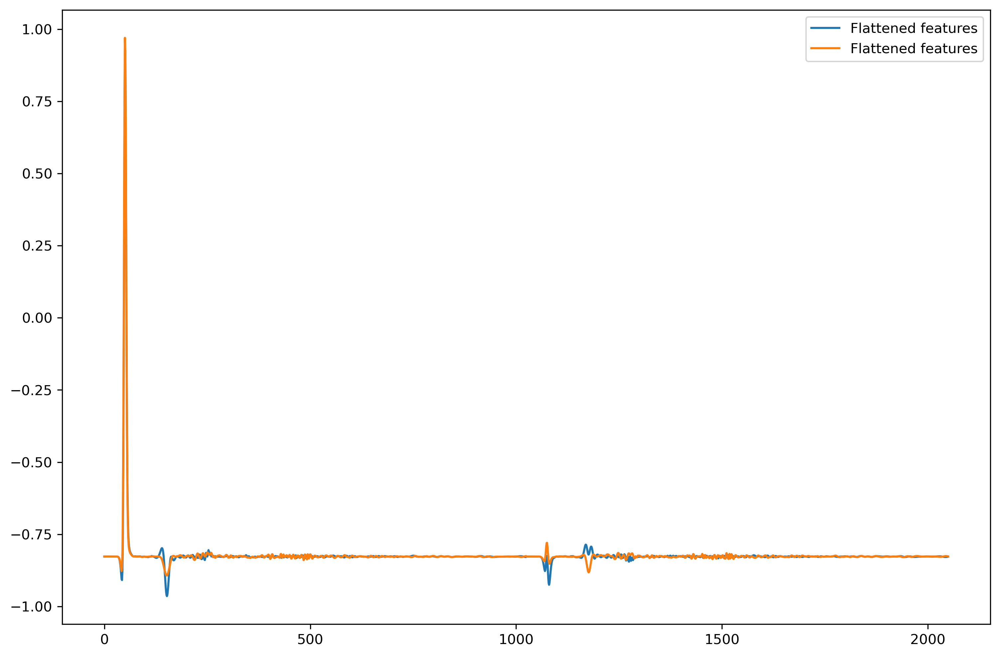

******************************************************************
Labels


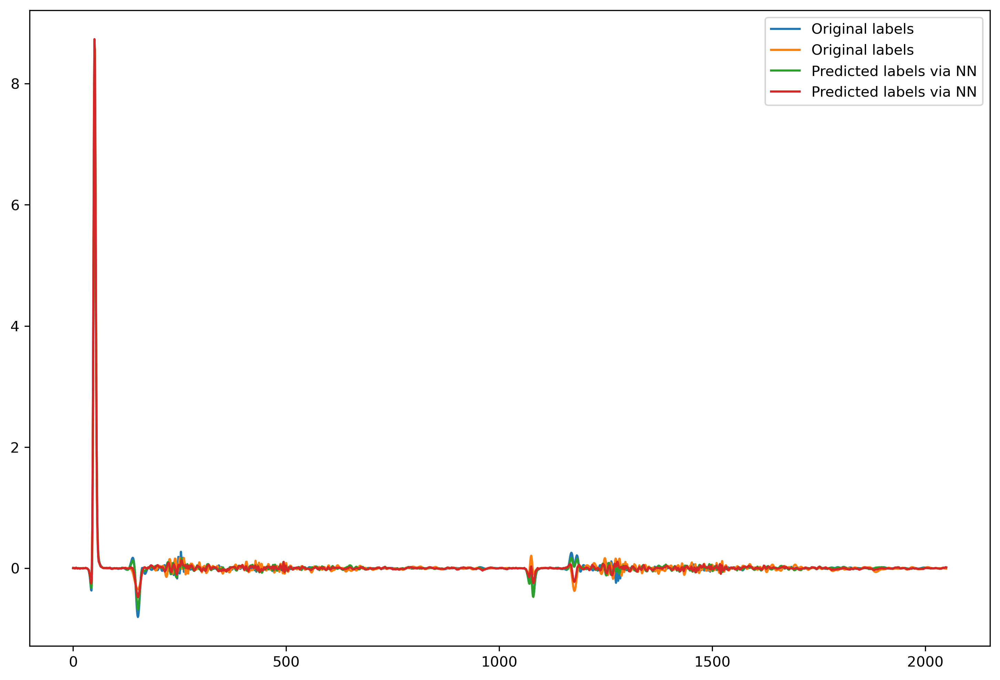

******************************************************************
Fields


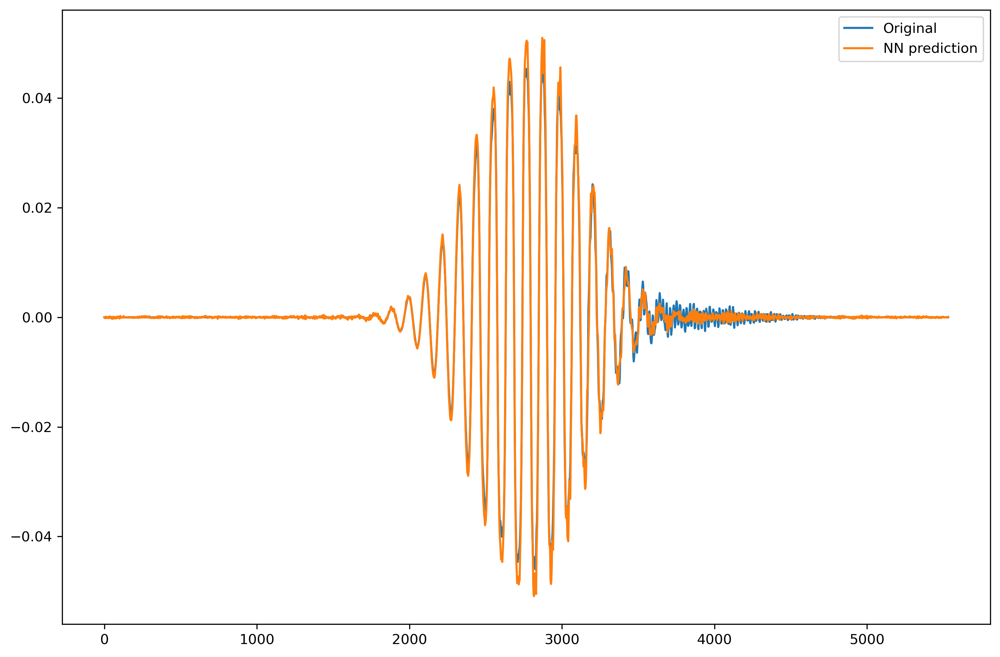

******************************************************************
Fields closeup


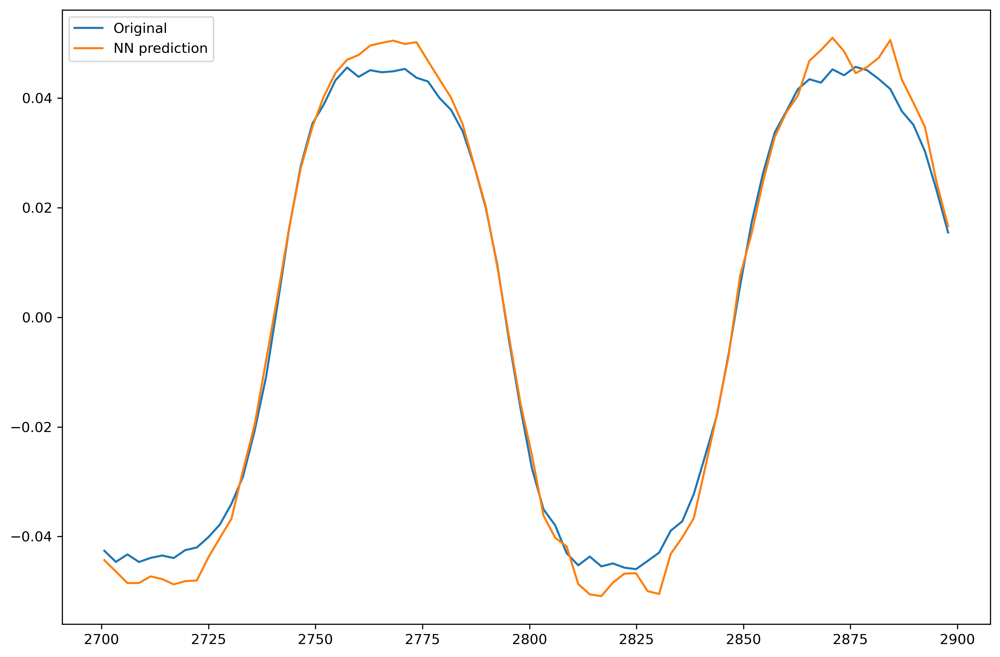

******************************************************************
Spectra


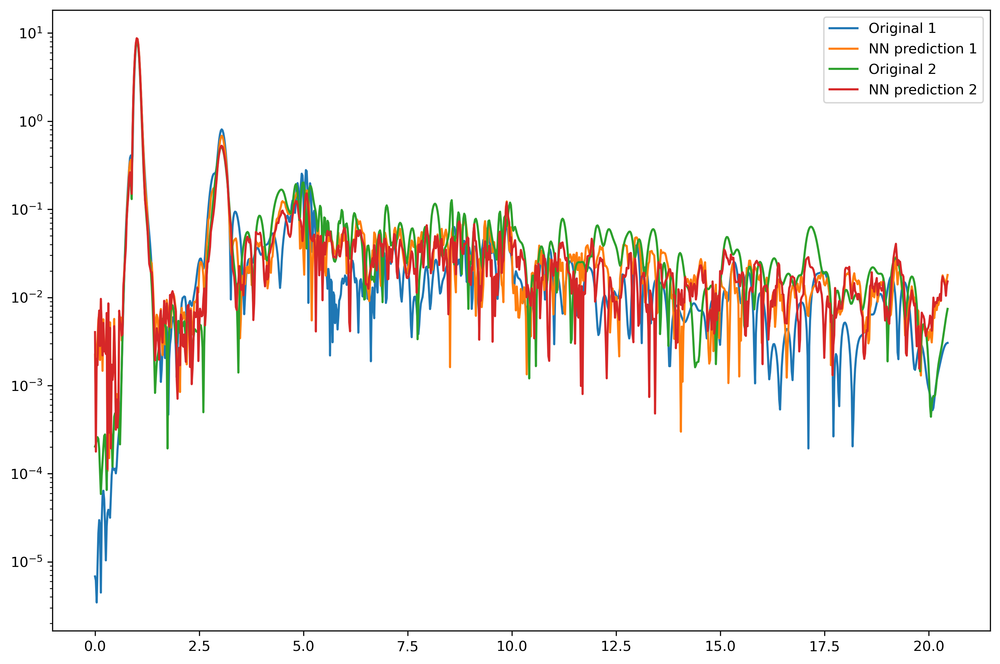

******************************************************************
Phases


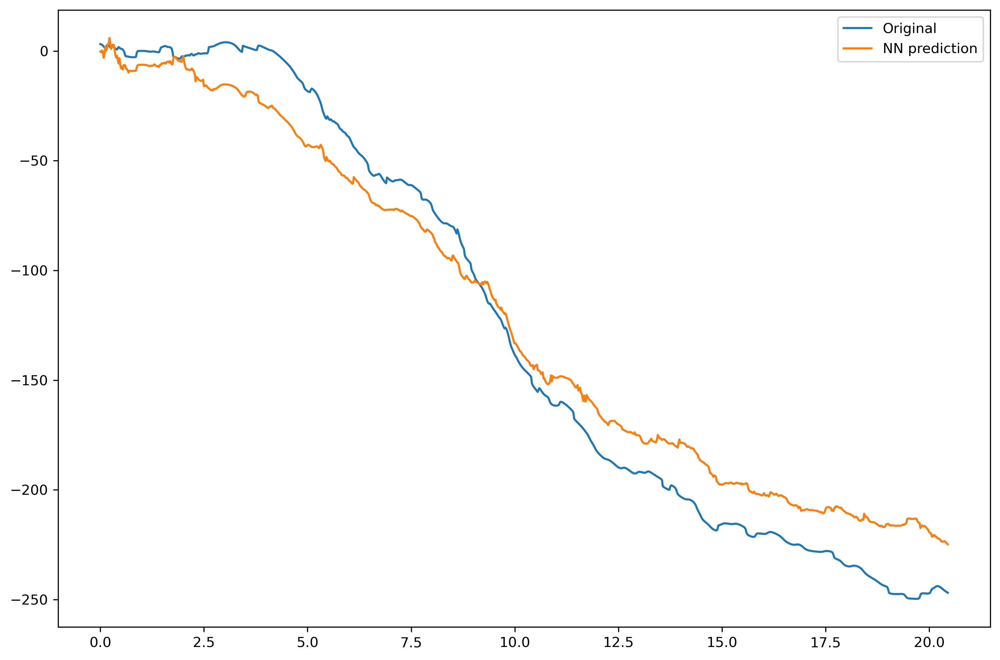

******************************************************************
Statistics


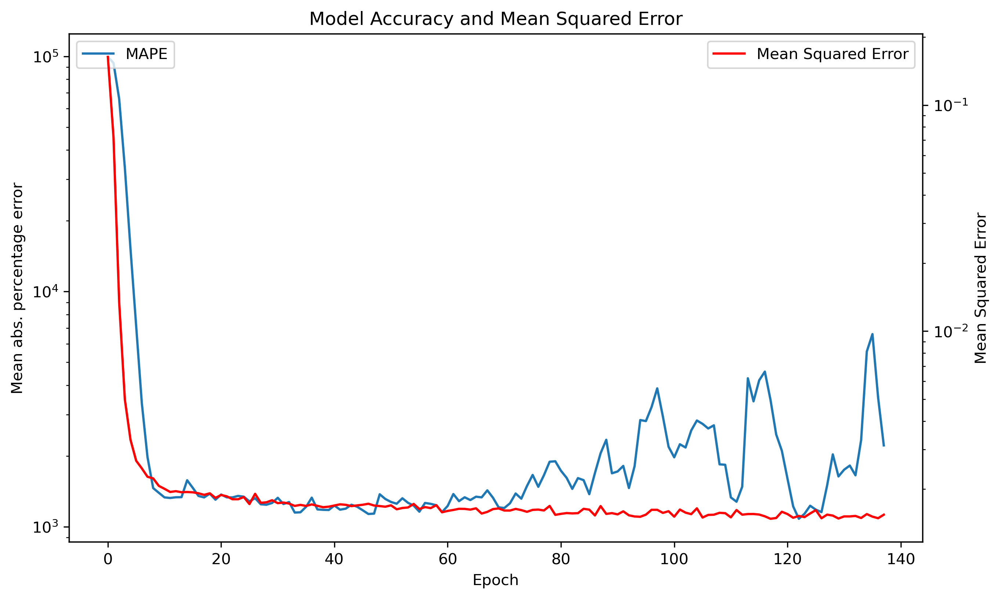

In [373]:
%matplotlib inline
i = 10
j = 15
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features1 = (np.expand_dims(x_test_f[i],0))
labels1 = model.predict(features1)[0]

real_ = labels1[:M//2+1]
imag_ = labels1[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN1 = reconstruct(labels1[:M//2+1], labels1[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig1 = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
features2 = (np.expand_dims(x_test_f[j],0))
labels2 = model.predict(features2)[0]

real_ = labels2[:M//2+1]
imag_ = labels2[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN2 = reconstruct(labels2[:M//2+1], labels2[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig2 = reconstruct(y_test_f[j, :M//2+1], y_test_f[j, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features1[0]).flatten(), label = "Flattened features")
plt.plot(np.transpose(features2[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(y_test_f[j], label = "Original labels", linestyle = "-")
plt.plot(labels1, label = "Predicted labels via NN")
plt.plot(labels2, label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig1, label = "Original")
plt.plot(t_f, y_NN1, label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig1[range_], label = "Original")
plt.plot(t_f[range_], y_NN1[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig1))[0:M//2]), label = "Original 1")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN1))[0:M//2]), label = "NN prediction 1")
#field = reconstruct(features1[:M//2+1], features1[M//2+1:], t_f, n = m)
#plt.semilogy(freqs[0:M//2], (np.abs(fft(field))[0:M//2]), label = "Field", linestyle = ":")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig2))[0:M//2]), label = "Original 2")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN2))[0:M//2]), label = "NN prediction 2")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

#plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[j, :(M//2+1)] + 1j*(y_test_f[j, (M//2+1):])))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.semilogy(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Mean abs. percentage error')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['MAPE'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()

# Generation of new data from the simplest features

In [242]:
dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/amp_scan/")
#dataset, t = load_fields_from_h5("/Volumes/NEMEC_SSD/1e10_dz=50000_x/")

In [275]:
N = 201
M = 1025
n = 1
m = 5
f = tools.filter(np.ones((len(t))), t)

#xf = np.array([np.transpose(preprocess(f*x, N, t, n = n)) for x in dataset[:,0]])
yf = np.array([np.concatenate(preprocess(f*(-y[1]-0*y[0]), M, t, n = m), axis = None) for y in dataset])


In [276]:
import os
dir = "/Volumes/NEMEC_SSD/amp_scan/"
arr = os.listdir(dir)
file_paths = [dir + x for x in arr if x.endswith('.h5')]
util.sort_nicely(file_paths)
amplitude = list()
for file in file_paths:
    data = h5py.File(file, "r")
    #E_arr.append(data["outputs/Efield"][:,0])
    #gradV_arr.append(data["outputs/grad_pot"][:,0])
    amplitude.append(data["inputs/E0_1"][()])
    data.close()

#return np.array([np.array(E_arr), np.array(gradV_arr)]), t
xf = n_th_root(np.array(amplitude), 1/n)

In [130]:
print(xf)

[0.50374053 0.50416249 0.50458481 0.50500747 0.5054305  0.50585387
 0.5062776  0.50670169 0.50712613 0.50755093 0.50797608 0.50840159
 0.50882745 0.50925367 0.50968025 0.51010719 0.51053448 0.51096213
 0.51139014 0.51181851 0.51224724 0.51267632 0.51310577 0.51353557
 0.51396574 0.51439626 0.51482715 0.5152584  0.51569001 0.51612198
 0.51655431 0.516987   0.51742006 0.51785348 0.51828726 0.51872141
 0.51915591 0.51959079 0.52002603 0.52046163 0.52089759 0.52133393
 0.52177062 0.52220769 0.52264512 0.52308291 0.52352108 0.52395961
 0.5243985  0.52483777 0.5252774  0.5257174  0.52615777 0.52659851
 0.52703962 0.52748109 0.52792294 0.52836516 0.52880774 0.5292507
 0.52969403 0.53013773 0.5305818  0.53102625 0.53147106 0.53191625
 0.53236182 0.53280775 0.53325406 0.53370074 0.5341478  0.53459523
 0.53504304 0.53549122 0.53593977 0.53638871 0.53683801 0.5372877
 0.53773776 0.5381882  0.53863901 0.53909021 0.53954178 0.53999373
 0.54044606 0.54089876 0.54135185 0.54180531 0.54225916 0.542713

[414, 388, 143, 453, 41, 221, 162, 398, 127, 62, 415, 463, 405, 487, 280, 53, 437, 198, 348, 328, 108, 393, 115, 272, 260, 219, 158, 31, 189, 226, 34, 62, 174, 81, 444, 154, 430, 98, 421, 198, 140, 72, 120, 90, 66, 27, 238, 418, 77, 253, 108, 470, 482, 402, 3, 450, 346, 479, 453, 131, 69, 210, 480, 91, 18, 242, 491, 431, 103, 75, 114, 232, 87, 235, 465, 441, 335, 122, 277, 353, 197, 132, 449, 349, 402, 424, 412, 374, 398, 285, 86, 142, 27, 85, 196, 308, 19, 327, 323, 419, 282, 334, 107, 420, 55, 466, 169, 350, 199, 321, 452, 94, 407, 331, 58, 45, 333, 155, 85, 90, 194, 459, 457, 9, 242, 262, 355, 317, 95, 349, 458, 136, 112, 86, 275, 209, 227, 386, 274, 469, 365, 301, 347, 410, 184, 490, 152, 384, 7, 274, 28, 208, 235, 470, 160, 226, 465, 301, 82, 403, 144, 231, 188, 209, 35, 55, 354, 448, 168, 142, 15, 0, 238, 211, 380, 289, 141, 289, 146, 65, 211, 144, 205, 278, 270, 334, 297, 357, 336, 420, 468, 238, 399, 340, 228, 153, 23, 492, 268, 151, 98, 192, 344, 51, 371, 30, 289, 366, 371, 17

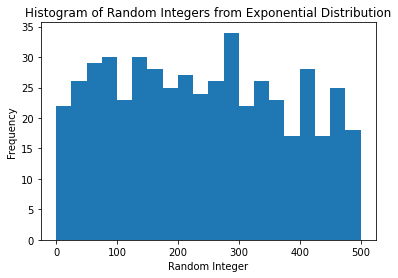

In [277]:
samples = generate_random_integers(500, lambda_=0.01, max_index=500)
print(samples)

plt.hist(samples, bins=20)
plt.xlabel("Random Integer")
plt.ylabel("Frequency")
plt.title("Histogram of Random Integers from Exponential Distribution")
plt.show()

In [278]:
x_f = xf[samples]
y_f = yf[samples]
print(x_f.shape)
print(y_f.shape)

(500,)
(500, 1026)


In [279]:
x_train_f, x_test_f = x_f[:400], x_f[400:]
y_train_f, y_test_f = y_f[:400], y_f[400:]

In [280]:
# Assume x_train is a tensor of shape (batch_size_train, N, 2)
x_train_min = tf.reduce_min(x_train_f) # scalar
x_train_max = tf.reduce_max(x_train_f) # scalar
x_train_f = 2 * (x_train_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_train, N, 2)
#x_train_f = (x_train_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_train, N, 2)

# Assume x_val is a tensor of shape (batch_size_val, N, 2)
x_test_f = 2 * (x_test_f - x_train_min) / (x_train_max - x_train_min) - 1 # shape (batch_size_val, N, 2)
#x_test_f = (x_test_f - x_train_min) / (x_train_max - x_train_min)  # shape (batch_size_val, N, 2)

In [281]:
print(x_train_f.shape)
print(y_train_f.shape)
print(x_test_f.shape)
print(y_test_f.shape)

(400,)
(400, 1026)
(100,)
(100, 1026)


In [285]:
reload(NN)

### Create custom NN model
model = NN.TDSE_NN_5((1,), 2*(M//2+1), bias = True, dropout=0.5, dropout_input=0., activation = "tanh")

model.build(input_shape=(None, 1))

### Print summary of the model (basic info)
model.summary()

Model: "tdse_nn_5_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_48 (InputLayer)       [(None, 1)]               0         
                                                                 
 dropout_480 (Dropout)       multiple                  0         
                                                                 
 dense_484 (Dense)           multiple                  2         
                                                                 
 dropout_481 (Dropout)       multiple                  0         
                                                                 
 dense_485 (Dense)           multiple                  8         
                                                                 
 dropout_482 (Dropout)       multiple                  0         
                                                                 
 dense_486 (Dense)           multiple                  

In [286]:
epochs = 2000
#patience = 600
patience = 200
batch_size = 32

### Compile model
model.compile(#optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              optimizer=tf.keras.optimizers.Adam(),
              loss=tf.keras.losses.MeanSquaredError(),
              #loss=TimeSpectrumMSE(),
              metrics=['mean_absolute_percentage_error'])
              #metrics=[time_spectrum_MSE])

### Fit model
history = model.fit(x_train_f, y_train_f, epochs = epochs, 
        callbacks = [tf.keras.callbacks.EarlyStopping(monitor='loss', patience=patience)], batch_size=batch_size)

### Quantify the accuracy of the model on the test data
model.evaluate(x_test_f, y_test_f)

Epoch 1/2000
13/13 [==============================] - 4s 8ms/step - loss: 0.0301 - mean_absolute_percentage_error: 1604.8706
Epoch 2/2000
13/13 [==============================] - 0s 7ms/step - loss: 0.0255 - mean_absolute_percentage_error: 930.4034
Epoch 3/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0211 - mean_absolute_percentage_error: 1396.0897
Epoch 4/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0174 - mean_absolute_percentage_error: 1130.7371
Epoch 5/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0154 - mean_absolute_percentage_error: 1311.3812
Epoch 6/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0147 - mean_absolute_percentage_error: 1123.2056
Epoch 7/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0143 - mean_absolute_percentage_error: 798.4180
Epoch 8/2000
13/13 [==============================] - 0s 8ms/step - loss: 0.0141 - mean_absolute_percentage_error: 730.7109
Epo

[0.011858999729156494, 121.66459655761719]

1/1 [==============================] - 0s 45ms/step
******************************************************************
Features


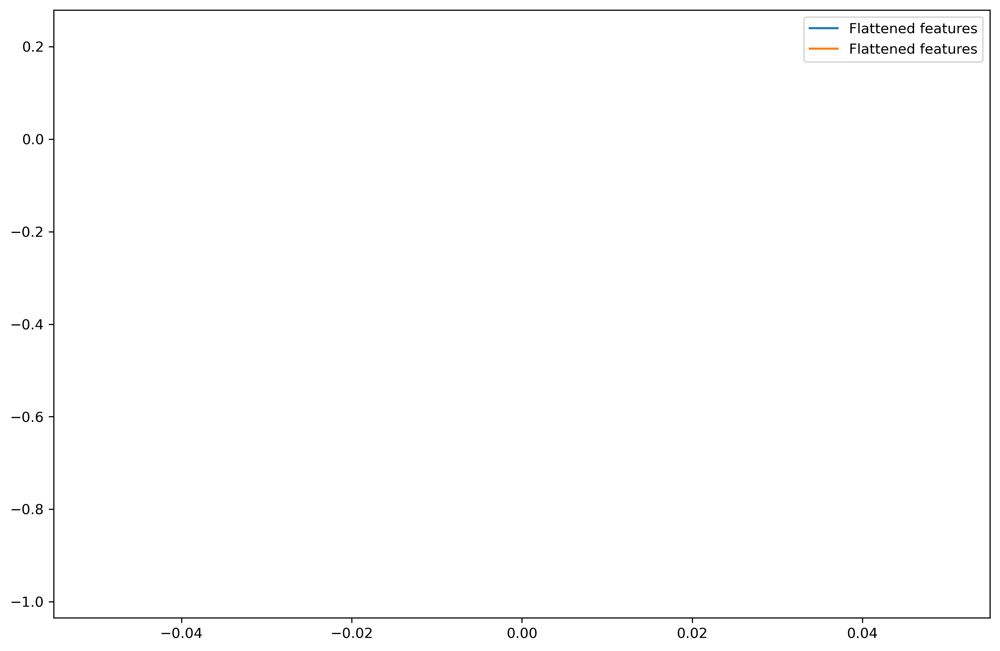

******************************************************************
Labels


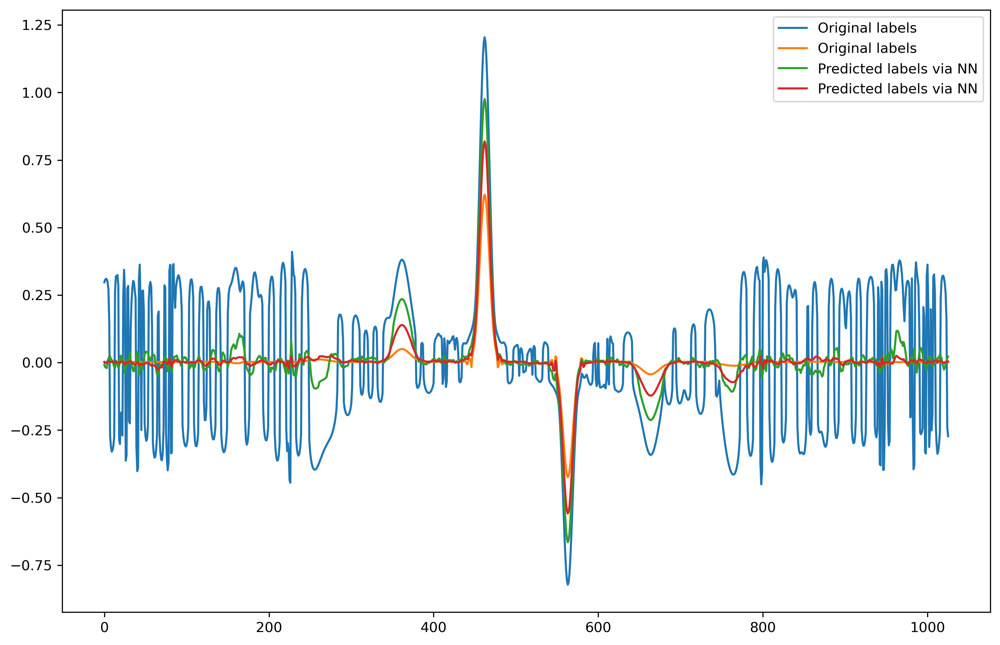

******************************************************************
Fields


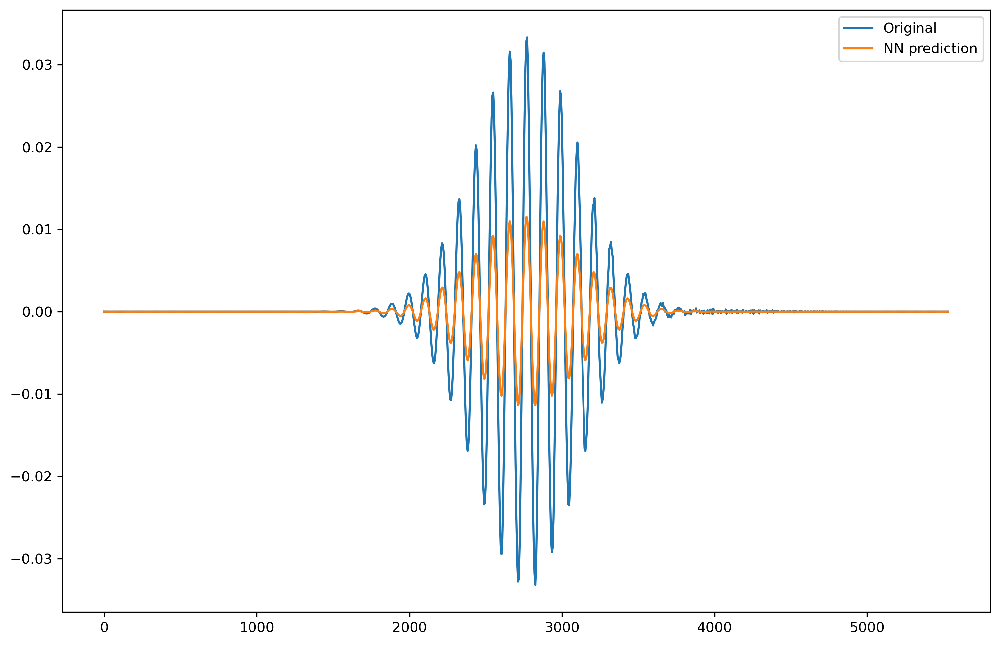

******************************************************************
Fields closeup


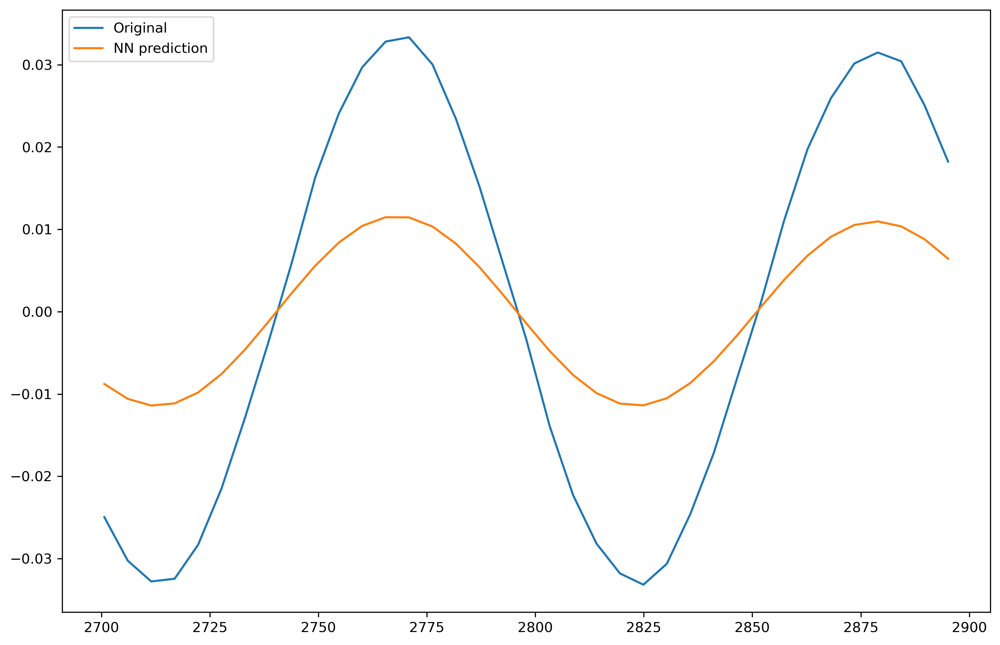

******************************************************************
Spectra


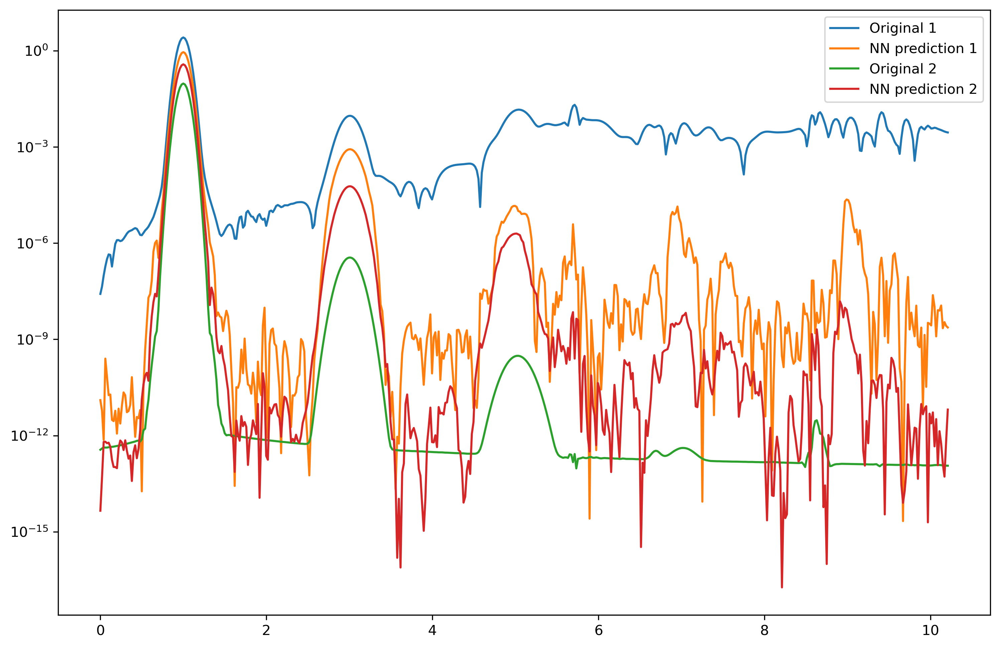

******************************************************************
Phases


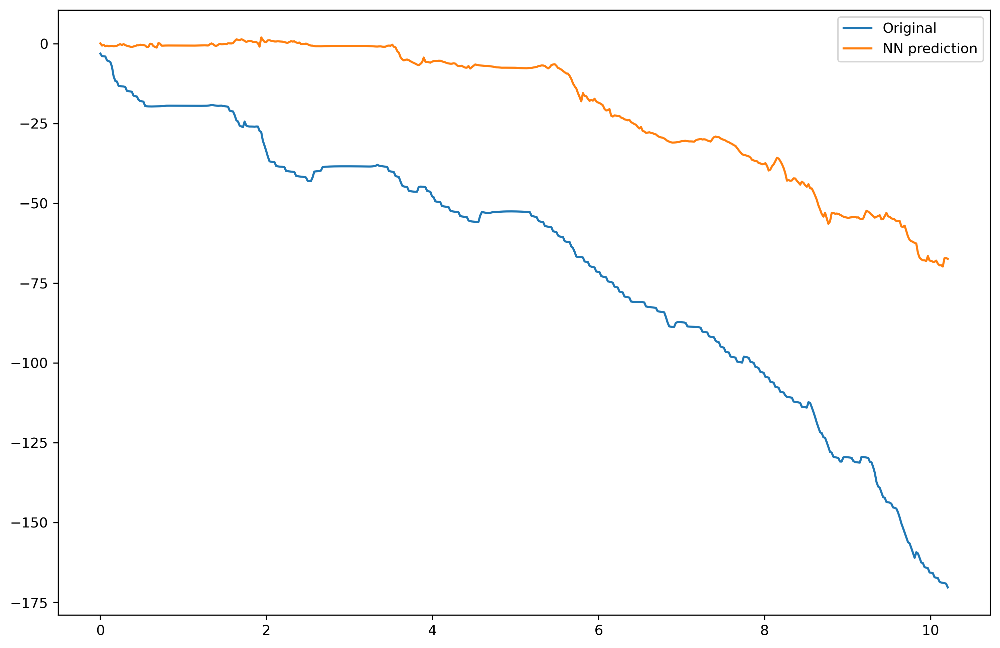

******************************************************************
Statistics


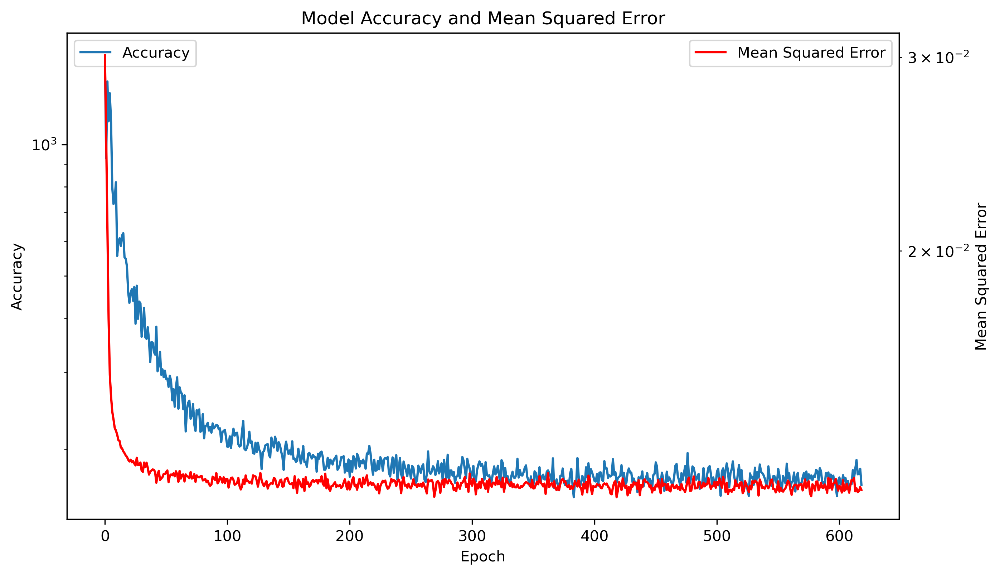

In [287]:
i = 1
j = 15
#print(p[i])
#print(samples)
t_f = np.linspace(t[0], t[-1], M)

features1 = (np.expand_dims(x_test_f[i],0))
labels1 = model.predict(features1)[0]

real_ = labels1[:M//2+1]
imag_ = labels1[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN1 = reconstruct(labels1[:M//2+1], labels1[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig1 = reconstruct(y_test_f[i, :M//2+1], y_test_f[i, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
features2 = (np.expand_dims(x_test_f[j],0))
labels2 = model.predict(features2)[0]

real_ = labels2[:M//2+1]
imag_ = labels2[M//2+1:]
#real_ = labels[:M]
#imag_ = labels[M:]

#y_NN = fft_real_imag_reconstruction(labels[:N//2+1], labels[N//2+1:], t_f, n = m)
#y_orig = fft_real_imag_reconstruction(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, n = m)

#y_NN = fft_real_imag_reconstruction2(labels[:N//2+1], labels[N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_NN2 = reconstruct(labels2[:M//2+1], labels2[M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct3(labels[:M], labels[M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_NN = reconstruct2(labels[:N//2+1], labels[N//2+1:], t_f)#*filter2(np.ones((N)),t_f)
#y_orig = fft_real_imag_reconstruction2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f, samples[i]*5e4, n = m)#*filter2(np.ones((N)),t_f)
y_orig2 = reconstruct(y_test_f[j, :M//2+1], y_test_f[j, M//2+1:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct3(y_test_f[i, :M], y_test_f[i, M:], t_f, n = m)#*filter2(np.ones((N)),t_f)
#y_orig = reconstruct2(y_test_f[i, :N//2+1], y_test_f[i, N//2+1:], t_f)#*filter2(np.ones((N)),t_f)

#N = len(y_NN)
freqs = fftfreq(M, t_f[1]-t_f[0])*2*np.pi/0.0568


print("******************************************************************")
print("Features")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
plt.plot(np.transpose(features1[0]).flatten(), label = "Flattened features")
plt.plot(np.transpose(features2[0]).flatten(), label = "Flattened features")

plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Labels")
fig = plt.figure()
#plt.plot(np.array([prediction[0][:], prediction[1][:]]).flatten(), label = "Predicted labels via NN")
plt.plot(y_test_f[i], label = "Original labels", linestyle = "-")
plt.plot(y_test_f[j], label = "Original labels", linestyle = "-")
plt.plot(labels1, label = "Predicted labels via NN")
plt.plot(labels2, label = "Predicted labels via NN")
#plt.plot(imag_, label = "Predicted labels via NN, imag")
#plt.plot(np.array([y_test[i][0][:], y_test[i][1][:]]).flatten(), label = "Original labels")
#plt.plot(y_test_f[i,1], label = "Original labels, imag", linestyle = ":")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


#y_NN = logamp_phase_reconstruction2(prediction)


print("******************************************************************")
print("Fields")
fig = plt.figure()
plt.plot(t_f, y_orig1, label = "Original")
plt.plot(t_f, y_NN1, label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Fields closeup")
fig = plt.figure()
range_ = (t_f > 2700) & (t_f < 2900)
plt.plot(t_f[range_], y_orig1[range_], label = "Original")
plt.plot(t_f[range_], y_NN1[range_], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()

print("******************************************************************")
print("Spectra")
fig = plt.figure()
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_orig))[0:M//2], label = "Original")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig1))[0:M//2]), label = "Original 1")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN1))[0:M//2]), label = "NN prediction 1")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_orig2))[0:M//2]), label = "Original 2")
#plt.semilogy(freqs[0:M//2], np.abs(fft(y_NN))[0:M//2], label = "NN prediction")
plt.semilogy(freqs[0:M//2], (np.abs(fft(y_NN2))[0:M//2]), label = "NN prediction 2")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Phases")
fig = plt.figure()
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], np.unwrap(np.angle(fft(y_orig)))[0:N//2], label = "Original")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_NN)))[0:N//2], label = "NN prediction")
#plt.plot(freqs[0:N//2], (np.angle(fft(y_orig)))[0:N//2], label = "Original")

plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(y_test_f[i, :M//2+1]) + 1j*y_test_f[i, M//2+1:]))[0:M//2], label = "Original")
plt.plot(freqs[0:M//2], np.unwrap(np.angle(np.flip(real_) + 1j*imag_))[0:M//2], label = "NN prediction")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(y_test_f[i, :M] + 1j*y_test_f[i, M:]))[0:M//2], label = "Original")
#plt.plot(freqs[0:M//2], np.unwrap(np.angle(real_ + 1j*imag_))[0:M//2], label = "NN prediction")
plt.legend()
fig.set_figwidth(12)
fig.set_figheight(8)
fig.dpi = 300
plt.show()


print("******************************************************************")
print("Statistics")

fig, ax = plt.subplots()
epoch = history.epoch
fig.set_size_inches(10,6)
ax.semilogy(epoch, (np.array(history.history['mean_absolute_percentage_error'])))
ax2=ax.twinx()
ax2.semilogy(epoch, (np.array(history.history['loss'])), color = 'red')
plt.title('Model Accuracy and Mean Squared Error')
ax.set_ylabel('Accuracy')
ax2.set_ylabel('Mean Squared Error')
ax.set_xlabel('Epoch')
ax.legend(['Accuracy'], loc='upper left')
ax2.legend(['Mean Squared Error'], loc='upper right')
fig.dpi = 300
plt.show()